<a href="https://colab.research.google.com/github/YaoJunJia/paper_code/blob/main/Final_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#上傳數據和安裝調參套件

In [ ]:
#上傳數據 arimasalesdata-2 和 rnnlstmdata-2 和 rnnlstmsalesdata-2
from google.colab import files
files.upload()

Saving arimasalesdata-2.csv to arimasalesdata-2 (1).csv
Saving rnnlstmdata-2.csv to rnnlstmdata-2 (1).csv
Saving rnnlstmsalesdata-2.csv to rnnlstmsalesdata-2 (1).csv


{'arimasalesdata-2.csv': b't,1.8\r\n1,1614\r\n2,1184\r\n3,1278\r\n4,1616\r\n5,1740\r\n6,2455\r\n7,2912\r\n8,1949\r\n9,1673\r\n10,2262\r\n11,2683\r\n12,3434\r\n13,1612\r\n14,1385\r\n15,1314\r\n16,1927\r\n17,1729\r\n18,2571\r\n19,3709\r\n20,1593\r\n21,2337\r\n22,2688\r\n23,3522\r\n24,2034\r\n25,5063\r\n26,1036\r\n27,3692\r\n28,2089\r\n29,2457\r\n30,4589\r\n31,2520\r\n32,3458\r\n33,3512\r\n34,4468\r\n35,2563\r\n36,4638\r\n37,1788\r\n38,2778\r\n39,2588\r\n40,3424\r\n41,2657\r\n42,4784\r\n43,2251\r\n44,1617\r\n45,2430\r\n46,2830\r\n47,3524\r\n48,4196\r\n49,2543\r\n50,1482\r\n51,2781\r\n52,3349\r\n53,3335\r\n54,4196\r\n55,1832\r\n56,1213\r\n57,3572\r\n58,3777\r\n59,4444\r\n60,4660\r\n61,2033\r\n62,4451\r\n63,3534\r\n64,4068\r\n65,4416\r\n66,5039\r\n67,1793\r\n68,3445\r\n69,3342\r\n70,3869\r\n71,4084\r\n72,5850\r\n73,2176\r\n74,2531\r\n75,3579\r\n76,3057\r\n77,4152\r\n78,5449\r\n79,1474\r\n80,1463\r\n81,3149\r\n82,3954\r\n83,5351\r\n84,5584\r\n85,2137\r\n86,3335\r\n87,2832\r\n88,3578\r\n89,40

In [ ]:
#安裝talos包
!pip install talos

#六期-ARIMA

In [ ]:
import warnings
from pandas import read_csv
from pandas import datetime
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
#from sklearn.metrics import mean_absolute_percentage_error
import numpy as np

# MAPE公式引用
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 評估對於給定的順序的ARIMA模型（P，d，q）的
def evaluate_arima_model(X, arima_order):
  # 準備訓練數據集
  train_size = int(len(X) * 0.8)#訓練集
  train, test = X[0:train_size], X[train_size:]#測試集
  history = [x for x in train]
  print(test)#列出實際值

  # 做出預測
  predictions = list()
  for t in range(len(test)):
    model = ARIMA(history, order=arima_order)
    model_fit = model.fit(disp=0)
    yhat = model_fit.forecast()[0]
    print(yhat)#列出預測值
    predictions.append(yhat)#遞延預測值的實際值(每次預測一個)
    history.append(test[t])#遞延預測值的預測值(每次預測一個)

  # calculate out of sample error計算樣品的誤差出
  error = mean_squared_error(test, predictions)
  return error

# 用於ARIMA模型評估P，d和q值的組合
def evaluate_models(dataset, p_values, d_values, q_values):
  dataset = dataset.astype('float32')
  best_score, best_cfg = float("inf"), None
  for p in p_values:
    for d in d_values:
      for q in q_values:
        order = (p,d,q)
        try:
          mse = evaluate_arima_model(dataset, order)
          if mse < best_score:
            best_score, best_cfg = mse, order
          print('ARIMA%s MSE=%.3f' % (order,mse))
        except:
          continue
  print('Best ARIMA%s MSE=%.3f' % (best_cfg, best_score))
 
# 載入數據集
series = read_csv('arimasalesdata-2.csv', header=0, parse_dates=[0], index_col=0, squeeze=True)

# 評估參數
p_values = range(6, 7)
d_values = range(0, 7)
q_values = range(0, 7)

warnings.filterwarnings("ignore")
evaluate_models(series.values, p_values, d_values, q_values)

#六期包含經濟特徵指標-BPN

  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-6)  var2(t-6)  var3(t-6)  ...   var8(t)   var9(t)  var10(t)
6     0.120066   0.122944   0.000000  ...  0.976096  0.037037  0.512905
7     0.030744   0.000000   0.014761  ...  1.000000  0.037037  0.547320
8     0.050270   0.008658   0.030229  ...  0.964143  0.037037  0.549305
9     0.120482   0.069264   0.061049  ...  0.932271  0.037037  0.552614
10    0.146240   0.103030   0.088795  ...  0.892430  0.014815  0.653872
..         ...        ...        ...  ...       ...       ...       ...
125   0.232447   0.858874   0.900165  ...  0.107570  0.059259  0.495036
126   0.010594   0.944589   0.923734  ...  0.071713  0.059259  0.501655
127   0.323432   0.954978   0.939483  ...  0.059761  0.051852  0.478491
128   0.198795   0.967100   0.947596  ...  0.043825  0.051852  0.489742
129   0.296012   0.996537   0.940696  ...  0.019920  0.051852  0.536069

[124 rows x 70 columns]
(99, 60) 99 (99,)
(99, 60) (99,) (25, 60) (25,)
{'activation': 'elu', 'batch_size': 20, 'dropout': 0.08, 'epoch

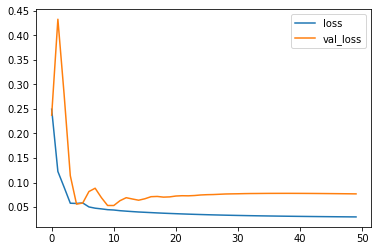

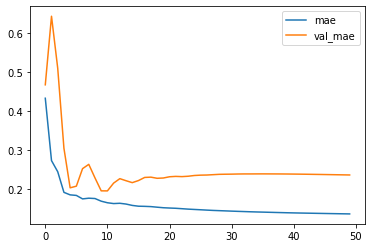

Test MSE: 1780681.441
bestmse=1780681.4405042389
Test MAE: 1134.999
bestmae=1134.99921
Test MAPE: 62.323
bestmape=62.32256


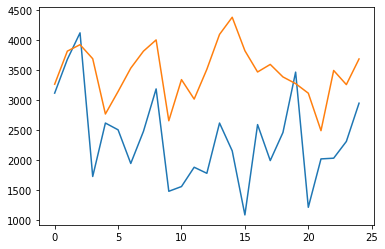

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3266.61437839 3817.93050838 3925.89935935 3691.76154566 2769.78481323
 3144.87629312 3534.02724385 3817.32736731 4005.36936438 2657.00001568
 3343.20669466 3018.18983996 3514.96287858 4097.09271681 4383.24269617
 3824.97537971 3470.45468307 3596.65147865 3388.1381219  3276.41556424
 3116.73827016 2491.79459798 3495.62161934 3259.90551001 3687.62908244]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 64)                3904      
_________________________________________________________________
dense_2 (Dense)              (None, 16)                1040      
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 17        
Total 

100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times*n_features))
x_val = x_val.reshape((x_val.shape[0], n_times*n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(Dense(params['first_neuron'],input_shape=(x_train.shape[1],),activation=params['activation']))##

    model.add(Dense(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.37],
     'first_neuron':[64],
     'second_neuron':[16],
     'batch_size': [20],
     'epochs': [50],
     'dropout': [0.08],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['elu'],
     'last_activation': ['tanh'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

  0%|          | 0/1 [00:00<?, ?it/s]

train_df
       CS     CPI       M1B    SPI      IP    NFP      EE     U   BIR     OP
0    1614   92.89   8327910   4475   45.62   9763  100.46  5.31  3.91  22.32
1    1184   91.47   8483983   4477   49.56   9691  130.19  5.75  3.16  23.29
2    1278   91.57   8647538   4926   59.40   9686  152.71  5.81  3.16  24.09
3    1616   92.27   8973412   5724   64.17   9686  144.20  5.76  2.66  25.40
4    1740   92.66   9266786   6586   67.37   9700  141.07  5.82  2.64  26.35
..    ...     ...       ...    ...     ...    ...     ...   ...   ...    ...
125  1214  102.84  18726826  10469  115.57  10966  307.25  3.89  2.64  28.30
126  2021  103.01  18744555  10816  110.85  10950  358.23  3.80  2.64  28.40
127  2033  103.02  18663224  11140  113.95  10961  352.68  3.77  2.63  28.05
128  2312  102.60  18740366  11559  114.05  10971  327.96  3.73  2.63  28.22
129  2950  102.65  18901441  11854  117.44  10977  386.33  3.67  2.63  28.92

[130 rows x 10 columns]
values
[[1.6140000e+03 9.2890000e+01 8.327

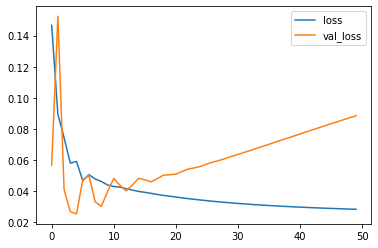

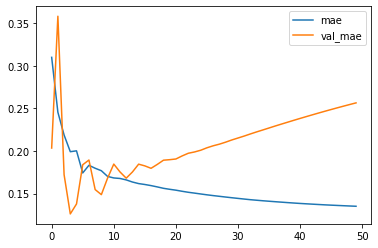

yhat
[[0.49514562]
 [0.58658403]
 [0.6129938 ]
 [0.5162001 ]
 [0.3043878 ]
 [0.43074837]
 [0.47468954]
 [0.51794416]
 [0.63999814]
 [0.445201  ]
 [0.49944204]
 [0.5259139 ]
 [0.5453615 ]
 [0.6330439 ]
 [0.697918  ]
 [0.52772063]
 [0.41801068]
 [0.50930506]
 [0.41128096]
 [0.4742446 ]
 [0.5059709 ]
 [0.4936849 ]
 [0.60809565]
 [0.5764441 ]
 [0.667685  ]]
x_val
[[0.52575821 0.73333333 0.73398763 ... 0.05179283 0.05185185 0.38848445]
 [0.59638554 0.7991342  0.73260238 ... 0.03585657 0.05185185 0.44672402]
 [0.62816784 0.7991342  0.75070504 ... 0.01593625 0.05185185 0.46988749]
 ...
 [0.32343166 0.95497835 0.93948285 ... 0.07171315 0.05925926 0.50165453]
 [0.19879518 0.96709957 0.94759584 ... 0.05976096 0.05185185 0.47849107]
 [0.29601163 0.9965368  0.94069588 ... 0.0438247  0.05185185 0.48974189]]
inv_yhat
[[0.49514562 0.86493506 0.77900098 0.84144193 0.86173768 0.88226181
  0.63070627 0.05179283 0.05185185 0.38848445]
 [0.58658403 0.88658009 0.78180591 0.84943759 0.88276246 0.89388071
  

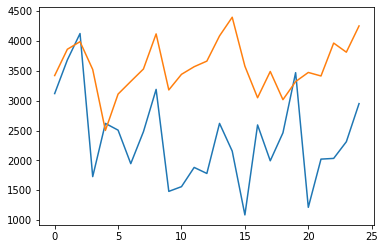

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3419.63100946 3859.81552804 3986.95204151 3520.9874028  2501.32290697
 3109.62266892 3321.15546119 3529.38317239 4116.9510361  3179.19765979
 3440.31398499 3567.74948657 3661.37035179 4083.4732635  4395.77724159
 3576.44711363 3048.30342251 3487.79455841 3015.90654069 3319.01347828
 3471.74388993 3412.59905028 3963.37243938 3811.00184643 4250.23545659]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 64)                3904      
_________________________________________________________________
dense_2 (Dense)              (None, 16)                1040      
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 17        
Total 

100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")
print('train_df')
print(train_df)
# Dataframe轉换成Array格式
values =train_df.values
print('values')
print(values)
# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
print('scaler')
print(scaler)
scaled = scaler.fit_transform(values)
print('scaled')
print(scaled)
# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print('reframed')
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
print('scaled')
print(scaled)
n_train = int((values.shape[0]-n_times)*0.8)
print('n_train')
print(n_train)
train = scaled[:n_train, :]
print('train')
print(train)
test = scaled[n_train:, :]
print('test')
print(test)

# 分成輸入和輸出
n_obs = n_times * n_features
print('n_obs')
print(n_obs)
x_train, y_train = train[:, :n_obs], train[:, -n_features]
print('x_train')
print(x_train)
print('y_train')
print(y_train)
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print('x_train.shape, len(x_train), y_train.shape')
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times*n_features))
print('x_train')
print(x_train)
x_val = x_val.reshape((x_val.shape[0], n_times*n_features))
print('x_train.shape, y_train.shape, x_val.shape, y_val.shape')
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(Dense(params['first_neuron'],input_shape=(x_train.shape[1],),activation=params['activation']))##

    model.add(Dense(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    print('yhat')
    print(yhat)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))
    print('x_val')
    print(x_val)

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    print('inv_yhat')
    print(inv_yhat)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    print('inv_yhat')
    print(inv_yhat)
    inv_yhat = inv_yhat[:,0]
    print('inv_yhat')
    print(inv_yhat)

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    print('y_val')
    print(y_val)
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    print('inv_y')
    print(inv_y)
    inv_y = scaler.inverse_transform(inv_y)
    print('inv_y')
    print(inv_y)
    inv_y = inv_y[:,0]
    print('inv_y')
    print(inv_y)

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.37],
     'first_neuron':[64],
     'second_neuron':[16],
     'batch_size': [20],
     'epochs': [50],
     'dropout': [0.08],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['elu'],
     'last_activation': ['tanh'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")
print('train_df')
print(train_df)
# Dataframe轉换成Array格式
values =train_df.values
print('values')
print(values)
# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
print('scaler')
print(scaler)
scaled = scaler.fit_transform(values)
print('scaled')
print(scaled)
# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print('reframed')
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
print('scaled')
print(scaled)
n_train = int((values.shape[0]-n_times)*0.8)
print('n_train')
print(n_train)
train = scaled[:n_train, :]
print('train')
print(train)
test = scaled[n_train:, :]
print('test')
print(test)

# 分成輸入和輸出
n_obs = n_times * n_features
print('n_obs')
print(n_obs)
x_train, y_train = train[:, :n_obs], train[:, -n_features]
print('x_train')
print(x_train)
print('y_train')
print(y_train)
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print('x_train.shape, len(x_train), y_train.shape')
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times*n_features))
print('x_train')
print(x_train)
x_val = x_val.reshape((x_val.shape[0], n_times*n_features))
print('x_train.shape, y_train.shape, x_val.shape, y_val.shape')
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(Dense(params['first_neuron'],input_shape=(x_train.shape[1],),activation=params['activation']))##

    model.add(Dense(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    #model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
    #              loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    model.compile(optimizer=params['optimizer'],lr=lr_normalizer(params['lr'],loss=params['loss'],metrics=[talos.utils.metrics.mae]))

    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    print('yhat')
    print(yhat)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))
    print('x_val')
    print(x_val)

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    print('inv_yhat')
    print(inv_yhat)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    print('inv_yhat')
    print(inv_yhat)
    inv_yhat = inv_yhat[:,0]
    print('inv_yhat')
    print(inv_yhat)

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    print('y_val')
    print(y_val)
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    print('inv_y')
    print(inv_y)
    inv_y = scaler.inverse_transform(inv_y)
    print('inv_y')
    print(inv_y)
    inv_y = inv_y[:,0]
    print('inv_y')
    print(inv_y)

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.37],
     'first_neuron':[64],
     'second_neuron':[16],
     'batch_size': [20],
     'epochs': [50],
     'dropout': [0.08],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['elu'],
     'last_activation': ['tanh'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )


  0%|          | 0/1 [00:00<?, ?it/s]

train_df
       CS     CPI       M1B    SPI      IP    NFP      EE     U   BIR     OP
0    1614   92.89   8327910   4475   45.62   9763  100.46  5.31  3.91  22.32
1    1184   91.47   8483983   4477   49.56   9691  130.19  5.75  3.16  23.29
2    1278   91.57   8647538   4926   59.40   9686  152.71  5.81  3.16  24.09
3    1616   92.27   8973412   5724   64.17   9686  144.20  5.76  2.66  25.40
4    1740   92.66   9266786   6586   67.37   9700  141.07  5.82  2.64  26.35
..    ...     ...       ...    ...     ...    ...     ...   ...   ...    ...
125  1214  102.84  18726826  10469  115.57  10966  307.25  3.89  2.64  28.30
126  2021  103.01  18744555  10816  110.85  10950  358.23  3.80  2.64  28.40
127  2033  103.02  18663224  11140  113.95  10961  352.68  3.77  2.63  28.05
128  2312  102.60  18740366  11559  114.05  10971  327.96  3.73  2.63  28.22
129  2950  102.65  18901441  11854  117.44  10977  386.33  3.67  2.63  28.92

[130 rows x 10 columns]
values
[[1.6140000e+03 9.2890000e+01 8.327

TypeError: ignored

#六期包含經濟特徵指標-RNN

  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-6)  var2(t-6)  var3(t-6)  ...   var8(t)   var9(t)  var10(t)
6     0.120066   0.122944   0.000000  ...  0.976096  0.037037  0.512905
7     0.030744   0.000000   0.014761  ...  1.000000  0.037037  0.547320
8     0.050270   0.008658   0.030229  ...  0.964143  0.037037  0.549305
9     0.120482   0.069264   0.061049  ...  0.932271  0.037037  0.552614
10    0.146240   0.103030   0.088795  ...  0.892430  0.014815  0.653872
..         ...        ...        ...  ...       ...       ...       ...
125   0.232447   0.858874   0.900165  ...  0.107570  0.059259  0.495036
126   0.010594   0.944589   0.923734  ...  0.071713  0.059259  0.501655
127   0.323432   0.954978   0.939483  ...  0.059761  0.051852  0.478491
128   0.198795   0.967100   0.947596  ...  0.043825  0.051852  0.489742
129   0.296012   0.996537   0.940696  ...  0.019920  0.051852  0.536069

[124 rows x 70 columns]
(99, 60) 99 (99,)
(99, 6, 10) (99,) (25, 6, 10) (25,)
{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.08

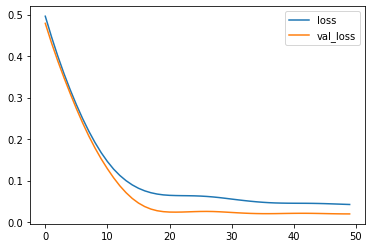

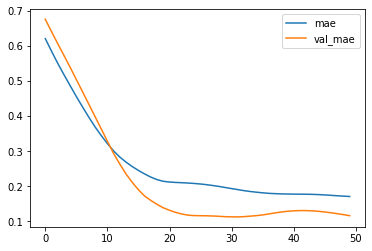

Test MSE: 450949.258
bestmse=450949.2577623304
Test MAE: 559.020
bestmae=559.02048
Test MAPE: 28.681
bestmape=28.68099


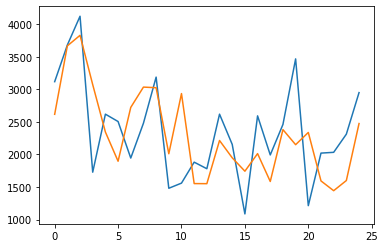

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2616.73963195 3667.95813286 3829.90380549 3072.59491473 2344.75844634
 1896.04215014 2723.03334612 3034.75986397 3025.18636245 2011.12459379
 2935.20643777 1552.86262894 1551.46869016 2214.42674857 1948.95343214
 1743.00830287 2013.10316622 1585.07701898 2381.31662852 2150.24918163
 2338.19189858 1593.81323904 1443.62853032 1599.83546776 2475.08397496]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
simple_rnn_1 (SimpleRNN)     (None, 6, 64)             4800      
_________________________________________________________________
simple_rnn_2 (SimpleRNN)     (None, 32)                3104      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 

100%|██████████| 1/1 [00:02<00:00,  2.75s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(SimpleRNN(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(SimpleRNN(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()

    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.1],
     'first_neuron':[64],
     'second_neuron':[32],
     'batch_size': [100],
     'epochs': [50],
     'dropout': [0.08],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['tanh'],
     'last_activation': ['relu'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

#六期包含經濟特徵指標-LSTM

  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-6)  var2(t-6)  var3(t-6)  ...   var8(t)   var9(t)  var10(t)
6     0.120066   0.122944   0.000000  ...  0.976096  0.037037  0.512905
7     0.030744   0.000000   0.014761  ...  1.000000  0.037037  0.547320
8     0.050270   0.008658   0.030229  ...  0.964143  0.037037  0.549305
9     0.120482   0.069264   0.061049  ...  0.932271  0.037037  0.552614
10    0.146240   0.103030   0.088795  ...  0.892430  0.014815  0.653872
..         ...        ...        ...  ...       ...       ...       ...
125   0.232447   0.858874   0.900165  ...  0.107570  0.059259  0.495036
126   0.010594   0.944589   0.923734  ...  0.071713  0.059259  0.501655
127   0.323432   0.954978   0.939483  ...  0.059761  0.051852  0.478491
128   0.198795   0.967100   0.947596  ...  0.043825  0.051852  0.489742
129   0.296012   0.996537   0.940696  ...  0.019920  0.051852  0.536069

[124 rows x 70 columns]
(99, 60) 99 (99,)
(99, 6, 10) (99,) (25, 6, 10) (25,)
{'activation': 'tanh', 'batch_size': 20, 'dropout': 0, 'e

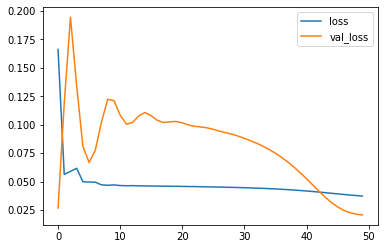

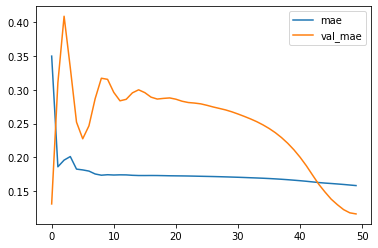

Test MSE: 478448.502
bestmse=478448.5021092674
Test MAE: 559.598
bestmae=559.59750
Test MAPE: 28.542
bestmape=28.54160


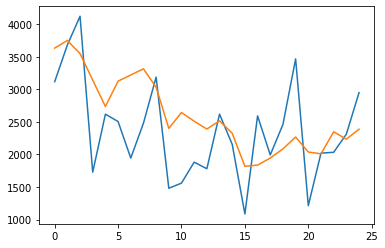

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3633.25571418 3750.28918433 3549.52900231 3141.70564193 2736.97488594
 3126.03717321 3220.72329116 3315.18272907 3032.55848515 2400.23652112
 2644.65599626 2510.4027338  2390.64609033 2516.64662117 2325.45893639
 1818.68586475 1836.89989293 1944.77649373 2085.56215847 2268.36999863
 2037.748308   2009.88760942 2347.85793722 2235.1460216  2388.54714793]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 

100%|██████████| 1/1 [00:05<00:00,  5.34s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(LSTM(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(LSTM(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.73],
     'first_neuron':[64],
     'second_neuron':[32],
     'batch_size': [20],
     'epochs': [50],
     'dropout': [0],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['tanh'],
     'last_activation': ['tanh'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )




  0%|          | 0/128 [00:00<?, ?it/s]

     var1(t-6)  var2(t-6)  var3(t-6)  ...   var8(t)   var9(t)  var10(t)
6     0.120066   0.122944   0.000000  ...  0.976096  0.037037  0.512905
7     0.030744   0.000000   0.014761  ...  1.000000  0.037037  0.547320
8     0.050270   0.008658   0.030229  ...  0.964143  0.037037  0.549305
9     0.120482   0.069264   0.061049  ...  0.932271  0.037037  0.552614
10    0.146240   0.103030   0.088795  ...  0.892430  0.014815  0.653872
..         ...        ...        ...  ...       ...       ...       ...
125   0.232447   0.858874   0.900165  ...  0.107570  0.059259  0.495036
126   0.010594   0.944589   0.923734  ...  0.071713  0.059259  0.501655
127   0.323432   0.954978   0.939483  ...  0.059761  0.051852  0.478491
128   0.198795   0.967100   0.947596  ...  0.043825  0.051852  0.489742
129   0.296012   0.996537   0.940696  ...  0.019920  0.051852  0.536069

[124 rows x 70 columns]
(99, 60) 99 (99,)
(99, 6, 10) (99,) (25, 6, 10) (25,)
{'activation': 'relu', 'batch_size': 80, 'dropout': 0.0, 

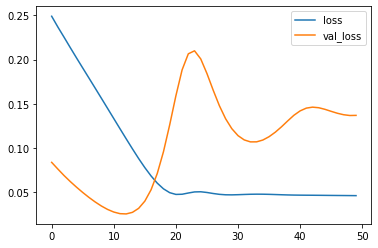

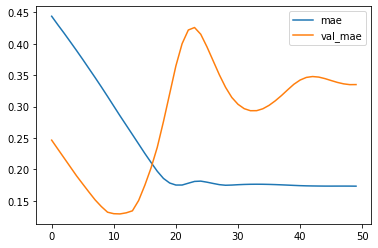

Test MSE: 3173986.888
bestmse=3173986.8883380950
Test MAE: 1612.790
bestmae=1612.79040
Test MAPE: 86.971
bestmape=86.97144


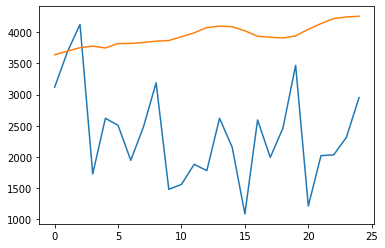

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3637.70380783 3694.98154998 3750.39707255 3774.63519454 3745.89675641
 3817.53510952 3817.63668513 3833.74875808 3854.97863507 3864.93132353
 3925.83824182 3988.38873386 4072.39693069 4095.31342196 4086.69671106
 4020.18821335 3934.28393841 3918.07889795 3905.48294806 3939.95438266
 4044.9428215  4135.75830603 4217.48937273 4241.32406163 4253.97223401]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




  1%|          | 1/128 [00:04<08:37,  4.08s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


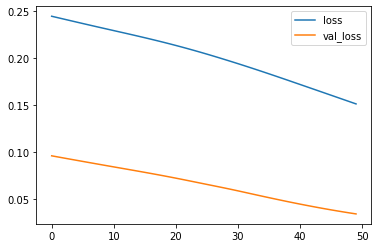

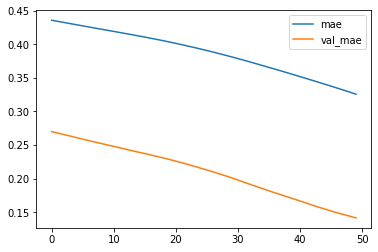

Test MSE: 797389.340
bestmse=797389.3395878407
Test MAE: 680.965
bestmae=680.96496
Test MAPE: 26.750
bestmape=26.75028


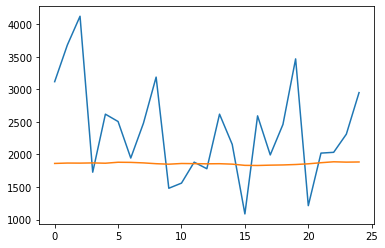

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1862.27550396 1868.16143772 1867.15436143 1870.17322308 1865.71745387
 1880.50617447 1878.50450364 1870.59860682 1858.27158841 1850.78167817
 1861.31706345 1859.25987035 1856.40384531 1858.18321189 1851.38575178
 1832.8139852  1830.93383208 1835.93528327 1839.10277817 1845.86193222
 1856.57034037 1873.48160392 1887.59817517 1882.30885467 1884.69523597]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




  2%|▏         | 2/128 [00:08<08:40,  4.13s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


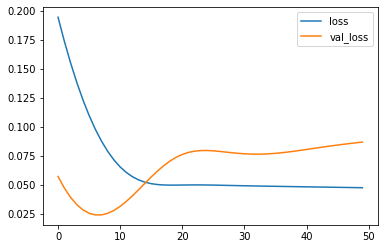

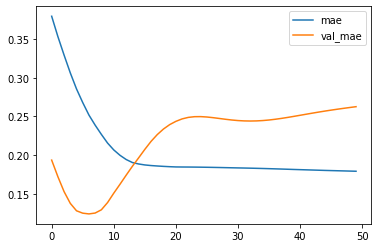

Test MSE: 2013115.254
bestmse=797389.3395878407
Test MAE: 1264.183
bestmae=680.96496
Test MAPE: 69.266
bestmape=26.75028


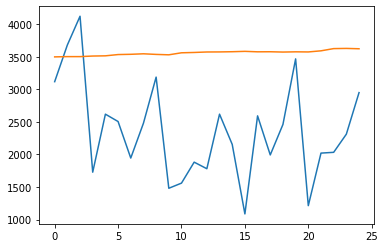

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3498.83588493 3502.8446784  3502.87825    3511.74803913 3515.00276279
 3534.5193404  3538.48968434 3546.23468137 3536.84725833 3530.61011398
 3561.58551109 3566.69585478 3574.00040388 3574.95389473 3578.16156077
 3583.80130279 3576.68326259 3577.66028225 3572.92410409 3576.55672348
 3574.66208005 3591.92247391 3625.94456553 3628.87562454 3623.58537149]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




  2%|▏         | 3/128 [00:12<08:45,  4.20s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


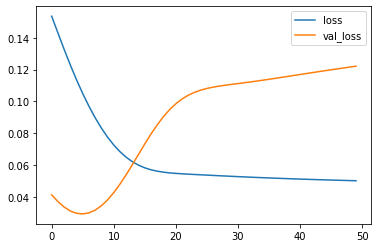

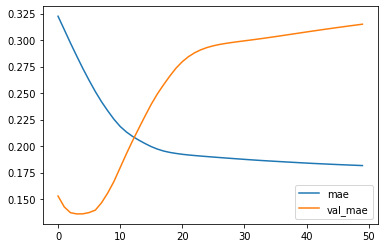

Test MSE: 2831169.768
bestmse=797389.3395878407
Test MAE: 1516.519
bestmae=680.96496
Test MAPE: 82.229
bestmape=26.75028


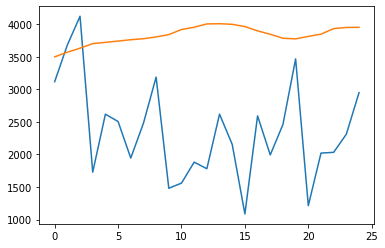

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3498.93602586 3570.51584387 3632.39719939 3703.1027211  3721.8629334
 3741.60762572 3762.42747009 3777.92348981 3805.16210949 3840.97841668
 3919.41028452 3954.14914417 4004.73379946 4008.60687184 3998.98645616
 3964.29723656 3898.71697927 3846.14155674 3784.89834857 3775.58065116
 3813.28729773 3848.08469248 3933.3846786  3950.61006618 3953.00082326]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




  3%|▎         | 4/128 [00:17<09:06,  4.41s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


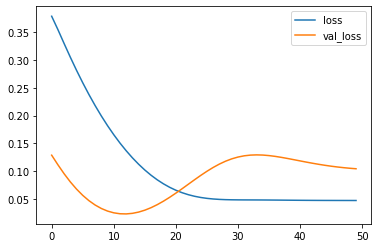

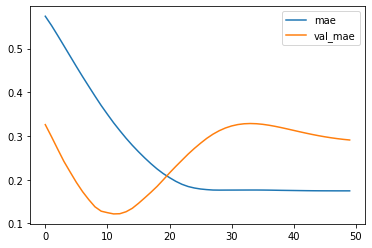

Test MSE: 2417372.441
bestmse=797389.3395878407
Test MAE: 1400.456
bestmae=680.96496
Test MAPE: 76.085
bestmape=26.75028


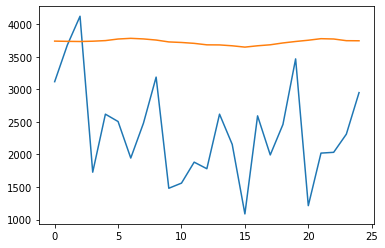

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3741.05928957 3737.29668784 3735.01353204 3739.64526522 3748.9245131
 3773.25617647 3783.72822046 3774.60535312 3757.48039341 3728.59102654
 3720.11089754 3706.59588921 3683.85414243 3682.53136396 3669.13772988
 3648.85818744 3669.34489822 3684.63575816 3712.87750876 3735.32342374
 3754.71920097 3778.43194175 3773.52532315 3747.71880484 3746.15557337]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




  4%|▍         | 5/128 [00:21<08:52,  4.33s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


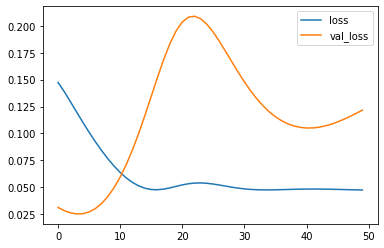

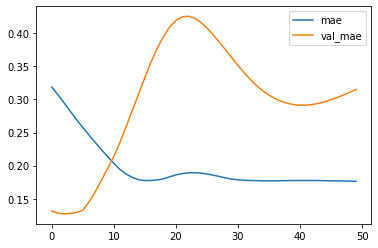

Test MSE: 2819273.119
bestmse=797389.3395878407
Test MAE: 1517.000
bestmae=680.96496
Test MAPE: 82.089
bestmape=26.75028


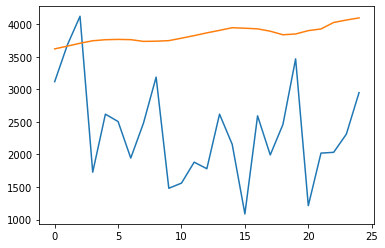

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3621.38370574 3664.09481633 3708.14620852 3746.33576965 3762.57438171
 3767.27239728 3763.46072936 3736.79540932 3739.77094352 3748.30903375
 3785.86274302 3825.36417902 3867.78376186 3906.04620492 3946.75392306
 3938.87004864 3929.43872428 3893.15384936 3838.47202408 3850.56153059
 3901.90972459 3927.61122406 4027.3854481  4064.62065756 4097.50877512]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




  5%|▍         | 6/128 [00:25<08:33,  4.21s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


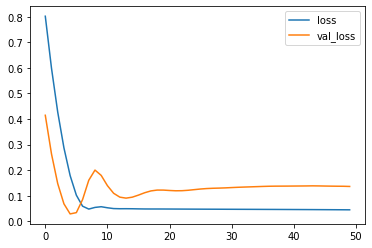

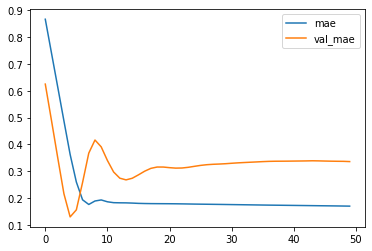

Test MSE: 3155775.207
bestmse=797389.3395878407
Test MAE: 1617.835
bestmae=680.96496
Test MAPE: 86.900
bestmape=26.75028


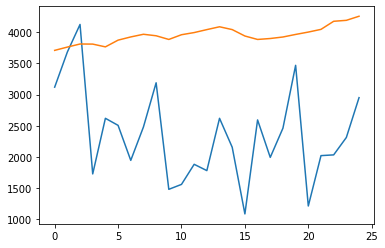

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3707.599594   3760.32135427 3809.68050265 3808.21167338 3763.74164045
 3871.58050907 3922.92784226 3965.5729574  3941.57873166 3882.7234112
 3958.40298164 3992.9272126  4040.36761487 4085.66546035 4040.59544265
 3937.76161194 3882.6390518  3897.7040925  3921.92385054 3963.00688195
 4000.84838879 4044.29836154 4173.65260923 4189.02782857 4254.48814631]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




  5%|▌         | 7/128 [00:30<09:03,  4.49s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


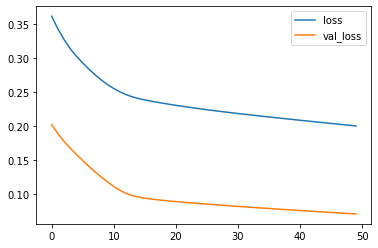

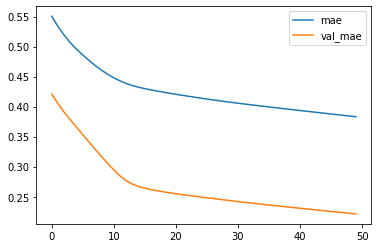

Test MSE: 1629346.502
bestmse=797389.3395878407
Test MAE: 1065.123
bestmae=680.96496
Test MAPE: 40.218
bestmape=26.75028


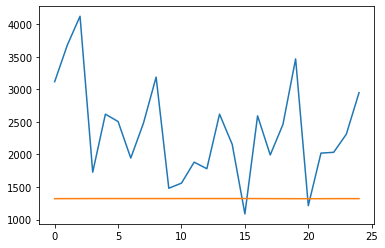

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1321.12541785 1321.70029565 1322.14135332 1322.64709729 1322.92018935
 1322.83875311 1322.80840955 1322.79329157 1322.81212179 1322.65430658
 1323.02628422 1323.02628422 1323.02628422 1323.02628422 1323.02628422
 1323.02628422 1322.44807078 1321.69965004 1321.24010289 1320.92676795
 1320.80333134 1320.79605032 1321.67248072 1321.78503166 1321.61595418]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




  6%|▋         | 8/128 [00:34<08:41,  4.35s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


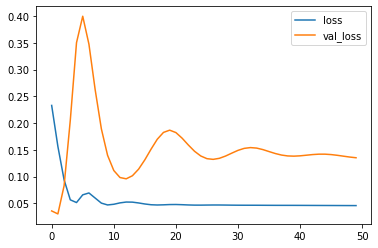

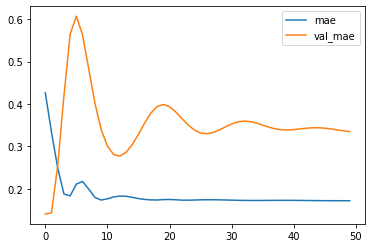

Test MSE: 3132224.144
bestmse=797389.3395878407
Test MAE: 1612.587
bestmae=680.96496
Test MAPE: 86.696
bestmape=26.75028


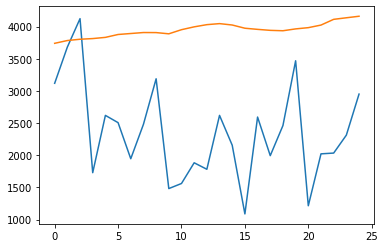

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3739.49232793 3782.80600572 3802.78569925 3813.2652036  3831.91580606
 3876.75541353 3892.00725007 3907.15578938 3906.22582734 3887.27193272
 3951.34921527 3995.58797717 4029.70705342 4045.72529805 4024.14306271
 3974.15035796 3956.46701932 3941.13426661 3934.9809078  3963.6808964
 3983.02703357 4023.24093354 4112.35230064 4136.55771184 4160.46585655]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




  7%|▋         | 9/128 [00:39<08:44,  4.41s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


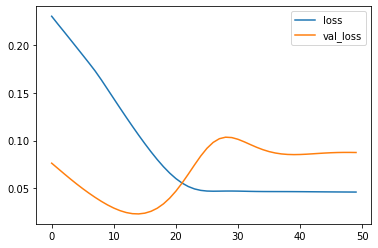

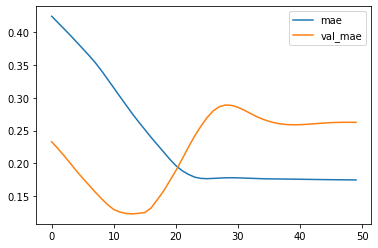

Test MSE: 2028487.353
bestmse=797389.3395878407
Test MAE: 1264.327
bestmae=680.96496
Test MAPE: 69.372
bestmape=26.75028


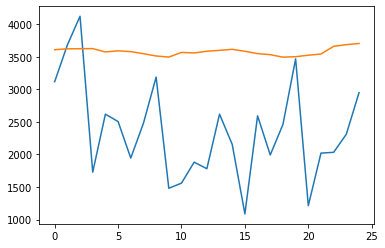

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3609.01214039 3622.8353188  3623.97732711 3626.02892494 3574.66982734
 3591.96178424 3579.42609107 3547.38587165 3512.33654642 3496.01558352
 3567.20000267 3558.86563754 3585.64946246 3599.19201672 3614.85532057
 3585.05464256 3548.93561709 3532.6998744  3494.77630365 3501.49033689
 3524.32964218 3542.94581223 3661.10206592 3686.6093092  3704.43726397]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




  8%|▊         | 10/128 [00:43<08:34,  4.36s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


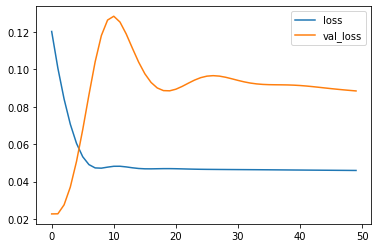

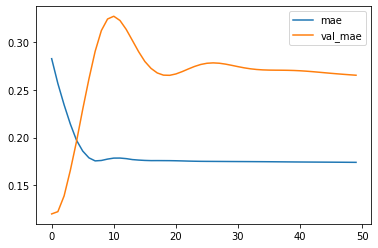

Test MSE: 2049225.803
bestmse=797389.3395878407
Test MAE: 1276.937
bestmae=680.96496
Test MAPE: 69.855
bestmape=26.75028


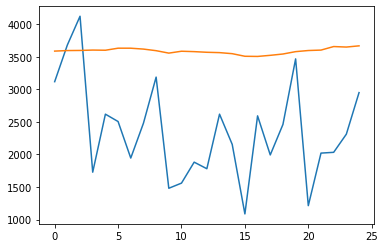

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3587.61497927 3595.99525428 3597.67813838 3603.4412632  3600.8677274
 3632.37166202 3632.09075093 3618.56828225 3594.08999419 3556.6938132
 3585.60670888 3579.4926604  3569.58157778 3564.235659   3548.10923922
 3508.22216022 3505.68965638 3522.72078776 3542.95126402 3579.35263526
 3596.58089221 3603.17498589 3657.49842715 3649.76892471 3668.36558306]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total pa




  9%|▊         | 11/128 [00:47<08:30,  4.36s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


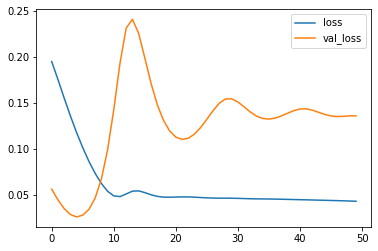

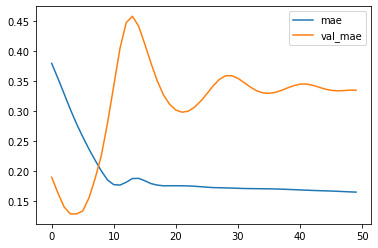

Test MSE: 3146397.474
bestmse=797389.3395878407
Test MAE: 1614.509
bestmae=680.96496
Test MAPE: 86.826
bestmape=26.75028


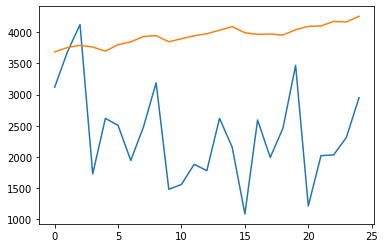

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3683.28973782 3753.65351784 3789.46666873 3762.15401936 3696.31838834
 3800.16596663 3845.99808836 3929.83613169 3945.52784228 3846.87381935
 3894.9540906  3943.06162083 3974.9460336  4031.23671329 4089.25934327
 3991.31864512 3964.99506676 3970.52204263 3954.33938324 4039.17711425
 4093.89595437 4099.98331773 4172.74101114 4164.17451417 4255.78137028]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




  9%|▉         | 12/128 [00:52<08:24,  4.35s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


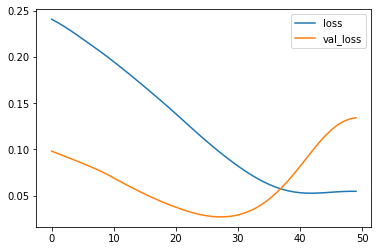

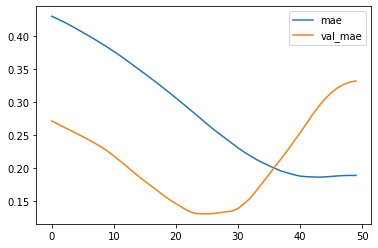

Test MSE: 3110495.033
bestmse=797389.3395878407
Test MAE: 1597.688
bestmae=680.96496
Test MAPE: 86.113
bestmape=26.75028


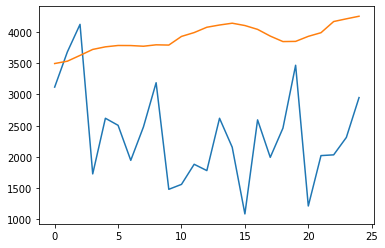

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3495.58603919 3533.05194581 3625.82921696 3721.39235711 3762.91526258
 3784.52848709 3783.49178457 3772.60913408 3795.27685118 3791.13549292
 3929.74832904 3991.47158241 4076.76496899 4112.5884496  4141.46031332
 4104.13471878 4042.61490357 3935.08936989 3847.24913263 3850.18133938
 3930.92649138 3989.2710644  4168.16350901 4211.55982459 4252.92864501]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 10%|█         | 13/128 [00:56<08:04,  4.22s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


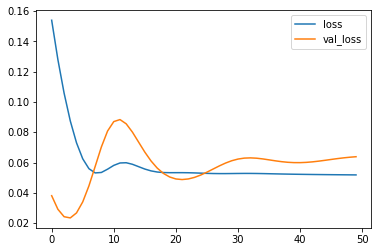

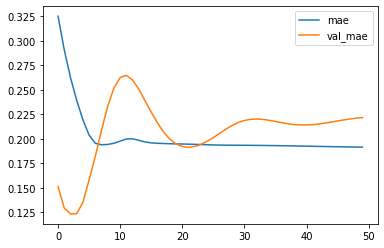

Test MSE: 1479786.576
bestmse=797389.3395878407
Test MAE: 1066.818
bestmae=680.96496
Test MAPE: 59.055
bestmape=26.75028


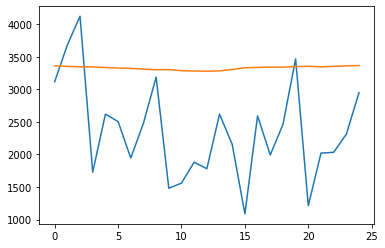

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3360.47827905 3353.07516718 3346.64132768 3344.21814674 3335.58637166
 3327.28729975 3322.55298668 3310.29562217 3302.19310194 3303.6774258
 3286.38848174 3281.94799191 3278.46630126 3283.62599808 3305.97636312
 3331.98890203 3336.5834769  3342.03168863 3340.71177953 3350.06936115
 3354.55045253 3346.09012216 3353.16985631 3360.85904413 3365.56179416]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 11%|█         | 14/128 [01:00<07:58,  4.20s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


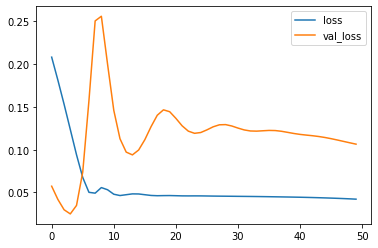

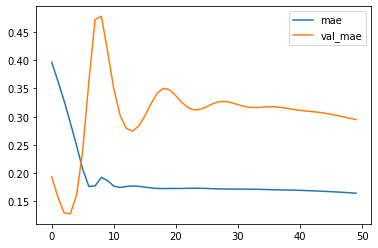

Test MSE: 2468469.801
bestmse=797389.3395878407
Test MAE: 1419.179
bestmae=680.96496
Test MAPE: 76.835
bestmape=26.75028


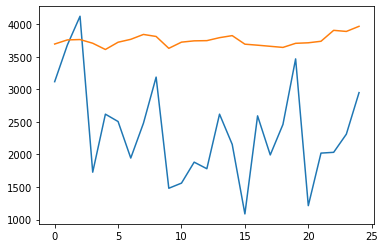

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3696.29973745 3759.54289484 3764.96858203 3708.46155202 3612.3733176
 3723.89702809 3768.48068798 3843.41192734 3812.39119422 3630.1593796
 3725.2209543  3745.05115378 3748.33916211 3794.00916457 3825.3351984
 3693.9505862  3678.44968855 3661.32013786 3644.27695513 3707.15139878
 3715.34889507 3738.6077019  3906.5190767  3889.64518666 3968.19900262]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total par




 12%|█▏        | 15/128 [01:05<08:09,  4.33s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


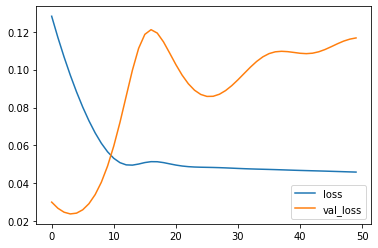

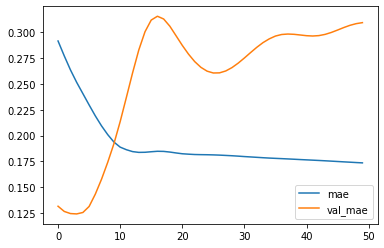

Test MSE: 2705171.901
bestmse=797389.3395878407
Test MAE: 1488.094
bestmae=680.96496
Test MAPE: 80.543
bestmape=26.75028


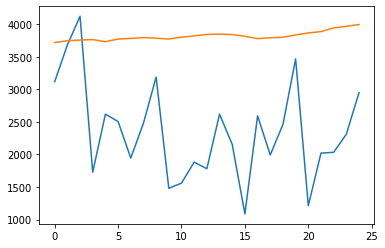

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3718.92498791 3746.62385416 3758.11624527 3764.5662967  3732.37313998
 3772.53366971 3782.79711068 3795.39392138 3785.16950381 3773.52446234
 3801.60868466 3822.09367383 3843.51350296 3848.04939926 3841.58471406
 3815.76987457 3778.84254825 3792.32714128 3799.88763797 3836.13664579
 3866.24061596 3887.11497831 3943.52703226 3968.28709221 3995.57621276]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 12%|█▎        | 16/128 [01:09<08:03,  4.31s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


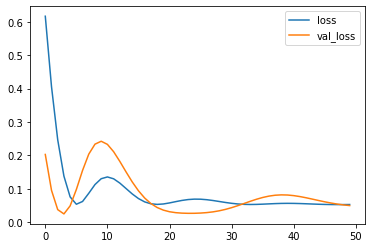

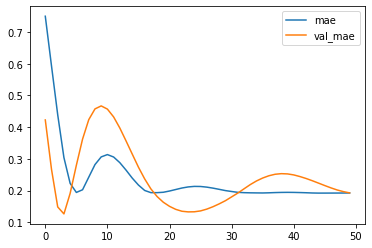

Test MSE: 1151446.803
bestmse=797389.3395878407
Test MAE: 928.145
bestmae=680.96496
Test MAPE: 51.478
bestmape=26.75028


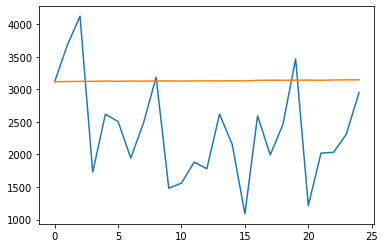

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3117.60194981 3120.06788433 3121.98117864 3123.47712344 3127.19367182
 3124.48785818 3127.37185955 3125.78509927 3128.69679004 3129.4642024
 3127.24345535 3129.80164003 3130.21712446 3130.323578   3131.24349725
 3130.26418209 3138.39137888 3140.61556917 3139.2946558  3141.42889142
 3142.92957067 3139.15190476 3144.58433497 3145.86177742 3147.7017594 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 13%|█▎        | 17/128 [01:13<07:55,  4.28s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


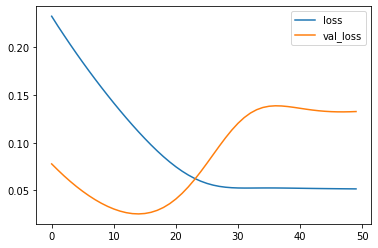

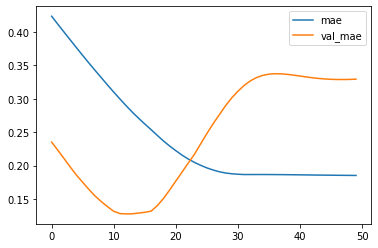

Test MSE: 3075643.387
bestmse=797389.3395878407
Test MAE: 1584.848
bestmae=680.96496
Test MAPE: 85.606
bestmape=26.75028


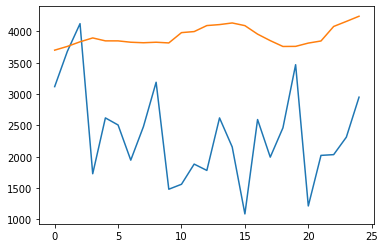

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3700.04598379 3759.79195595 3833.32237005 3895.14174724 3848.33547521
 3848.09358752 3826.62239671 3818.40165854 3826.63157868 3815.35668564
 3979.98378229 3996.69727468 4092.51636243 4108.09559381 4134.10899353
 4091.42370725 3955.9126575  3852.13164854 3758.95582223 3760.55119061
 3812.92346191 3846.4784205  4078.34972072 4158.70377791 4241.26782203]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 14%|█▍        | 18/128 [01:17<07:51,  4.29s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


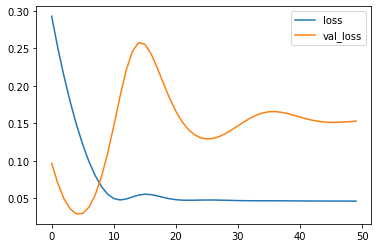

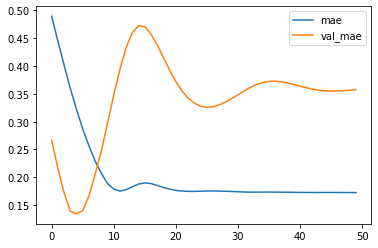

Test MSE: 3550181.595
bestmse=797389.3395878407
Test MAE: 1720.137
bestmae=680.96496
Test MAPE: 92.240
bestmape=26.75028


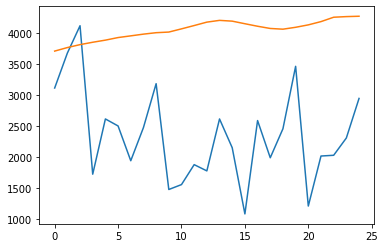

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3713.79685414 3770.63787854 3818.0610646  3856.39352024 3890.53411674
 3932.17753565 3959.57024038 3987.34457099 4010.53537381 4020.81918728
 4072.4563266  4125.91207111 4181.05098665 4209.30765796 4196.87640977
 4155.15322244 4114.56773937 4078.84870374 4067.27711809 4097.73402047
 4136.77377522 4189.50844765 4260.09345591 4270.138538   4275.98630917]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 15%|█▍        | 19/128 [01:22<07:49,  4.30s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


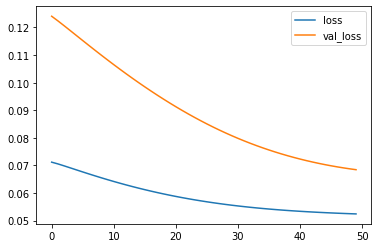

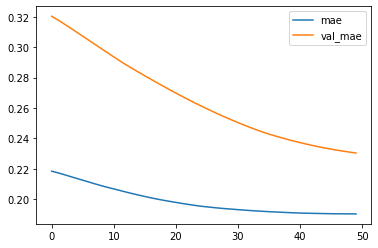

Test MSE: 1586656.537
bestmse=797389.3395878407
Test MAE: 1109.158
bestmae=680.96496
Test MAPE: 61.206
bestmape=26.75028


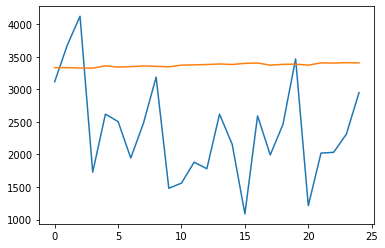

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3332.78013015 3334.13045454 3327.70536661 3325.89350444 3361.51627278
 3342.0540697  3349.15116352 3360.1273554  3353.80857754 3345.61925894
 3371.94857603 3376.49752796 3381.53943723 3389.4970544  3382.13110083
 3399.38001722 3404.59136266 3371.5213272  3384.18384641 3386.68564802
 3371.97813052 3406.23895353 3404.14546293 3410.23426098 3406.62517041]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 16%|█▌        | 20/128 [01:25<07:25,  4.13s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


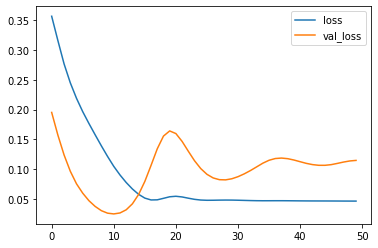

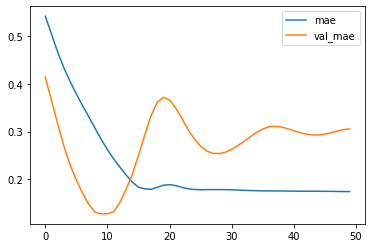

Test MSE: 2657354.441
bestmse=797389.3395878407
Test MAE: 1471.222
bestmae=680.96496
Test MAPE: 79.736
bestmape=26.75028


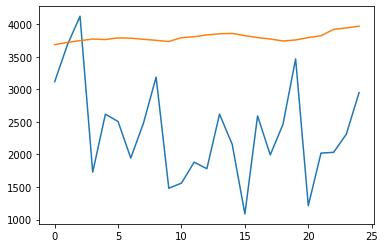

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3686.66153169 3721.5866133  3748.28665268 3772.78359163 3765.35135567
 3789.88588333 3786.1318897  3769.03447592 3753.27935231 3734.97192621
 3794.04790103 3808.74709737 3836.18485117 3853.30952394 3859.78453887
 3824.02418435 3796.00194037 3773.75056851 3742.62912059 3758.97849023
 3795.17039764 3823.50741124 3921.38957429 3943.33076751 3970.30339682]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 16%|█▋        | 21/128 [01:30<07:25,  4.17s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


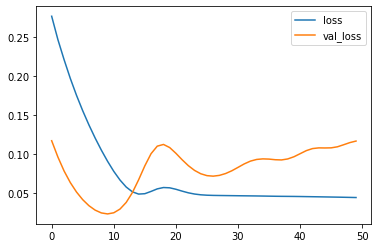

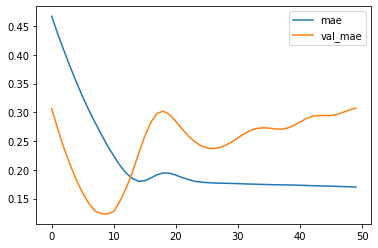

Test MSE: 2702682.108
bestmse=797389.3395878407
Test MAE: 1478.713
bestmae=680.96496
Test MAPE: 80.323
bestmape=26.75028


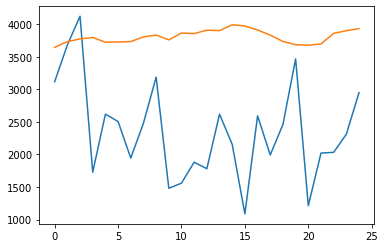

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3645.66658986 3732.93266666 3775.38438642 3796.89144433 3724.31251252
 3728.00739717 3733.41988528 3805.75721633 3834.19781411 3759.6315583
 3865.11123288 3856.32982028 3908.96722114 3902.76766551 3991.80471599
 3973.37046385 3912.0228107  3832.90487707 3735.86343873 3685.18466818
 3678.40291786 3697.66727805 3860.4014529  3900.44261694 3933.14910352]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 17%|█▋        | 22/128 [01:34<07:18,  4.13s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


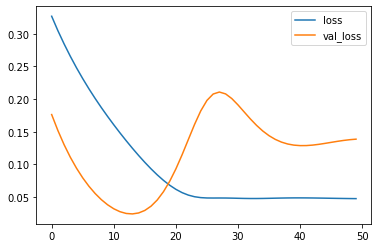

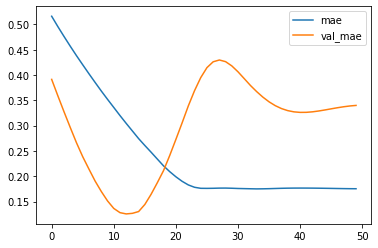

Test MSE: 3214927.500
bestmse=797389.3395878407
Test MAE: 1636.520
bestmae=680.96496
Test MAPE: 87.903
bestmape=26.75028


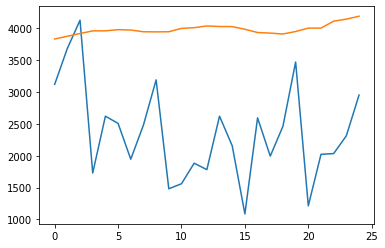

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3828.50814509 3871.73172474 3914.5573231  3955.84034944 3956.62827778
 3975.06884253 3968.91175354 3942.19880199 3940.45078325 3942.148875
 3994.70937681 4006.16188371 4033.22461116 4024.06587672 4022.82717073
 3981.37886882 3930.25764179 3920.68485761 3907.0771687  3945.95709968
 3998.87742019 3999.29347849 4108.49099267 4139.78058553 4185.28359079]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total pa




 18%|█▊        | 23/128 [01:38<07:09,  4.09s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


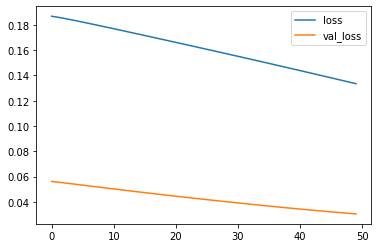

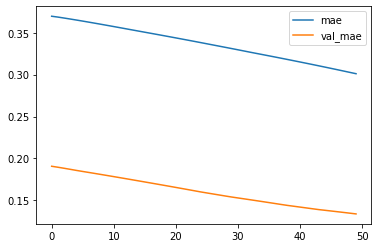

Test MSE: 705833.091
bestmse=705833.0909283493
Test MAE: 644.468
bestmae=644.46753
Test MAPE: 26.402
bestmape=26.40163


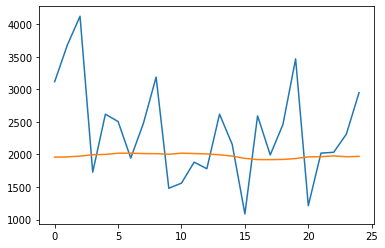

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1958.20312554 1962.07139173 1975.07536569 1996.23178688 2000.89644605
 2019.00409243 2019.6185675  2013.81354991 2012.22305945 2003.28519458
 2019.73384434 2014.85082629 2008.16512805 1995.01524675 1975.31345147
 1939.92460832 1921.4948037  1920.53844348 1923.87422678 1937.23005694
 1962.9227331  1966.04187915 1977.78390524 1965.43443403 1971.03092033]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 19%|█▉        | 24/128 [01:42<07:07,  4.11s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


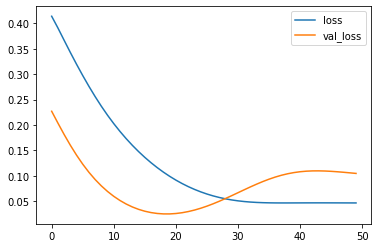

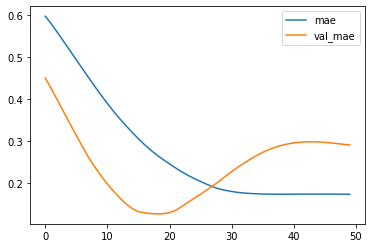

Test MSE: 2427058.124
bestmse=705833.0909283493
Test MAE: 1398.591
bestmae=644.46753
Test MAPE: 76.131
bestmape=26.40163


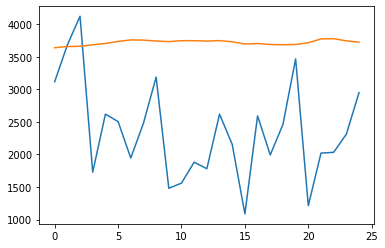

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3639.72441649 3658.0771786  3662.03747976 3685.37433338 3704.41373515
 3736.44563341 3759.46886516 3756.44225621 3742.83341956 3732.85117662
 3747.74233365 3747.71909177 3741.16574311 3749.06396437 3730.353966
 3696.25841856 3703.62121582 3688.99576223 3685.36228204 3688.80494928
 3715.44387114 3775.05125284 3778.46149623 3744.89592099 3724.40576696]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total pa




 20%|█▉        | 25/128 [01:46<07:03,  4.11s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


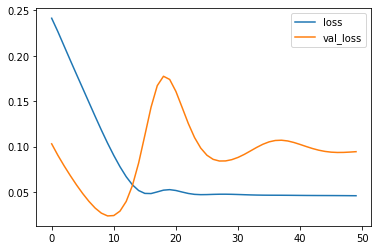

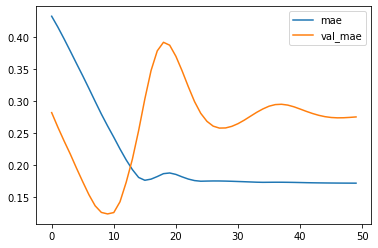

Test MSE: 2189246.474
bestmse=705833.0909283493
Test MAE: 1323.746
bestmae=644.46753
Test MAPE: 72.208
bestmape=26.40163


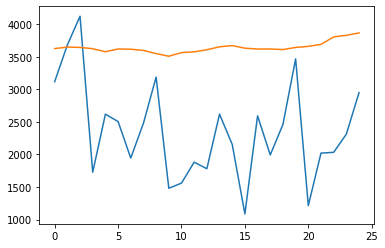

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3625.99592721 3649.95285118 3644.28642404 3624.83440721 3577.31165409
 3620.28186858 3616.63031137 3597.90481842 3549.41394067 3508.49848032
 3564.48098993 3576.71626031 3608.68962348 3653.49938953 3673.04552162
 3632.11657524 3619.10198462 3620.10769796 3611.49758661 3643.64339876
 3660.45846677 3691.0866704  3805.9247874  3829.84498346 3866.80186427]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 20%|██        | 26/128 [01:50<07:00,  4.12s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


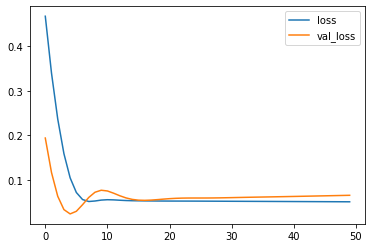

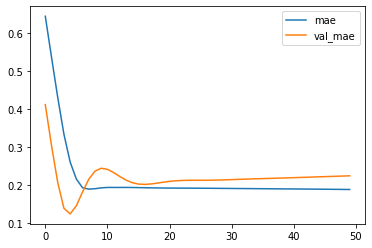

Test MSE: 1520178.610
bestmse=705833.0909283493
Test MAE: 1082.340
bestmae=644.46753
Test MAPE: 59.853
bestmape=26.40163


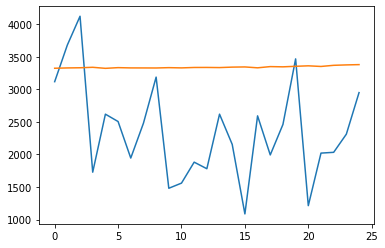

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3324.24447888 3329.1559754  3331.74184948 3338.85329014 3322.80721265
 3333.57910556 3329.45840675 3329.07706779 3328.36718625 3333.46060067
 3329.78063673 3336.12050444 3336.71532434 3334.5544036  3341.51778489
 3344.32861739 3330.87200069 3349.59821099 3346.02269202 3354.19952887
 3361.51655972 3351.7955727  3369.27977723 3375.66498095 3379.97534496]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 21%|██        | 27/128 [01:55<07:20,  4.36s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


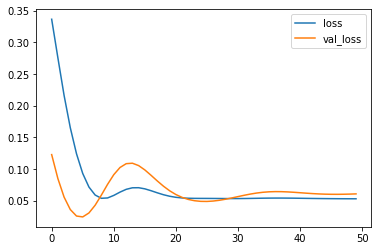

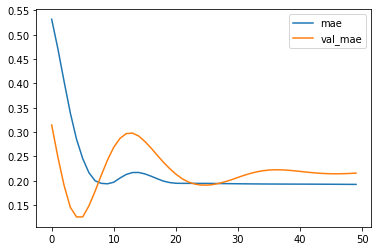

Test MSE: 1406481.520
bestmse=705833.0909283493
Test MAE: 1037.496
bestmae=644.46753
Test MAPE: 57.460
bestmape=26.40163


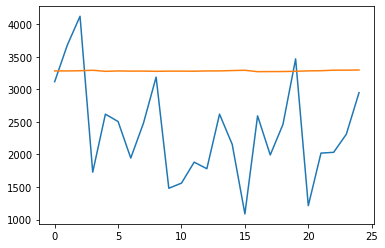

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3283.30132914 3282.85901612 3286.10283619 3293.34612429 3277.03950822
 3282.69359708 3280.09940183 3280.70569921 3277.31511098 3279.95234674
 3280.22809297 3278.74348217 3282.93476743 3283.50462383 3288.8918615
 3293.23866647 3271.6702041  3273.01077265 3273.82266021 3277.68884611
 3284.0687415  3286.44027382 3294.53189045 3294.82901347 3297.68632972]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 22%|██▏       | 28/128 [01:59<07:16,  4.37s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


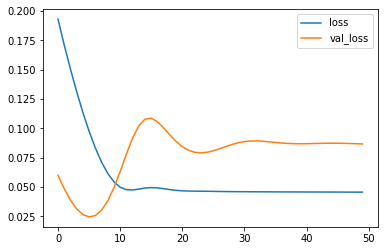

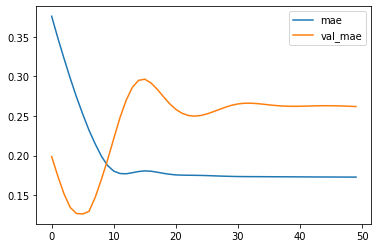

Test MSE: 2010956.520
bestmse=705833.0909283493
Test MAE: 1261.176
bestmae=644.46753
Test MAPE: 69.042
bestmape=26.40163


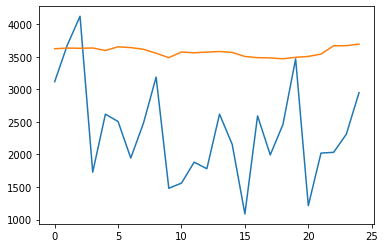

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3624.10415316 3633.955266   3631.00039124 3635.39511466 3597.18747652
 3653.58833992 3641.3051511  3615.9826951  3554.7727716  3487.31480014
 3573.99581289 3562.18090487 3572.06702399 3581.34741962 3566.73975611
 3505.20071614 3486.65111542 3483.05235457 3469.18097079 3491.7270267
 3505.92465758 3541.56851578 3669.5437454  3670.5764308  3694.95802116]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 23%|██▎       | 29/128 [02:04<07:21,  4.46s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


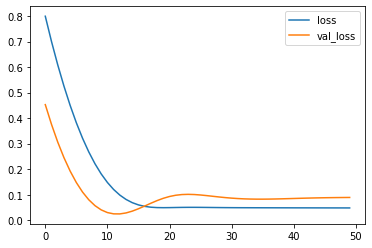

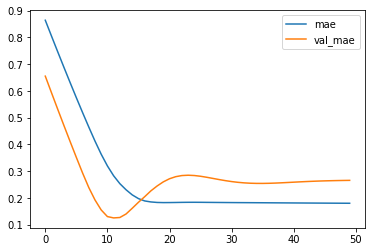

Test MSE: 2066333.374
bestmse=705833.0909283493
Test MAE: 1280.271
bestmae=644.46753
Test MAPE: 70.151
bestmape=26.40163


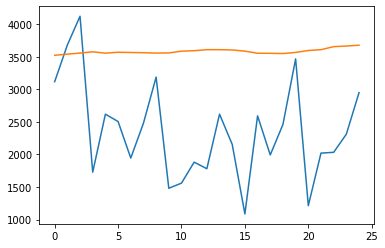

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3523.30814731 3541.04284763 3557.29896283 3576.67350674 3555.87919974
 3569.74369705 3566.64104986 3562.63426495 3557.29781508 3559.15544367
 3586.75416899 3593.79301465 3609.57367563 3609.36535954 3605.3060652
 3586.97080624 3555.03617954 3553.58169711 3550.39469051 3567.25652921
 3596.97399557 3609.37109828 3656.05341363 3665.38660562 3677.95443571]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 23%|██▎       | 30/128 [02:09<07:30,  4.60s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


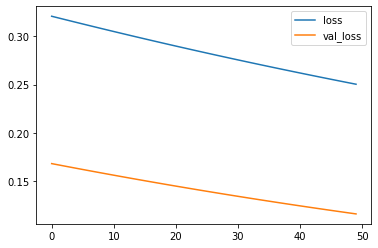

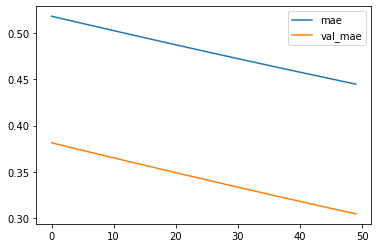

Test MSE: 2689160.168
bestmse=705833.0909283493
Test MAE: 1467.312
bestmae=644.46753
Test MAPE: 58.099
bestmape=26.40163


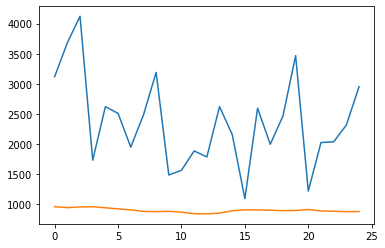

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[953.35479761 938.17144929 948.59125286 953.04390163 934.95874393
 917.42041595 899.50867565 875.4019438  871.34869306 876.61434127
 861.62951732 837.10230655 833.16496033 846.10073301 885.24240411
 901.33671388 899.48356868 894.97876915 886.57412245 890.25539554
 907.35506895 882.79759531 878.03631019 870.22537151 872.50578348]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,161
Trainable p




 24%|██▍       | 31/128 [02:13<07:03,  4.36s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


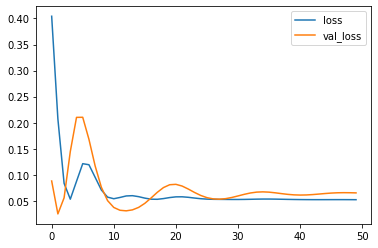

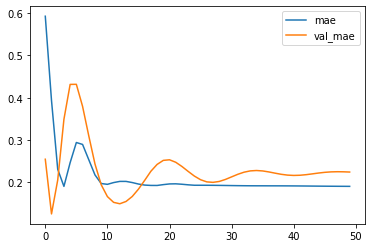

Test MSE: 1514613.959
bestmse=705833.0909283493
Test MAE: 1079.865
bestmae=644.46753
Test MAPE: 59.744
bestmape=26.40163


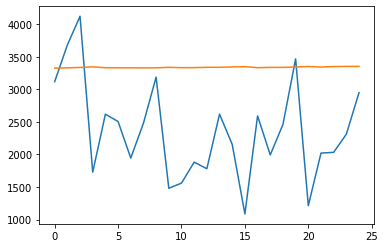

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3326.2893337  3330.4731586  3336.55908728 3345.69902736 3332.47382516
 3331.01374745 3331.31460065 3330.17044032 3330.76224738 3338.41628546
 3333.22531253 3333.48527724 3338.70566118 3338.75200146 3344.17051524
 3348.56853843 3333.04195994 3337.48732769 3337.55590558 3343.46637243
 3351.05843216 3343.1765663  3350.30364501 3352.37260252 3353.09080523]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 25%|██▌       | 32/128 [02:17<07:00,  4.38s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


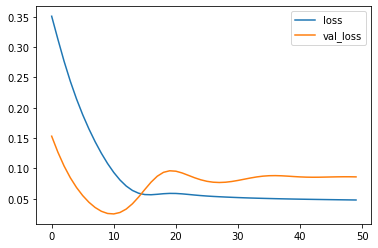

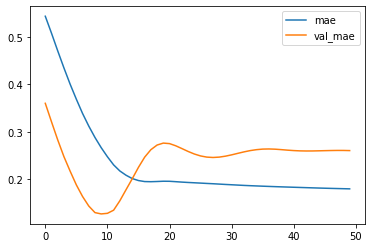

Test MSE: 1991223.530
bestmse=705833.0909283493
Test MAE: 1252.760
bestmae=644.46753
Test MAPE: 68.653
bestmape=26.40163


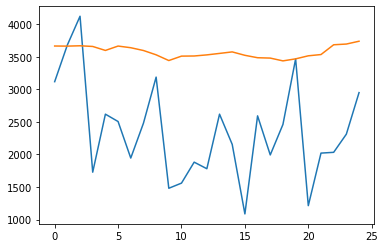

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3665.74154639 3664.1180582  3669.39195585 3658.99709785 3597.81701577
 3665.11229408 3639.55655849 3596.79121685 3530.59806263 3442.64606351
 3510.43673813 3512.52190757 3529.57742858 3552.12750161 3575.38143051
 3523.01059389 3485.89675868 3480.3494103  3437.41836268 3468.42489243
 3515.35712969 3534.68777227 3684.92269492 3695.90032148 3739.23953664]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 26%|██▌       | 33/128 [02:22<06:54,  4.36s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


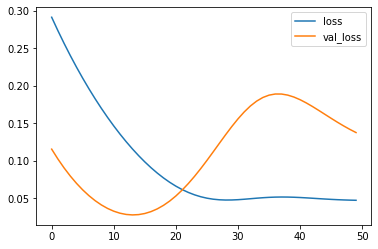

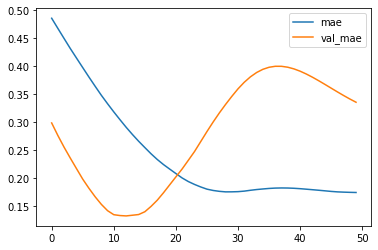

Test MSE: 3186121.854
bestmse=705833.0909283493
Test MAE: 1615.993
bestmae=644.46753
Test MAPE: 87.266
bestmape=26.40163


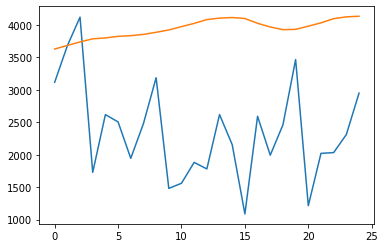

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3630.80326569 3685.53616571 3739.62604046 3787.84059811 3802.1484127
 3825.98597097 3836.929739   3856.17372668 3888.52728105 3924.51689804
 3976.22376299 4026.19408667 4084.5699358  4107.24568713 4116.50398862
 4101.43693936 4027.30682743 3970.45719492 3929.71733987 3933.92211115
 3983.03793716 4034.27451277 4098.8949666  4126.95910335 4136.25327194]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 27%|██▋       | 34/128 [02:25<06:38,  4.24s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


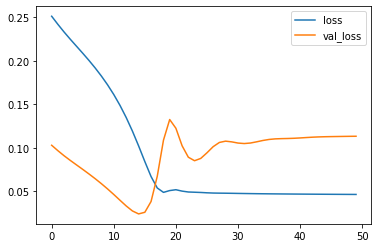

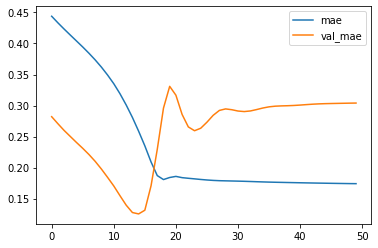

Test MSE: 2629318.701
bestmse=705833.0909283493
Test MAE: 1463.377
bestmae=644.46753
Test MAPE: 79.167
bestmape=26.40163


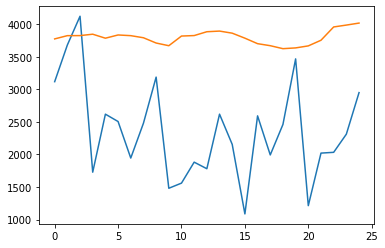

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3774.97980559 3824.82186854 3825.6528374  3847.17596376 3785.84294438
 3835.40093994 3824.81412125 3792.71622753 3711.71111083 3670.42091107
 3818.7611903  3826.19916499 3885.13626242 3895.0602572  3863.00396931
 3786.2521162  3701.7047652  3670.67083299 3624.92651391 3636.65935802
 3667.73805237 3754.32007194 3958.45663881 3987.32706785 4017.97277462]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 27%|██▋       | 35/128 [02:30<06:49,  4.41s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


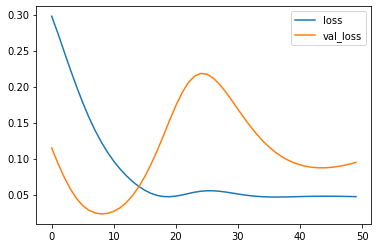

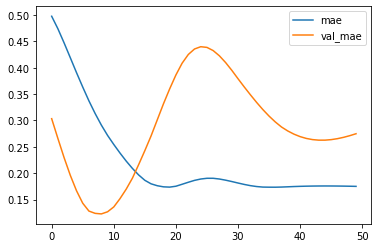

Test MSE: 2192984.089
bestmse=705833.0909283493
Test MAE: 1322.821
bestmae=644.46753
Test MAPE: 72.203
bestmape=26.40163


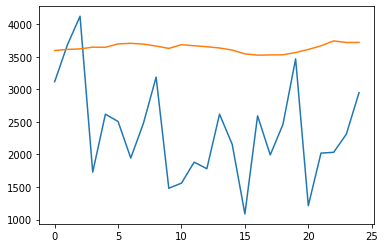

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3595.67933691 3613.66768932 3621.3974787  3648.04242623 3646.05395448
 3697.67846859 3707.32212615 3694.96175134 3664.94242752 3629.04692578
 3685.94562447 3670.31359673 3654.57855868 3635.33715343 3603.36752045
 3545.00343573 3525.4561559  3528.6331197  3530.72316706 3565.96215749
 3612.91304564 3668.45941138 3744.13984263 3719.51091278 3721.52865207]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 28%|██▊       | 36/128 [02:34<06:29,  4.23s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


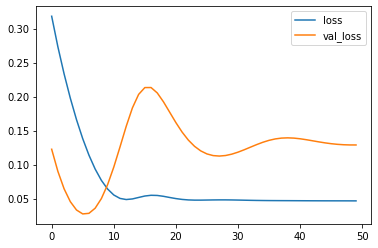

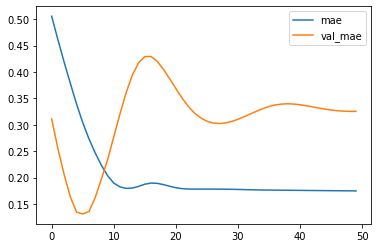

Test MSE: 2986101.055
bestmse=705833.0909283493
Test MAE: 1566.587
bestmae=644.46753
Test MAPE: 84.514
bestmape=26.40163


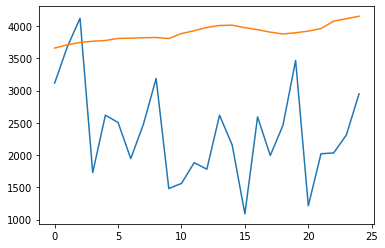

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3661.19101632 3710.57799757 3748.1563834  3766.1071471  3778.32089722
 3810.39956617 3814.44738305 3821.03774655 3824.20610225 3808.72242081
 3886.2624892  3928.98565114 3981.1094352  4011.33248413 4016.04800284
 3976.98328459 3945.59527242 3907.90957224 3879.41216099 3898.53047037
 3923.72437871 3963.96955478 4078.87165868 4116.50857961 4154.58078361]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 29%|██▉       | 37/128 [02:39<06:38,  4.38s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


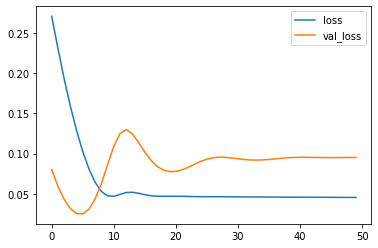

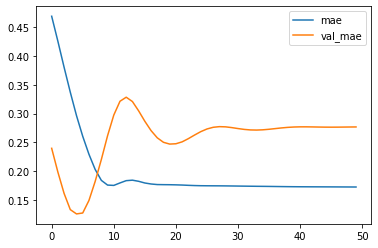

Test MSE: 2207081.111
bestmse=705833.0909283493
Test MAE: 1332.414
bestmae=644.46753
Test MAPE: 72.540
bestmape=26.40163


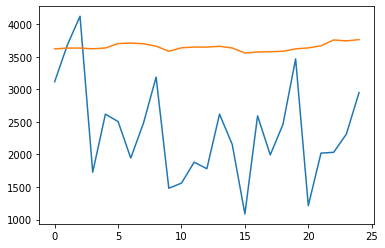

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3621.5903002  3634.09270871 3634.18452847 3622.97046602 3635.10157835
 3703.38678849 3710.81328571 3700.70909464 3663.58980763 3584.99323809
 3638.27509892 3650.12329161 3648.74685597 3661.73303986 3635.51476729
 3558.42949367 3574.34931898 3578.57589746 3585.029966   3621.90478289
 3637.00454295 3668.92568362 3758.680076   3744.41702354 3763.75627422]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 30%|██▉       | 38/128 [02:43<06:41,  4.46s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


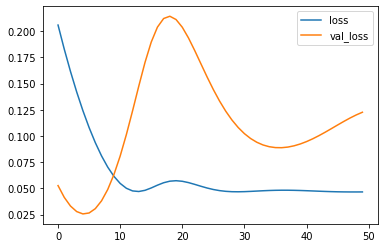

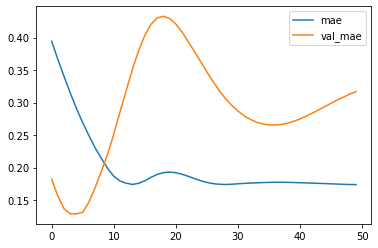

Test MSE: 2842952.237
bestmse=705833.0909283493
Test MAE: 1525.545
bestmae=644.46753
Test MAPE: 82.527
bestmape=26.40163


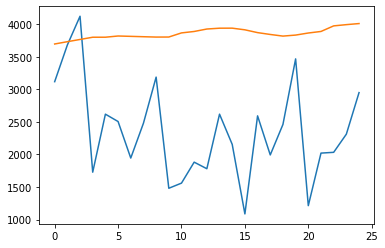

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3696.83487451 3732.06755233 3766.40756989 3800.65835011 3800.89937699
 3819.53936279 3814.12084901 3808.51353085 3803.11969364 3803.80145538
 3867.05436862 3889.06873071 3926.77738583 3939.37247491 3939.95323491
 3914.51141322 3871.47204697 3843.1852473  3818.06995964 3833.68620586
 3865.44666195 3889.33500803 3974.93742549 3994.00265157 4010.60251701]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 30%|███       | 39/128 [02:48<06:34,  4.43s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


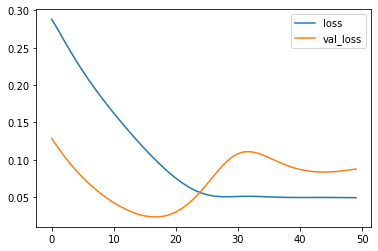

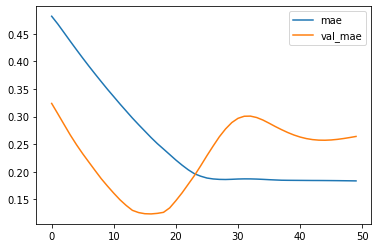

Test MSE: 2033178.427
bestmse=705833.0909283493
Test MAE: 1271.444
bestmae=644.46753
Test MAPE: 69.564
bestmape=26.40163


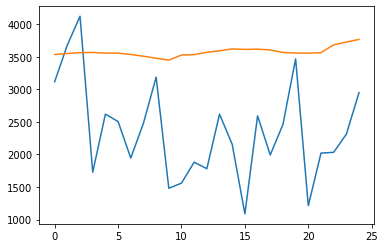

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3534.92879915 3550.36169279 3563.81816602 3567.39311111 3556.54431915
 3556.90442479 3535.35059619 3509.01927054 3478.83036709 3448.70057261
 3527.48967671 3533.16499889 3569.11874878 3592.39993668 3621.51971376
 3613.67084563 3617.888816   3605.79902256 3566.4711833  3558.66994667
 3555.48007071 3563.7470057  3683.73391593 3726.54315889 3766.92089975]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 31%|███▏      | 40/128 [02:52<06:22,  4.35s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


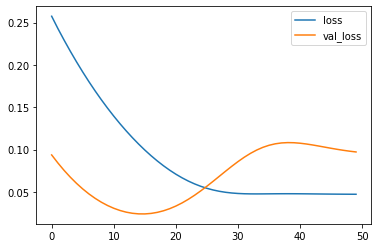

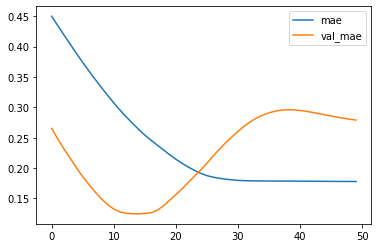

Test MSE: 2251351.952
bestmse=705833.0909283493
Test MAE: 1343.272
bestmae=644.46753
Test MAPE: 73.273
bestmape=26.40163


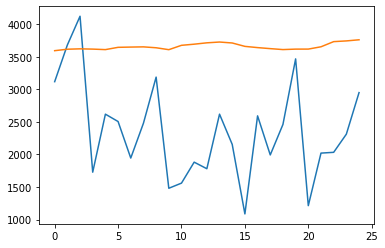

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3594.14479911 3616.52471864 3622.31338084 3618.29684007 3610.50937641
 3645.57218766 3649.48457038 3652.63140583 3638.85987604 3609.52948737
 3676.41559386 3693.86307049 3714.75809228 3726.9655298  3712.29847038
 3660.26076734 3641.35909522 3625.57986891 3611.01409817 3618.05179608
 3618.52294624 3653.86092985 3733.14499986 3744.04917061 3761.47598779]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 32%|███▏      | 41/128 [02:56<06:13,  4.29s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


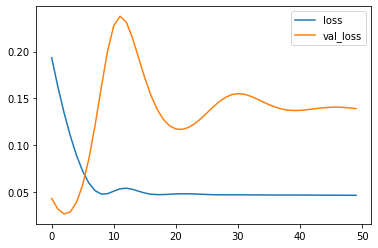

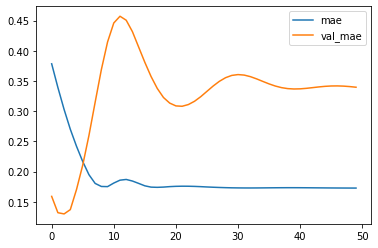

Test MSE: 3218620.938
bestmse=705833.0909283493
Test MAE: 1635.112
bestmae=644.46753
Test MAPE: 87.903
bestmape=26.40163


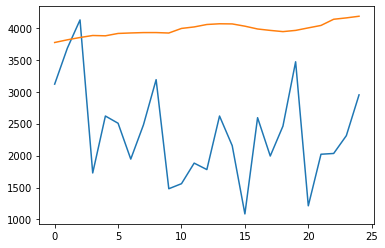

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3769.54206705 3811.62736857 3847.87350702 3879.2818917  3874.31472945
 3911.29944313 3918.93626499 3924.68906009 3924.95820677 3917.94317687
 3989.76000464 4013.2314316  4051.40721977 4062.63247275 4060.3613683
 4025.00588155 3981.09910548 3958.95992589 3939.98307633 3958.99177587
 3998.39737499 4036.63514149 4133.29495394 4154.78881276 4180.52130139]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 33%|███▎      | 42/128 [03:01<06:15,  4.37s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


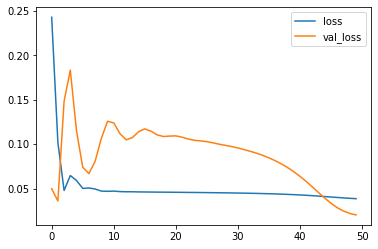

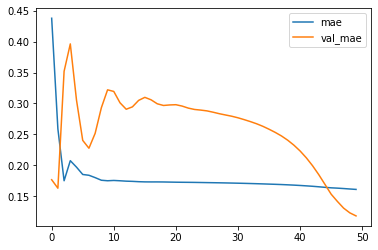

Test MSE: 470928.387
bestmse=470928.3870781320
Test MAE: 569.472
bestmae=569.47168
Test MAPE: 29.880
bestmape=26.40163


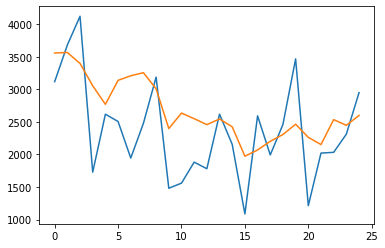

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3558.27569556 3566.46200132 3398.19568574 3055.20224303 2769.96500951
 3138.5636844  3208.79389536 3256.09542024 3007.73572952 2397.68063194
 2635.78764182 2549.92884636 2458.24953872 2545.13155067 2424.86846381
 1973.01035357 2069.06530333 2202.57231501 2306.73028713 2464.65310639
 2262.66340035 2152.04884899 2535.01946884 2448.11091524 2600.07075822]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 34%|███▎      | 43/128 [03:06<06:45,  4.77s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


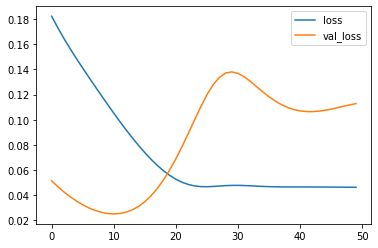

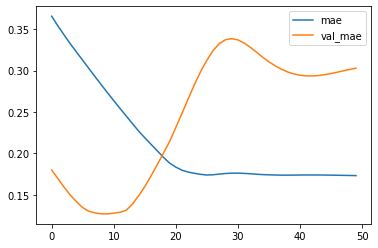

Test MSE: 2614659.777
bestmse=470928.3870781320
Test MAE: 1457.705
bestmae=569.47168
Test MAPE: 79.033
bestmape=26.40163


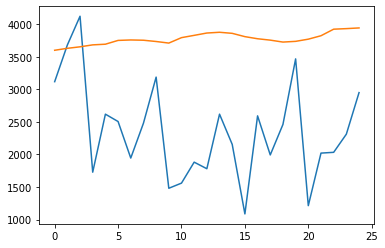

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3600.45511234 3630.34933174 3653.45290577 3683.33105671 3693.54227519
 3751.74739695 3758.73688948 3754.58089745 3735.11109054 3710.81988525
 3794.30557024 3829.42433417 3865.22830307 3876.81107926 3860.40604389
 3809.67734635 3777.35650277 3756.12260866 3726.29954958 3737.3885076
 3770.9334234  3823.65661836 3924.29423511 3932.80219698 3943.39331973]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 34%|███▍      | 44/128 [03:11<06:27,  4.61s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


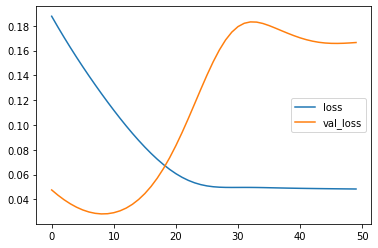

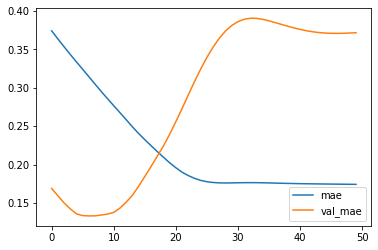

Test MSE: 3857090.961
bestmse=470928.3870781320
Test MAE: 1789.020
bestmae=569.47168
Test MAPE: 95.835
bestmape=26.40163


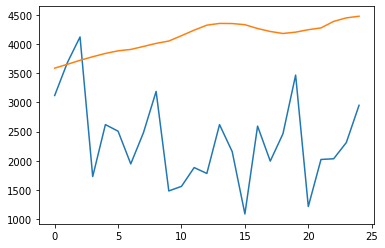

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3587.31426954 3653.57772326 3722.02476573 3783.46108234 3839.80628002
 3884.79710317 3908.57612634 3959.71112633 4012.34278846 4052.65941179
 4144.45995021 4239.78464592 4324.79281735 4354.7716831  4352.62137902
 4332.87094796 4267.30188119 4216.77518713 4182.07850718 4205.00848448
 4246.84702039 4277.88583052 4389.43536532 4449.95233655 4477.84258962]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 35%|███▌      | 45/128 [03:15<06:14,  4.51s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


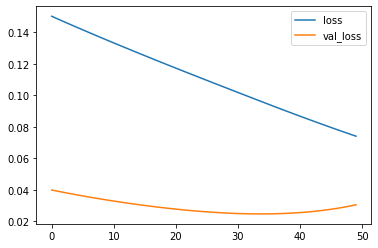

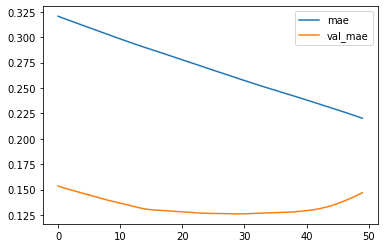

Test MSE: 706873.075
bestmse=470928.3870781320
Test MAE: 707.346
bestmae=569.47168
Test MAPE: 37.818
bestmape=26.40163


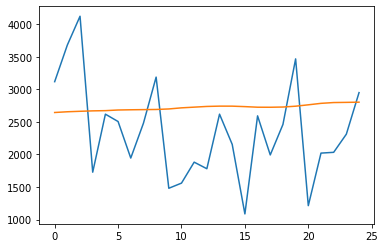

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2644.65872216 2655.96374357 2663.19182402 2669.67688173 2673.12973523
 2682.99749041 2686.36899734 2688.79016972 2691.06902146 2699.12376672
 2716.13151276 2726.86366493 2737.70470959 2742.37546617 2742.04132831
 2734.91754937 2725.84546983 2725.11865902 2728.61555731 2741.42699671
 2762.66433406 2785.17638797 2797.50950378 2800.21187419 2803.30089188]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 36%|███▌      | 46/128 [03:19<06:04,  4.44s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


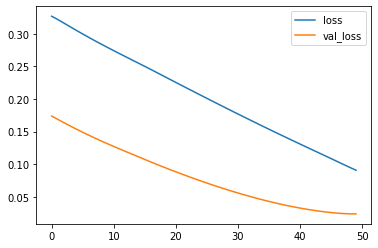

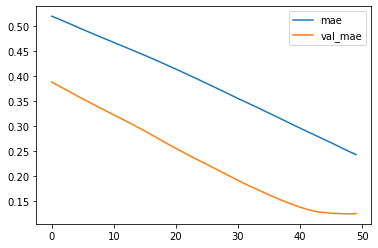

Test MSE: 550259.488
bestmse=470928.3870781320
Test MAE: 598.832
bestmae=569.47168
Test MAPE: 28.944
bestmape=26.40163


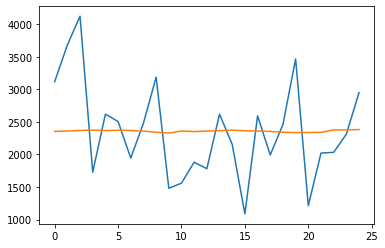

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2354.53466868 2359.99593604 2368.69671941 2374.58007073 2367.47566003
 2371.9000814  2368.8274191  2358.05739129 2342.18031955 2327.43550026
 2361.13019705 2351.6302948  2359.90870726 2365.77398157 2373.86861104
 2363.02311885 2360.17326295 2353.88676548 2341.28364217 2336.63526666
 2337.43381166 2340.49930054 2377.46349823 2376.57055104 2382.75532943]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 37%|███▋      | 47/128 [03:23<05:52,  4.35s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


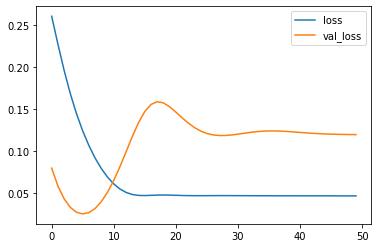

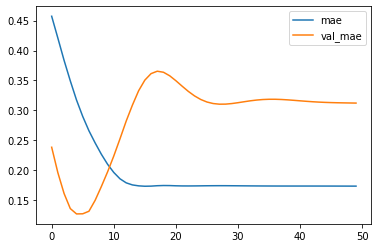

Test MSE: 2760068.793
bestmse=470928.3870781320
Test MAE: 1502.526
bestmae=569.47168
Test MAPE: 81.283
bestmape=26.40163


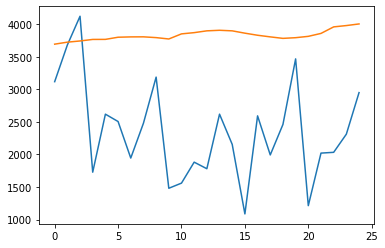

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3694.29261482 3724.95725942 3743.22767067 3766.90196192 3767.66062272
 3800.70397305 3805.7623812  3806.74255717 3794.75060916 3773.78184462
 3852.10668504 3871.15268636 3898.8039211  3907.40685904 3898.78010535
 3863.00167382 3831.06905568 3806.02378058 3783.17730188 3793.63643372
 3814.24681425 3859.30219817 3959.57138813 3979.80071664 4004.75618052]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 38%|███▊      | 48/128 [03:28<05:54,  4.43s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


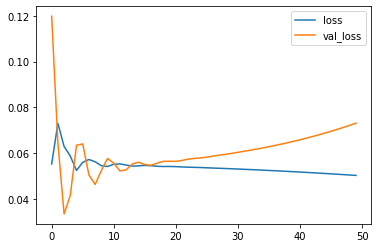

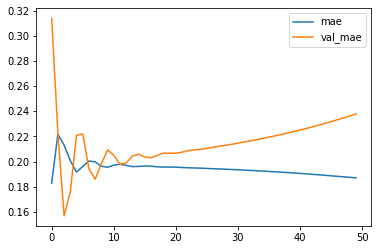

Test MSE: 1692902.397
bestmse=470928.3870781320
Test MAE: 1145.792
bestmae=569.47168
Test MAPE: 63.262
bestmape=26.40163


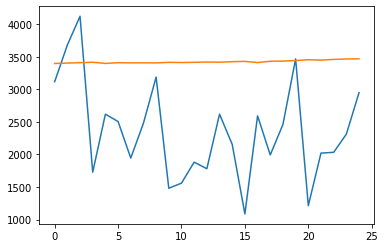

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3397.0084849  3404.31532949 3409.59324425 3416.77498442 3398.06512952
 3409.59683096 3406.78470725 3407.69300556 3406.30796182 3415.15250051
 3412.44783461 3415.6734342  3419.70446527 3417.4629153  3424.98281044
 3429.77063721 3411.90064621 3431.56284422 3434.3329317  3442.74720871
 3455.41604054 3449.08793724 3459.94103324 3466.18076003 3469.60821962]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 38%|███▊      | 49/128 [03:34<06:18,  4.79s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


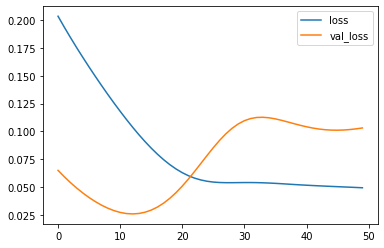

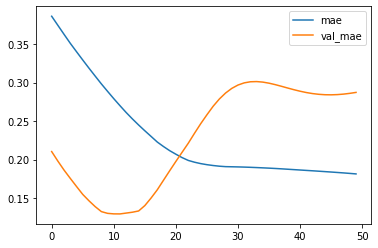

Test MSE: 2387234.194
bestmse=470928.3870781320
Test MAE: 1383.061
bestmae=569.47168
Test MAPE: 75.445
bestmape=26.40163


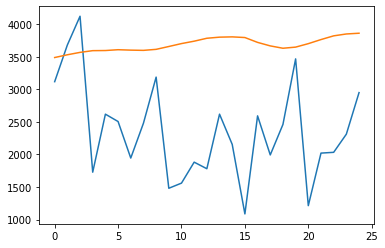

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3488.81834877 3531.18083119 3567.95292473 3594.43460524 3596.44144094
 3608.93954539 3602.53396916 3598.89704573 3614.56264508 3658.30328476
 3703.09669542 3739.98815465 3784.9204427  3801.82159173 3806.11244404
 3795.98156786 3721.36624587 3667.59888804 3631.42190135 3648.84642303
 3702.03244698 3764.76342225 3821.89310503 3850.70299041 3862.18304324]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 39%|███▉      | 50/128 [03:38<05:56,  4.57s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


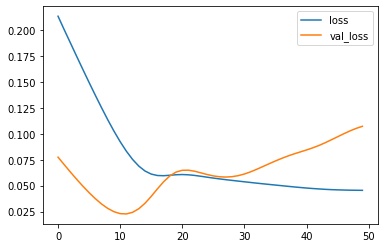

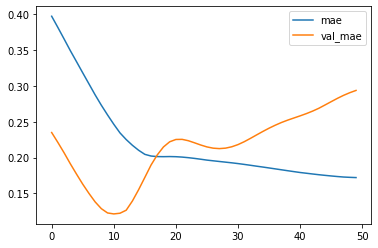

Test MSE: 2483817.950
bestmse=470928.3870781320
Test MAE: 1414.368
bestmae=569.47168
Test MAPE: 76.907
bestmape=26.40163


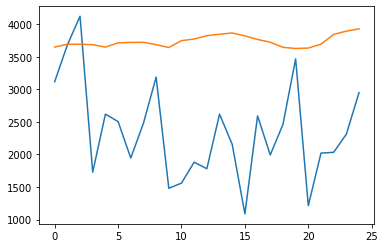

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3649.77007246 3692.17473459 3692.20629764 3686.12782931 3648.4668057
 3714.8542161  3721.43080664 3721.94298875 3686.26412427 3642.57484627
 3748.27833152 3773.08344054 3825.05486119 3846.43021512 3866.009058
 3820.63804364 3766.36883342 3724.61465693 3645.4975841  3627.91467333
 3634.3939923  3694.22403693 3843.69742942 3894.07950735 3929.51734495]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total par




 40%|███▉      | 51/128 [03:42<05:43,  4.46s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


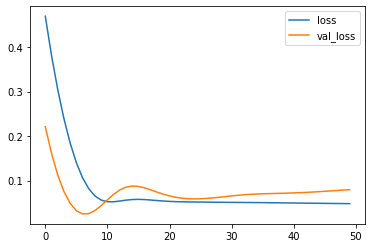

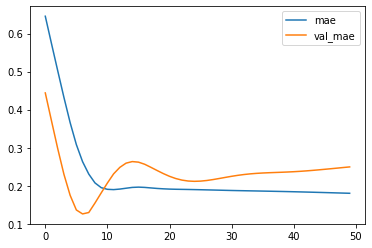

Test MSE: 1840370.387
bestmse=470928.3870781320
Test MAE: 1200.602
bestmae=569.47168
Test MAPE: 66.063
bestmape=26.40163


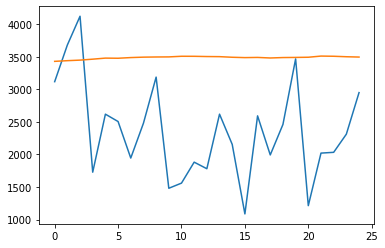

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3430.21668041 3440.6052258  3449.12954307 3463.7475363  3479.9256047
 3477.83670509 3488.20659959 3494.70858657 3497.25859356 3498.5655905
 3508.22187328 3507.62676644 3504.08137584 3502.37582374 3493.05210066
 3487.61924005 3490.44786263 3481.98208046 3488.4416008  3490.48487747
 3493.29513609 3511.11333501 3508.3851403  3501.06538355 3496.11830688]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total pa




 41%|████      | 52/128 [03:46<05:37,  4.44s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


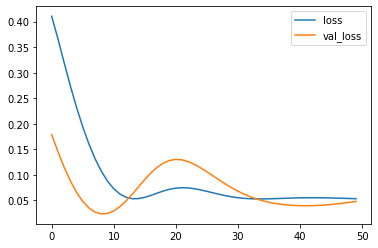

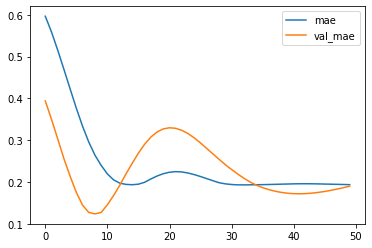

Test MSE: 1116579.807
bestmse=470928.3870781320
Test MAE: 913.296
bestmae=569.47168
Test MAPE: 50.674
bestmape=26.40163


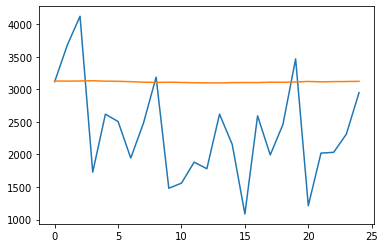

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3127.7246483  3126.78736937 3128.53911829 3132.34691256 3125.96744758
 3124.10895818 3118.01556915 3110.02509773 3107.05530226 3109.84117126
 3106.27282572 3102.09258753 3099.66854578 3098.37360018 3103.46701461
 3105.00356096 3104.28248888 3110.19711632 3109.04822153 3113.49172419
 3121.61691242 3115.21535331 3118.81153172 3120.45022756 3123.75172192]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 41%|████▏     | 53/128 [03:50<05:22,  4.30s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


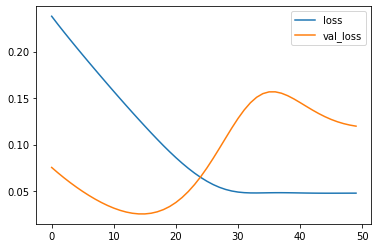

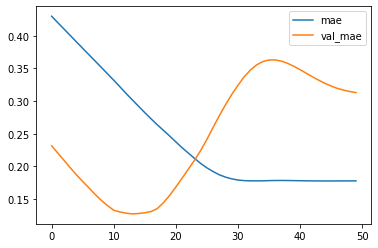

Test MSE: 2777615.982
bestmse=470928.3870781320
Test MAE: 1506.381
bestmae=569.47168
Test MAPE: 81.593
bestmape=26.40163


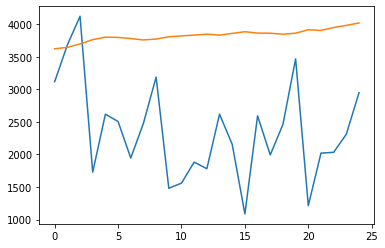

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3622.97936106 3645.1205492  3697.2133441  3763.63403916 3801.90968132
 3797.76401901 3780.23677397 3758.67634583 3772.6335237  3806.14888501
 3820.6736238  3833.67645001 3847.43564153 3833.13040936 3859.63705337
 3885.44500637 3864.21742487 3862.14459372 3847.06606698 3862.79880953
 3914.71743381 3904.70477557 3949.853127   3982.7782594  4019.59597588]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 42%|████▏     | 54/128 [03:54<05:11,  4.21s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


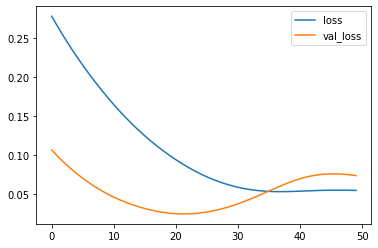

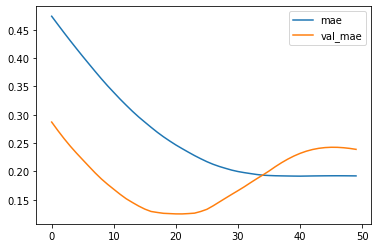

Test MSE: 1699895.705
bestmse=470928.3870781320
Test MAE: 1149.549
bestmae=569.47168
Test MAPE: 63.417
bestmape=26.40163


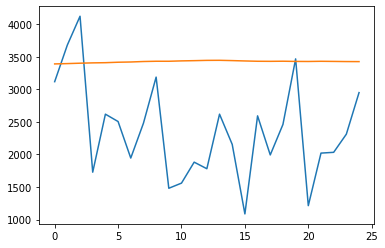

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3390.7674669  3395.76920503 3401.79946798 3406.80221039 3409.67086065
 3416.6979419  3420.39741755 3427.7711184  3431.76671278 3431.5638485
 3437.35078907 3440.84453106 3445.23495042 3446.23836827 3441.77018905
 3436.28854918 3431.60028946 3430.54823583 3432.29926741 3429.25716388
 3428.33294058 3431.1368866  3429.23793912 3427.04315984 3426.18493199]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 43%|████▎     | 55/128 [03:58<05:06,  4.20s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


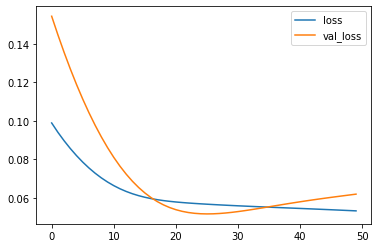

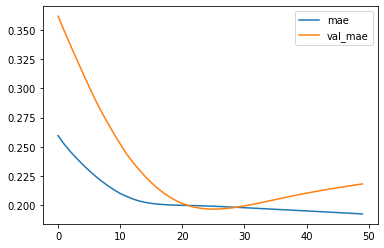

Test MSE: 1435668.487
bestmse=470928.3870781320
Test MAE: 1050.717
bestmae=569.47168
Test MAPE: 58.106
bestmape=26.40163


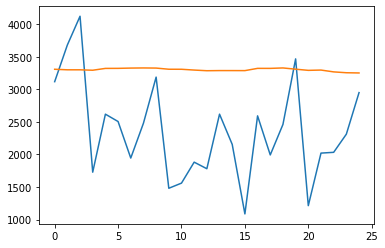

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3308.64602274 3300.35139835 3300.19946533 3293.80594045 3321.92301702
 3322.62701637 3326.80395478 3328.8546918  3326.86622006 3309.07700175
 3308.56281108 3296.38822782 3286.28733653 3288.52142614 3288.40005189
 3287.81986576 3322.52917093 3322.26719767 3328.86301297 3309.87181658
 3291.98704833 3296.38822782 3268.45392996 3255.28869754 3251.9916507 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 44%|████▍     | 56/128 [04:02<04:58,  4.15s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


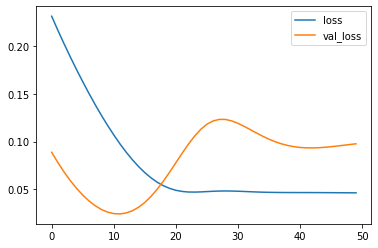

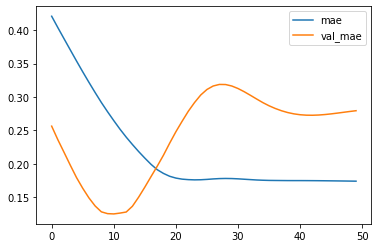

Test MSE: 2265171.275
bestmse=470928.3870781320
Test MAE: 1345.405
bestmae=569.47168
Test MAPE: 73.343
bestmape=26.40163


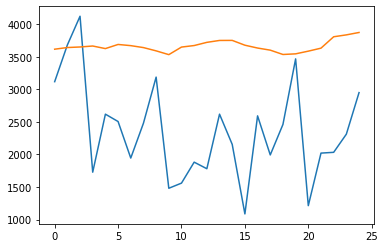

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3616.85354817 3642.40124953 3650.85239792 3665.81299365 3626.18444467
 3689.66977668 3671.47052574 3641.5697068  3591.37098145 3533.3586812
 3649.49002218 3672.96317077 3721.95848334 3751.22000718 3752.09975529
 3678.26604903 3634.6281327  3602.29609859 3535.6277771  3545.50471425
 3586.85689235 3632.84711623 3807.8113966  3836.82098997 3873.70642352]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 45%|████▍     | 57/128 [04:07<05:00,  4.23s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


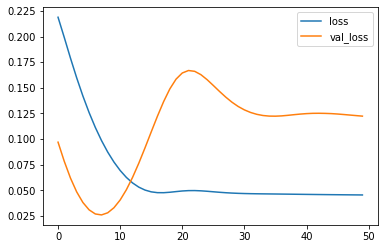

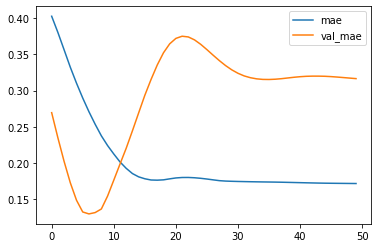

Test MSE: 2836739.504
bestmse=470928.3870781320
Test MAE: 1524.026
bestmae=569.47168
Test MAPE: 82.393
bestmape=26.40163


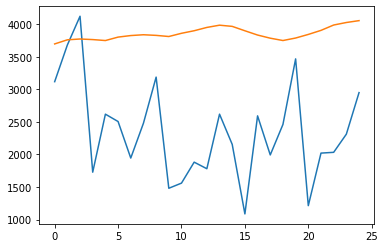

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3697.81505048 3760.89580166 3773.4983511  3764.65409935 3749.78561032
 3802.59115613 3826.38050902 3838.77043831 3829.13510191 3811.63339424
 3861.08034527 3900.43601739 3951.13171721 3985.67172968 3967.37635493
 3899.82914615 3834.28217351 3786.01080239 3750.08172905 3788.35421491
 3843.73530507 3905.96299326 3988.1821394  4026.84485924 4055.50525057]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 45%|████▌     | 58/128 [04:11<04:58,  4.26s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


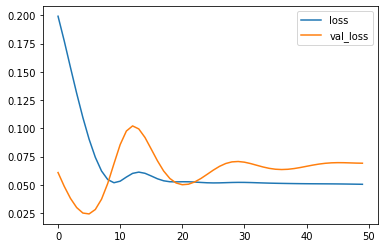

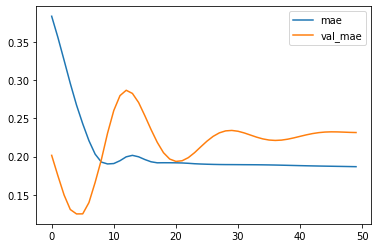

Test MSE: 1600374.111
bestmse=470928.3870781320
Test MAE: 1113.643
bestmae=569.47168
Test MAPE: 61.478
bestmape=26.40163


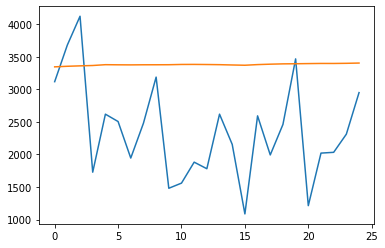

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3345.79070365 3354.5084163  3360.96363258 3366.46478415 3378.96417981
 3377.09048277 3376.02752554 3377.5422647  3377.78759563 3378.41641754
 3382.53797716 3383.19807518 3381.5282467  3379.12515134 3374.53602827
 3370.46382177 3380.40732825 3386.73198831 3391.55338669 3393.44315219
 3395.85973358 3398.04360926 3397.81305557 3400.01299971 3404.08678436]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 46%|████▌     | 59/128 [04:15<04:54,  4.27s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


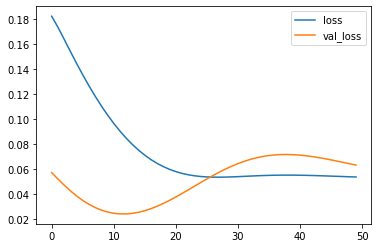

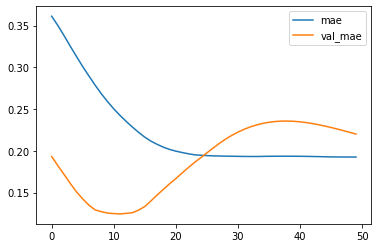

Test MSE: 1462326.383
bestmse=470928.3870781320
Test MAE: 1059.837
bestmae=569.47168
Test MAPE: 58.638
bestmape=26.40163


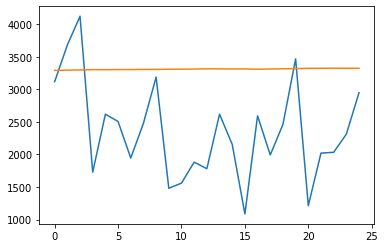

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3291.59294069 3294.60821563 3297.89191991 3303.09365296 3302.0444687
 3303.70052421 3304.13265097 3306.15985918 3305.97062439 3309.21157509
 3309.67325634 3311.95827723 3315.57267612 3314.75002843 3312.93787932
 3313.05523646 3309.27154487 3312.76916051 3315.66894341 3318.33559018
 3323.45812869 3323.82913792 3324.65235949 3324.08293349 3323.1772176 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 47%|████▋     | 60/128 [04:20<04:51,  4.28s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


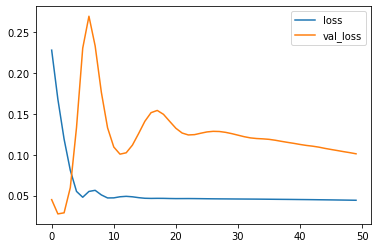

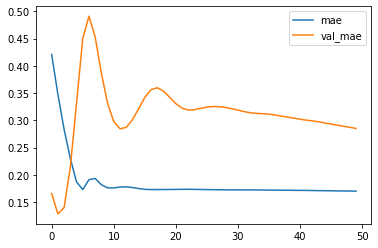

Test MSE: 2345513.633
bestmse=470928.3870781320
Test MAE: 1372.991
bestmae=569.47168
Test MAPE: 74.782
bestmape=26.40163


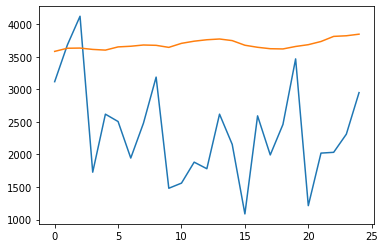

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3583.2245599  3631.42534459 3634.20777035 3613.58878171 3602.75978839
 3652.05695844 3662.25641251 3681.31991696 3676.1980958  3644.87579215
 3706.82400393 3739.90551686 3761.93365192 3773.44555473 3748.8183465
 3677.62072825 3646.17245936 3624.29984403 3620.79749393 3658.73885477
 3686.28966165 3735.14810538 3813.43535709 3823.14615786 3847.54352975]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 48%|████▊     | 61/128 [04:25<04:59,  4.47s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


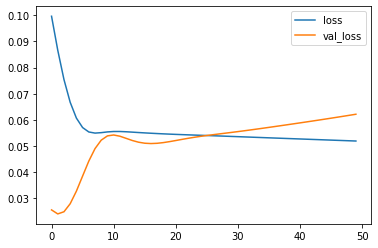

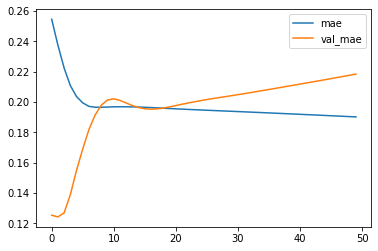

Test MSE: 1439985.013
bestmse=470928.3870781320
Test MAE: 1051.033
bestmae=569.47168
Test MAPE: 58.125
bestmape=26.40163


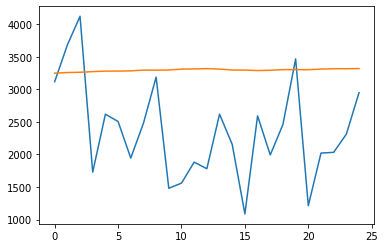

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3249.197604   3258.19335836 3262.89783001 3272.68352127 3280.45362526
 3280.59508508 3284.13889754 3295.79527301 3295.19686639 3297.24487752
 3310.73520929 3314.09810811 3318.26529068 3311.28297156 3296.99854231
 3295.97934294 3288.95843083 3293.17238408 3303.17901665 3302.92349946
 3301.77259612 3311.37751722 3316.673509   3316.88469446 3319.16541129]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 48%|████▊     | 62/128 [04:29<05:02,  4.58s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


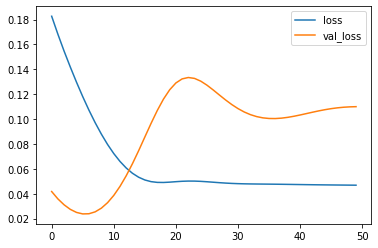

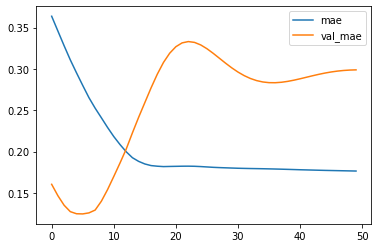

Test MSE: 2549492.215
bestmse=470928.3870781320
Test MAE: 1438.581
bestmae=569.47168
Test MAPE: 78.102
bestmape=26.40163


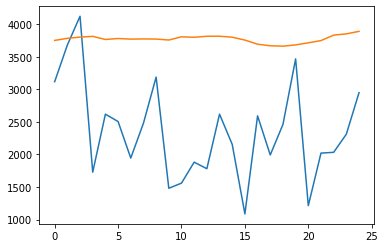

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3751.83319104 3783.59967279 3802.68785381 3813.95471263 3766.21933937
 3780.92915237 3771.80312872 3774.53935766 3772.45045805 3757.71482074
 3807.23350596 3799.96597171 3815.55897605 3816.2103225  3800.81444371
 3756.89217305 3693.50439954 3669.56670034 3663.58263421 3682.59449005
 3715.0946691  3749.06912923 3833.03285086 3851.97039008 3891.07700109]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 49%|████▉     | 63/128 [04:34<04:46,  4.41s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


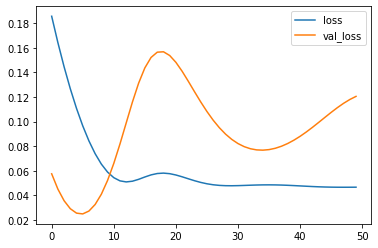

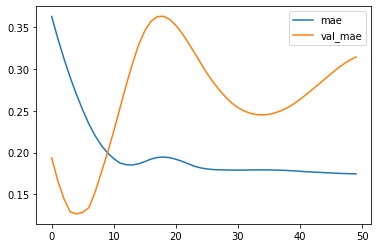

Test MSE: 2791432.726
bestmse=470928.3870781320
Test MAE: 1513.408
bestmae=569.47168
Test MAPE: 81.795
bestmape=26.40163


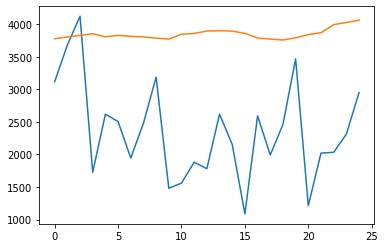

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3777.28706408 3805.61518264 3828.91129124 3855.4136312  3805.37243414
 3829.71844435 3814.70763469 3805.66625738 3786.24236035 3773.22289181
 3846.866359   3858.40351224 3896.19537902 3899.68739939 3894.75380874
 3860.39887047 3789.76336133 3772.42865086 3757.84078598 3791.78339612
 3840.9129951  3869.77682459 3994.29991806 4026.60182381 4063.14666343]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 50%|█████     | 64/128 [04:37<04:33,  4.28s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


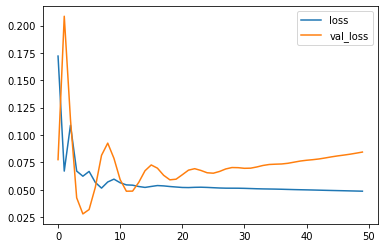

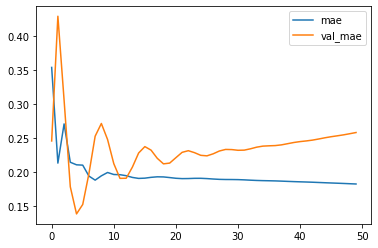

Test MSE: 1955600.877
bestmse=470928.3870781320
Test MAE: 1243.233
bestmae=569.47168
Test MAPE: 68.230
bestmape=26.40163


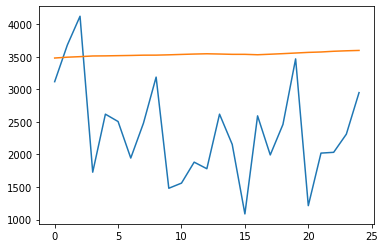

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3481.27564216 3494.15680718 3502.35372961 3512.68804395 3514.42458522
 3517.71001112 3520.8031894  3525.13449979 3525.68054044 3530.44282985
 3536.60020578 3542.31426442 3546.60282123 3542.68756914 3537.89342976
 3537.81050503 3531.60463679 3539.83053982 3548.55083489 3558.1534605
 3567.81662977 3574.02737594 3585.06497228 3592.30209124 3597.90969634]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 51%|█████     | 65/128 [04:42<04:41,  4.48s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


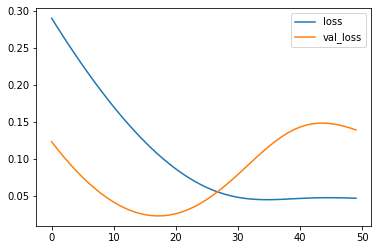

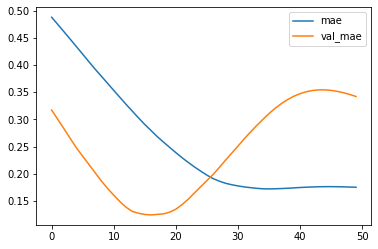

Test MSE: 3237123.291
bestmse=470928.3870781320
Test MAE: 1648.063
bestmae=569.47168
Test MAPE: 88.250
bestmape=26.40163


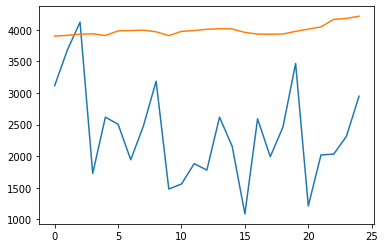

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3901.34675467 3914.22218096 3932.11670506 3938.11827433 3910.87821996
 3984.98422921 3989.73676276 3995.45282996 3970.91772842 3908.41257238
 3977.0200125  3989.81739199 4009.84615171 4019.00660777 4014.01218653
 3960.75385451 3933.87763596 3930.67083073 3935.78863478 3977.26132631
 4012.50777709 4047.62941039 4166.38507497 4180.73506927 4216.30604553]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 52%|█████▏    | 66/128 [04:46<04:24,  4.27s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


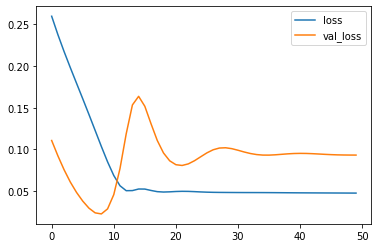

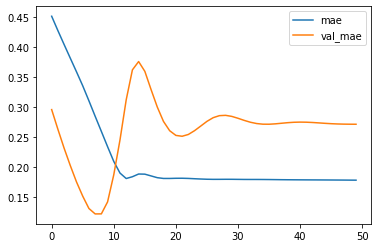

Test MSE: 2158244.918
bestmse=470928.3870781320
Test MAE: 1307.900
bestmae=569.47168
Test MAPE: 71.558
bestmape=26.40163


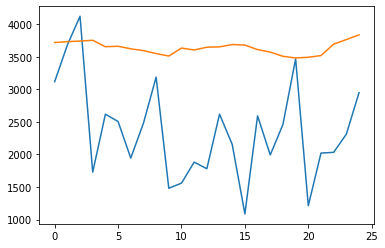

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3719.68852663 3732.66610241 3741.86586881 3753.84031367 3654.98170483
 3662.02628922 3622.76874948 3594.86960137 3550.07446909 3511.68806934
 3634.24621987 3604.6722219  3647.47285676 3652.4976933  3688.31141806
 3679.98795652 3610.70707583 3572.36486435 3507.74814069 3482.00474846
 3493.16056275 3519.08874226 3694.70035195 3764.63286602 3837.15584517]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 52%|█████▏    | 67/128 [04:51<04:21,  4.29s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


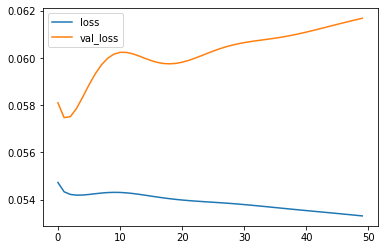

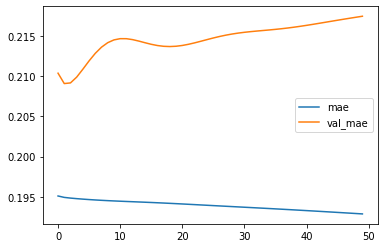

Test MSE: 1429240.561
bestmse=470928.3870781320
Test MAE: 1046.833
bestmae=569.47168
Test MAPE: 57.953
bestmape=26.40163


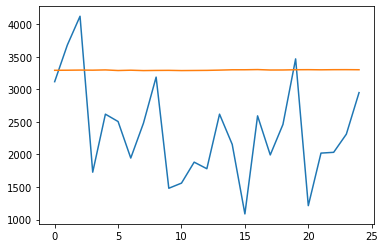

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3292.83494645 3294.05155832 3296.19985384 3294.63317913 3298.75115204
 3289.35985535 3294.26704782 3288.46203023 3290.84217066 3292.04687464
 3288.56877071 3290.08207518 3291.67256564 3295.64778751 3300.73259383
 3300.98438084 3303.92663038 3297.05908597 3297.6818822  3301.31536239
 3302.40715677 3300.2526921  3302.19797987 3302.63799739 3301.34104323]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 53%|█████▎    | 68/128 [04:55<04:12,  4.22s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


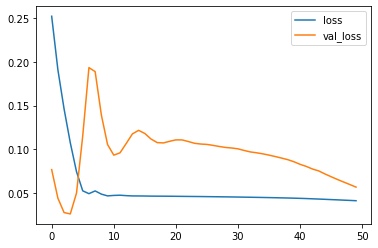

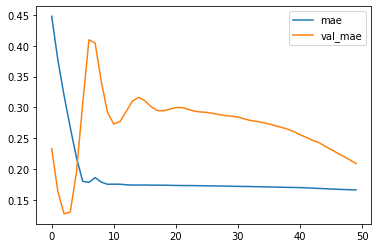

Test MSE: 1311777.396
bestmse=470928.3870781320
Test MAE: 1005.808
bestmae=569.47168
Test MAPE: 55.508
bestmape=26.40163


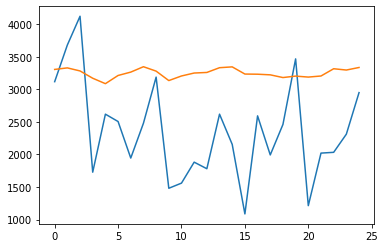

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3306.08382094 3329.87030447 3282.81669295 3170.8835237  3087.40386438
 3213.35475516 3265.07252371 3347.77028036 3280.05148339 3134.91743553
 3205.59340274 3250.85681581 3259.70278919 3332.71126533 3345.33590889
 3235.16051424 3232.69113648 3223.04633117 3181.42730188 3203.55529094
 3188.67934155 3205.22124577 3316.66690946 3296.75235057 3336.04833984]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 54%|█████▍    | 69/128 [05:00<04:23,  4.47s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


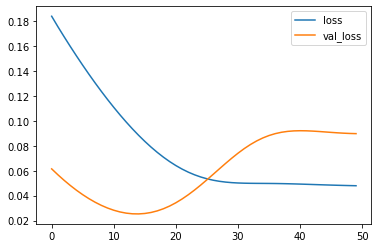

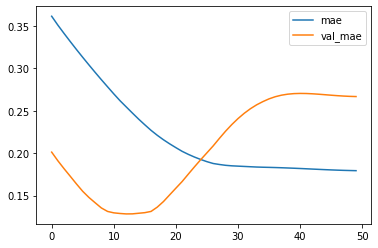

Test MSE: 2079704.281
bestmse=470928.3870781320
Test MAE: 1284.600
bestmae=569.47168
Test MAPE: 70.293
bestmape=26.40163


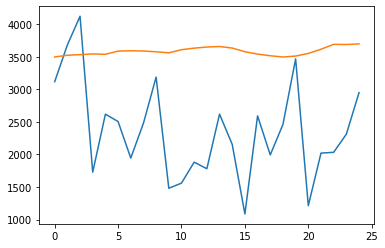

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3497.18915486 3523.84471905 3533.15811241 3543.97763681 3538.39356053
 3587.54467976 3592.61657393 3589.01178741 3577.36215496 3561.02225423
 3608.85030806 3633.15786874 3649.97150207 3658.03356421 3634.47576928
 3577.93861091 3541.54929101 3516.2899611  3496.83622265 3511.53283656
 3551.54243755 3616.32874084 3691.45308864 3688.98629332 3697.93958104]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 55%|█████▍    | 70/128 [05:04<04:16,  4.42s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


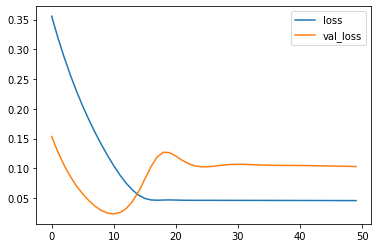

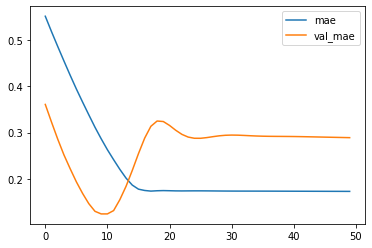

Test MSE: 2393725.425
bestmse=470928.3870781320
Test MAE: 1390.898
bestmae=569.47168
Test MAPE: 75.538
bestmape=26.40163


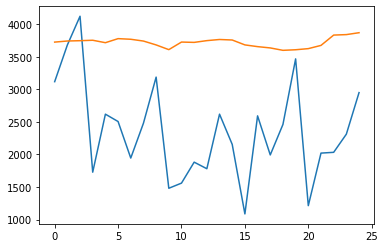

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3725.85192823 3742.56197739 3747.46859598 3754.30056024 3716.75775456
 3779.10308683 3769.44852567 3741.93042958 3682.52820766 3610.14525366
 3726.46712065 3721.51430523 3748.45508456 3765.9565053  3758.12887049
 3682.86994934 3656.26230359 3636.39480233 3599.46259809 3608.31717956
 3625.59335494 3675.1427424  3833.70629144 3840.97985137 3870.04625821]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 55%|█████▌    | 71/128 [05:09<04:26,  4.68s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


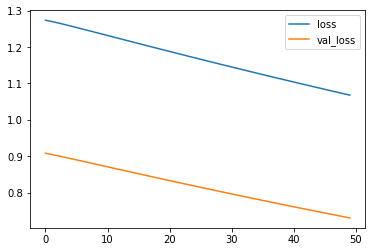

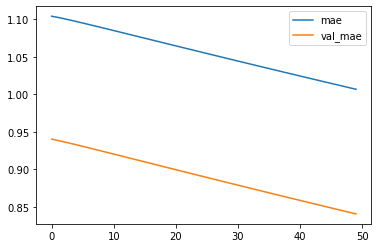

Test MSE: 16934103.445
bestmse=470928.3870781320
Test MAE: 4047.402
bestmae=569.47168
Test MAPE: 179.406
bestmape=26.40163


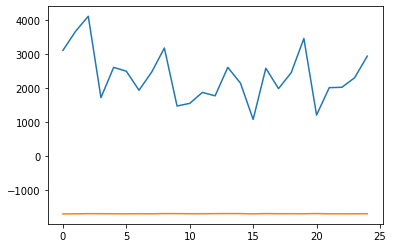

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[-1693.35910296 -1690.39016831 -1686.09702051 -1687.37101972
 -1688.23469937 -1690.99876118 -1687.54059935 -1689.16466141
 -1683.66207516 -1684.45631611 -1687.88262796 -1687.70903122
 -1684.58830702 -1683.05549085 -1684.1283474  -1691.29028893
 -1684.15044153 -1687.60372543 -1686.8860966  -1688.26597548
 -1683.37772083 -1689.51788056 -1691.090294   -1689.06566823
 -1687.16356444]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)       




 56%|█████▋    | 72/128 [05:13<04:06,  4.39s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


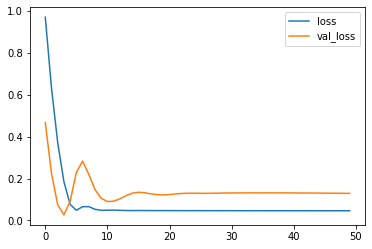

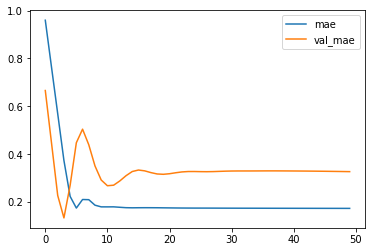

Test MSE: 2999711.838
bestmse=470928.3870781320
Test MAE: 1573.183
bestmae=569.47168
Test MAPE: 84.812
bestmape=26.40163


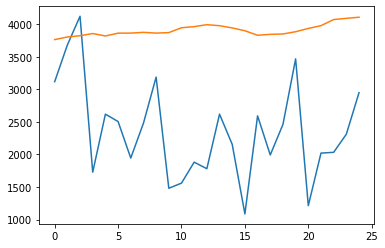

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3764.11494517 3804.28063977 3823.74327326 3857.38976467 3820.14623404
 3863.14083815 3864.08629477 3875.78298485 3863.93364441 3871.78767741
 3946.1375829  3963.43240917 3993.54929149 3977.53850722 3943.51239848
 3900.13846397 3830.83434141 3844.78578055 3850.65679359 3885.13195837
 3935.61216867 3978.53303003 4072.07269216 4090.79474187 4107.91826689]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 57%|█████▋    | 73/128 [05:18<04:17,  4.67s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


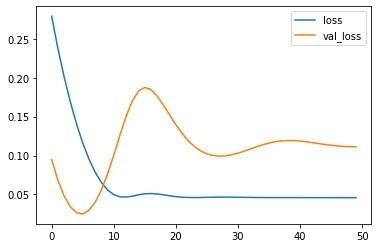

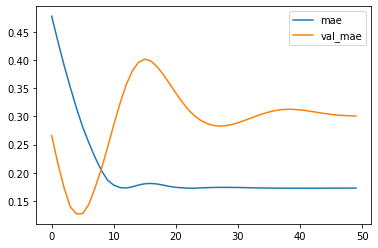

Test MSE: 2580082.505
bestmse=470928.3870781320
Test MAE: 1447.762
bestmae=569.47168
Test MAPE: 78.558
bestmape=26.40163


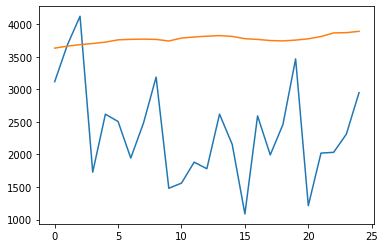

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3633.27666056 3663.52409911 3687.17945254 3704.23296499 3725.60171938
 3760.39681864 3768.41497946 3771.32222271 3767.47526157 3742.5097549
 3787.8460499  3804.44333291 3816.77042305 3825.63849056 3813.47093725
 3778.45833993 3767.05202985 3750.00597775 3743.82966399 3756.89963341
 3776.38436103 3811.52981007 3867.07072401 3870.90075588 3891.21214831]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 58%|█████▊    | 74/128 [05:22<04:04,  4.53s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


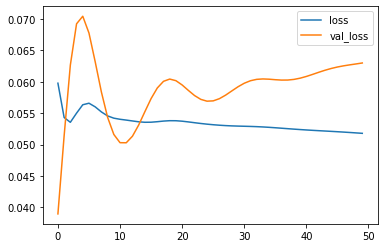

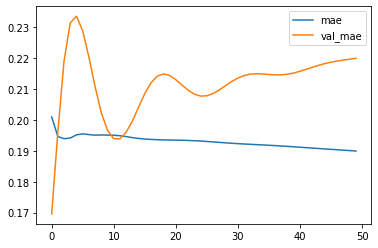

Test MSE: 1460087.399
bestmse=470928.3870781320
Test MAE: 1059.003
bestmae=569.47168
Test MAPE: 58.610
bestmape=26.40163


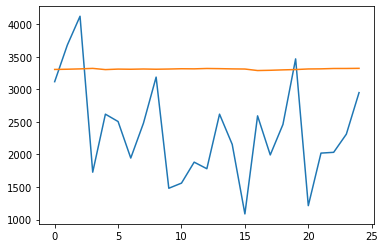

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3305.92758387 3309.32348043 3314.40685207 3322.04496515 3303.50311172
 3311.20607251 3308.90469623 3312.69699591 3309.19694132 3312.19256109
 3316.60263562 3315.05877239 3320.62563246 3318.10948402 3314.49164188
 3312.26544303 3289.10735101 3293.06277424 3299.32287353 3304.25129932
 3313.31390995 3315.07598859 3320.48704201 3320.91744715 3322.94910288]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 59%|█████▊    | 75/128 [05:27<03:58,  4.50s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


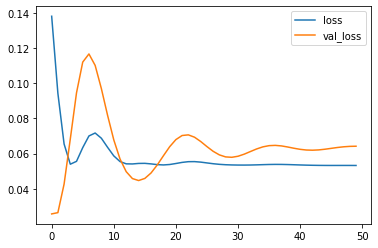

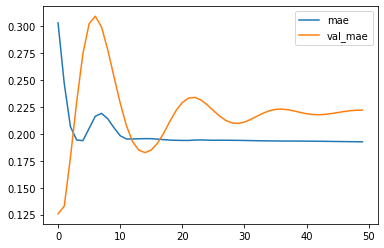

Test MSE: 1487183.449
bestmse=470928.3870781320
Test MAE: 1069.446
bestmae=569.47168
Test MAPE: 59.174
bestmape=26.40163


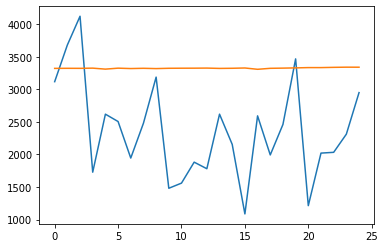

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3322.1913029  3323.35368371 3322.77981019 3325.84730762 3310.75615567
 3325.58088684 3319.60815471 3323.53861445 3319.04977578 3323.68939972
 3324.86756206 3325.30786651 3326.69061476 3321.80996394 3323.82755977
 3328.24050367 3308.16181695 3323.20949799 3326.08733022 3329.67863071
 3334.25369388 3334.19731081 3338.06507486 3340.74219483 3340.23847735]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 59%|█████▉    | 76/128 [05:31<03:52,  4.47s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


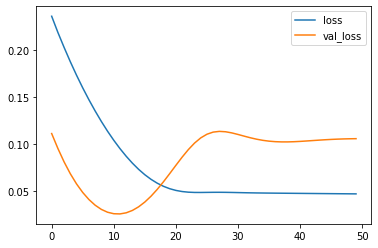

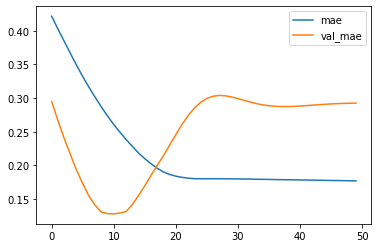

Test MSE: 2453421.041
bestmse=470928.3870781320
Test MAE: 1408.193
bestmae=569.47168
Test MAPE: 76.601
bestmape=26.40163


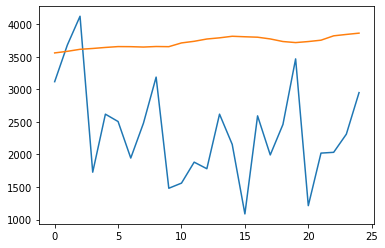

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3559.73821223 3584.16800797 3615.27711761 3628.03375208 3643.82904685
 3656.89786851 3655.68125665 3649.93620884 3658.1474781  3655.52229369
 3713.11652708 3738.12191796 3773.34369218 3791.35012162 3815.46773016
 3807.79274571 3801.04341924 3774.49115229 3734.66519082 3718.4245702
 3734.32459688 3755.14300656 3822.22336924 3843.62454748 3863.34427631]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 60%|██████    | 77/128 [05:36<03:44,  4.41s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


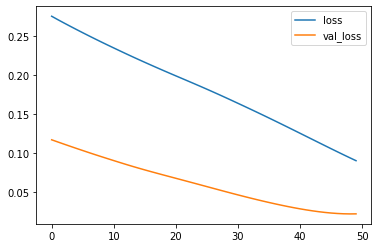

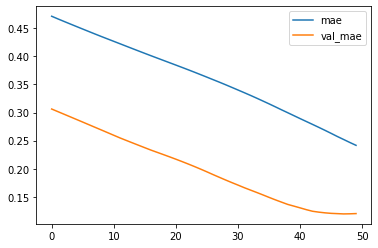

Test MSE: 512607.319
bestmse=470928.3870781320
Test MAE: 579.124
bestmae=569.47168
Test MAPE: 28.595
bestmape=26.40163


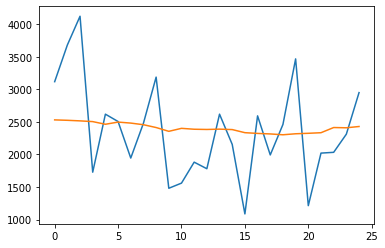

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2531.07078862 2524.81987131 2515.98738396 2504.74864495 2463.92328274
 2497.45987737 2482.0462085  2456.99261224 2413.78452718 2355.46176136
 2401.24452996 2387.52407491 2384.13449097 2389.02934515 2382.46853614
 2334.68122733 2323.45396578 2315.38243473 2302.53584558 2317.91450816
 2325.20284534 2334.18210083 2413.63417232 2409.88276112 2429.53132963]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 61%|██████    | 78/128 [05:40<03:47,  4.55s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


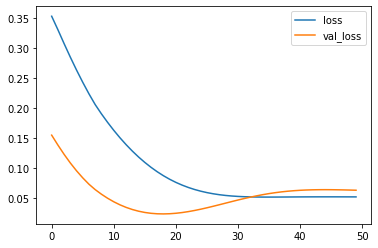

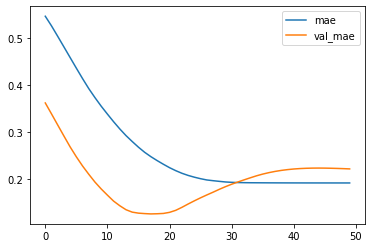

Test MSE: 1471882.989
bestmse=470928.3870781320
Test MAE: 1063.953
bestmae=569.47168
Test MAPE: 58.840
bestmape=26.40163


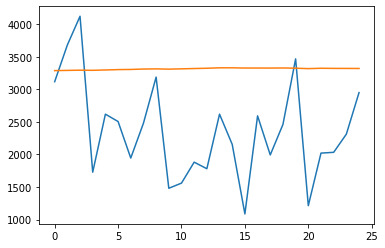

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3288.00364876 3291.22250533 3294.76072252 3292.52778065 3297.8774296
 3303.37370324 3305.87607872 3312.15554625 3314.51086664 3310.59532762
 3315.31012899 3319.79308546 3324.39382946 3330.93813962 3330.93857002
 3327.47151315 3327.54080838 3327.01614451 3328.61868632 3325.23684967
 3318.55825311 3324.14706385 3322.05099082 3321.66262192 3320.67613333]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 62%|██████▏   | 79/128 [05:45<03:39,  4.49s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


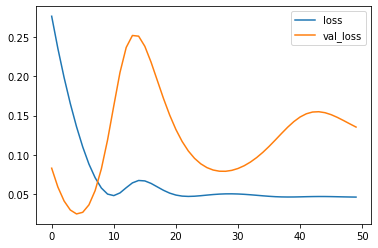

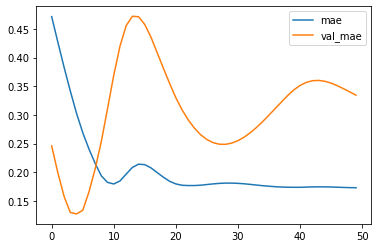

Test MSE: 3137641.594
bestmse=470928.3870781320
Test MAE: 1609.945
bestmae=569.47168
Test MAPE: 86.706
bestmape=26.40163


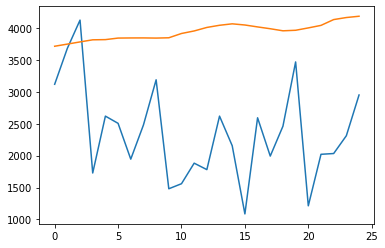

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3713.74778795 3747.21207452 3781.51134706 3814.3822484  3817.45792353
 3841.66476941 3843.59298444 3844.16513634 3841.55630732 3846.22132516
 3913.49364853 3953.22147763 4008.20343876 4042.13256288 4064.77761197
 4046.52958179 4016.36765039 3987.94828594 3955.51151991 3963.90155077
 4000.96029413 4040.47521615 4131.44105554 4163.49476099 4183.66641521]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 62%|██████▎   | 80/128 [05:49<03:37,  4.53s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


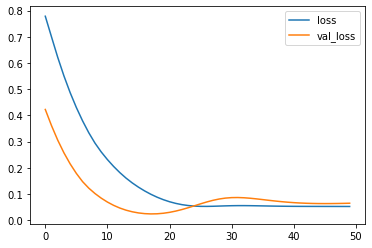

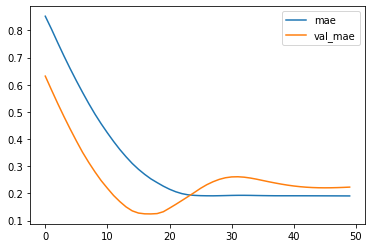

Test MSE: 1499144.753
bestmse=470928.3870781320
Test MAE: 1075.043
bestmae=569.47168
Test MAPE: 59.423
bestmape=26.40163


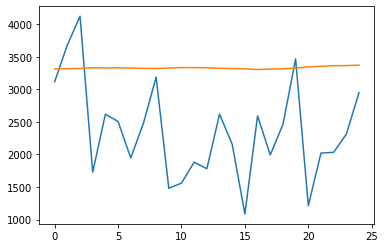

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3313.53255576 3318.0718953  3320.83954382 3332.54627669 3328.43892044
 3330.78462845 3327.57983178 3322.53763556 3320.08992153 3328.23835164
 3334.46071875 3334.27923125 3331.39609069 3324.53844559 3319.43427104
 3314.78073066 3304.67137474 3311.88295633 3315.59161395 3327.29318196
 3346.2160874  3353.82622415 3363.93988413 3365.09509152 3372.42646921]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 63%|██████▎   | 81/128 [05:54<03:26,  4.40s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


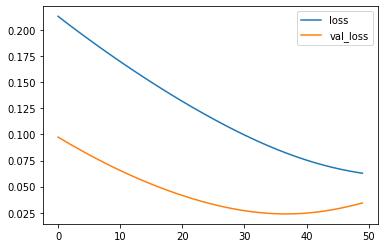

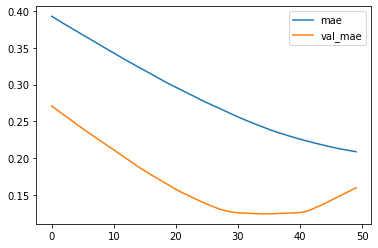

Test MSE: 795895.038
bestmse=470928.3870781320
Test MAE: 769.767
bestmae=569.47168
Test MAPE: 41.766
bestmape=26.40163


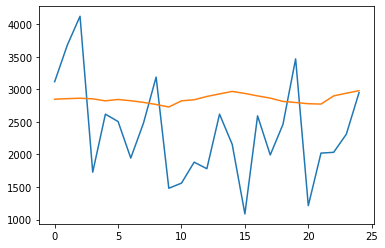

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2848.87936151 2857.55489445 2863.74196833 2854.37262231 2823.75173557
 2844.60328645 2825.36833727 2800.15778661 2767.63321793 2729.20650357
 2823.65417707 2840.58129388 2890.78891426 2930.51760417 2968.29670227
 2937.2884509  2899.44593978 2865.44694656 2814.58970135 2798.06960434
 2779.50020498 2774.12645334 2899.57491785 2940.84962302 2979.94246107]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 64%|██████▍   | 82/128 [05:58<03:21,  4.38s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


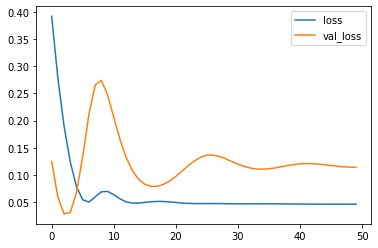

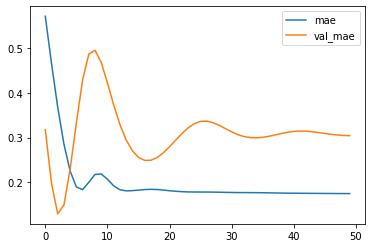

Test MSE: 2642951.918
bestmse=470928.3870781320
Test MAE: 1464.846
bestmae=569.47168
Test MAPE: 79.476
bestmape=26.40163


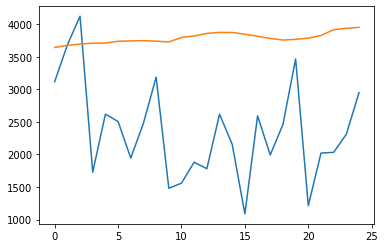

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3643.80006623 3675.11892664 3695.24782729 3710.38029814 3711.14842784
 3738.99305797 3744.11975706 3748.24131668 3740.61884165 3727.52419567
 3796.81655383 3820.31552672 3858.5624752  3875.02375019 3873.7015456
 3847.00035846 3814.63676131 3782.2516439  3757.47867179 3768.41727495
 3786.89600229 3827.46541691 3917.1027391  3938.22013688 3952.80714095]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 65%|██████▍   | 83/128 [06:02<03:17,  4.39s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


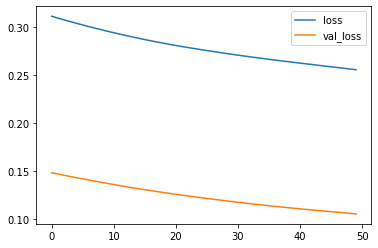

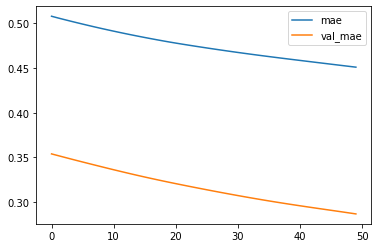

Test MSE: 2446767.852
bestmse=470928.3870781320
Test MAE: 1381.582
bestmae=569.47168
Test MAPE: 54.100
bestmape=26.40163


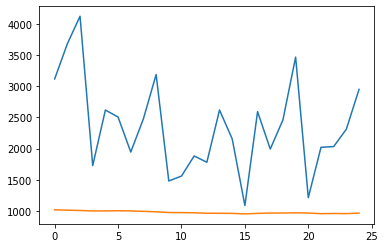

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1018.40421742 1013.13177687 1007.47472898 1000.96793581 1000.649167
 1003.86515421 1000.45209525  993.94523035  986.47757563  975.24245023
  973.64371034  970.71412189  963.90316678  962.84566135  961.38192521
  952.81819897  961.46018721  966.4978014   967.39772475  970.25446713
  966.99843431  956.76568661  959.79123748  957.72104255  965.64403901]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total pa




 66%|██████▌   | 84/128 [06:06<03:08,  4.29s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


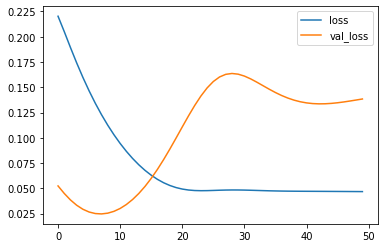

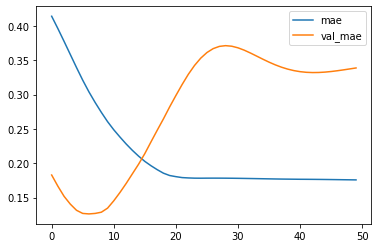

Test MSE: 3206745.194
bestmse=470928.3870781320
Test MAE: 1631.605
bestmae=569.47168
Test MAPE: 87.724
bestmape=26.40163


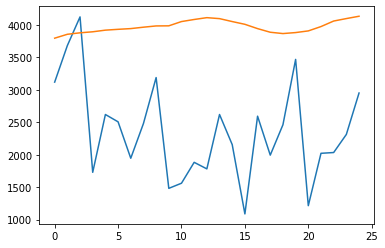

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3795.03266799 3855.1146431  3877.78809893 3893.57076848 3918.86510468
 3931.55947387 3942.72561789 3964.41516757 3983.73404574 3985.40889561
 4051.14725506 4083.18776143 4111.33998775 4096.30794477 4051.1865654
 4008.8071537  3942.40367484 3886.5864408  3866.17835069 3881.54496193
 3907.17444026 3974.0304184  4059.26641762 4097.21380413 4133.1236527 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 66%|██████▋   | 85/128 [06:10<03:01,  4.23s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


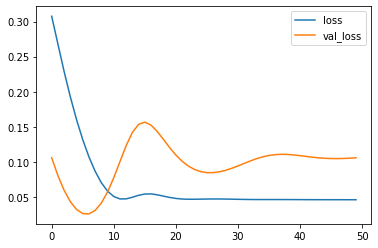

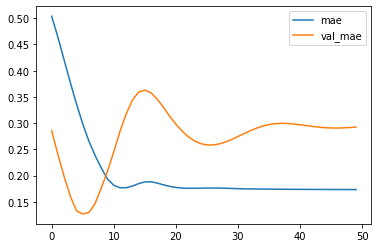

Test MSE: 2450294.654
bestmse=470928.3870781320
Test MAE: 1408.409
bestmae=569.47168
Test MAPE: 76.580
bestmape=26.40163


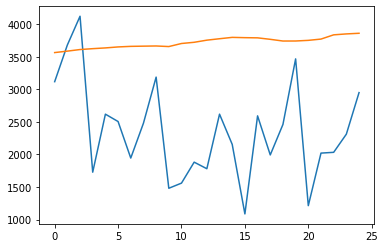

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3565.03477788 3587.22503221 3611.65081084 3625.03354132 3636.47543156
 3651.63630915 3660.38529789 3663.50430048 3666.36104286 3657.33602095
 3704.40713561 3722.95989263 3755.71257603 3777.60068595 3798.49111676
 3793.92652678 3791.1814028  3768.56332576 3742.37202525 3742.80214345
 3752.68969727 3772.24816763 3837.38109052 3851.57728672 3861.43212974]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 67%|██████▋   | 86/128 [06:15<02:57,  4.23s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


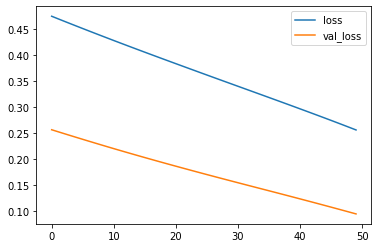

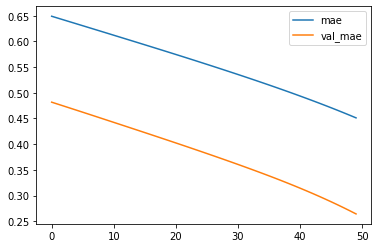

Test MSE: 2183396.361
bestmse=470928.3870781320
Test MAE: 1271.557
bestmae=569.47168
Test MAPE: 48.673
bestmape=26.40163


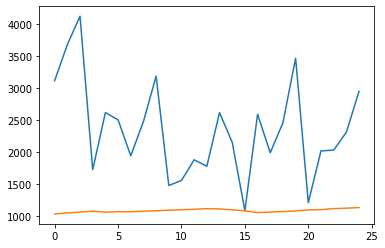

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1037.33777988 1052.62889088 1065.17279762 1080.22811834 1063.22044403
 1072.32451702 1070.89539262 1080.68284137 1086.42749464 1095.11773309
 1103.13919368 1110.1969413  1119.46611052 1114.56623494 1101.22385494
 1086.010719   1058.08875942 1066.22542512 1074.51653453 1084.54404175
 1099.72443103 1104.0980646  1119.80125266 1126.34671056 1137.09141621]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 68%|██████▊   | 87/128 [06:19<02:51,  4.18s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


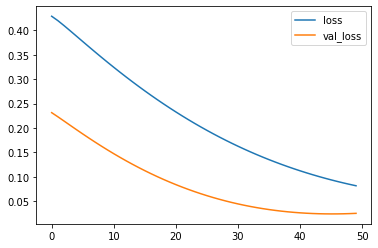

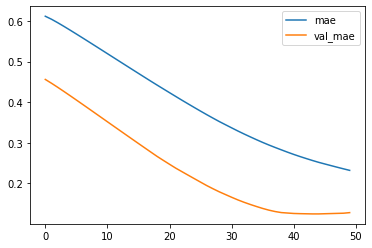

Test MSE: 583583.627
bestmse=470928.3870781320
Test MAE: 616.470
bestmae=569.47168
Test MAPE: 31.753
bestmape=26.40163


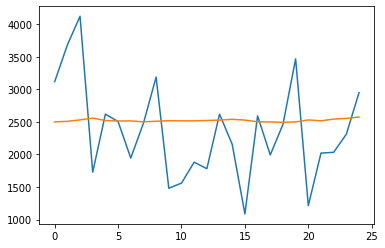

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2499.81620204 2509.11324    2531.15902168 2558.05546927 2521.56600845
 2514.72027123 2514.95010757 2501.65144956 2509.81939137 2518.84470022
 2516.6941092  2516.46455979 2521.83888531 2527.82467306 2540.24774355
 2527.88507324 2501.604105   2499.7932471  2493.32253623 2500.65606594
 2530.30696297 2516.41018528 2543.42786366 2553.53980201 2574.84069586]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 69%|██████▉   | 88/128 [06:23<02:42,  4.06s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


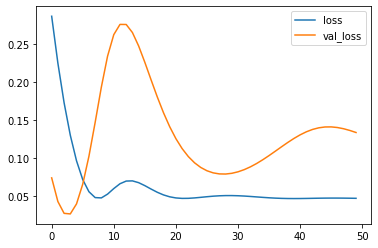

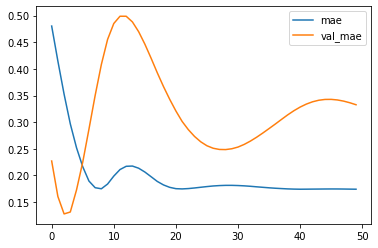

Test MSE: 3089347.913
bestmse=470928.3870781320
Test MAE: 1601.496
bestmae=569.47168
Test MAPE: 86.182
bestmape=26.40163


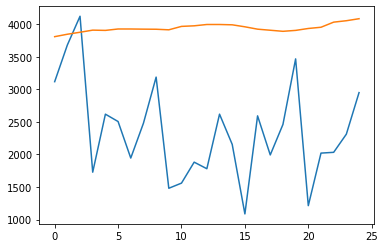

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3809.41336453 3846.70079648 3877.19098353 3909.57839644 3905.67404795
 3927.2852639  3927.1400739  3924.72923124 3923.32496274 3914.5963465
 3967.07994926 3975.95146    3996.24161911 3996.20374346 3991.4230901
 3960.77738333 3924.47529221 3908.06250954 3891.55130756 3905.73487854
 3935.07904017 3953.92189026 4032.36494863 4054.23182523 4085.04022515]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total pa




 70%|██████▉   | 89/128 [06:27<02:39,  4.08s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


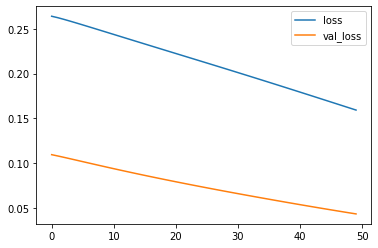

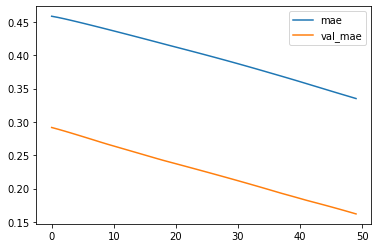

Test MSE: 1009633.529
bestmse=470928.3870781320
Test MAE: 780.006
bestmae=569.47168
Test MAPE: 29.698
bestmape=26.40163


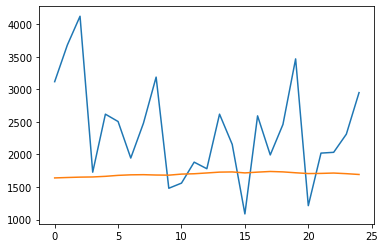

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1639.78603151 1646.21592563 1651.92496288 1654.69913921 1664.27895334
 1679.07219321 1687.35275769 1689.63627216 1684.33289176 1682.22082201
 1698.51466939 1703.77924159 1716.10489705 1728.8929511  1731.75406927
 1717.01986665 1728.84854764 1738.79836673 1732.5524708  1718.81558862
 1706.87909114 1709.23598969 1714.68649691 1705.07203516 1692.64387155]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 70%|███████   | 90/128 [06:30<02:32,  4.01s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


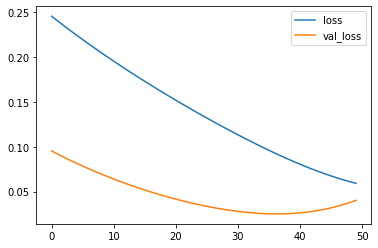

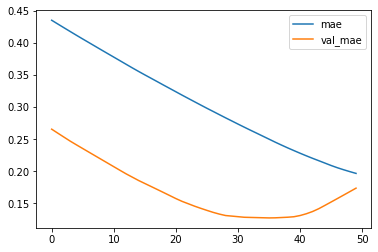

Test MSE: 931334.813
bestmse=470928.3870781320
Test MAE: 835.979
bestmae=569.47168
Test MAPE: 45.544
bestmape=26.40163


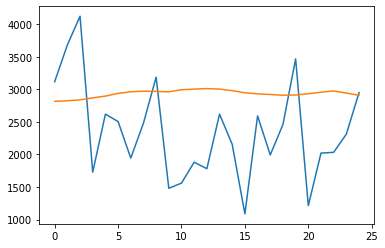

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2815.44907695 2825.16619033 2838.76785356 2869.54196453 2896.4694013
 2938.17881566 2962.8341437  2972.04266167 2968.97243834 2962.23932379
 2994.12646246 3004.17986572 3011.376957   3004.14514637 2980.60169828
 2947.55347002 2931.19377065 2921.18512952 2909.80665231 2913.83467054
 2932.70090598 2956.24220204 2976.06637585 2942.55101454 2909.36075258]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 71%|███████   | 91/128 [06:34<02:26,  3.96s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


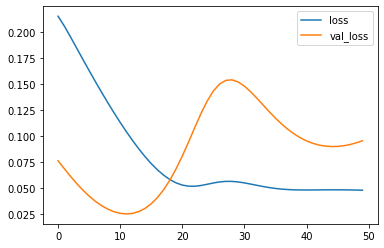

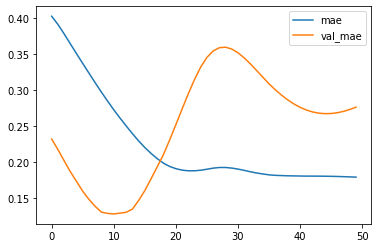

Test MSE: 2213439.235
bestmse=470928.3870781320
Test MAE: 1329.714
bestmae=569.47168
Test MAPE: 72.606
bestmape=26.40163


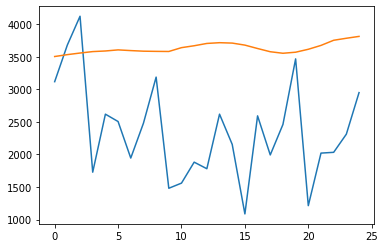

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3504.47476614 3533.37876678 3557.86365438 3580.1287992  3589.54491591
 3606.32096052 3595.51004422 3586.34958816 3583.56744933 3581.88226974
 3640.63515377 3669.79137182 3705.25302517 3716.76406717 3710.68014705
 3679.63904142 3627.36232007 3577.90676093 3554.45714116 3570.64209604
 3615.65128314 3675.09798026 3753.99296403 3784.97610843 3813.46519852]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 72%|███████▏  | 92/128 [06:38<02:21,  3.94s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


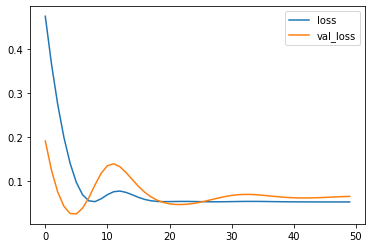

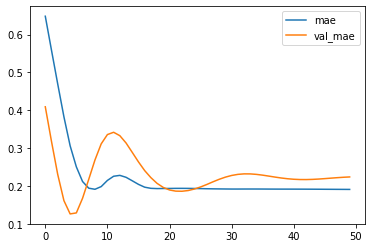

Test MSE: 1506561.747
bestmse=470928.3870781320
Test MAE: 1077.269
bestmae=569.47168
Test MAPE: 59.592
bestmape=26.40163


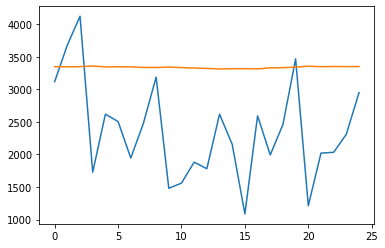

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3348.527363   3346.43817645 3349.26436007 3358.42883325 3345.10564214
 3347.45967132 3345.2478193  3336.83856368 3335.95020747 3342.5173291
 3334.05585098 3327.36391187 3321.25718027 3312.99282771 3316.9053539
 3317.60806203 3314.15463465 3330.65306795 3332.96749985 3340.98523027
 3356.68196225 3347.50845057 3350.85743296 3348.83395493 3350.48613679]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total pa




 73%|███████▎  | 93/128 [06:42<02:19,  3.99s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


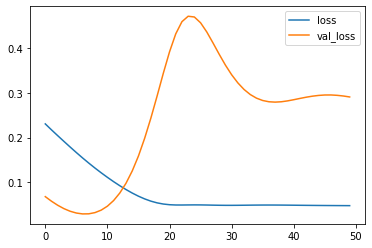

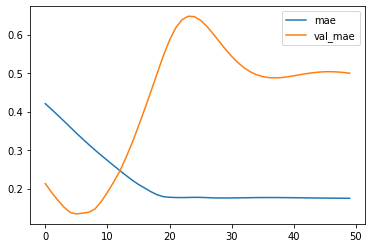

Test MSE: 6738868.489
bestmse=470928.3870781320
Test MAE: 2405.689
bestmae=569.47168
Test MAPE: 126.173
bestmape=26.40163


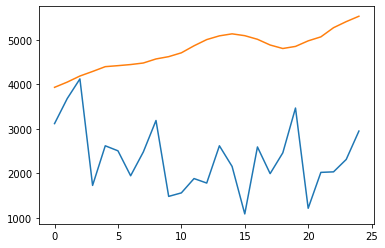

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3933.56544876 4051.27436805 4188.00289047 4290.55179298 4398.6061511
 4421.08764625 4446.09447181 4480.69560182 4571.8760699  4623.70832622
 4709.90585053 4868.01948273 5007.27649188 5091.44049537 5136.57105672
 5095.29721236 5014.16842592 4885.48561025 4806.87756324 4853.79143655
 4978.92627919 5068.6052072  5274.72249854 5411.33366382 5532.33948648]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 73%|███████▎  | 94/128 [06:46<02:16,  4.03s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


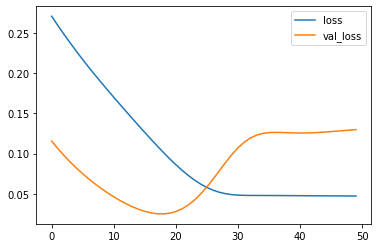

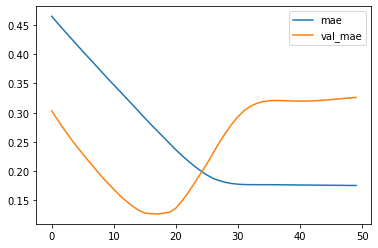

Test MSE: 3009376.014
bestmse=470928.3870781320
Test MAE: 1569.681
bestmae=569.47168
Test MAPE: 84.702
bestmape=26.40163


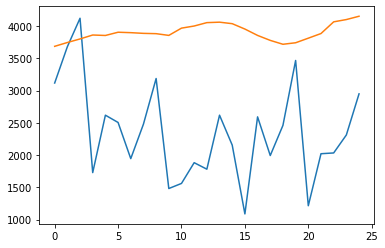

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3687.47528434 3746.73719418 3802.03335106 3863.11214447 3855.90544081
 3906.19426429 3899.49543869 3888.73387551 3883.90272129 3857.04802299
 3969.73153186 4002.60099852 4055.23036516 4062.23621309 4038.92690539
 3955.49688613 3856.76969433 3779.70852339 3719.44491732 3742.81849885
 3813.95069551 3885.98329973 4067.37811983 4102.89170873 4154.28323019]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 74%|███████▍  | 95/128 [06:52<02:25,  4.41s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


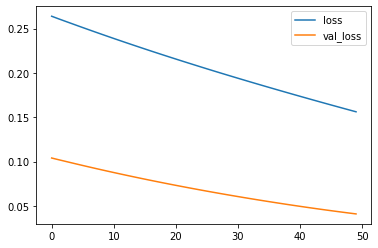

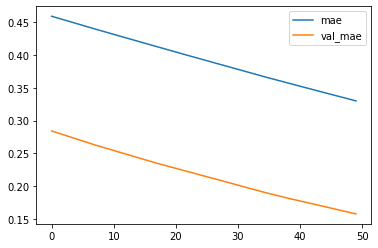

Test MSE: 952364.702
bestmse=470928.3870781320
Test MAE: 759.229
bestmae=569.47168
Test MAPE: 28.982
bestmape=26.40163


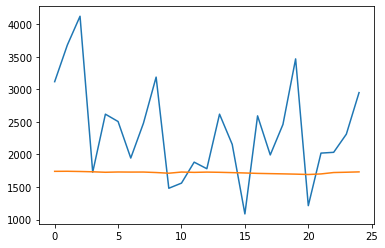

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1741.00433654 1741.96873099 1738.66221523 1733.97524673 1726.61352548
 1730.82037705 1729.49350974 1730.06530297 1722.55702877 1712.12156922
 1729.9648751  1725.16191241 1729.27421832 1726.08692479 1721.18317556
 1715.84808865 1709.4040629  1705.63249439 1702.16529405 1697.95507097
 1692.41604376 1701.10707128 1722.68708286 1727.23424143 1732.52664649]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 75%|███████▌  | 96/128 [06:56<02:18,  4.31s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


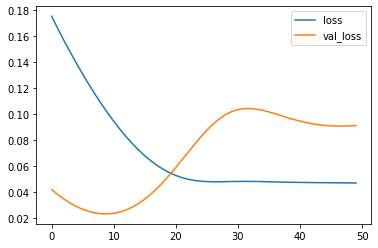

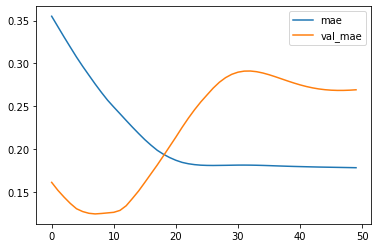

Test MSE: 2119221.459
bestmse=470928.3870781320
Test MAE: 1295.606
bestmae=569.47168
Test MAPE: 70.902
bestmape=26.40163


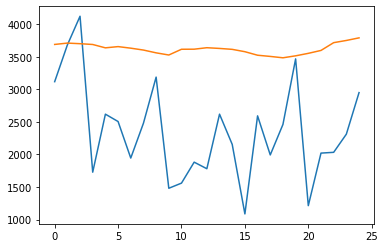

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3689.92256796 3710.57398045 3701.39401269 3689.21813822 3637.72102404
 3656.63073039 3632.62961817 3603.66048288 3560.85095298 3527.63773608
 3615.91182172 3616.97693098 3639.59529495 3628.65066612 3614.5284996
 3578.36700749 3524.28918409 3505.93871748 3484.7931999  3515.10089517
 3553.19691491 3597.88788915 3717.29949117 3751.15917659 3791.01497948]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 76%|███████▌  | 97/128 [07:00<02:12,  4.28s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


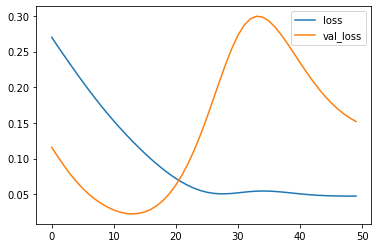

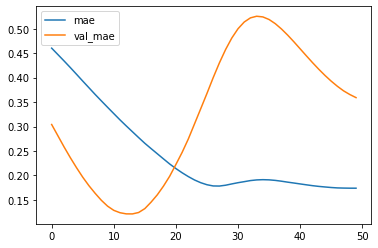

Test MSE: 3523099.356
bestmse=470928.3870781320
Test MAE: 1728.800
bestmae=569.47168
Test MAPE: 92.067
bestmape=26.40163


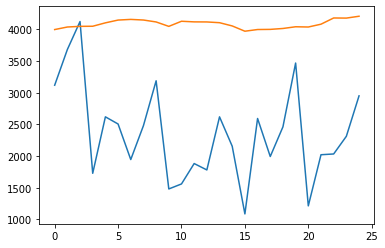

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3996.46743834 4036.61017799 4046.99499321 4048.74588132 4102.45326936
 4146.25588739 4156.76293766 4146.9631865  4116.47902513 4046.71867311
 4127.46497285 4117.73408651 4116.52263951 4104.700845   4053.60285985
 3970.2985189  3997.01290512 3999.21284926 4013.50603008 4040.56789672
 4036.68305993 4081.11062622 4179.21487832 4177.32453895 4206.57544613]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 77%|███████▋  | 98/128 [07:04<02:04,  4.15s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


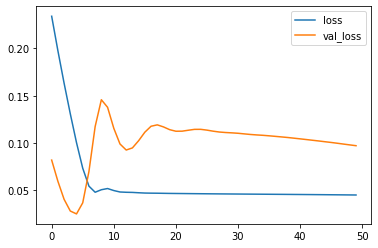

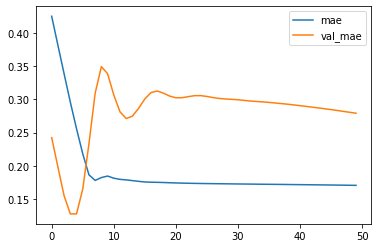

Test MSE: 2248395.588
bestmse=470928.3870781320
Test MAE: 1344.168
bestmae=569.47168
Test MAPE: 73.157
bestmape=26.40163


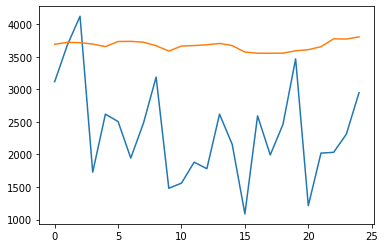

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3692.81603825 3721.80927622 3717.01542377 3695.85642016 3656.39228594
 3734.91511273 3737.55837417 3724.25110805 3670.30298007 3587.85944939
 3665.4325155  3673.03203559 3684.68740678 3705.44728136 3672.6059345
 3573.38635921 3554.80203915 3554.55613434 3555.76844215 3592.36952138
 3609.30051184 3655.39718926 3776.00445676 3772.96579647 3805.70040286]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 77%|███████▋  | 99/128 [07:09<02:13,  4.59s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


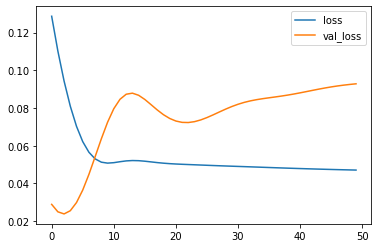

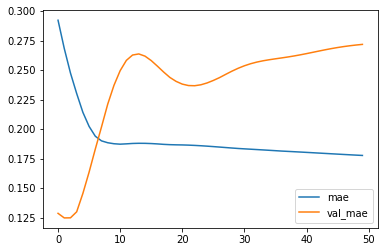

Test MSE: 2151174.871
bestmse=470928.3870781320
Test MAE: 1308.848
bestmae=569.47168
Test MAPE: 71.640
bestmape=26.40163


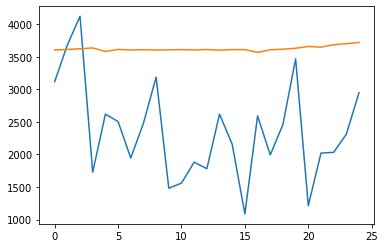

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3604.3124032  3612.79425383 3623.19743299 3636.50039506 3580.59765387
 3613.25794363 3604.27510142 3608.75992298 3604.29547393 3606.29628396
 3610.27954006 3605.10635722 3612.12253487 3601.52825582 3611.15928817
 3609.93837225 3567.89438963 3607.51691294 3616.03549147 3631.43682206
 3659.08977842 3648.13367212 3686.09827483 3700.87236166 3721.69450152]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 78%|███████▊  | 100/128 [07:14<02:05,  4.48s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


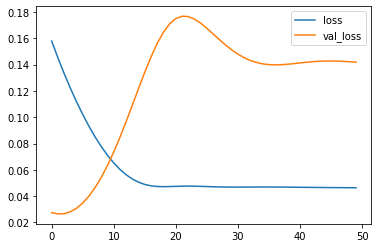

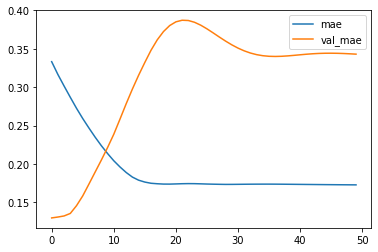

Test MSE: 3286481.457
bestmse=470928.3870781320
Test MAE: 1651.246
bestmae=569.47168
Test MAPE: 88.775
bestmape=26.40163


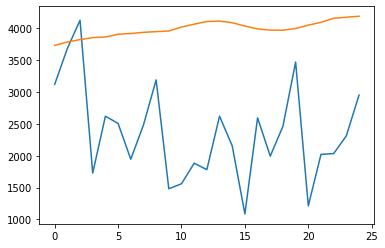

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3728.44038475 3782.2407403  3820.02141654 3851.25591755 3860.82210219
 3904.19747138 3915.45572209 3934.04807639 3945.12670469 3954.45817506
 4016.99259865 4061.73952556 4103.27132607 4110.26454878 4084.45114398
 4032.32248199 3987.8699522  3969.00070393 3967.46788776 3994.21211541
 4046.81680548 4090.58585191 4155.01061487 4170.88424337 4186.23306453]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 79%|███████▉  | 101/128 [07:18<01:58,  4.37s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


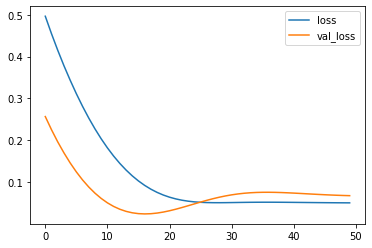

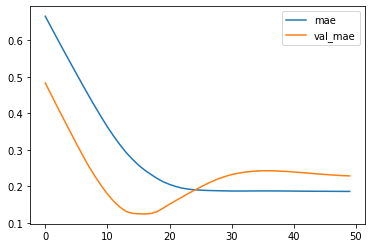

Test MSE: 1563784.060
bestmse=470928.3870781320
Test MAE: 1099.873
bestmae=569.47168
Test MAPE: 60.775
bestmape=26.40163


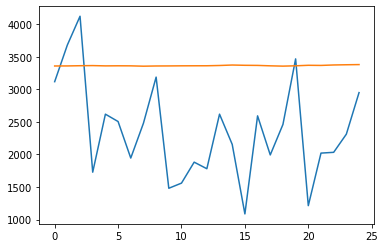

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3359.04560381 3359.85906953 3363.12067968 3365.06984109 3360.69462937
 3361.91525835 3361.08715886 3355.94137847 3359.11647719 3359.94457668
 3361.51569891 3362.15456361 3362.48884493 3366.66033155 3373.67536145
 3369.57819146 3367.93590891 3361.44209963 3356.84910291 3361.74008346
 3369.75465757 3367.66604489 3374.64836401 3377.87726337 3380.47719735]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 80%|███████▉  | 102/128 [07:22<01:50,  4.26s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


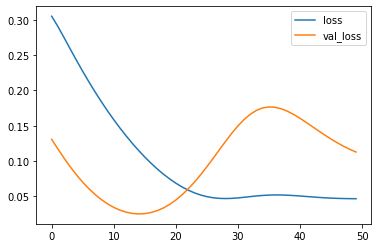

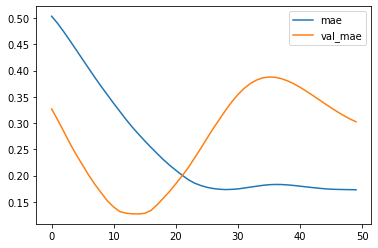

Test MSE: 2611226.183
bestmse=470928.3870781320
Test MAE: 1456.690
bestmae=569.47168
Test MAPE: 79.039
bestmape=26.40163


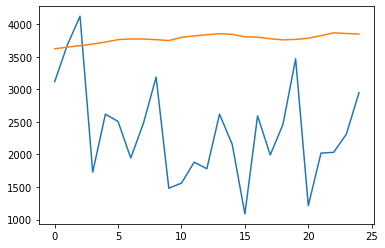

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3623.04162633 3649.28945339 3671.02519989 3695.96172595 3726.38448286
 3763.57952118 3774.30636501 3772.69894528 3763.04553187 3749.41747046
 3798.91922641 3820.9335885  3839.59566844 3854.93272519 3844.69051754
 3806.76522517 3801.55789685 3777.67729807 3760.29696465 3767.51543272
 3785.35343027 3823.91199207 3868.68158698 3857.80955315 3850.4866401 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 80%|████████  | 103/128 [07:26<01:44,  4.17s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


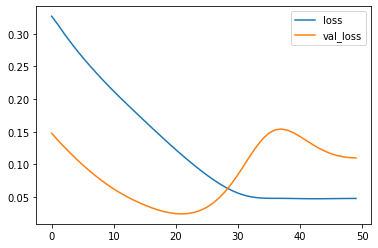

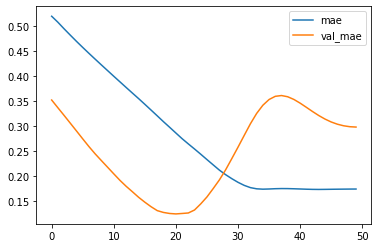

Test MSE: 2544086.535
bestmse=470928.3870781320
Test MAE: 1435.034
bestmae=569.47168
Test MAPE: 77.973
bestmape=26.40163


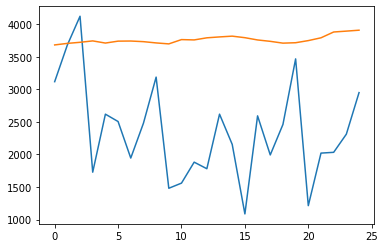

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3682.43007529 3706.04697919 3722.72517836 3744.30138803 3711.15674901
 3740.59875607 3742.32697618 3732.67040646 3713.22211981 3698.4138875
 3764.32440901 3759.36757648 3791.64509261 3805.44244671 3817.24530339
 3793.63499904 3758.82411826 3737.59280658 3709.87815881 3716.27369225
 3748.94000769 3791.86919022 3881.09734058 3894.53975391 3908.73107219]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 81%|████████▏ | 104/128 [07:30<01:40,  4.20s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


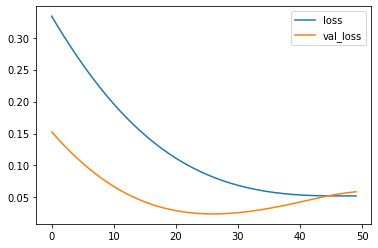

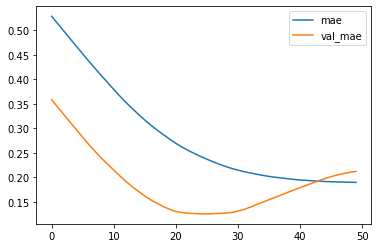

Test MSE: 1362704.785
bestmse=470928.3870781320
Test MAE: 1021.048
bestmae=569.47168
Test MAPE: 56.616
bestmape=26.40163


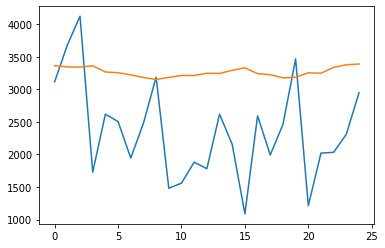

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3363.82941347 3345.13074911 3341.77201086 3362.05413574 3267.00088221
 3255.56114399 3222.65911001 3181.48856288 3151.47282577 3184.48303491
 3212.78389448 3213.36953241 3247.28115338 3243.9833892  3292.98300582
 3331.33597744 3241.41157502 3224.39995533 3176.24335891 3186.18370908
 3253.62274271 3248.4857139  3338.36793661 3377.70624906 3389.71225697]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 82%|████████▏ | 105/128 [07:34<01:35,  4.15s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


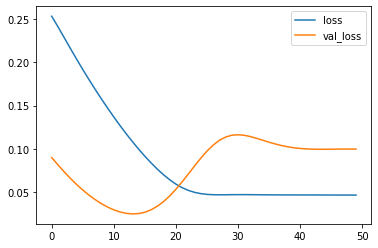

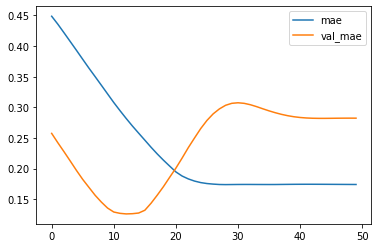

Test MSE: 2309476.420
bestmse=470928.3870781320
Test MAE: 1359.219
bestmae=569.47168
Test MAPE: 74.247
bestmape=26.40163


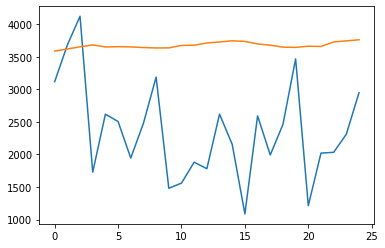

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3587.67724454 3620.09478581 3653.33985269 3682.95029163 3651.11523199
 3655.6347729  3651.77260411 3642.0084331  3635.90586209 3637.13366449
 3674.22827494 3678.04166448 3712.12257814 3727.57584429 3745.74726236
 3736.72482288 3697.49884617 3678.20407069 3648.52792323 3644.94695246
 3662.59270239 3659.07026672 3727.91041255 3744.96908987 3761.55231297]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 83%|████████▎ | 106/128 [07:38<01:32,  4.20s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


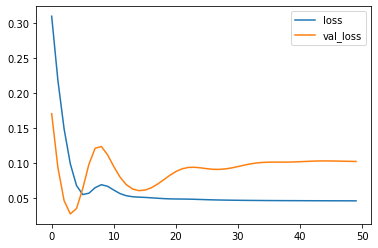

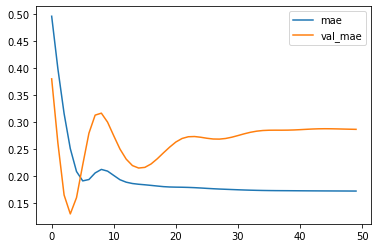

Test MSE: 2366491.282
bestmse=470928.3870781320
Test MAE: 1381.873
bestmae=569.47168
Test MAPE: 75.183
bestmape=26.40163


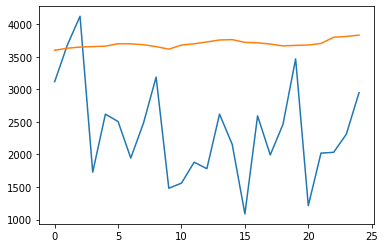

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3600.40948939 3631.91055465 3649.29433131 3656.77018166 3663.52295136
 3700.62961316 3698.9828831  3686.006742   3656.87003565 3616.92815173
 3680.3374455  3699.98400545 3728.08257461 3758.36186314 3763.7295891
 3721.39350486 3714.63155317 3696.14823484 3667.55842996 3675.79523659
 3680.45508957 3705.0097028  3800.42822683 3812.83106828 3833.15652061]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 84%|████████▎ | 107/128 [07:43<01:29,  4.24s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


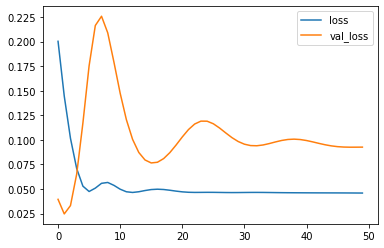

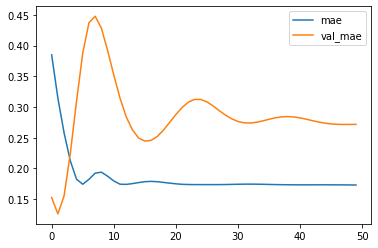

Test MSE: 2146257.100
bestmse=470928.3870781320
Test MAE: 1308.024
bestmae=569.47168
Test MAPE: 71.482
bestmape=26.40163


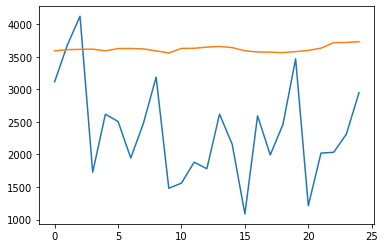

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3591.32937562 3610.46863139 3614.20311332 3617.59556663 3590.92938578
 3627.06849682 3627.34682548 3620.78945971 3591.80741227 3559.3141197
 3628.72010481 3630.67930901 3649.33823264 3657.95982146 3641.68505538
 3591.55376017 3574.36624825 3570.95858729 3564.04857624 3580.03554475
 3597.65518343 3632.72631586 3716.69835865 3720.08335161 3732.58576012]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 84%|████████▍ | 108/128 [07:47<01:27,  4.37s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


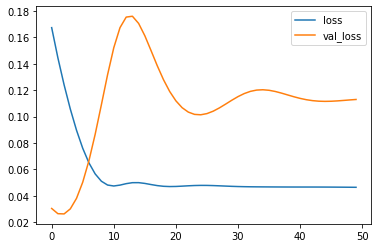

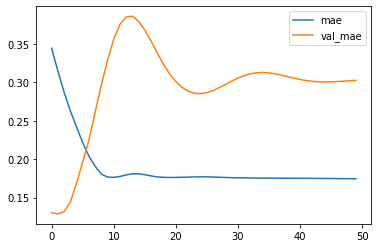

Test MSE: 2616298.593
bestmse=470928.3870781320
Test MAE: 1457.268
bestmae=569.47168
Test MAPE: 79.112
bestmape=26.40163


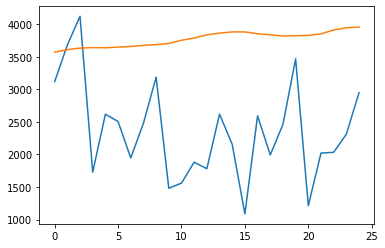

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3571.62083733 3610.1486969  3633.48583746 3641.25665879 3638.80937517
 3648.76062894 3658.03385115 3675.80355775 3687.97971916 3704.72850478
 3754.20902741 3788.66066337 3836.80865169 3863.9101156  3882.70131707
 3882.0559963  3854.61135602 3837.85453618 3819.4785322  3823.21617043
 3828.77327466 3851.78101182 3912.10688317 3945.12125289 3957.04376221]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 85%|████████▌ | 109/128 [07:52<01:21,  4.31s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


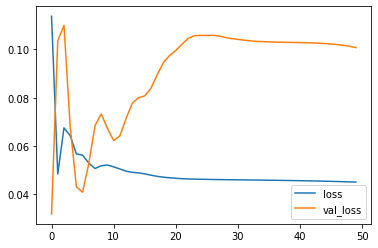

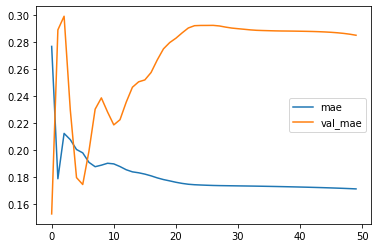

Test MSE: 2334775.247
bestmse=470928.3870781320
Test MAE: 1372.463
bestmae=569.47168
Test MAPE: 74.724
bestmape=26.40163


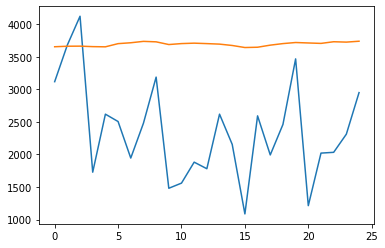

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3654.48473036 3662.50748217 3663.71376431 3656.33145535 3653.32722747
 3702.20661759 3715.81000245 3737.12653434 3729.92442167 3688.31686985
 3703.0723058  3709.60786438 3702.76614428 3694.79704964 3673.96429312
 3642.51774585 3647.09295249 3679.1205467  3702.92195094 3719.48193216
 3712.53490627 3705.9611851  3731.38808608 3725.72165895 3739.31758344]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 86%|████████▌ | 110/128 [07:57<01:22,  4.61s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


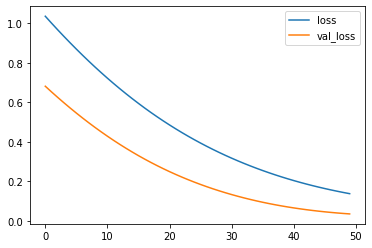

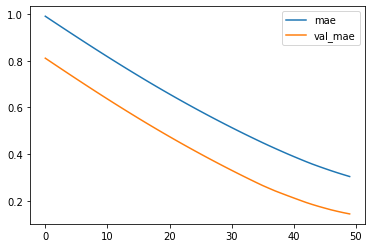

Test MSE: 809017.338
bestmse=470928.3870781320
Test MAE: 690.394
bestmae=569.47168
Test MAPE: 27.172
bestmape=26.40163


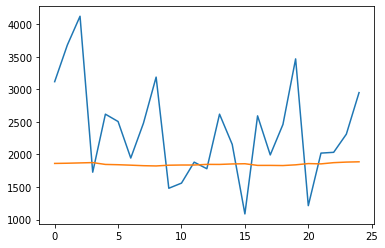

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1862.41696379 1865.52269554 1870.44932798 1875.26168784 1846.99870393
 1842.59924605 1835.69404119 1827.64948219 1823.7344453  1835.14656585
 1838.02339381 1837.93408474 1847.74854141 1847.10379452 1854.44564539
 1857.63552135 1832.24613735 1832.27153125 1829.91362843 1840.97525573
 1860.11723739 1855.54490012 1874.22871551 1883.00496325 1887.36037633]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 87%|████████▋ | 111/128 [08:01<01:16,  4.51s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


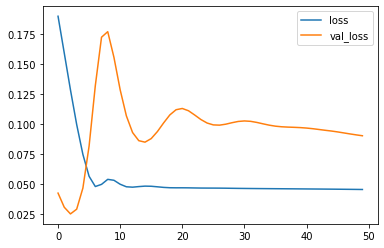

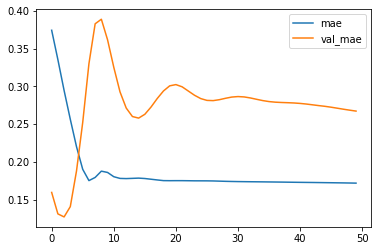

Test MSE: 2087924.856
bestmse=470928.3870781320
Test MAE: 1286.415
bestmae=569.47168
Test MAPE: 70.489
bestmape=26.40163


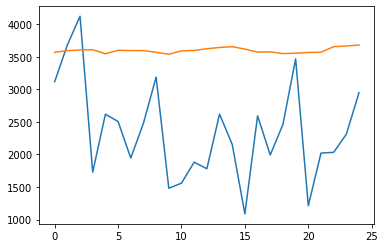

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3569.32161307 3593.92930961 3605.16862249 3608.88273191 3546.64098382
 3600.66629779 3595.68679726 3595.44835281 3569.76005244 3539.48879814
 3591.68661189 3597.58689249 3624.0045861  3642.91113615 3655.50995541
 3618.45350754 3572.7321434  3576.23248494 3549.25813401 3555.62927783
 3566.6553967  3570.27940798 3655.46806264 3666.1248939  3681.04531848]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 88%|████████▊ | 112/128 [08:06<01:12,  4.54s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


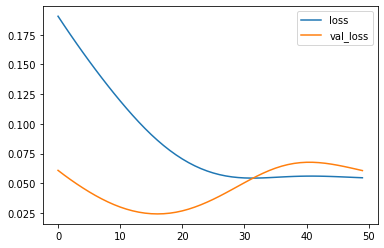

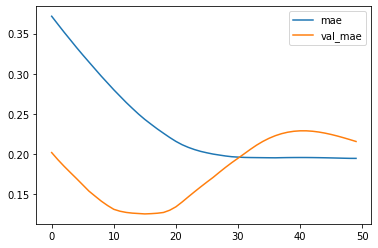

Test MSE: 1406417.778
bestmse=470928.3870781320
Test MAE: 1036.954
bestmae=569.47168
Test MAPE: 57.395
bestmape=26.40163


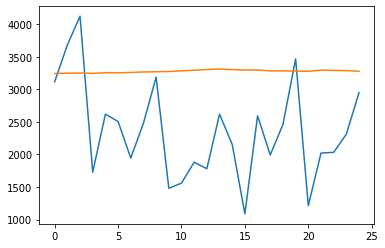

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3243.79515868 3248.55931318 3250.6908229  3244.94462734 3256.47259861
 3254.93246555 3259.18357712 3266.90303677 3270.5091145  3273.65824544
 3284.20876664 3294.06217498 3304.06392962 3312.04607987 3304.26794165
 3295.95997471 3297.09983099 3283.16689926 3283.38238877 3280.77571177
 3277.58138829 3294.69831377 3290.80989027 3287.79877591 3278.33359301]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 88%|████████▊ | 113/128 [08:10<01:04,  4.33s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


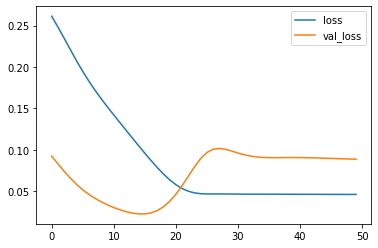

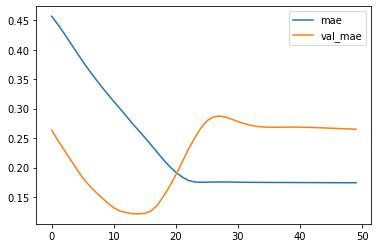

Test MSE: 2056206.087
bestmse=470928.3870781320
Test MAE: 1276.218
bestmae=569.47168
Test MAPE: 69.851
bestmape=26.40163


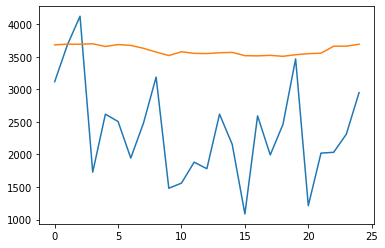

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3683.76519203 3694.01686859 3692.76496351 3700.18773055 3658.35435951
 3688.03653264 3675.19697344 3630.9797318  3572.76141095 3519.41527629
 3577.38051891 3552.79979444 3549.87332642 3562.12409139 3568.07544672
 3517.58519363 3514.35658121 3522.67086077 3507.39004362 3531.98368025
 3548.32013774 3555.39599824 3662.71407664 3664.04661095 3692.78447521]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 89%|████████▉ | 114/128 [08:14<01:02,  4.47s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


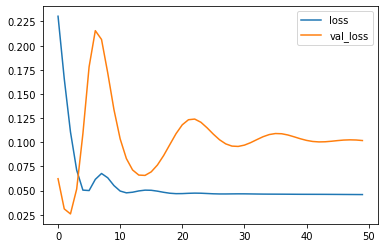

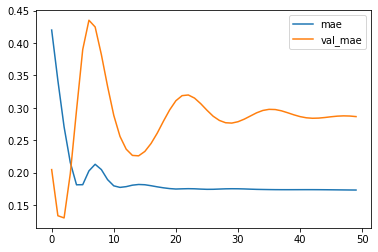

Test MSE: 2360174.027
bestmse=470928.3870781320
Test MAE: 1379.560
bestmae=569.47168
Test MAPE: 75.048
bestmape=26.40163


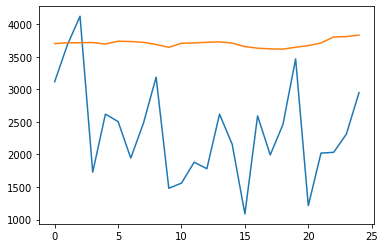

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3703.12051117 3715.303846   3716.46048808 3718.74880874 3696.70690072
 3739.60825038 3734.29073834 3722.30682456 3689.65571678 3645.81177986
 3708.36944532 3712.79056692 3723.19747627 3728.88398898 3709.94214571
 3656.81408298 3632.37740076 3621.40723455 3618.29970944 3645.93917978
 3672.56978047 3711.959885   3804.82467186 3810.41506076 3834.11833262]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 90%|████████▉ | 115/128 [08:19<00:59,  4.54s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


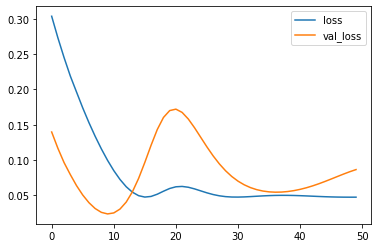

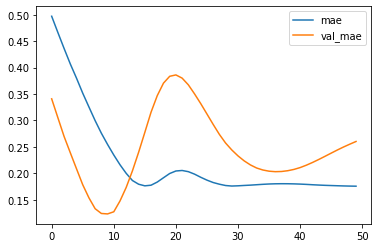

Test MSE: 1997384.129
bestmse=470928.3870781320
Test MAE: 1252.625
bestmae=569.47168
Test MAPE: 68.833
bestmape=26.40163


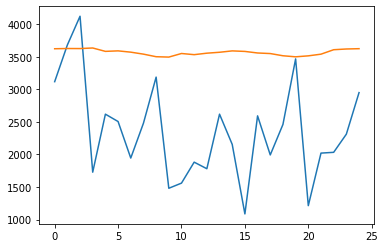

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3623.69412053 3627.34797323 3626.48716295 3635.40286195 3583.47706425
 3591.24042523 3571.37579334 3541.02161431 3501.38703966 3495.75734043
 3550.79726279 3532.97504675 3555.58508956 3569.76033938 3590.88691914
 3582.7077868  3558.75947094 3549.98150158 3516.04749954 3499.80257487
 3514.71668684 3540.51000607 3608.79292071 3620.03825927 3624.73541403]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 91%|█████████ | 116/128 [08:23<00:53,  4.45s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


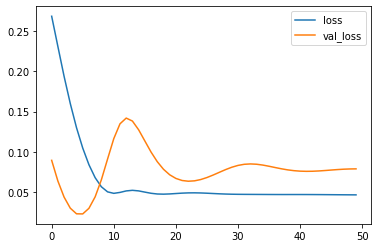

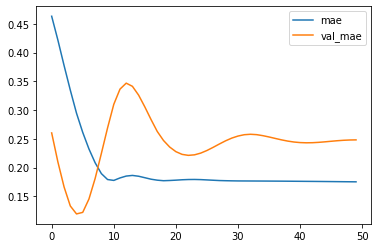

Test MSE: 1821856.289
bestmse=470928.3870781320
Test MAE: 1194.905
bestmae=569.47168
Test MAPE: 65.712
bestmape=26.40163


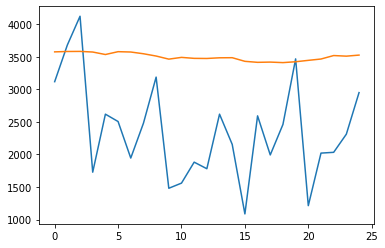

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3575.88758695 3581.71785498 3583.01394832 3573.43513846 3535.16007018
 3578.79023921 3573.62681222 3546.89234042 3511.85535347 3464.28009093
 3491.06936765 3476.17907143 3474.43478286 3484.79779088 3486.28727961
 3430.60203648 3415.13126719 3418.79788858 3410.84457546 3424.05485696
 3445.63981819 3466.0166322  3519.38486099 3510.01465416 3526.29458511]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 91%|█████████▏| 117/128 [08:27<00:47,  4.35s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


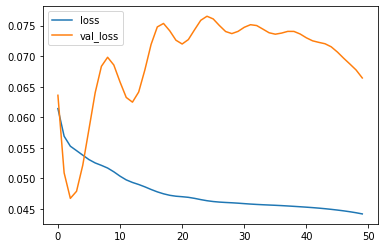

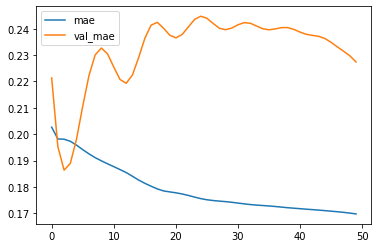

Test MSE: 1539339.843
bestmse=470928.3870781320
Test MAE: 1094.632
bestmae=569.47168
Test MAPE: 60.241
bestmape=26.40163


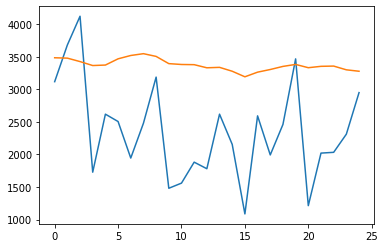

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3485.30308652 3479.59792292 3426.65823418 3365.93265992 3373.31798172
 3469.0171299  3520.27895594 3548.03549647 3506.03598905 3395.25200152
 3382.07127452 3379.2115193  3331.25778717 3338.01701295 3278.37677699
 3192.98367989 3264.23538572 3304.99891305 3352.53644341 3383.0713926
 3332.5502938  3353.74028659 3357.58107859 3300.21840316 3278.16673928]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 92%|█████████▏| 118/128 [08:32<00:43,  4.34s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


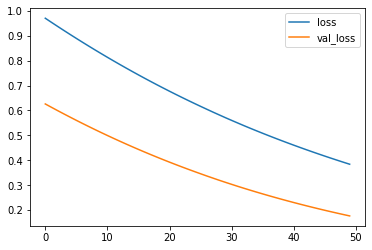

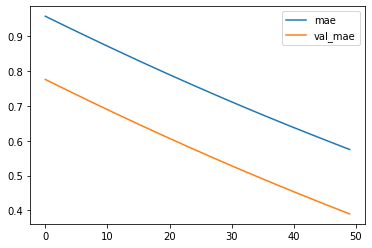

Test MSE: 4087447.600
bestmse=470928.3870781320
Test MAE: 1878.278
bestmae=569.47168
Test MAPE: 77.282
bestmape=26.40163


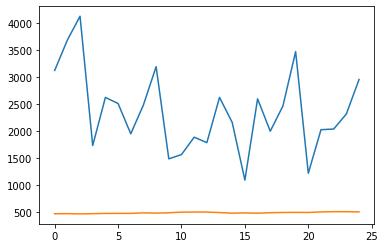

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[462.92043412 465.49145922 460.34912208 465.1830022  468.99768296
 470.3491551  470.48451751 479.65666625 475.8281408  481.39643556
 493.23989379 495.40375564 494.70793399 485.39755347 473.74985784
 479.2950542  473.46916196 482.58227345 487.01616374 488.94301581
 487.35776195 497.55477706 501.86743656 501.50661358 498.29880407]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 6,825
Trainable p




 93%|█████████▎| 119/128 [08:36<00:37,  4.19s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


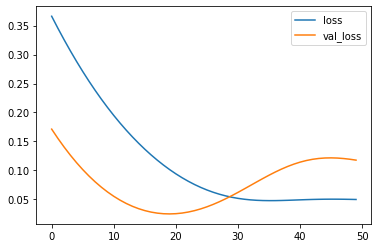

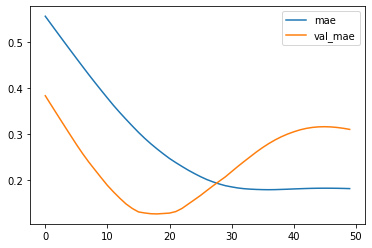

Test MSE: 2727900.713
bestmse=470928.3870781320
Test MAE: 1493.817
bestmae=569.47168
Test MAPE: 80.862
bestmape=26.40163


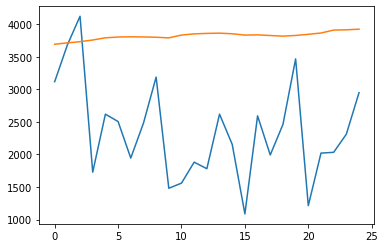

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3692.78533602 3713.83157349 3732.34042919 3758.01180029 3791.79630828
 3803.57506227 3807.45846438 3805.11160862 3800.52148128 3790.5865829
 3834.06237996 3852.2008003  3859.48526382 3863.31472182 3853.86159027
 3833.31663132 3836.87809038 3827.03300321 3817.27342319 3828.01231837
 3845.28189421 3865.64809155 3910.47794318 3914.54154158 3924.68705153]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 94%|█████████▍| 120/128 [08:39<00:32,  4.09s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


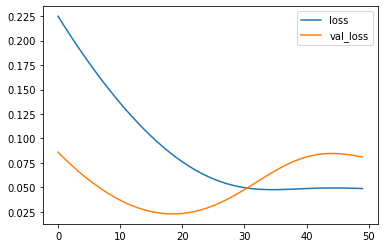

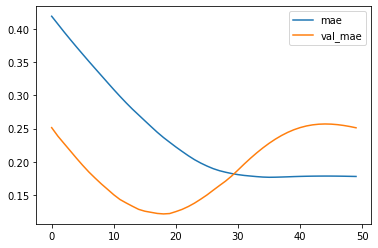

Test MSE: 1876822.873
bestmse=470928.3870781320
Test MAE: 1209.548
bestmae=569.47168
Test MAPE: 66.432
bestmape=26.40163


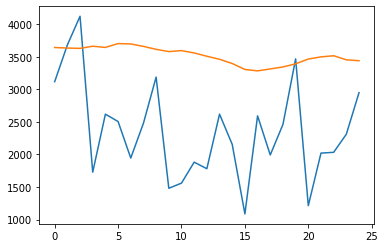

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3642.65318    3634.21178746 3629.4474895  3662.76027346 3643.82531667
 3703.2932471  3697.48822951 3659.89894009 3614.99333715 3580.06567311
 3595.24118447 3559.1861459  3508.42846775 3461.81100011 3397.18810731
 3305.84107244 3283.89944881 3313.83828688 3343.89032149 3392.44848591
 3465.67259502 3498.96012855 3516.3657124  3453.37907648 3440.11671597]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 95%|█████████▍| 121/128 [08:43<00:28,  4.00s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


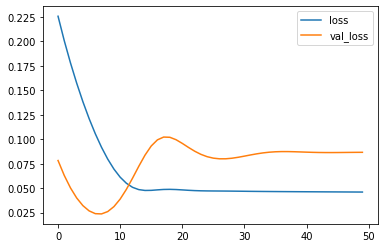

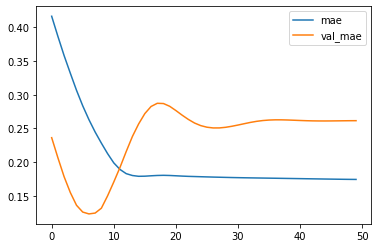

Test MSE: 2007189.004
bestmse=470928.3870781320
Test MAE: 1258.921
bestmae=569.47168
Test MAPE: 68.993
bestmape=26.40163


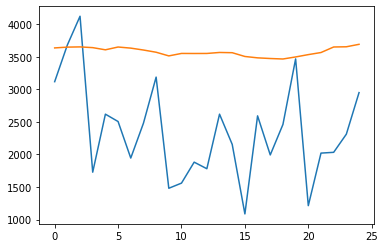

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3636.50326443 3648.74943841 3652.19784439 3640.90917838 3607.41964138
 3650.38096082 3633.33060467 3604.20135868 3570.19648325 3513.94482696
 3551.76710904 3550.93757486 3551.50083172 3566.70474982 3563.04314983
 3505.10373151 3483.96854365 3473.80753911 3466.45334995 3497.8178333
 3533.70472693 3565.6703428  3650.7952975  3654.02964866 3691.79081321]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 95%|█████████▌| 122/128 [08:48<00:25,  4.18s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


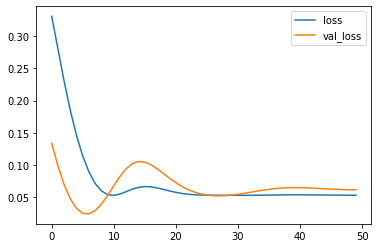

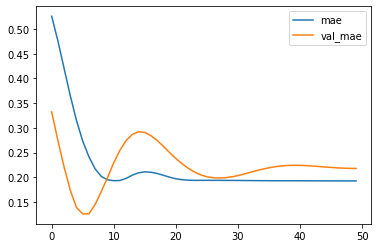

Test MSE: 1433652.558
bestmse=470928.3870781320
Test MAE: 1048.047
bestmae=569.47168
Test MAPE: 58.019
bestmape=26.40163


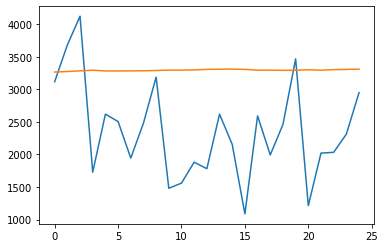

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3266.25828987 3273.88879913 3284.27863574 3294.07551754 3282.87910169
 3282.38973105 3284.11709034 3285.01964992 3289.81091994 3296.1351496
 3295.58896548 3298.97912329 3307.05323678 3309.03209615 3311.02300686
 3307.33242625 3294.19588751 3294.98898071 3292.32376862 3292.96578962
 3300.99600178 3294.40477747 3302.69638902 3306.09085089 3310.92573529]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 96%|█████████▌| 123/128 [08:52<00:20,  4.16s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


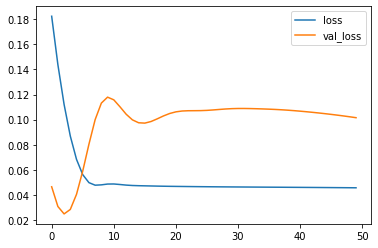

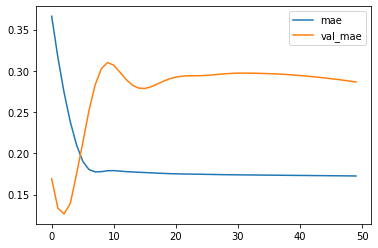

Test MSE: 2352489.931
bestmse=470928.3870781320
Test MAE: 1378.781
bestmae=569.47168
Test MAPE: 74.949
bestmape=26.40163


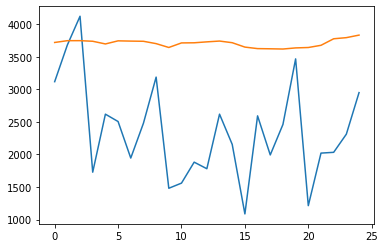

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3720.26555645 3747.6123513  3747.99282944 3738.74342299 3697.47761285
 3745.20609963 3741.20820975 3738.3649534  3702.34836435 3643.27497196
 3713.28438509 3715.38103199 3729.55599487 3741.90288365 3716.58501863
 3649.1646359  3625.89836872 3623.07060695 3619.52091229 3636.62693417
 3642.84485376 3676.6227622  3776.98147643 3794.28548467 3833.30142367]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 97%|█████████▋| 124/128 [08:57<00:17,  4.40s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


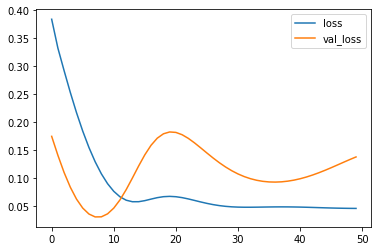

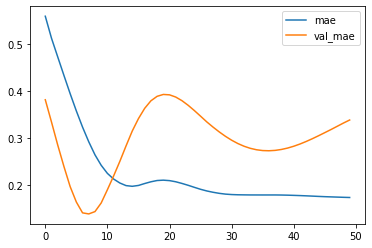

Test MSE: 3204446.587
bestmse=470928.3870781320
Test MAE: 1629.580
bestmae=569.47168
Test MAPE: 87.694
bestmape=26.40163


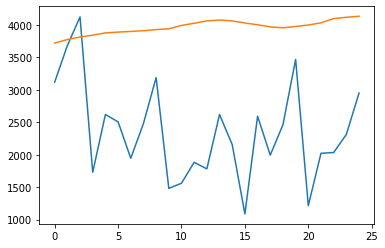

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3720.21333396 3774.40162802 3813.44826925 3841.72531307 3876.84206843
 3889.06069648 3899.49027383 3909.98699439 3927.5756439  3940.26111805
 3992.12493742 4025.0187937  4061.90049708 4074.73058736 4061.68472064
 4029.18827176 4002.42080224 3968.89711976 3955.41166592 3975.54114044
 3998.60970819 4031.95635068 4097.18740594 4117.27039671 4133.45276916]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 98%|█████████▊| 125/128 [09:01<00:12,  4.32s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


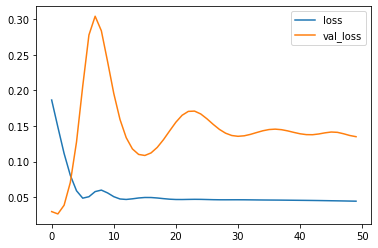

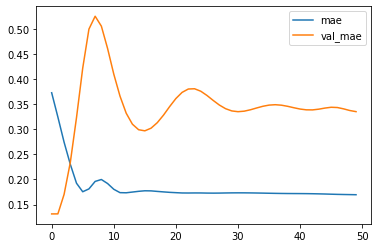

Test MSE: 3130123.815
bestmse=470928.3870781320
Test MAE: 1613.116
bestmae=569.47168
Test MAPE: 86.678
bestmape=26.40163


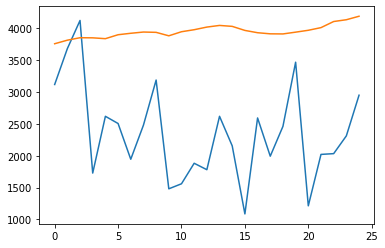

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3757.88985217 3813.66978443 3852.27683854 3850.46798921 3837.23790908
 3899.1777997  3922.02829552 3941.43440247 3936.57311988 3882.23332322
 3946.22222924 3977.92558491 4019.28723192 4045.13392138 4030.4249692
 3966.77091837 3930.74170411 3913.37858689 3911.7020154  3939.65797698
 3969.08936739 4010.67625976 4106.55962133 4134.56637073 4189.32739055]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 98%|█████████▊| 126/128 [09:06<00:08,  4.41s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


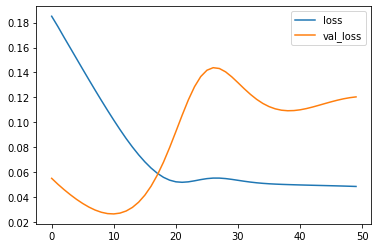

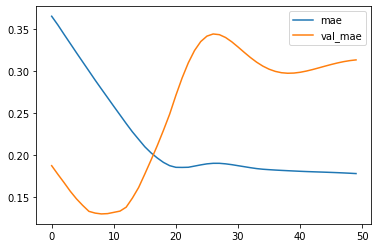

Test MSE: 2790334.363
bestmse=470928.3870781320
Test MAE: 1508.631
bestmae=569.47168
Test MAPE: 81.600
bestmape=26.40163


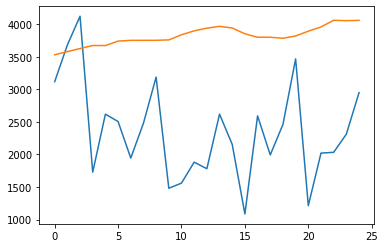

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3530.61470497 3579.85104442 3626.89002216 3673.97978771 3672.41713011
 3741.09946072 3752.97146916 3752.97749484 3753.51521432 3759.64705288
 3838.4261142  3898.68828559 3940.12855327 3967.79499567 3942.66306567
 3853.21569562 3800.49479616 3800.49766552 3785.06362414 3819.80736172
 3893.67521346 3958.93496239 4061.18344212 4055.10181749 4059.6245147 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 99%|█████████▉| 127/128 [09:10<00:04,  4.34s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


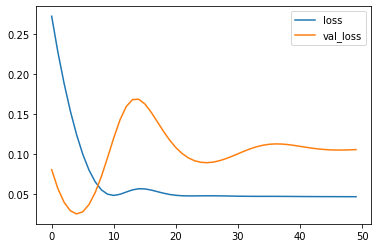

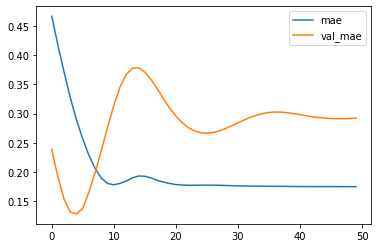

Test MSE: 2450742.485
bestmse=470928.3870781320
Test MAE: 1405.700
bestmae=569.47168
Test MAPE: 76.457
bestmape=26.40163


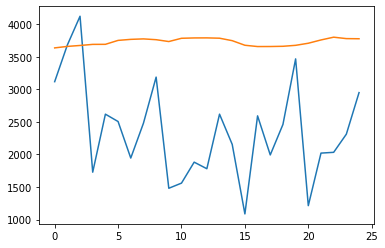

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3636.79450524 3659.72677803 3674.09571016 3690.89356196 3691.64591014
 3752.06532288 3767.95473289 3775.09314561 3762.82516444 3734.37882793
 3784.50667989 3789.75848341 3790.59691262 3785.67422557 3747.90072274
 3677.3650676  3657.53802443 3658.04274619 3661.52386296 3676.29622817
 3708.43859708 3758.86084616 3801.42676675 3779.44339383 3777.29165506]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




100%|██████████| 128/128 [09:14<00:00,  4.33s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(LSTM(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(LSTM(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': (0.1, 1, 10),
     'first_neuron':[ 8, 16, 32, 64],
     'second_neuron':[ 8, 16, 32, 64],
     'batch_size': [20,40,60,80,100],
     'epochs': [50],
     'dropout': (0, 0.25, 10),#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu','elu','tanh','sigmoid'],
     'last_activation': ['relu','elu','tanh','sigmoid'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=.001,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )


#六期不包含經濟特徵指標-BPN

  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-6)  var1(t-5)  var1(t-4)  var1(t-3)  var1(t-2)  var1(t-1)   var1(t)
6     0.120066   0.030744   0.050270   0.120482   0.146240   0.294765  0.389697
7     0.030744   0.050270   0.120482   0.146240   0.294765   0.389697  0.189655
8     0.050270   0.120482   0.146240   0.294765   0.389697   0.189655  0.132322
9     0.120482   0.146240   0.294765   0.389697   0.189655   0.132322  0.254674
10    0.146240   0.294765   0.389697   0.189655   0.132322   0.254674  0.342127
..         ...        ...        ...        ...        ...        ...       ...
125   0.232447   0.010594   0.323432   0.198795   0.296012   0.505193  0.036975
126   0.010594   0.323432   0.198795   0.296012   0.505193   0.036975  0.204612
127   0.323432   0.198795   0.296012   0.505193   0.036975   0.204612  0.207104
128   0.198795   0.296012   0.505193   0.036975   0.204612   0.207104  0.265060
129   0.296012   0.505193   0.036975   0.204612   0.207104   0.265060  0.397590

[124 rows x 7 columns]
(99, 6) 99 (99,)

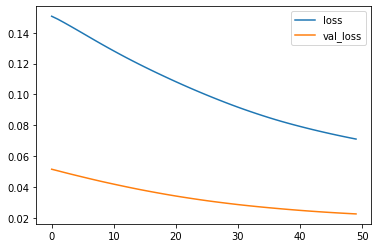

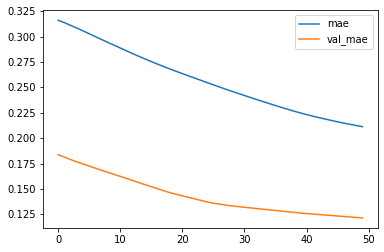

Test MSE: 520832.343
bestmse=520832.3426321560
Test MAE: 584.724
bestmae=584.72405
Test MAPE: 25.284
bestmape=25.28386


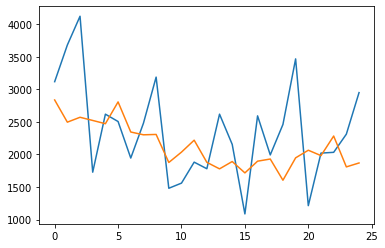

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2837.00778347 2496.15001106 2571.30922168 2522.47072005 2472.37988293
 2807.13737983 2345.03777927 2302.10673165 2307.61032218 1877.03560263
 2036.27101409 2219.42439786 1879.37707832 1779.07309729 1891.62095681
 1717.09260511 1897.03545347 1930.10914737 1604.34518108 1948.18903261
 2065.25356367 1982.43228075 2282.96962792 1809.13223359 1869.46707171]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 32)                224       
_________________________________________________________________
dense_2 (Dense)              (None, 16)                528       
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 17        
Total 

100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmsalesdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 1    #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times))
x_val = x_val.reshape((x_val.shape[0], n_times))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(Dense(params['first_neuron'],input_shape=(x_train.shape[1],),activation=params['activation']))##

    model.add(Dense(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()
    
    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    #x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.19],
     'first_neuron':[32],
     'second_neuron':[16],
     'batch_size': [100],
     'epochs': [50],
     'dropout': [0.02],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu'],
     'last_activation': ['relu'],
     'weight_regulizer': [None]}

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

#六期不包含經濟特徵指標-RNN

  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-6)  var1(t-5)  var1(t-4)  var1(t-3)  var1(t-2)  var1(t-1)   var1(t)
6     0.120066   0.030744   0.050270   0.120482   0.146240   0.294765  0.389697
7     0.030744   0.050270   0.120482   0.146240   0.294765   0.389697  0.189655
8     0.050270   0.120482   0.146240   0.294765   0.389697   0.189655  0.132322
9     0.120482   0.146240   0.294765   0.389697   0.189655   0.132322  0.254674
10    0.146240   0.294765   0.389697   0.189655   0.132322   0.254674  0.342127
..         ...        ...        ...        ...        ...        ...       ...
125   0.232447   0.010594   0.323432   0.198795   0.296012   0.505193  0.036975
126   0.010594   0.323432   0.198795   0.296012   0.505193   0.036975  0.204612
127   0.323432   0.198795   0.296012   0.505193   0.036975   0.204612  0.207104
128   0.198795   0.296012   0.505193   0.036975   0.204612   0.207104  0.265060
129   0.296012   0.505193   0.036975   0.204612   0.207104   0.265060  0.397590

[124 rows x 7 columns]
(99, 6) 99 (99,)

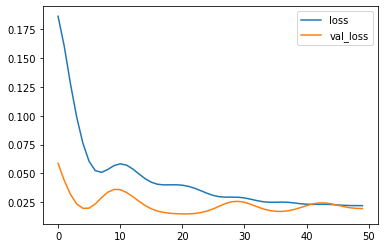

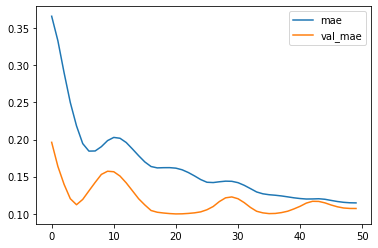

Test MSE: 452064.885
bestmse=452064.8850203822
Test MAE: 515.818
bestmae=515.81774
Test MAPE: 27.694
bestmape=27.69438


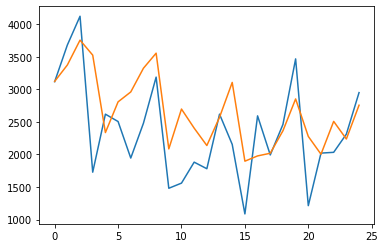

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3122.32851559 3374.18955213 3756.17024016 3525.91755021 2336.23484641
 2808.14165848 2960.3862862  3324.49210531 3555.74606109 2085.76466408
 2697.67043203 2404.42307192 2137.45581925 2571.61595708 3106.502949
 1897.04040313 1977.78878316 2018.89089587 2363.97904867 2853.04295737
 2276.9360652  2003.99708468 2508.39690238 2237.2921651  2756.33924359]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
simple_rnn_1 (SimpleRNN)     (None, 6, 64)             4224      
_________________________________________________________________
simple_rnn_2 (SimpleRNN)     (None, 64)                8256      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total pa

100%|██████████| 1/1 [00:02<00:00,  2.80s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmsalesdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 1    #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(SimpleRNN(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(SimpleRNN(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.55],
     'first_neuron':[64],
     'second_neuron':[64],
     'batch_size': [100],
     'epochs': [50],
     'dropout': [0.1],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu'],
     'last_activation': ['relu'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

#六期不包含經濟特徵指標-LSTM

In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmsalesdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 1    #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(LSTM(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(LSTM(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.1],
     'first_neuron':[32],
     'second_neuron':[64],
     'batch_size': [80],
     'epochs': [50],
     'dropout': [0.12],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['tanh'],
     'last_activation': ['elu'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )




  0%|          | 0/128 [00:00<?, ?it/s]

     var1(t-6)  var1(t-5)  var1(t-4)  var1(t-3)  var1(t-2)  var1(t-1)   var1(t)
6     0.120066   0.030744   0.050270   0.120482   0.146240   0.294765  0.389697
7     0.030744   0.050270   0.120482   0.146240   0.294765   0.389697  0.189655
8     0.050270   0.120482   0.146240   0.294765   0.389697   0.189655  0.132322
9     0.120482   0.146240   0.294765   0.389697   0.189655   0.132322  0.254674
10    0.146240   0.294765   0.389697   0.189655   0.132322   0.254674  0.342127
..         ...        ...        ...        ...        ...        ...       ...
125   0.232447   0.010594   0.323432   0.198795   0.296012   0.505193  0.036975
126   0.010594   0.323432   0.198795   0.296012   0.505193   0.036975  0.204612
127   0.323432   0.198795   0.296012   0.505193   0.036975   0.204612  0.207104
128   0.198795   0.296012   0.505193   0.036975   0.204612   0.207104  0.265060
129   0.296012   0.505193   0.036975   0.204612   0.207104   0.265060  0.397590

[124 rows x 7 columns]
(99, 6) 99 (99,)

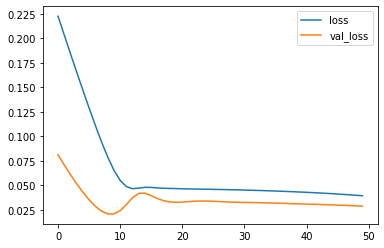

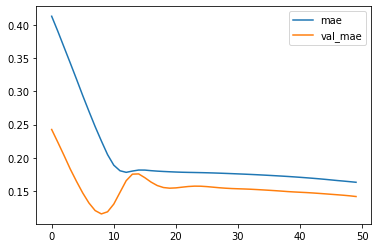

Test MSE: 667138.079
bestmse=667138.0790692554
Test MAE: 682.550
bestmae=682.55045
Test MAPE: 37.695
bestmape=37.69531


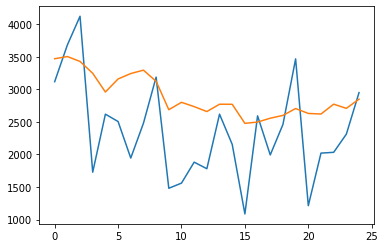

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3470.32125747 3503.94565475 3429.05874711 3246.78819603 2959.07326359
 3159.68395156 3242.85917097 3294.85756367 3123.99131411 2687.39393544
 2801.05489439 2734.88770795 2659.14917201 2771.73655707 2770.66886538
 2478.02636796 2497.93719667 2557.05348611 2600.07161903 2705.62231046
 2630.15593404 2621.17395264 2772.62060922 2708.43802088 2849.69813555]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




  1%|          | 1/128 [00:05<10:39,  5.04s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


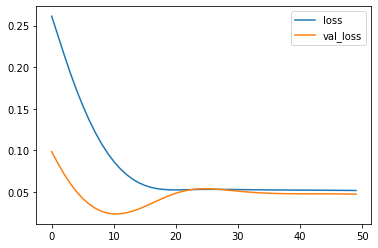

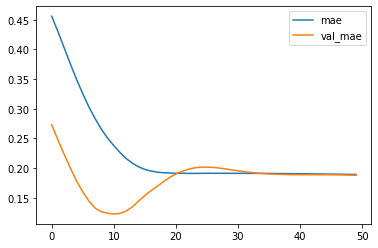

Test MSE: 1091682.737
bestmse=667138.0790692554
Test MAE: 904.593
bestmae=682.55045
Test MAPE: 50.227
bestmape=37.69531


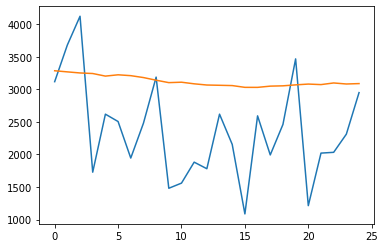

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3285.64832836 3268.61533189 3251.91805142 3243.37508327 3203.62975103
 3223.64875489 3210.44851619 3181.26848239 3140.62876827 3103.37863809
 3109.87086922 3085.15255857 3066.71945417 3062.64193934 3058.14219707
 3030.93729246 3030.55609697 3049.53179878 3054.25033033 3068.9993102
 3081.27145195 3073.16591889 3098.33428985 3082.42995912 3088.58676118]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




  2%|▏         | 2/128 [00:09<10:08,  4.83s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


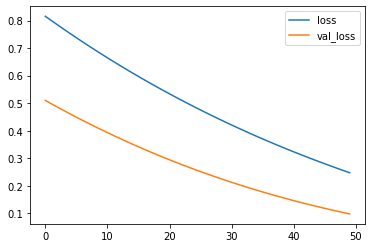

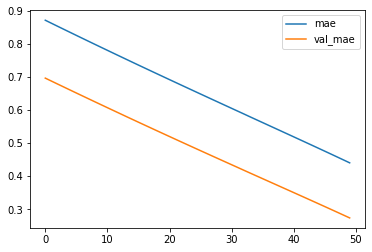

Test MSE: 2281230.740
bestmse=667138.0790692554
Test MAE: 1321.530
bestmae=682.55045
Test MAPE: 51.308
bestmape=37.69531


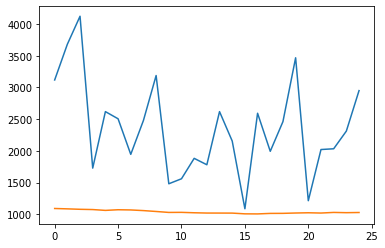

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1091.17784927 1085.44653856 1078.555824   1074.44581359 1061.26817115
 1071.53982569 1068.22298021 1058.06376902 1044.08503502 1029.2091215
 1030.33082903 1023.83339717 1019.37411299 1019.05170367 1018.47377717
 1006.82744449 1005.6923944  1013.7624549  1014.6161635  1019.95021027
 1023.77916612 1019.53009898 1029.20227089 1025.2398177  1028.06937283]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




  2%|▏         | 3/128 [00:13<09:29,  4.55s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


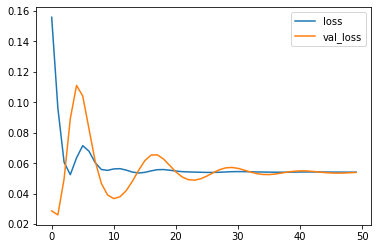

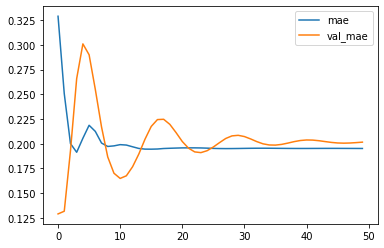

Test MSE: 1251167.190
bestmse=667138.0790692554
Test MAE: 970.570
bestmae=682.55045
Test MAPE: 53.897
bestmape=37.69531


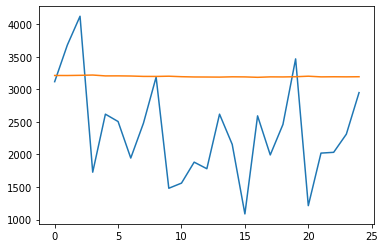

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3213.32247478 3212.70556074 3215.53059661 3220.01986569 3206.73584145
 3207.30512398 3204.98021889 3199.18868732 3198.64594644 3202.10740805
 3194.52739966 3190.37097722 3189.53656512 3188.28035599 3192.70707285
 3191.27210212 3185.02706701 3191.86850017 3190.86049134 3194.01435673
 3202.09894341 3191.96978885 3193.47706765 3192.34911925 3193.8411904 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




  3%|▎         | 4/128 [00:17<09:21,  4.53s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


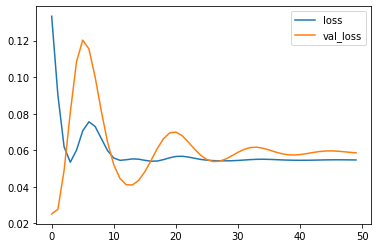

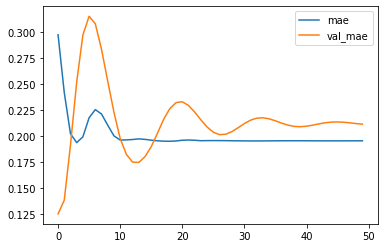

Test MSE: 1357841.601
bestmse=667138.0790692554
Test MAE: 1017.140
bestmae=682.55045
Test MAPE: 56.377
bestmape=37.69531


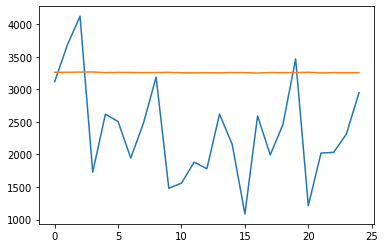

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3262.75077492 3262.81260979 3265.15702659 3267.33128989 3257.28635126
 3260.53791863 3259.59777033 3256.82911754 3258.60640383 3261.46974576
 3254.53018022 3254.31770355 3255.17607486 3254.58484167 3258.12334579
 3256.31636155 3251.82020599 3257.9958024  3255.65109867 3257.82134485
 3262.41950643 3253.23595196 3256.3819266  3256.07877791 3257.24517584]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




  4%|▍         | 5/128 [00:22<09:16,  4.52s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


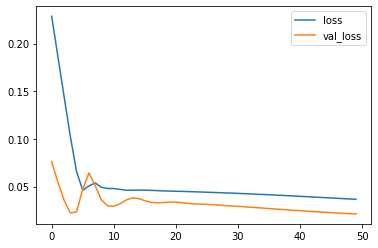

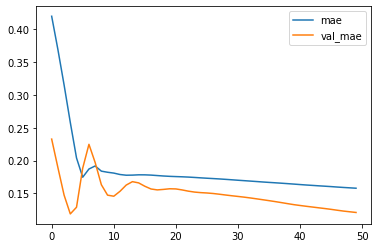

Test MSE: 495316.261
bestmse=495316.2607156371
Test MAE: 580.892
bestmae=580.89207
Test MAPE: 30.511
bestmape=30.51137


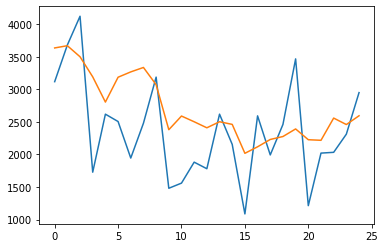

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3636.10356152 3670.56983125 3500.50958705 3192.35744041 2804.91433728
 3186.35013241 3268.20257336 3336.30385703 3071.8128686  2380.38939238
 2590.22452331 2502.36190498 2409.79065442 2502.6344949  2462.06292826
 2017.82255858 2117.89146668 2230.4508754  2275.73968238 2392.11377186
 2226.58885008 2217.58599404 2558.93708247 2459.65337682 2594.52656615]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




  5%|▍         | 6/128 [00:27<09:38,  4.74s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


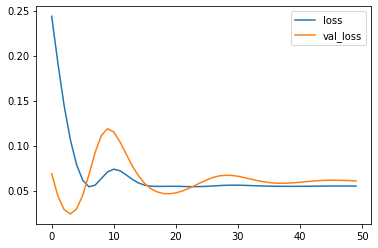

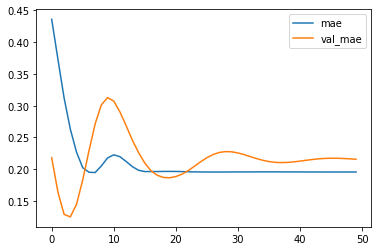

Test MSE: 1405686.000
bestmse=495316.2607156371
Test MAE: 1037.892
bestmae=580.89207
Test MAPE: 57.434
bestmape=30.51137


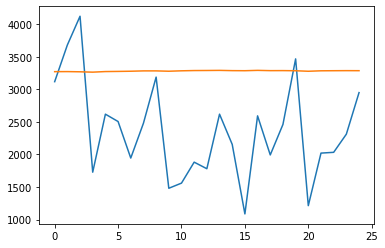

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3271.79258263 3272.83172411 3269.79665053 3264.29722059 3273.35968775
 3275.67426312 3278.52096272 3283.68381584 3283.72283924 3278.50216836
 3284.93543398 3288.80649781 3289.90116155 3291.54229635 3287.61513638
 3286.37097859 3291.75362527 3287.45846891 3288.03463793 3285.79194021
 3278.01767564 3285.09411001 3286.42119253 3287.43709213 3286.77986348]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




  5%|▌         | 7/128 [00:31<09:19,  4.62s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


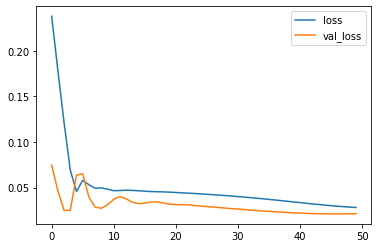

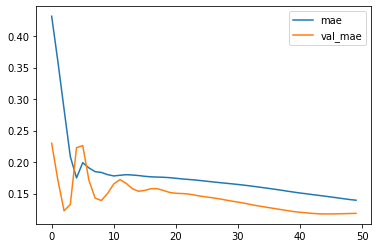

Test MSE: 492680.257
bestmse=492680.2566512054
Test MAE: 570.903
bestmae=570.90321
Test MAPE: 30.958
bestmape=30.51137


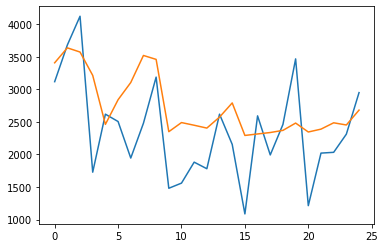

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3407.89242661 3637.54541874 3573.26699352 3214.44970584 2462.24283761
 2840.77296764 3105.08132082 3520.67033768 3460.38894153 2350.04941672
 2489.94141692 2448.85723776 2405.25447118 2573.96223897 2791.71926343
 2292.20942199 2315.06551307 2337.05032068 2370.14015478 2482.20101088
 2345.2327528  2389.18500835 2486.44164926 2452.9251402  2681.11733729]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




  6%|▋         | 8/128 [00:37<09:41,  4.85s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


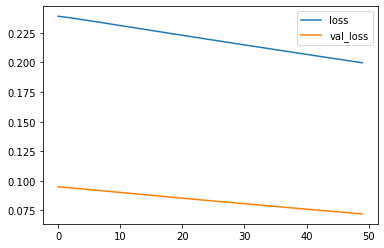

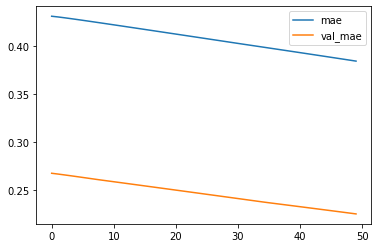

Test MSE: 1670343.277
bestmse=492680.2566512054
Test MAE: 1083.784
bestmae=570.90321
Test MAPE: 40.932
bestmape=30.51137


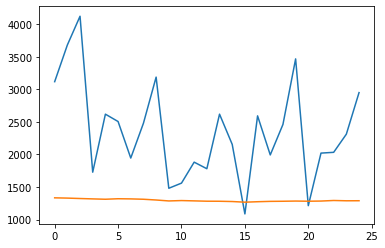

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1333.96856376 1329.88152622 1323.51524239 1317.75079048 1312.2978981
 1320.06457678 1317.72876809 1312.26323255 1300.71592892 1286.27992532
 1292.0526984  1287.21889    1282.17360922 1281.45752267 1277.25583596
 1267.21279829 1274.28195164 1279.75978959 1281.49765795 1284.49317012
 1281.95433573 1284.55251223 1293.25325973 1288.66523061 1289.42794438]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




  7%|▋         | 9/128 [00:41<09:00,  4.54s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


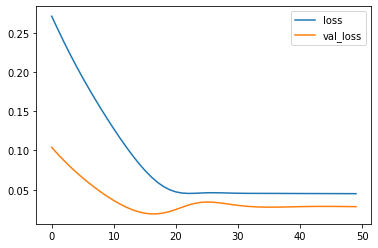

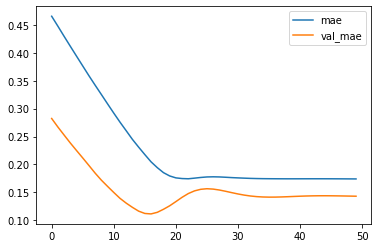

Test MSE: 658222.266
bestmse=492680.2566512054
Test MAE: 689.501
bestmae=570.90321
Test MAPE: 37.478
bestmape=30.51137


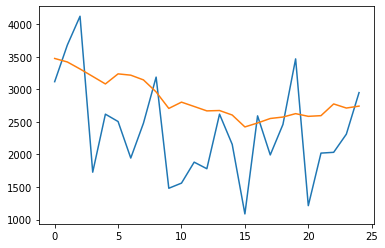

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3474.60952735 3420.66871625 3313.03529435 3198.58884603 3083.24815929
 3237.86632788 3218.02135116 3145.38933605 2960.80420959 2707.23202568
 2803.75238687 2737.06828386 2669.44618458 2674.98349017 2605.89012265
 2422.94627446 2483.64229423 2552.5979321  2574.78603441 2626.9963299
 2585.66610247 2596.0748769  2776.14763588 2713.05268133 2742.69669187]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




  8%|▊         | 10/128 [00:45<09:08,  4.65s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


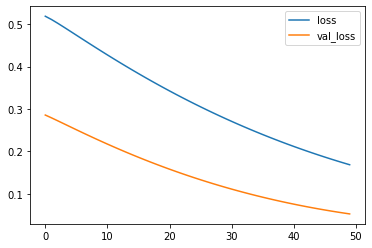

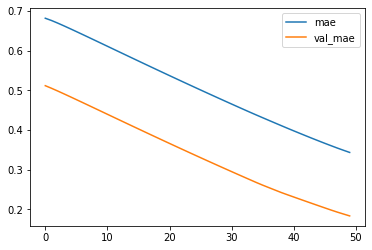

Test MSE: 1212901.604
bestmse=492680.2566512054
Test MAE: 883.857
bestmae=570.90321
Test MAPE: 33.262
bestmape=30.51137


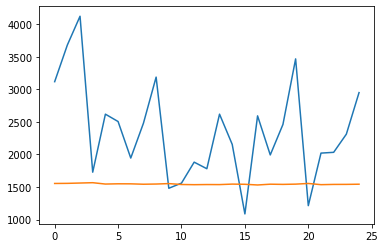

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1554.69436148 1556.32401881 1561.36374019 1566.49893978 1545.69064462
 1549.53645802 1548.94407707 1542.9003281  1545.92137764 1552.75316256
 1538.75330284 1535.96047562 1538.09220055 1537.34437162 1544.77251872
 1541.95444107 1531.509405   1543.48994727 1540.56717357 1544.35384212
 1554.68259707 1536.28209586 1540.05032873 1540.65522729 1543.25110829]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




  9%|▊         | 11/128 [00:49<08:32,  4.38s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


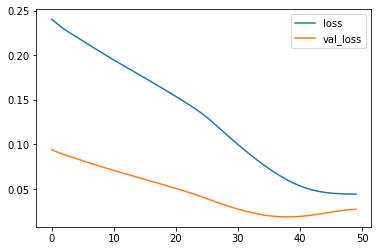

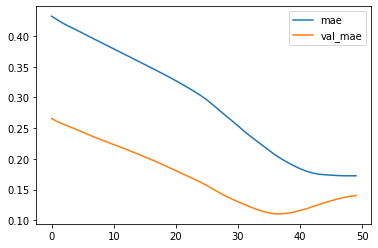

Test MSE: 633738.698
bestmse=492680.2566512054
Test MAE: 675.996
bestmae=570.90321
Test MAPE: 36.625
bestmape=30.51137


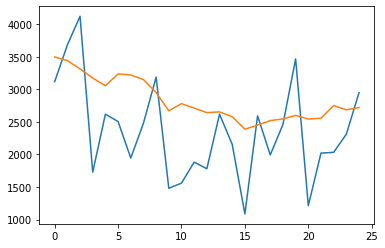

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3497.63706315 3441.3951627  3315.08172733 3174.52589893 3055.87023181
 3236.81958258 3220.92959869 3150.06454015 2950.76544011 2670.8771382
 2780.50118387 2712.36231148 2643.01113129 2654.23179328 2580.51788312
 2388.61099136 2450.81658542 2520.38841999 2545.24819046 2599.85928583
 2543.91981673 2557.28891772 2751.31096381 2686.09583354 2720.3859241 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




  9%|▉         | 12/128 [00:55<08:59,  4.65s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


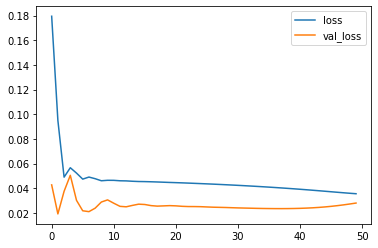

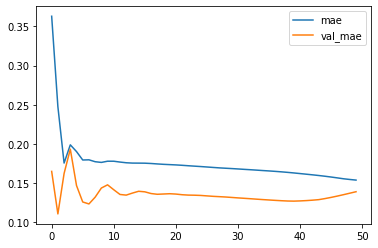

Test MSE: 648905.222
bestmse=492680.2566512054
Test MAE: 668.804
bestmae=570.90321
Test MAPE: 35.300
bestmape=30.51137


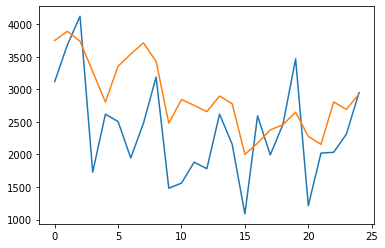

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3751.72874606 3891.34586084 3739.76463091 3270.86276406 2804.85092425
 3355.54081476 3541.46521854 3715.08979118 3427.31001103 2480.35213387
 2843.80560225 2754.12825239 2658.20342845 2897.95157313 2778.61156183
 1999.99689931 2174.16779953 2376.75103426 2457.07367188 2649.38700956
 2277.2822544  2155.2988382  2806.53050858 2692.02523822 2930.631805  ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 10%|█         | 13/128 [01:00<09:29,  4.95s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


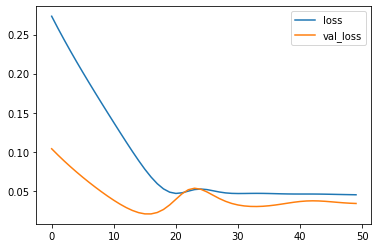

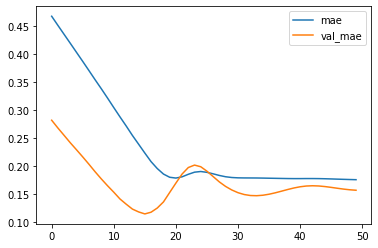

Test MSE: 782007.182
bestmse=492680.2566512054
Test MAE: 753.043
bestmae=570.90321
Test MAPE: 41.617
bestmape=30.51137


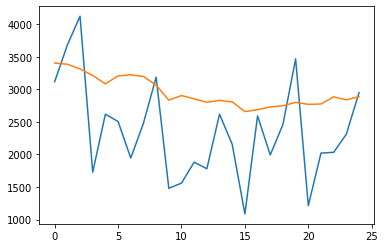

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3404.22623563 3386.00216466 3313.9684127  3214.10982925 3084.3960498
 3206.81044501 3223.1328426  3198.85038888 3065.48175246 2834.73022294
 2905.16272432 2854.83832067 2801.23064315 2830.83677804 2807.77064925
 2658.43326479 2687.31072378 2730.80588907 2747.9606902  2800.63998383
 2769.53847802 2775.0522548  2884.39409816 2838.6678561  2888.08668733]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 11%|█         | 14/128 [01:05<09:06,  4.80s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


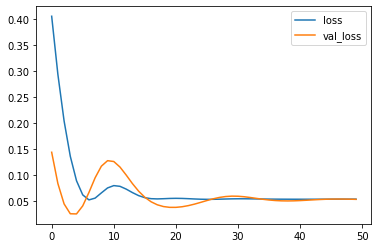

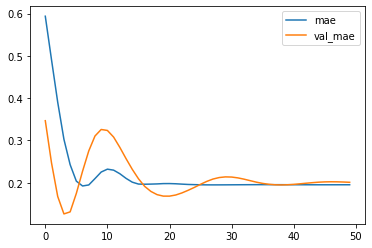

Test MSE: 1246485.469
bestmse=492680.2566512054
Test MAE: 967.409
bestmae=570.90321
Test MAPE: 53.776
bestmape=30.51137


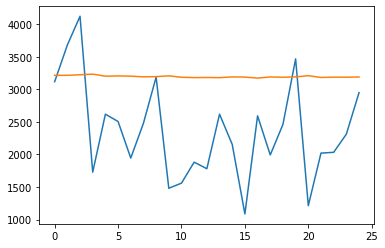

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3215.34810483 3215.79816514 3223.96797204 3233.82754952 3202.41859096
 3206.44890469 3203.02331018 3192.17882228 3195.64415753 3207.40311289
 3185.97295403 3180.70737755 3182.19198835 3179.90309381 3191.24756902
 3188.58120918 3172.98189223 3190.40053171 3185.8224557  3192.18283939
 3209.8241418  3182.90086561 3187.32500005 3186.74165761 3190.26954508]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 12%|█▏        | 15/128 [01:09<08:45,  4.65s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


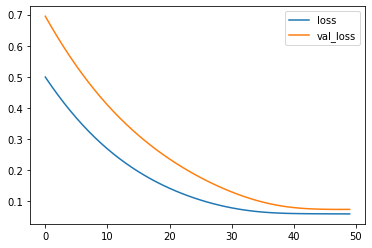

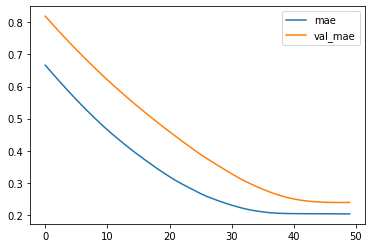

Test MSE: 1714249.002
bestmse=492680.2566512054
Test MAE: 1149.752
bestmae=570.90321
Test MAPE: 63.371
bestmape=30.51137


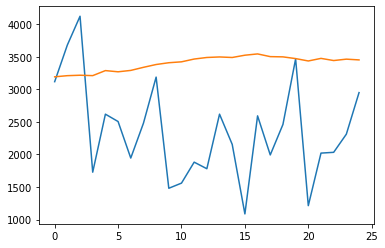

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3192.63849497 3210.24493456 3217.07230783 3210.88480353 3288.17695856
 3269.80525863 3290.98004377 3338.40839469 3381.68276215 3409.01807952
 3422.92590427 3465.64103198 3489.68977571 3497.73433471 3489.57213163
 3524.53881907 3544.3061794  3502.77093565 3499.06285191 3472.57399797
 3435.97521424 3475.79314148 3442.61980879 3463.97909427 3452.34294784]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 12%|█▎        | 16/128 [01:13<08:29,  4.55s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


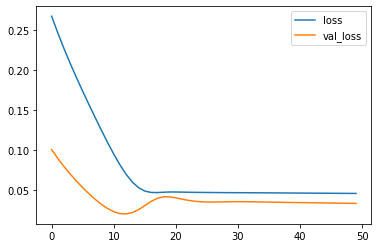

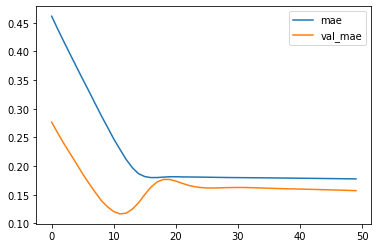

Test MSE: 784480.029
bestmse=492680.2566512054
Test MAE: 756.639
bestmae=570.90321
Test MAPE: 41.629
bestmape=30.51137


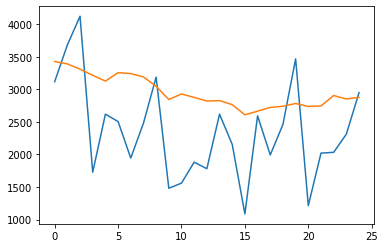

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3428.08244479 3391.14694077 3309.56005979 3216.10891765 3127.58577091
 3255.44622582 3242.9983353  3191.16636592 3048.28620631 2843.94677514
 2929.45765978 2876.73360401 2820.75841129 2827.40286237 2765.62423021
 2608.72391009 2664.94414681 2722.84726763 2740.60564023 2783.1698392
 2737.79079062 2744.95517111 2905.48954529 2852.42489558 2876.94851965]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 13%|█▎        | 17/128 [01:18<08:38,  4.67s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


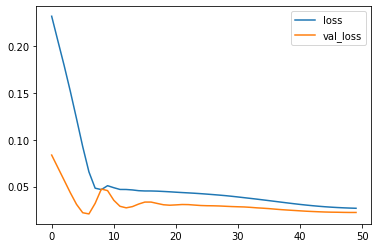

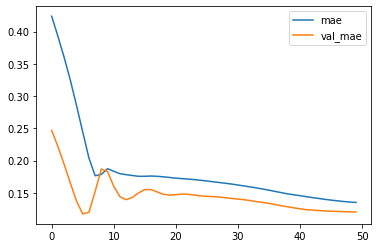

Test MSE: 515631.602
bestmse=492680.2566512054
Test MAE: 580.145
bestmae=570.90321
Test MAPE: 31.666
bestmape=30.51137


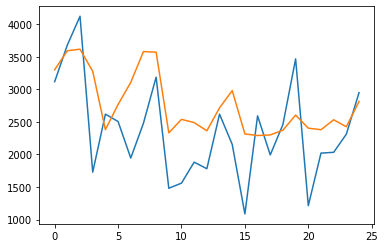

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3301.47561657 3593.00078225 3616.9927125  3277.32199746 2380.8212322
 2767.39592123 3107.23234224 3580.58646333 3570.99875844 2332.42533052
 2539.50816405 2489.68417811 2363.98349619 2715.86121833 2980.96381247
 2315.56277448 2290.85708904 2300.11811644 2373.38483566 2604.93419284
 2404.02006924 2380.62095034 2532.7129277  2425.44678485 2814.29343915]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 14%|█▍        | 18/128 [01:24<09:03,  4.94s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


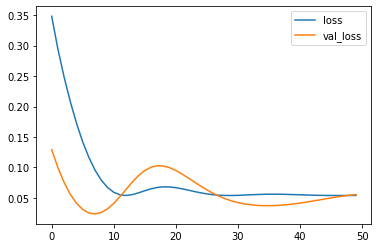

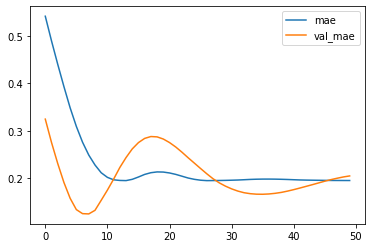

Test MSE: 1284088.066
bestmse=492680.2566512054
Test MAE: 985.601
bestmae=570.90321
Test MAPE: 54.687
bestmape=30.51137


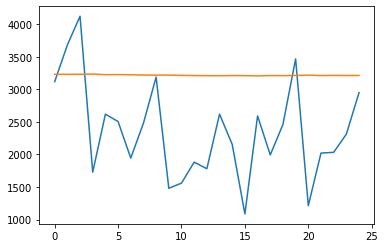

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3232.0812524  3230.65187693 3231.94108379 3234.81877255 3225.61125886
 3226.77163112 3224.33869433 3219.48429823 3218.16711503 3219.68084991
 3214.72143495 3211.75967371 3210.54047942 3209.18455976 3211.85063267
 3210.39155924 3206.54832828 3211.63055217 3210.6640057  3213.18087149
 3218.89650828 3212.18505746 3214.19203663 3212.72105533 3213.55618477]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 15%|█▍        | 19/128 [01:28<08:37,  4.75s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


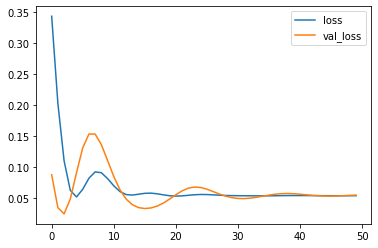

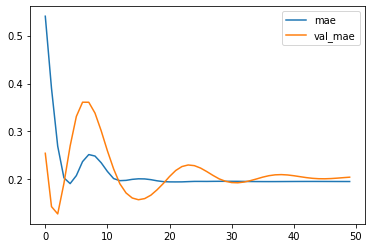

Test MSE: 1282062.574
bestmse=492680.2566512054
Test MAE: 984.692
bestmae=570.90321
Test MAPE: 54.619
bestmape=30.51137


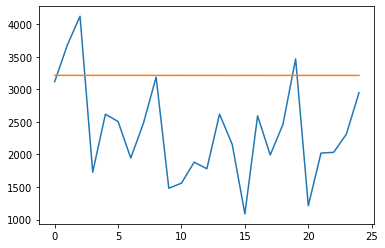

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3215.10722142 3214.97006565 3214.80048603 3214.75457615 3215.16546959
 3214.89574903 3214.78370023 3214.69862348 3214.36577684 3214.13163644
 3214.5161317  3214.2597537  3214.03149551 3213.99218518 3213.82777041
 3213.89663523 3214.05344617 3213.80108529 3213.99333292 3213.99333292
 3213.93020684 3214.40422636 3214.2425375  3214.12589771 3214.0923261 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 16%|█▌        | 20/128 [01:32<08:21,  4.64s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


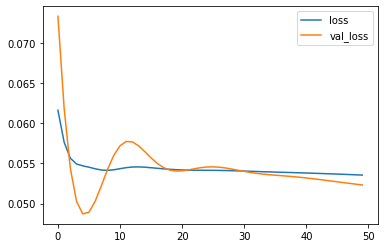

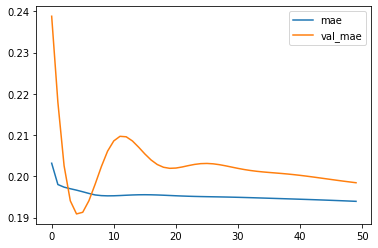

Test MSE: 1212265.314
bestmse=492680.2566512054
Test MAE: 955.341
bestmae=570.90321
Test MAPE: 53.028
bestmape=30.51137


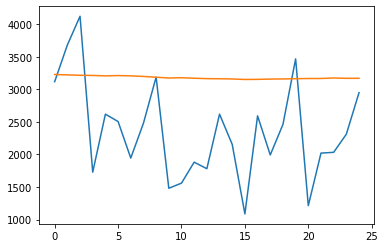

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3227.9977119  3222.21148866 3216.46428883 3213.82619226 3207.16753781
 3211.91404569 3207.21244341 3198.52184629 3185.98873556 3174.66793263
 3178.49021721 3171.15295732 3164.78755224 3162.63696122 3159.77304542
 3152.07912314 3153.65096271 3158.21024436 3159.81909877 3163.80881095
 3166.59496689 3167.13455147 3174.73148912 3169.41641605 3170.20334011]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 16%|█▋        | 21/128 [01:37<08:17,  4.65s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


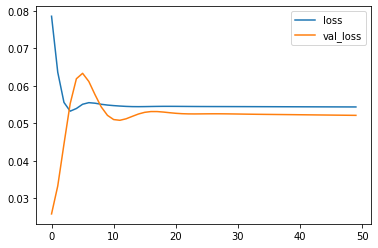

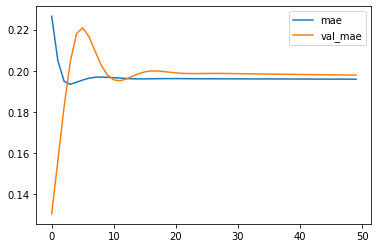

Test MSE: 1208074.375
bestmse=492680.2566512054
Test MAE: 952.572
bestmae=570.90321
Test MAPE: 52.852
bestmape=30.51137


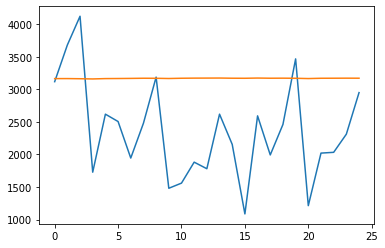

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3165.10562164 3165.58595377 3163.28529483 3160.05524772 3165.40489668
 3166.57186848 3168.3240478  3170.69701481 3169.99186772 3166.71763235
 3170.68711549 3172.46382791 3173.0663951  3173.80453992 3171.07935804
 3170.36531591 3173.61673981 3171.06544161 3171.7764709  3170.23131645
 3165.89469773 3170.47047824 3171.09614384 3171.87288165 3171.24750298]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 17%|█▋        | 22/128 [01:42<08:19,  4.71s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


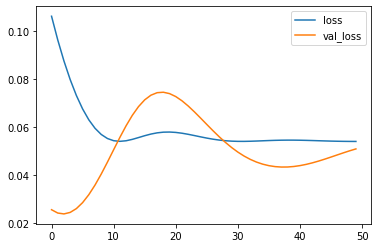

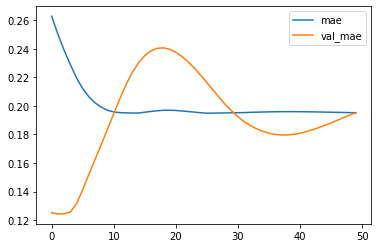

Test MSE: 1179464.656
bestmse=492680.2566512054
Test MAE: 940.092
bestmae=570.90321
Test MAPE: 52.193
bestmape=30.51137


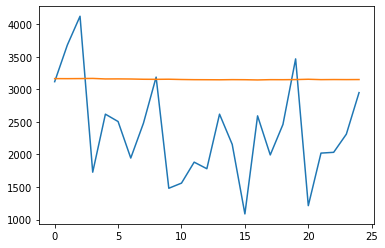

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3165.0549773  3164.3290273  3165.54893893 3168.04643649 3159.94893765
 3160.72194529 3159.14709288 3155.11720955 3154.16888356 3155.79222828
 3151.38430578 3148.73889232 3148.05727404 3147.0515607  3149.34318113
 3148.21164602 3144.71001327 3149.0111953  3148.43014836 3150.33282602
 3155.25250024 3149.38263494 3150.7249251  3149.90815961 3150.64156997]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 18%|█▊        | 23/128 [01:46<07:57,  4.54s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


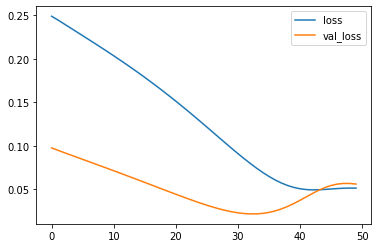

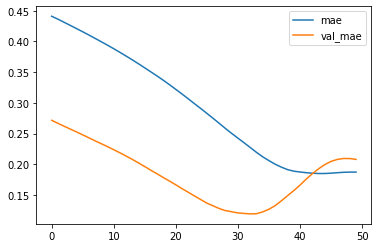

Test MSE: 1302975.116
bestmse=492680.2566512054
Test MAE: 1001.580
bestmae=570.90321
Test MAPE: 55.324
bestmape=30.51137


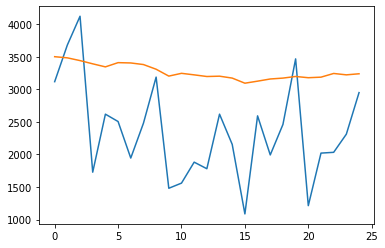

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3501.71357369 3484.05491161 3441.77793634 3392.20329845 3345.41596425
 3410.32952398 3405.55475283 3381.06584811 3309.20483208 3203.69101202
 3246.3028425  3222.74361289 3197.41713977 3202.43996775 3173.17500067
 3094.69779682 3126.01177931 3159.35153532 3173.07055569 3197.93477368
 3178.88188589 3187.40706396 3244.21709919 3222.93471277 3239.44419312]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 19%|█▉        | 24/128 [01:50<07:37,  4.40s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


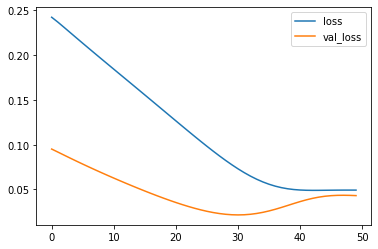

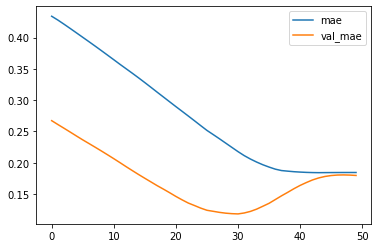

Test MSE: 1000366.681
bestmse=492680.2566512054
Test MAE: 865.279
bestmae=570.90321
Test MAPE: 47.938
bestmape=30.51137


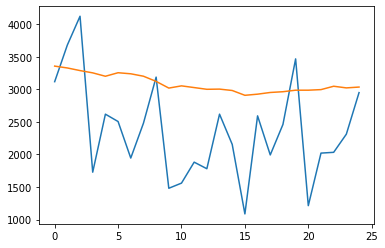

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3357.14837795 3328.7036196  3288.43964916 3253.42389554 3201.31804502
 3255.4191103  3239.12411517 3201.9274987  3122.47973126 3019.67445076
 3053.72394484 3027.48529977 3000.9938634  3003.86452222 2982.6188637
 2908.75373787 2926.23507303 2952.22020948 2963.78275663 2987.26939124
 2987.17757148 2996.16930872 3047.87330431 3022.62602574 3035.2983008 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 20%|█▉        | 25/128 [01:54<07:29,  4.37s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


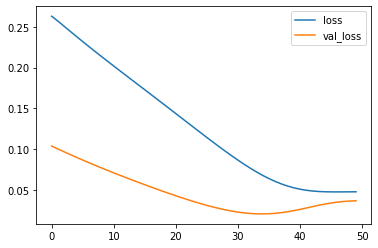

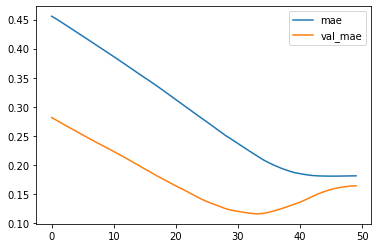

Test MSE: 852372.655
bestmse=492680.2566512054
Test MAE: 789.629
bestmae=570.90321
Test MAPE: 43.649
bestmape=30.51137


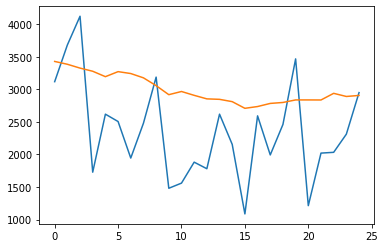

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3428.88744587 3385.42470443 3326.53165179 3278.16013974 3194.9550789
 3272.20361954 3243.04338437 3176.9848035  3057.34709531 2918.4084425
 2967.22226757 2908.13610649 2854.0201205  2846.74613017 2811.32020044
 2708.98492235 2736.21436006 2784.08803684 2798.73501068 2837.74707603
 2837.6687423  2836.8846876  2938.87521118 2890.87786466 2906.65221304]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total pa




 20%|██        | 26/128 [01:59<07:24,  4.36s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


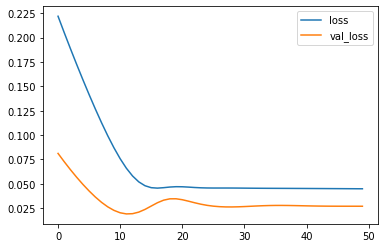

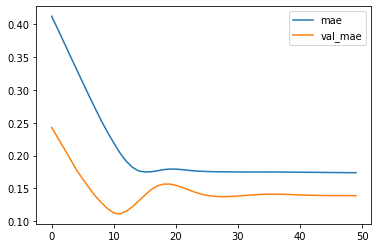

Test MSE: 623449.969
bestmse=492680.2566512054
Test MAE: 668.749
bestmae=570.90321
Test MAPE: 36.149
bestmape=30.51137


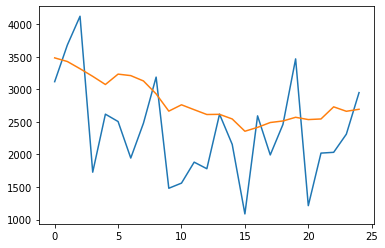

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3483.69824922 3427.77958304 3316.86747825 3199.92554092 3074.60232431
 3234.03357011 3211.11564416 3129.29706174 2930.85475487 2665.62734324
 2762.88857514 2687.64314002 2613.84185761 2616.47938031 2545.33082825
 2356.74895966 2416.26810831 2490.86104923 2514.36863023 2570.98197031
 2536.0627709  2545.24474722 2731.46828258 2663.27733117 2694.0865919 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 21%|██        | 27/128 [02:03<07:21,  4.37s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


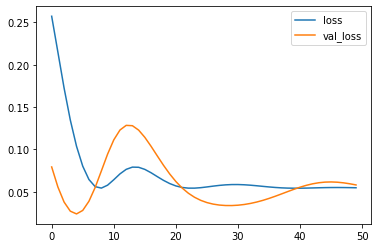

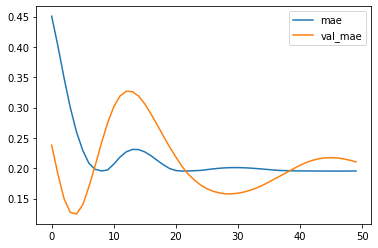

Test MSE: 1346502.646
bestmse=492680.2566512054
Test MAE: 1012.891
bestmae=570.90321
Test MAPE: 56.117
bestmape=30.51137


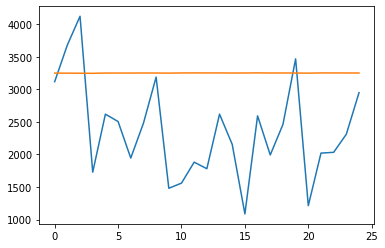

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3249.36044061 3248.94868636 3247.71586257 3246.53856105 3250.71320397
 3250.32110488 3250.45926493 3251.44403189 3250.83457822 3249.44465655
 3252.02866554 3252.74012524 3252.42191237 3252.40297455 3250.87058878
 3251.33614367 3253.38114196 3251.3019982  3251.73025131 3250.9367277
 3248.93089628 3252.43712002 3251.99093336 3251.92206854 3251.2715829 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 22%|██▏       | 28/128 [02:08<07:15,  4.35s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


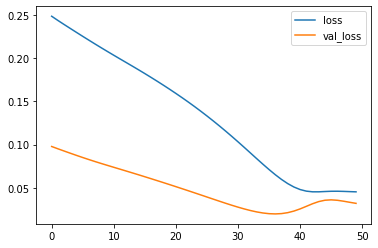

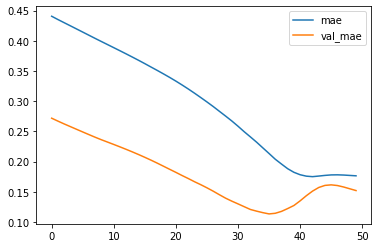

Test MSE: 743162.683
bestmse=492680.2566512054
Test MAE: 731.924
bestmae=570.90321
Test MAPE: 40.280
bestmape=30.51137


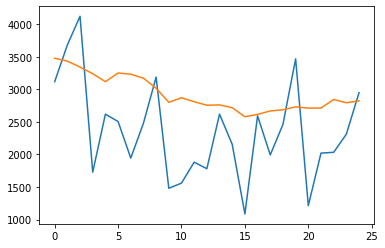

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3477.70672274 3433.77168339 3342.72521478 3240.84745735 3118.40953332
 3250.56844437 3233.60761249 3171.5255447  3017.16533226 2800.99019015
 2870.73820388 2810.68965691 2755.91170782 2761.15447283 2718.13060117
 2579.48878443 2615.242109   2668.89684415 2686.39998651 2731.64690071
 2712.08699566 2712.95383161 2844.81533271 2794.25162381 2823.01244301]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 23%|██▎       | 29/128 [02:12<07:11,  4.36s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


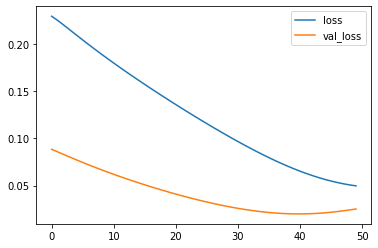

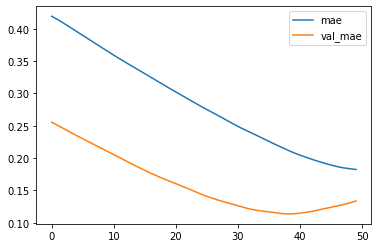

Test MSE: 584310.723
bestmse=492680.2566512054
Test MAE: 642.748
bestmae=570.90321
Test MAPE: 34.724
bestmape=30.51137


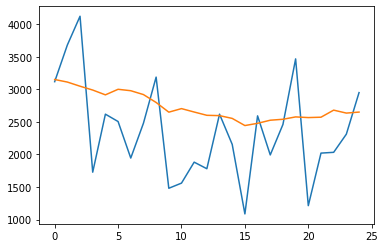

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3151.30166799 3112.18243176 3048.34775424 2989.50792837 2915.72974437
 3001.06444985 2979.1800701  2919.94312376 2798.63228732 2649.89947861
 2704.37241393 2651.96040189 2601.53743547 2596.53584081 2553.89072567
 2444.17586452 2478.44357401 2526.09946579 2540.55935687 2576.87780339
 2566.71536416 2572.33545101 2680.90729958 2635.59195095 2651.04952115]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 23%|██▎       | 30/128 [02:16<06:58,  4.27s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


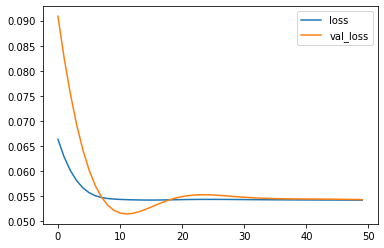

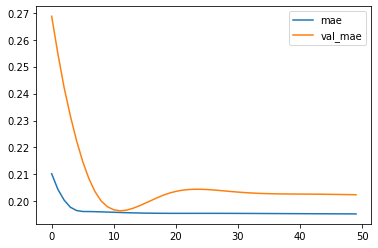

Test MSE: 1259556.758
bestmse=492680.2566512054
Test MAE: 974.642
bestmae=570.90321
Test MAPE: 54.090
bestmape=30.51137


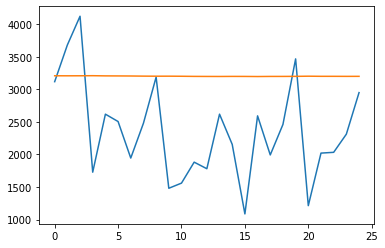

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3208.71441388 3208.18329394 3208.60925156 3209.91208792 3207.16524231
 3206.29195029 3205.26744258 3203.24181253 3202.1117121  3202.53178751
 3201.26610947 3199.23717964 3198.41481888 3197.96031106 3199.01236469
 3198.60548836 3197.05201274 3198.65986288 3198.78812361 3199.75079644
 3202.21357465 3200.36742353 3200.24604928 3199.57662582 3199.96427739]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 24%|██▍       | 31/128 [02:21<07:03,  4.36s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


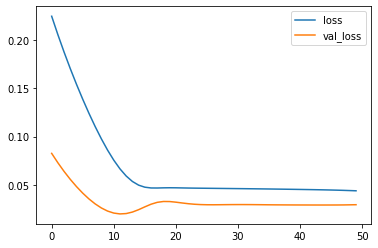

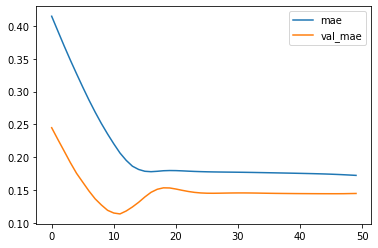

Test MSE: 682145.520
bestmse=492680.2566512054
Test MAE: 696.691
bestmae=570.90321
Test MAPE: 38.291
bestmape=30.51137


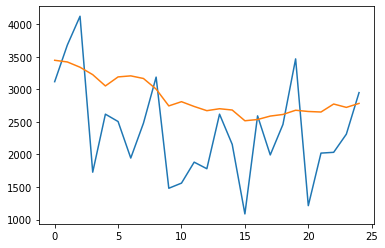

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3446.57838833 3420.85766411 3339.94408023 3225.90938616 3052.58753181
 3191.21256274 3207.28891206 3167.08419406 3004.16810131 2745.97853106
 2810.58277297 2737.2477628  2672.5971806  2702.55079591 2682.66077012
 2517.69609237 2536.9253028  2589.74476504 2614.58488035 2679.30633593
 2660.1642108  2652.09884888 2774.84809929 2723.23362797 2784.16479242]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 25%|██▌       | 32/128 [02:26<07:16,  4.55s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


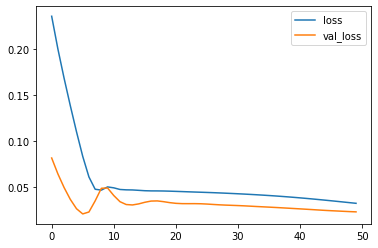

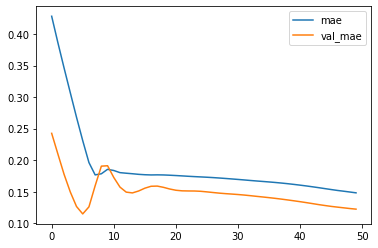

Test MSE: 528843.979
bestmse=492680.2566512054
Test MAE: 589.053
bestmae=570.90321
Test MAPE: 32.142
bestmape=30.51137


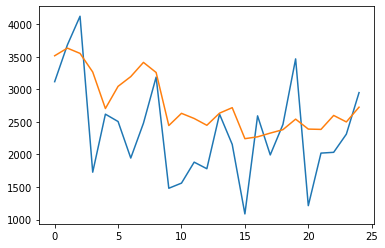

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3516.10804319 3633.5704838  3552.37684965 3266.63216847 2705.68916672
 3046.32599783 3195.89192742 3414.26529205 3259.23321718 2444.31789821
 2631.76392764 2552.84441078 2448.12856185 2634.50575185 2718.8509559
 2242.64870054 2271.09503704 2328.13505208 2381.25264162 2542.68713641
 2389.78011519 2385.14924282 2599.46862143 2499.85120833 2726.27673578]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 26%|██▌       | 33/128 [02:31<07:30,  4.74s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


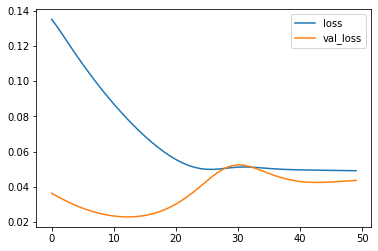

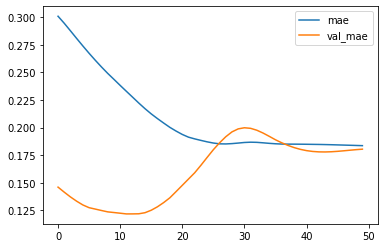

Test MSE: 1009756.361
bestmse=492680.2566512054
Test MAE: 868.493
bestmae=570.90321
Test MAPE: 48.143
bestmape=30.51137


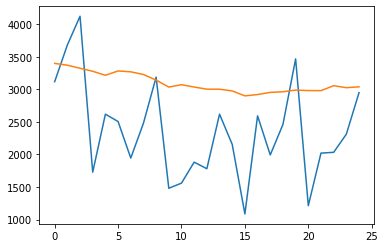

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3398.60672265 3371.26681429 3323.87949532 3277.80692059 3216.28366214
 3282.95140976 3269.3144533  3228.68478197 3142.51308197 3035.14263761
 3071.48805618 3035.77719826 3002.77961433 3002.26599753 2975.99177229
 2900.01321375 2920.33020145 2953.5785681  2963.21519572 2988.88326705
 2981.54428554 2980.27803361 3056.08629519 3025.72996414 3038.98787713]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 27%|██▋       | 34/128 [02:35<07:15,  4.63s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


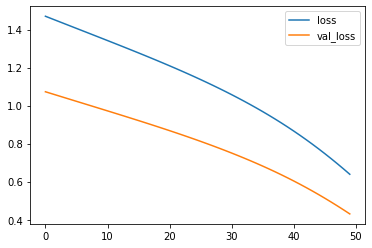

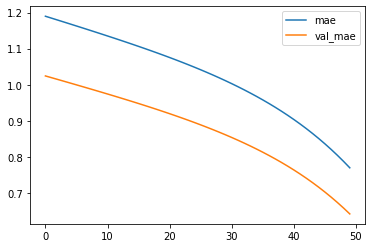

Test MSE: 9972734.839
bestmse=492680.2566512054
Test MAE: 3088.130
bestmae=570.90321
Test MAPE: 135.945
bestmape=30.51137


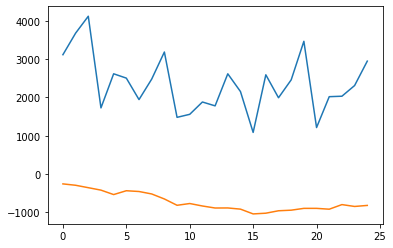

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[ -258.07115787  -293.95145196  -357.24797958  -421.13215369
  -537.07268173  -436.89445072  -457.01990813  -521.0989123
  -652.04565901  -817.18766367  -771.11881912  -835.55721158
  -888.35572743  -886.82793266  -917.6443668  -1042.68050319
 -1023.85386503  -960.39823097  -944.94324321  -897.61575055
  -897.44186687  -919.33958918  -799.19758964  -847.7904734
  -820.76920831]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)         




 27%|██▋       | 35/128 [02:39<06:57,  4.49s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


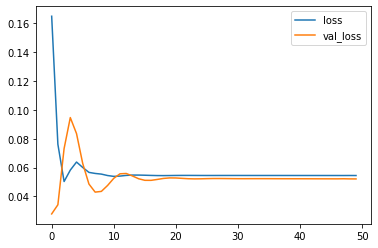

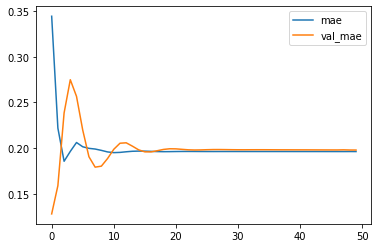

Test MSE: 1207346.878
bestmse=492680.2566512054
Test MAE: 952.131
bestmae=570.90321
Test MAPE: 52.846
bestmape=30.51137


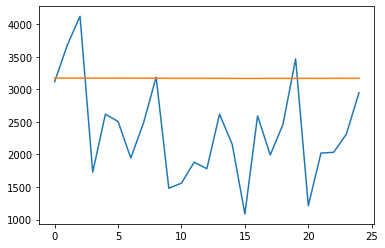

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3174.05230981 3173.38891202 3172.83082002 3172.29711765 3171.1403321
 3172.7115978  3172.23628706 3171.4942686  3170.70920962 3169.57021415
 3169.38212711 3169.44927031 3169.11972344 3168.85932833 3168.66822845
 3167.53482825 3167.70770764 3168.74340588 3168.307262   3168.79763693
 3168.89146525 3168.23007601 3169.87035    3169.33019155 3169.40866876]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 28%|██▊       | 36/128 [02:45<07:25,  4.84s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


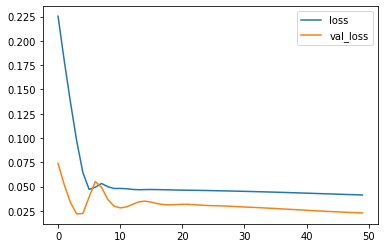

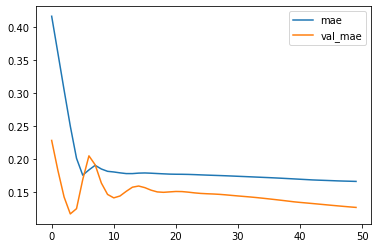

Test MSE: 531821.171
bestmse=492680.2566512054
Test MAE: 612.515
bestmae=570.90321
Test MAPE: 32.150
bestmape=30.51137


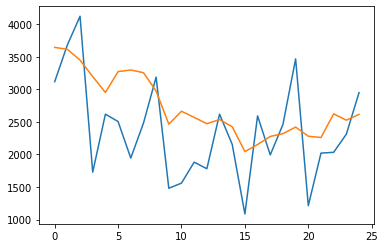

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3644.25084388 3615.85414743 3449.47845817 3196.7972129  2951.88248491
 3272.57979363 3297.47629201 3256.47059005 2973.76542997 2465.52295518
 2663.78893942 2569.51558    2472.58705127 2536.36577612 2426.44805068
 2043.84377733 2152.87235749 2276.64984578 2319.62149495 2420.70472449
 2280.21690011 2260.91853791 2623.86283702 2526.39917123 2615.66491032]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 29%|██▉       | 37/128 [02:50<07:32,  4.97s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


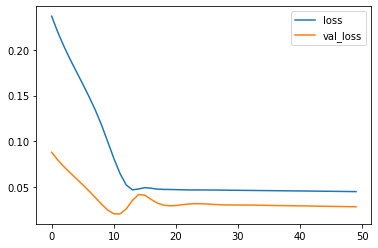

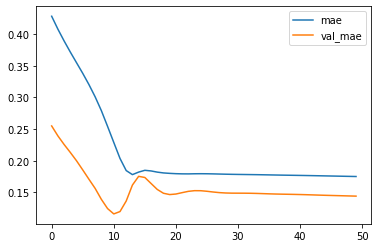

Test MSE: 665640.277
bestmse=492680.2566512054
Test MAE: 693.057
bestmae=570.90321
Test MAPE: 37.794
bestmape=30.51137


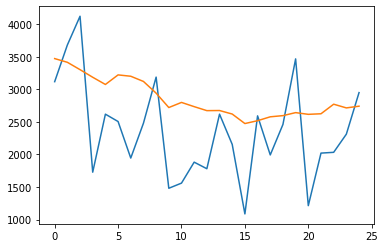

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3472.61502993 3415.82479334 3302.68032056 3185.77367646 3075.14520866
 3222.21966636 3201.45936137 3121.71576214 2941.89895076 2720.8019824
 2799.40443414 2734.64940697 2673.2977367  2675.07459259 2620.8996411
 2474.94610184 2518.65087444 2578.38809502 2596.58418965 2642.70238733
 2616.45183438 2625.11129886 2772.12851268 2715.13483793 2741.62914366]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total pa




 30%|██▉       | 38/128 [02:55<07:26,  4.97s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


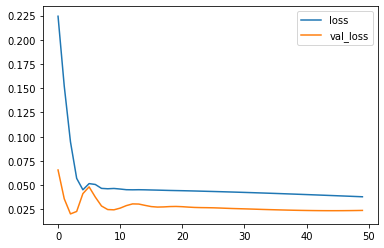

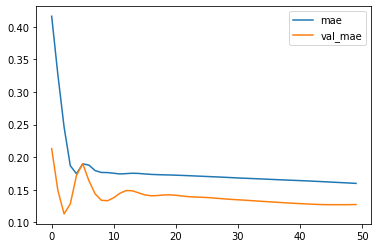

Test MSE: 554746.933
bestmse=492680.2566512054
Test MAE: 612.775
bestmae=570.90321
Test MAPE: 32.317
bestmape=30.51137


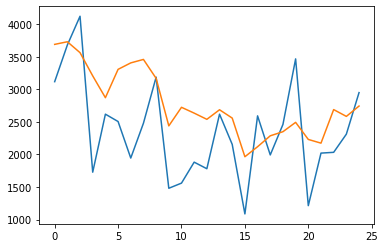

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3690.86945927 3731.22481906 3563.74585795 3207.28001702 2871.99111325
 3307.28034723 3406.49418378 3459.76169777 3169.20408285 2439.31085175
 2724.50461435 2635.14432961 2539.7052896  2686.74101084 2558.94640791
 1965.23436737 2119.10628518 2286.7673794  2349.73809034 2493.31923646
 2230.78092441 2173.93322873 2689.33793199 2584.80012733 2743.61460257]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 30%|███       | 39/128 [03:00<07:29,  5.05s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


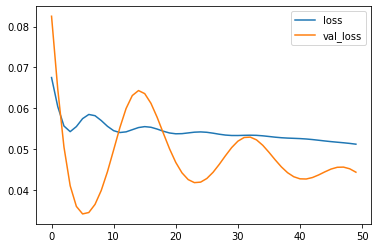

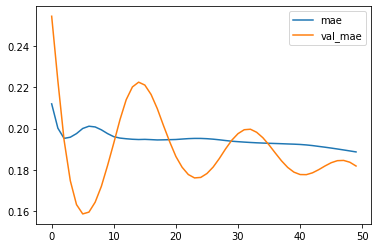

Test MSE: 1027530.138
bestmse=492680.2566512054
Test MAE: 875.213
bestmae=570.90321
Test MAPE: 48.591
bestmape=30.51137


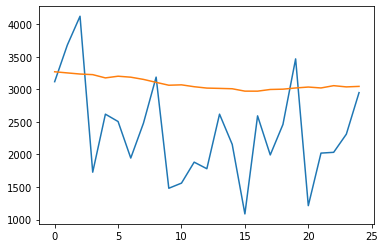

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3270.22246468 3252.61229491 3235.41301858 3226.15356934 3175.97909015
 3201.94328022 3186.94696087 3153.09057522 3107.58269203 3063.48596382
 3069.4040345  3040.64450651 3019.59669089 3014.85606521 3009.37126905
 2972.71567184 2972.35441846 2998.26179504 3002.84460551 3021.30166912
 3035.63573843 3021.58774507 3056.68355405 3037.85548121 3045.59373522]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 31%|███▏      | 40/128 [03:05<07:14,  4.94s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


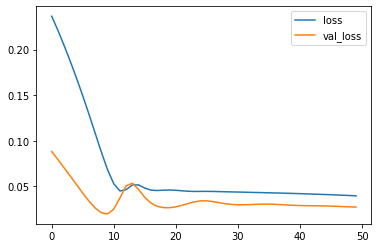

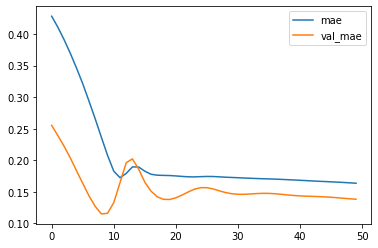

Test MSE: 631361.965
bestmse=492680.2566512054
Test MAE: 665.073
bestmae=570.90321
Test MAPE: 36.446
bestmape=30.51137


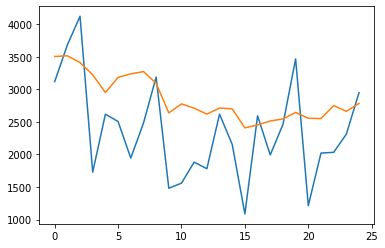

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3504.85065329 3515.63603222 3411.57640767 3223.48663563 2951.23271662
 3184.03756559 3238.4874025  3273.21736711 3093.63856977 2637.89634007
 2777.01303715 2710.79893655 2619.53583068 2713.30762464 2699.70739609
 2408.46141988 2453.50532633 2514.43118244 2545.43154305 2646.03185803
 2555.61191583 2551.66065317 2750.74742001 2663.1061734  2783.82046831]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 32%|███▏      | 41/128 [03:10<07:02,  4.86s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


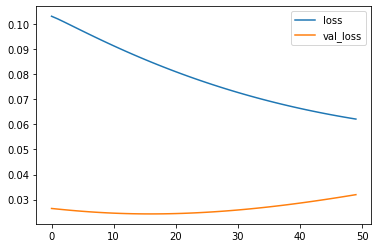

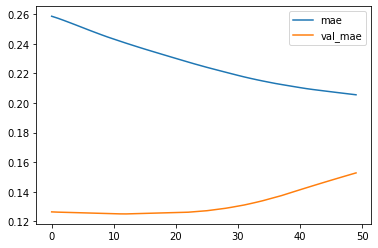

Test MSE: 741099.113
bestmse=492680.2566512054
Test MAE: 735.167
bestmae=570.90321
Test MAPE: 39.630
bestmape=30.51137


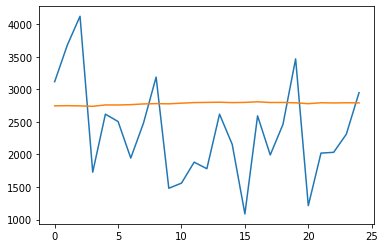

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2746.66918784 2749.29795897 2746.3894245  2739.68959463 2760.85161108
 2760.03642374 2765.07417244 2776.27216643 2780.71193892 2777.94414693
 2787.95537049 2796.68857771 2799.9250809  2802.4514156  2796.65586692
 2800.02364367 2808.92327422 2798.26127809 2798.88766104 2793.25021452
 2780.06762242 2794.2843346  2791.1722185  2794.31259787 2791.97592837]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 33%|███▎      | 42/128 [03:14<06:36,  4.61s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


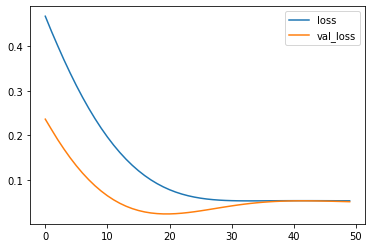

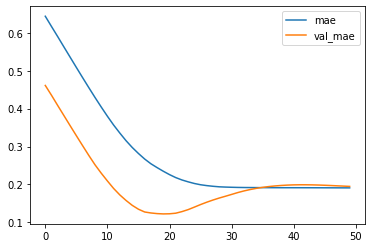

Test MSE: 1168935.243
bestmse=492680.2566512054
Test MAE: 937.109
bestmae=570.90321
Test MAPE: 52.070
bestmape=30.51137


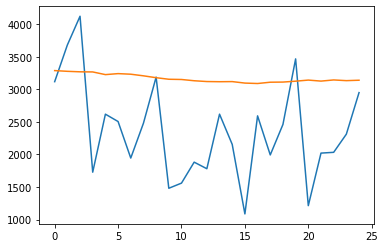

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3288.224877   3277.0514161  3269.51918268 3267.61277485 3226.43892795
 3241.77125025 3232.75211054 3207.94484949 3179.15705824 3155.27014685
 3151.67540312 3132.30128962 3120.15138292 3117.44671702 3119.25657064
 3096.4960295  3089.89318424 3109.75552064 3111.91457629 3125.62541896
 3142.44737345 3126.88464093 3144.63942683 3133.84974384 3140.35259163]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 34%|███▎      | 43/128 [03:18<06:23,  4.51s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


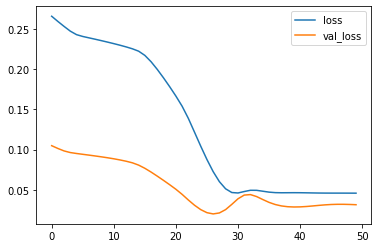

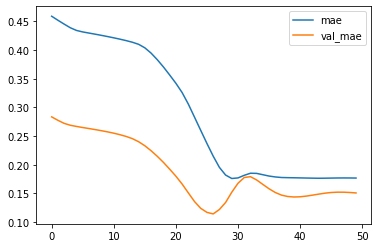

Test MSE: 729844.515
bestmse=492680.2566512054
Test MAE: 726.515
bestmae=570.90321
Test MAPE: 39.864
bestmape=30.51137


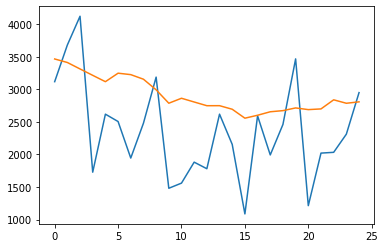

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3466.75492048 3412.73950583 3313.47029048 3215.38841945 3117.97037661
 3248.38872927 3226.2113871  3155.95463449 2993.17426282 2787.11665434
 2863.40940863 2805.94759655 2748.89380854 2749.38619202 2694.64066678
 2557.26481503 2602.46165878 2655.83146572 2673.28023356 2714.77760166
 2688.89791447 2699.62404096 2839.36195612 2786.50892228 2808.26303273]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 34%|███▍      | 44/128 [03:22<06:16,  4.48s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


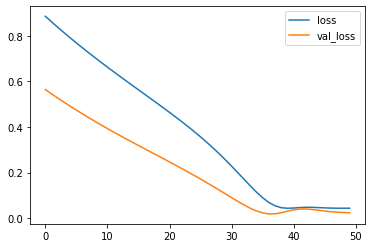

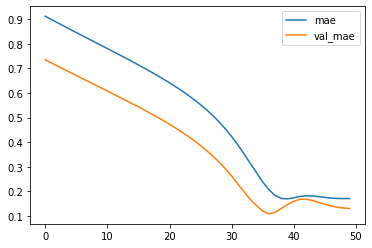

Test MSE: 543596.508
bestmse=492680.2566512054
Test MAE: 626.550
bestmae=570.90321
Test MAPE: 33.413
bestmape=30.51137


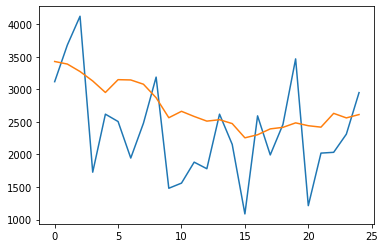

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3428.02993536 3388.57527006 3273.99539614 3128.7187407  2952.37085128
 3148.94032192 3144.51460934 3078.90766692 2871.63717675 2564.36147845
 2662.80919385 2583.73229218 2512.25634527 2534.00959492 2474.30035067
 2255.64937472 2302.88146091 2392.93096775 2416.5104264  2485.39705598
 2441.54938889 2419.69628525 2631.45303166 2561.64820445 2613.11576414]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 35%|███▌      | 45/128 [03:27<06:09,  4.45s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


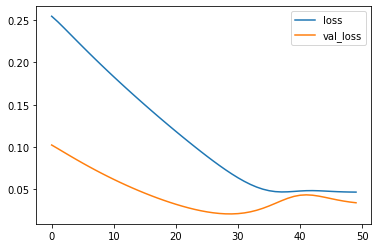

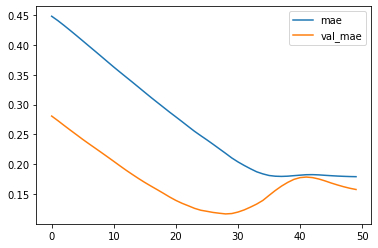

Test MSE: 793576.312
bestmse=492680.2566512054
Test MAE: 759.591
bestmae=570.90321
Test MAPE: 41.998
bestmape=30.51137


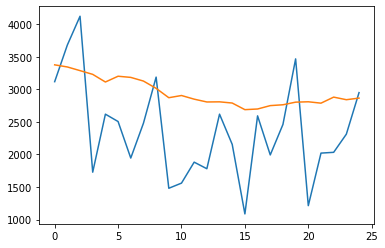

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3376.61287653 3344.0441196  3287.70695615 3230.40295929 3113.04195082
 3201.67025989 3183.79166079 3127.58017564 3015.66709197 2871.76299852
 2905.611063   2849.50674874 2806.31286705 2808.41697431 2789.97899199
 2688.31026798 2698.33913815 2750.4171558  2763.36862034 2803.5625782
 2809.24019587 2788.0963999  2880.86635417 2841.12102193 2865.69758582]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 36%|███▌      | 46/128 [03:31<05:59,  4.39s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


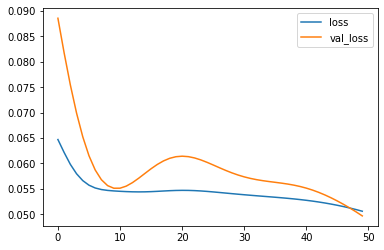

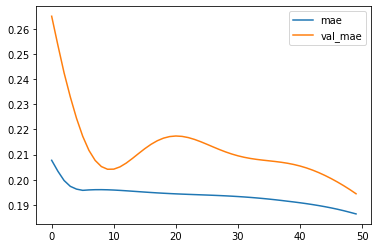

Test MSE: 1151531.762
bestmse=492680.2566512054
Test MAE: 936.155
bestmae=570.90321
Test MAPE: 51.786
bestmape=30.51137


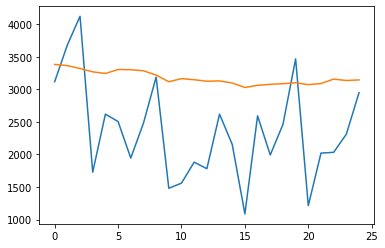

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3382.5355382  3364.38607079 3320.34343016 3269.02192128 3244.00390518
 3304.7713722  3302.01749665 3285.31505132 3219.04055053 3117.06853437
 3164.41223896 3148.08811975 3125.01983893 3129.70235991 3097.06014717
 3029.09142828 3061.66793251 3078.01715869 3086.68078375 3101.63391912
 3072.06723803 3089.65043575 3157.69892305 3136.0455274  3145.26179266]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 37%|███▋      | 47/128 [03:35<05:48,  4.30s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


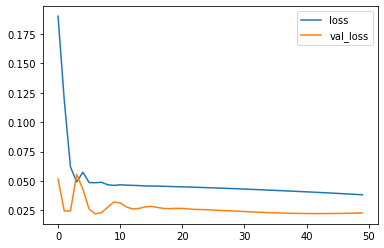

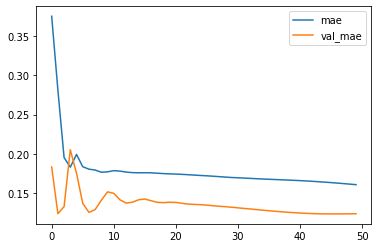

Test MSE: 528533.048
bestmse=492680.2566512054
Test MAE: 595.954
bestmae=570.90321
Test MAPE: 31.283
bestmape=30.51137


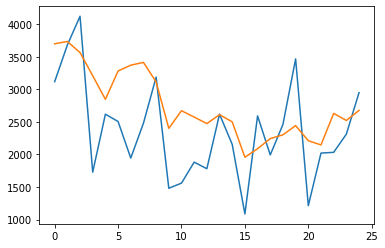

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3700.04569685 3735.70734513 3565.03248239 3209.52687532 2847.18442607
 3281.99992746 3371.40655249 3414.19083196 3114.29572099 2401.53376222
 2671.75875139 2574.69019753 2474.15315211 2611.61336327 2500.9543367
 1956.90925595 2088.58023104 2243.50721532 2301.95982003 2443.58592254
 2210.93666503 2146.77803591 2630.96997362 2522.34834152 2676.68430781]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 38%|███▊      | 48/128 [03:41<06:09,  4.62s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


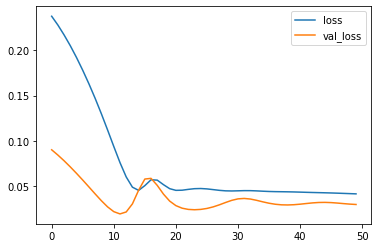

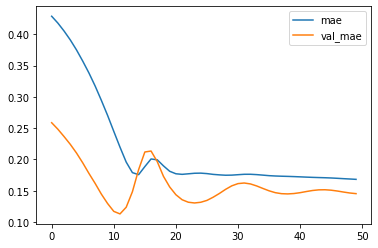

Test MSE: 693296.641
bestmse=492680.2566512054
Test MAE: 699.531
bestmae=570.90321
Test MAPE: 38.642
bestmape=30.51137


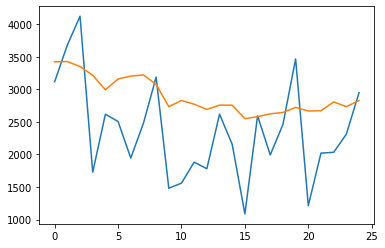

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3423.01442426 3426.98247272 3349.9085331  3216.8192296  2993.92273736
 3159.63517231 3203.89430672 3221.39515358 3076.30142033 2734.1220172
 2829.87051851 2771.9179011  2692.22968066 2758.22657013 2756.97409117
 2549.98580331 2580.59937316 2624.42379838 2645.4657318  2722.06981248
 2667.51768261 2671.54943103 2807.00711054 2735.28368068 2827.1064567 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 38%|███▊      | 49/128 [03:45<06:05,  4.63s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


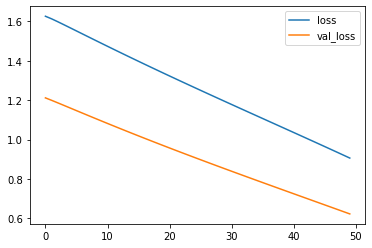

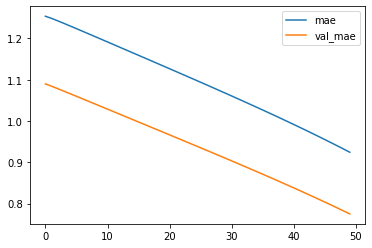

Test MSE: 14422662.417
bestmse=492680.2566512054
Test MAE: 3730.435
bestmae=570.90321
Test MAPE: 164.965
bestmape=30.51137


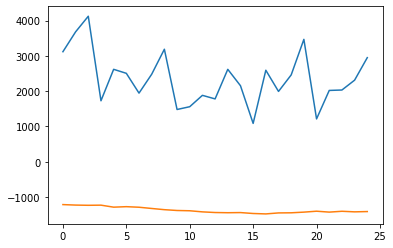

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[-1213.31749028 -1227.1805529  -1233.23950952 -1229.21809083
 -1286.13343185 -1272.19705689 -1288.1726914  -1323.18414098
 -1357.31785101 -1380.37106764 -1388.2107538  -1419.4530021
 -1437.84823084 -1443.75597179 -1439.46598029 -1465.4676156
 -1477.45956361 -1449.23732471 -1445.73985255 -1426.83473718
 -1400.60871732 -1426.30648661 -1402.70909441 -1418.78730881
 -1410.65810347]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)         




 39%|███▉      | 50/128 [03:49<05:51,  4.51s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


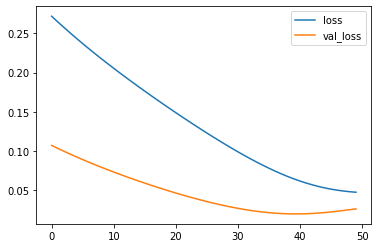

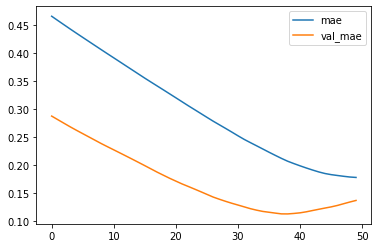

Test MSE: 599218.045
bestmse=492680.2566512054
Test MAE: 655.764
bestmae=570.90321
Test MAPE: 35.455
bestmape=30.51137


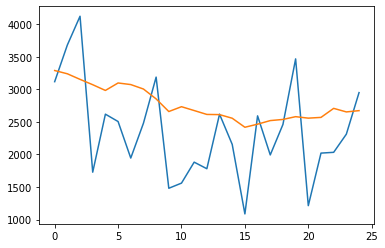

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3289.32929659 3239.25481486 3153.57420713 3071.44085509 2983.44337648
 3098.04434025 3073.58929408 3005.18916577 2853.40378034 2659.38001263
 2733.67267424 2674.6843586  2614.91112745 2612.1939798  2556.61676836
 2417.99015927 2465.37231338 2520.43088663 2538.01508862 2580.62620175
 2557.96852744 2569.35589969 2708.06026864 2653.55031848 2673.14881653]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 40%|███▉      | 51/128 [03:54<05:39,  4.41s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


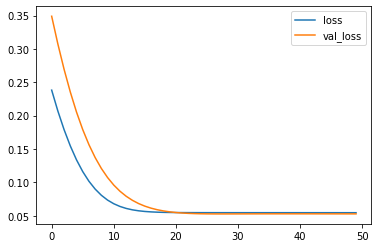

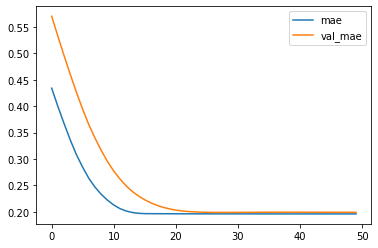

Test MSE: 1222718.390
bestmse=492680.2566512054
Test MAE: 958.648
bestmae=570.90321
Test MAPE: 53.173
bestmape=30.51137


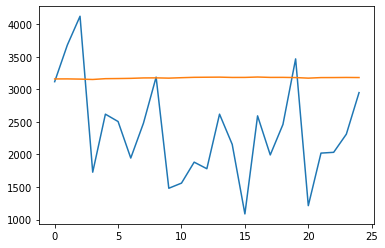

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3160.0367403  3160.8149128  3157.50079322 3151.87668926 3164.2151134
 3166.15624058 3169.10896331 3175.44481391 3176.49744141 3172.36913878
 3179.15261072 3184.86910832 3186.41727561 3187.75770068 3183.13328439
 3183.58564019 3189.40672624 3183.76124549 3184.15492272 3181.10406762
 3172.34819239 3180.69188297 3181.27895558 3182.87317622 3181.4821068 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 41%|████      | 52/128 [03:59<05:51,  4.63s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


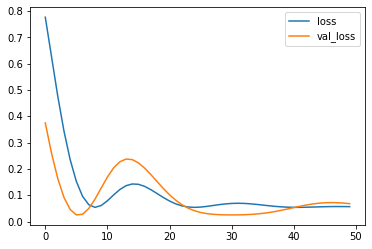

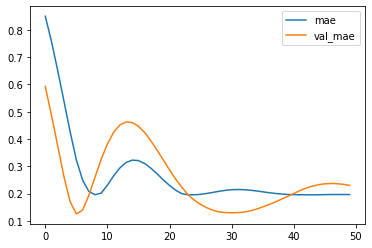

Test MSE: 1579722.450
bestmse=492680.2566512054
Test MAE: 1105.635
bestmae=570.90321
Test MAPE: 61.093
bestmape=30.51137


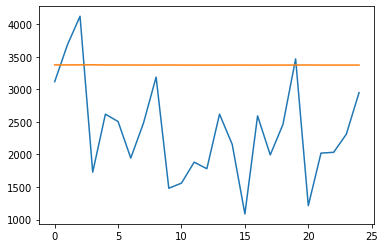

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3375.34906358 3375.54848462 3376.11991918 3376.87183696 3374.66500634
 3374.57117802 3374.47763664 3373.67995244 3373.7654596  3374.56256992
 3373.22027975 3372.49232119 3372.56620741 3372.481848   3373.27049369
 3373.13807237 3371.94914991 3373.02745825 3372.9872871  3373.38039047
 3374.69355655 3372.94094682 3372.9342038  3372.99560827 3373.28397971]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 41%|████▏     | 53/128 [04:03<05:47,  4.64s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


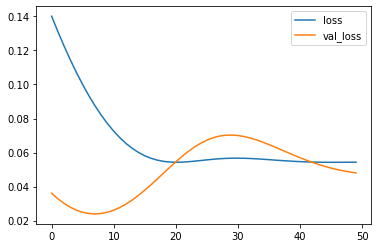

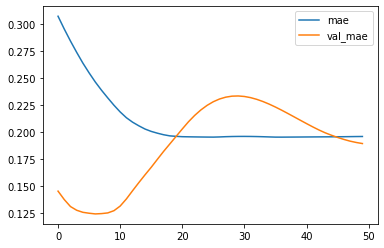

Test MSE: 1114259.178
bestmse=492680.2566512054
Test MAE: 912.224
bestmae=570.90321
Test MAPE: 50.583
bestmape=30.51137


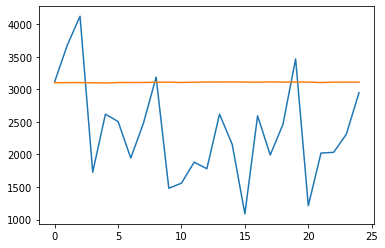

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3102.48827332 3103.04349595 3103.54506141 3101.97035247 3097.84979713
 3104.35077983 3105.22880632 3106.00956124 3109.47690505 3110.20357239
 3105.67341483 3109.98822635 3112.50222278 3112.51197863 3113.90520006
 3111.54026729 3110.25292552 3114.75352859 3111.32133454 3111.89492112
 3111.42448831 3105.3917864  3110.52623278 3111.16165423 3111.48904908]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 42%|████▏     | 54/128 [04:07<05:25,  4.40s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


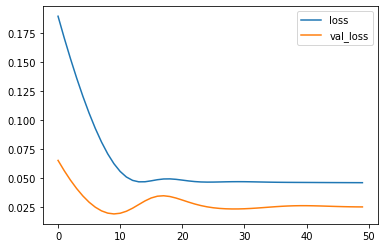

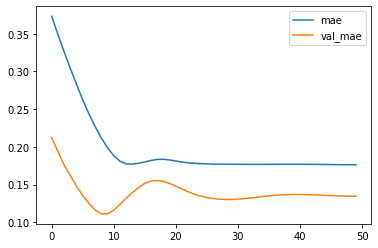

Test MSE: 578019.402
bestmse=492680.2566512054
Test MAE: 648.084
bestmae=570.90321
Test MAPE: 34.604
bestmape=30.51137


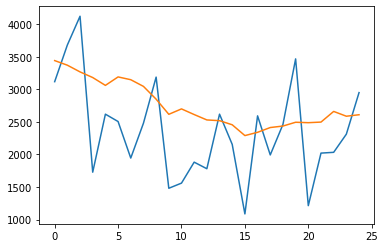

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3441.91925269 3371.20971388 3268.23298866 3181.60104209 3061.17354047
 3191.02662772 3148.27046806 3045.81080288 2849.378488   2616.84981567
 2699.89074868 2613.18606365 2530.38716179 2519.11399037 2455.99364191
 2290.07360822 2340.3420592  2413.71035403 2436.55453724 2494.88949788
 2488.23356932 2497.38957787 2661.20937794 2587.40178293 2610.2987625 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 43%|████▎     | 55/128 [04:12<05:21,  4.40s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


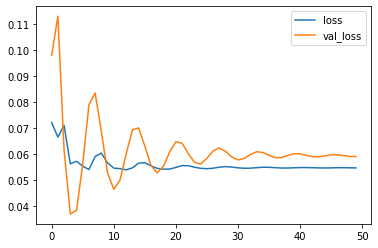

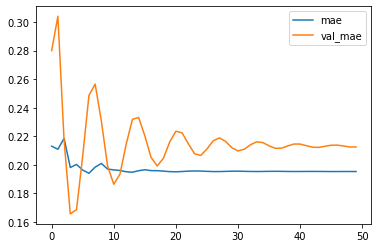

Test MSE: 1369311.300
bestmse=492680.2566512054
Test MAE: 1022.614
bestmae=570.90321
Test MAPE: 56.648
bestmape=30.51137


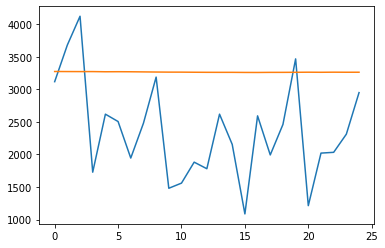

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3274.37845671 3273.43988657 3272.89298511 3273.01077265 3270.28645158
 3271.14353168 3270.17196381 3268.20300376 3266.22084463 3264.72188699
 3264.51557946 3262.92265004 3261.82698202 3261.3901208  3261.45898563
 3260.01497638 3259.60379601 3261.04952687 3261.19285178 3262.18794847
 3263.50527513 3262.41348076 3263.81631458 3262.85364175 3263.15980327]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 44%|████▍     | 56/128 [04:16<05:21,  4.47s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


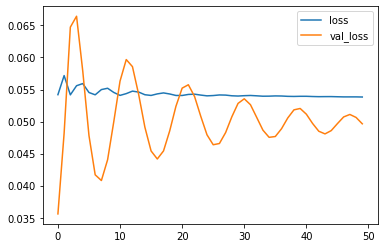

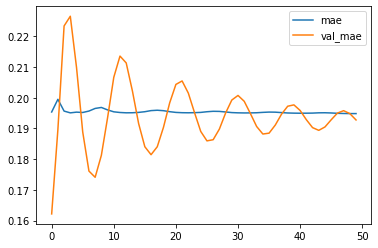

Test MSE: 1150622.634
bestmse=492680.2566512054
Test MAE: 927.979
bestmae=570.90321
Test MAPE: 51.515
bestmape=30.51137


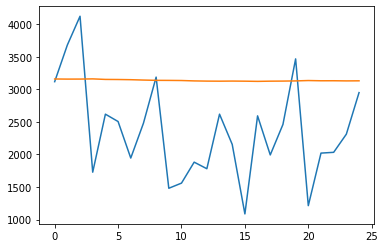

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3159.31222498 3157.51542699 3158.00795394 3160.9324134  3152.73089999
 3151.31960154 3148.45525533 3142.89671642 3138.5015626  3137.6589728
 3135.87652165 3129.86232716 3126.78062636 3125.69715315 3127.3648296
 3125.7037527  3122.76566374 3125.91780752 3127.12294191 3129.83578551
 3135.53477997 3131.88738334 3132.29641169 3130.05658334 3131.16358536]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total pa




 45%|████▍     | 57/128 [04:21<05:23,  4.56s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


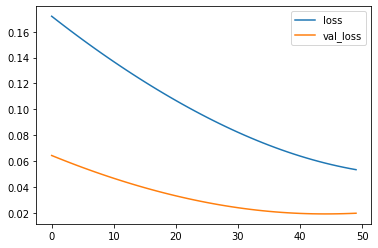

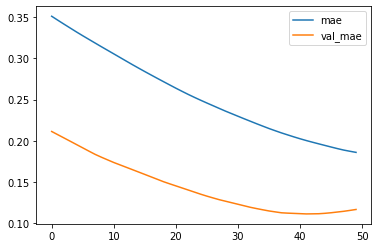

Test MSE: 457969.645
bestmse=457969.6446102282
Test MAE: 562.925
bestmae=562.92460
Test MAPE: 28.460
bestmape=28.45954


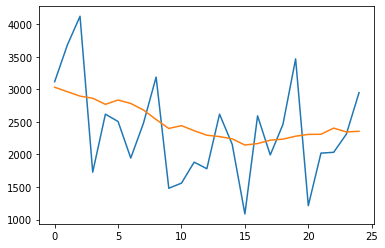

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3032.51085365 2964.35175222 2896.19279426 2863.86449033 2769.73488623
 2836.39660817 2783.46280164 2683.11943853 2536.94409716 2399.71142685
 2442.43344104 2364.73426622 2295.85036254 2274.74788547 2239.86440969
 2144.95993286 2167.02615878 2219.86699781 2235.75095603 2280.68589824
 2308.59810197 2310.0435459  2405.18029803 2345.75928175 2356.25499803]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 45%|████▌     | 58/128 [04:25<05:02,  4.33s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


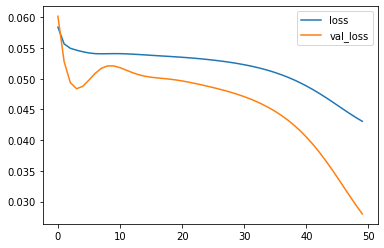

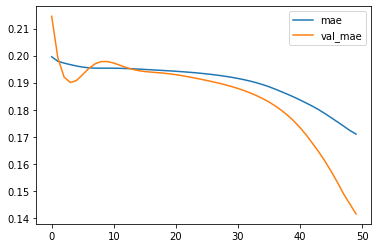

Test MSE: 648338.512
bestmse=457969.6446102282
Test MAE: 681.137
bestmae=562.92460
Test MAPE: 37.215
bestmape=28.45954


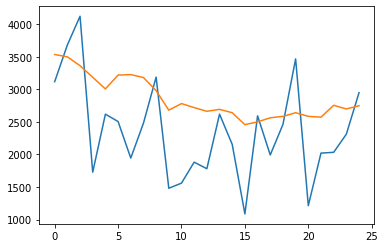

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3535.37842906 3499.66685379 3363.48035491 3184.9762792  3006.94808811
 3219.31600982 3227.00218481 3181.54910654 2980.21605527 2680.57703537
 2781.4030261  2719.7774747  2663.14820963 2693.06136686 2641.06268722
 2458.01539832 2500.66237855 2563.3299408  2585.4567821  2641.13599956
 2585.51861697 2573.13815659 2755.49292362 2698.95576525 2748.53269863]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 46%|████▌     | 59/128 [04:30<05:10,  4.50s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


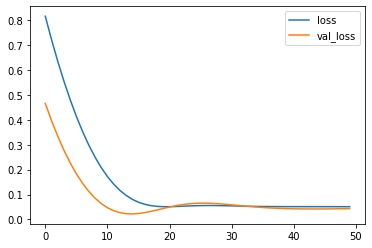

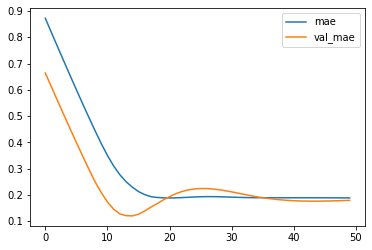

Test MSE: 1006901.617
bestmse=457969.6446102282
Test MAE: 864.723
bestmae=562.92460
Test MAPE: 48.023
bestmape=28.45954


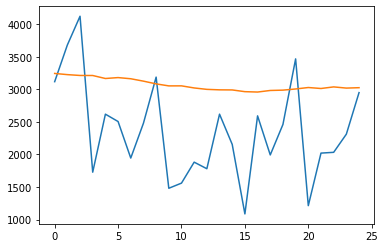

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3244.48768055 3226.37580186 3213.40841234 3212.85892844 3166.78491902
 3180.81985676 3162.94154459 3126.19082785 3084.09835291 3053.30516064
 3053.87587786 3021.66679615 3000.01526558 2992.58647287 2991.12610823
 2964.68373805 2958.87341213 2982.96318781 2988.03192568 3005.84725523
 3028.27121955 3013.31865805 3037.79221165 3019.56168461 3025.64746982]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 47%|████▋     | 60/128 [04:34<04:58,  4.39s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


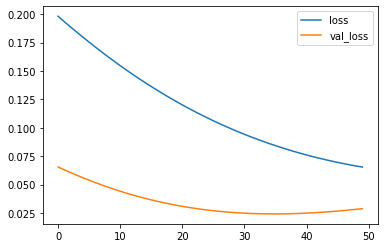

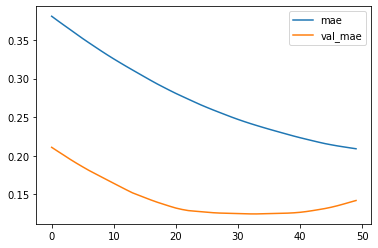

Test MSE: 666782.596
bestmse=457969.6446102282
Test MAE: 684.175
bestmae=562.92460
Test MAPE: 36.470
bestmape=28.45954


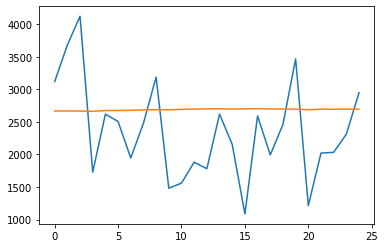

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2667.16173756 2669.00085872 2667.16388959 2662.73401642 2674.98650301
 2675.16956866 2678.5646044  2685.37705696 2688.14915299 2686.42035902
 2692.06512243 2697.53428054 2699.8452692  2701.49572945 2698.03010726
 2699.65933418 2704.79980624 2698.91358554 2699.15877301 2695.75728118
 2687.67613775 2695.63045514 2694.27209651 2696.39341998 2695.12272054]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 48%|████▊     | 61/128 [04:38<04:48,  4.30s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


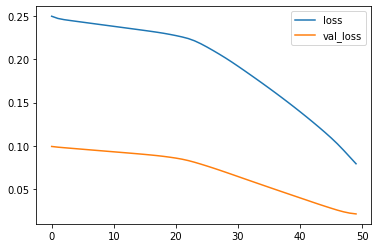

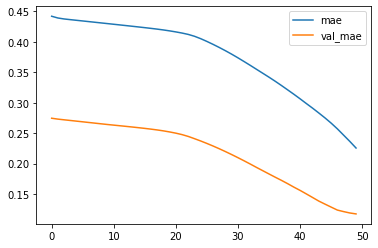

Test MSE: 493879.896
bestmse=457969.6446102282
Test MAE: 564.593
bestmae=562.92460
Test MAPE: 26.924
bestmape=26.92363


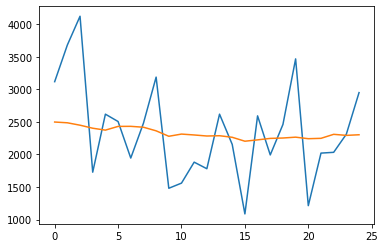

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2498.31437504 2486.59329534 2449.60183865 2403.15854162 2373.87994504
 2431.08796155 2432.09051859 2418.49430716 2363.14937103 2279.4510659
 2313.205589   2299.53104383 2283.64823335 2287.88098097 2263.99823016
 2203.55622116 2224.38754299 2246.81789166 2252.80740958 2265.85657609
 2242.20064878 2247.84914237 2309.42089313 2293.28643912 2302.76812088]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 48%|████▊     | 62/128 [04:42<04:43,  4.29s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


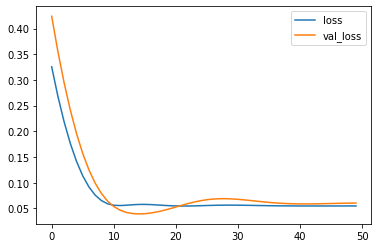

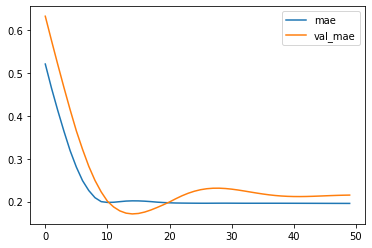

Test MSE: 1402705.886
bestmse=457969.6446102282
Test MAE: 1035.298
bestmae=562.92460
Test MAPE: 57.353
bestmape=26.92363


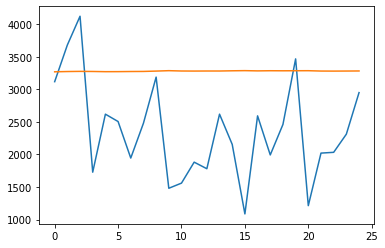

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3269.61387181 3273.83499849 3276.22805107 3274.80914879 3271.65772235
 3272.21136683 3274.21475929 3275.32520455 3280.68963075 3287.02591175
 3282.02302587 3281.07513028 3281.92718899 3281.86492372 3285.17244375
 3287.45301712 3283.80719864 3286.1091488  3285.19453788 3285.98791802
 3286.58187711 3281.30668825 3280.47184575 3281.41873705 3282.55156338]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 49%|████▉     | 63/128 [04:47<04:40,  4.32s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


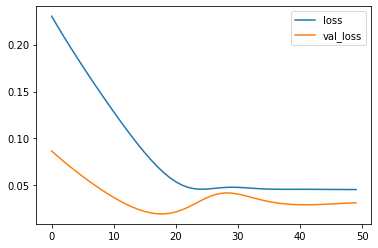

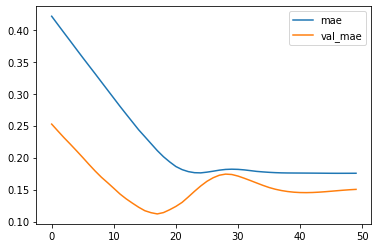

Test MSE: 726132.670
bestmse=457969.6446102282
Test MAE: 723.547
bestmae=562.92460
Test MAPE: 39.660
bestmape=26.92363


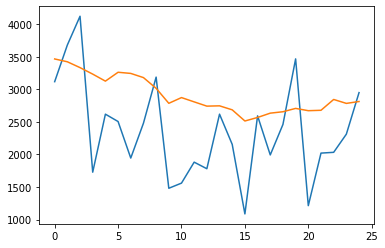

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3467.0243541  3423.62660384 3333.91539544 3234.21821392 3126.41506892
 3262.56555724 3244.96126968 3180.8065142  3016.27367628 2785.78397655
 2873.67500162 2807.87452036 2742.38966954 2747.02312434 2685.54104131
 2514.09001464 2568.3377046  2634.67131436 2656.16517317 2707.5073415
 2672.41181946 2678.64293814 2844.87085497 2784.55158317 2813.34210032]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 50%|█████     | 64/128 [04:51<04:37,  4.33s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


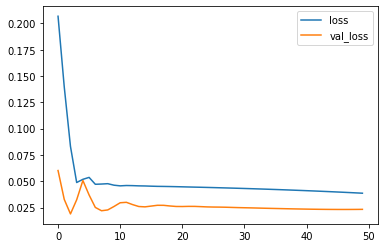

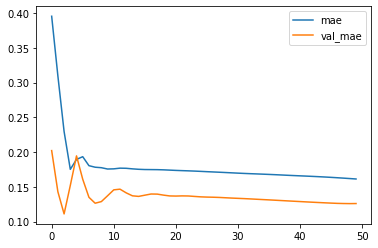

Test MSE: 540170.315
bestmse=457969.6446102282
Test MAE: 606.060
bestmae=562.92460
Test MAPE: 32.000
bestmape=26.92363


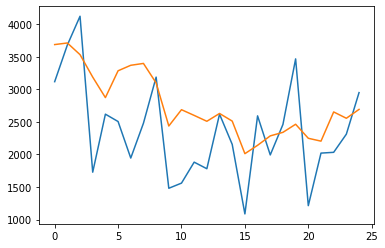

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3687.84543276 3712.38196898 3533.12970567 3188.46672142 2873.28562844
 3285.38420308 3369.77316499 3398.25393391 3099.03800225 2437.41764301
 2687.70354021 2599.99070287 2509.71953738 2629.78908539 2512.66781259
 2012.42326957 2140.76326755 2285.44259238 2340.08654201 2464.18582988
 2248.58700025 2204.6511001  2653.20800292 2556.05695474 2692.34115559]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 51%|█████     | 65/128 [04:57<04:57,  4.72s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


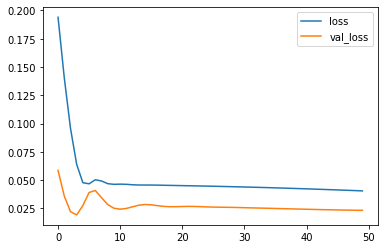

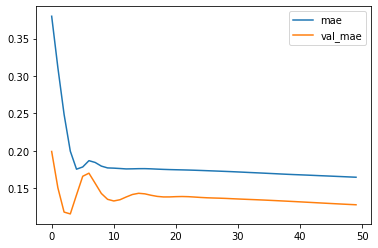

Test MSE: 541640.025
bestmse=457969.6446102282
Test MAE: 615.334
bestmae=562.92460
Test MAPE: 32.446
bestmape=26.92363


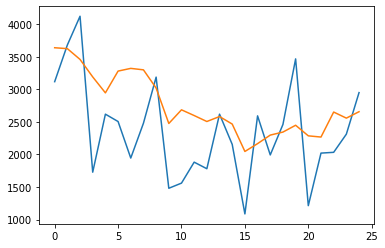

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3639.26388299 3625.21431148 3459.99440348 3191.10912204 2946.24489492
 3280.68130958 3322.29431319 3299.79043698 3020.18390697 2476.02211469
 2685.8332864  2597.84699833 2506.29523408 2582.67464328 2466.97686374
 2046.21365976 2166.48492432 2297.62320131 2344.11484718 2448.69669664
 2286.13511425 2267.52009195 2651.55797309 2558.21127594 2656.91637361]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 52%|█████▏    | 66/128 [05:02<05:03,  4.89s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


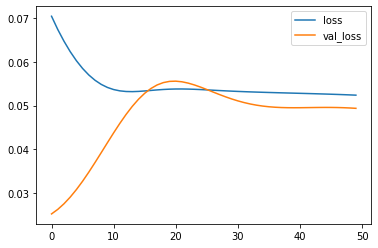

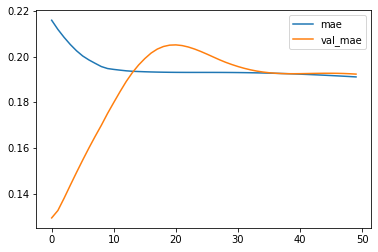

Test MSE: 1144036.514
bestmse=457969.6446102282
Test MAE: 925.847
bestmae=562.92460
Test MAPE: 51.464
bestmape=26.92363


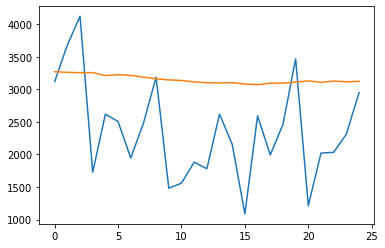

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3270.9442541  3261.08697212 3256.26959085 3257.92808533 3210.80345696
 3225.26736516 3214.09921259 3187.53833753 3162.57455248 3145.27140504
 3136.70404726 3114.63774961 3102.28397435 3098.23429239 3102.39186257
 3081.8424561  3071.3559218  3094.94384509 3096.22257876 3110.80169207
 3130.6198402  3107.29102081 3127.59509635 3116.10342258 3122.8203252 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 52%|█████▏    | 67/128 [05:06<04:43,  4.65s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


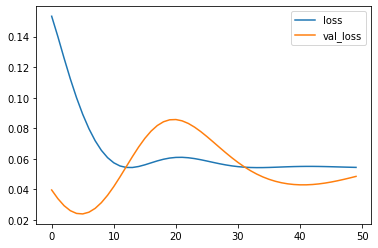

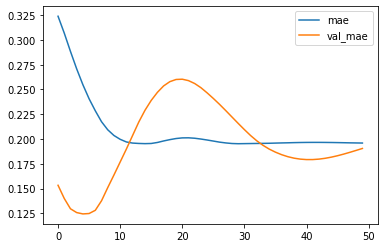

Test MSE: 1124675.659
bestmse=457969.6446102282
Test MAE: 917.186
bestmae=562.92460
Test MAPE: 50.839
bestmape=26.92363


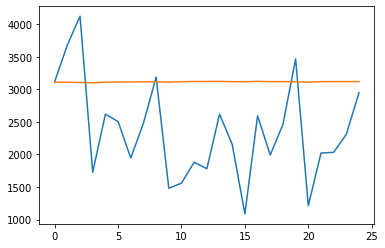

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3109.58823651 3109.27777094 3105.90138608 3101.22374302 3110.5755859
 3112.29864115 3113.75943619 3117.42878348 3116.42479175 3111.51128668
 3117.83910304 3121.09669608 3121.29697794 3122.04373085 3117.96033382
 3117.31400877 3122.79450089 3118.55328864 3119.01927394 3117.04400128
 3110.39768511 3118.03852409 3119.11482388 3119.36962372 3118.26190436]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 53%|█████▎    | 68/128 [05:10<04:27,  4.45s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


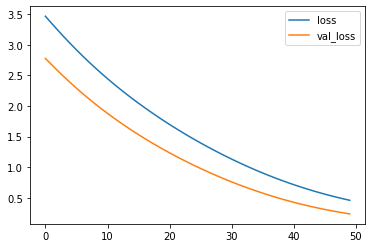

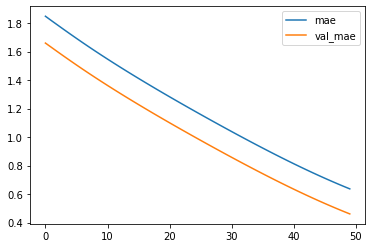

Test MSE: 5467562.171
bestmse=457969.6446102282
Test MAE: 2217.729
bestmae=562.92460
Test MAPE: 93.324
bestmape=26.92363


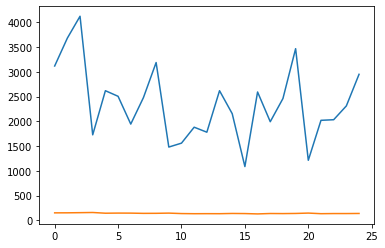

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[152.04324907 152.75262848 155.84013975 159.30203176 144.85691792
 147.31998307 146.53499582 141.72055566 142.68552399 146.7617476
 137.57145011 134.79641297 135.67608935 134.98701072 139.79427746
 137.62855053 130.53970614 138.80075893 137.17626646 139.99527666
 147.38884789 135.18499708 137.82754117 137.87137076 139.70891377]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Trainable p




 54%|█████▍    | 69/128 [05:15<04:28,  4.55s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


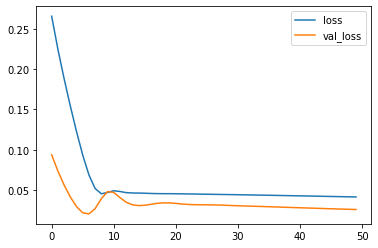

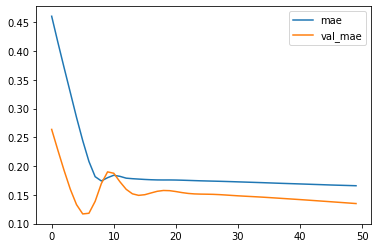

Test MSE: 597149.802
bestmse=457969.6446102282
Test MAE: 649.131
bestmae=562.92460
Test MAPE: 34.890
bestmape=26.92363


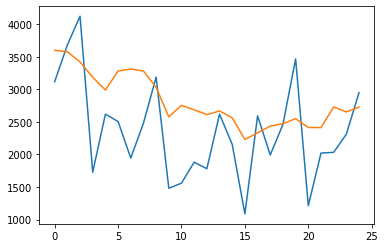

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3601.06858313 3577.24766719 3421.51044524 3185.24829525 2990.09715301
 3281.77898616 3312.62942231 3281.58157367 3030.65135998 2577.91020185
 2754.6209228  2685.80071908 2611.92124641 2668.87977141 2562.10787714
 2229.50821641 2332.69949859 2435.67464566 2471.91102827 2550.46383995
 2414.45409411 2412.65170085 2729.62772673 2653.39164245 2728.00452548]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 55%|█████▍    | 70/128 [05:20<04:31,  4.67s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


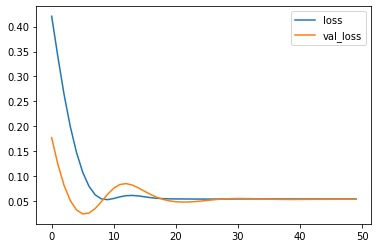

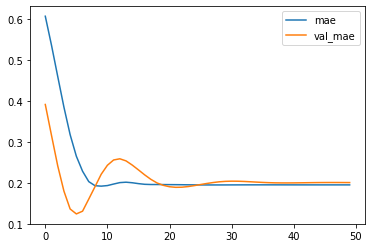

Test MSE: 1239866.206
bestmse=457969.6446102282
Test MAE: 966.179
bestmae=562.92460
Test MAPE: 53.637
bestmape=26.92363


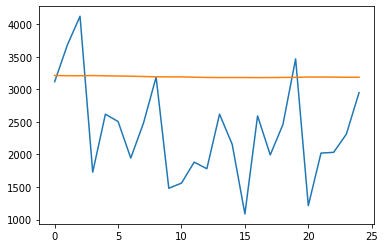

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3211.82896894 3209.55212575 3209.19173318 3211.80658787 3208.0881744
 3205.22841918 3202.24269873 3197.32603735 3192.69746047 3191.77137208
 3191.99819559 3186.45759022 3183.05552453 3181.6209842  3182.08266544
 3181.93245405 3180.57050872 3181.43619692 3183.1087513  3184.8927806
 3189.3751632  3189.22007388 3188.14047432 3185.95186418 3186.15931946]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total pa




 55%|█████▌    | 71/128 [05:24<04:25,  4.66s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


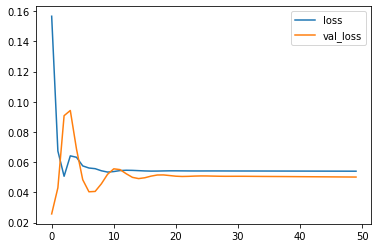

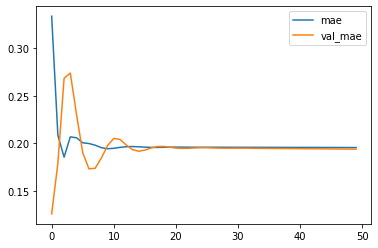

Test MSE: 1162806.322
bestmse=457969.6446102282
Test MAE: 932.860
bestmae=562.92460
Test MAPE: 51.822
bestmape=26.92363


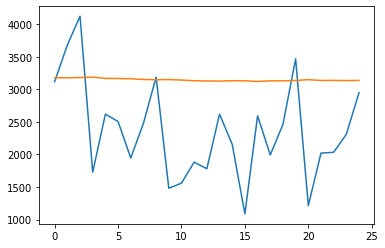

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3179.41501439 3177.47474802 3180.8677752  3187.91063797 3168.51514769
 3166.9978261  3162.36322355 3152.18615055 3147.88783789 3150.95031393
 3142.23747921 3132.66326034 3129.14426792 3127.11562502 3132.89338362
 3130.57952559 3121.84459674 3130.72356784 3131.13159192 3136.43074
 3149.20459068 3136.66287184 3137.66026402 3134.74125636 3137.2315805 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total par




 56%|█████▋    | 72/128 [05:29<04:25,  4.74s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


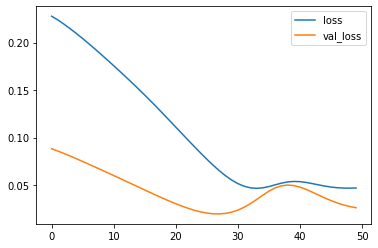

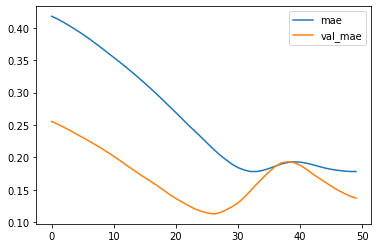

Test MSE: 609084.281
bestmse=457969.6446102282
Test MAE: 661.051
bestmae=562.92460
Test MAPE: 35.800
bestmape=26.92363


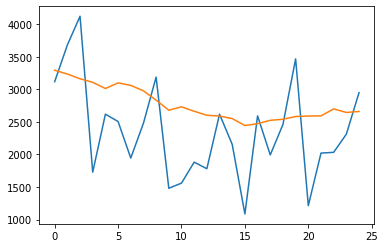

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3292.7666555  3235.49766493 3162.52548629 3108.13260633 3012.85511172
 3099.31059217 3061.05503559 2977.51727158 2834.13540304 2680.0827868
 2731.79036909 2663.71117955 2602.05176961 2590.11032248 2551.32665879
 2444.69349843 2472.90813351 2524.65115249 2540.49536997 2583.01509374
 2590.52480263 2592.76807421 2699.91026038 2645.39241946 2660.571661  ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 57%|█████▋    | 73/128 [05:34<04:13,  4.60s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


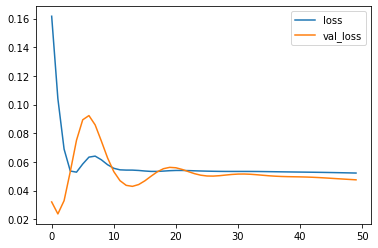

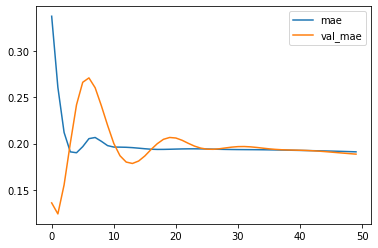

Test MSE: 1100764.241
bestmse=457969.6446102282
Test MAE: 908.150
bestmae=562.92460
Test MAPE: 50.426
bestmape=26.92363


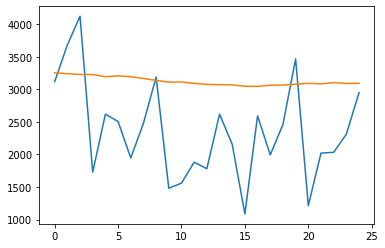

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3254.35572267 3240.22753048 3229.39825022 3227.20146239 3194.19211406
 3207.30612826 3194.19197059 3168.09148556 3136.82355642 3111.5660916
 3113.6935842  3092.15725875 3076.45407069 3071.24860746 3068.82298756
 3047.98793554 3046.02069712 3063.11065054 3066.20870674 3078.90508449
 3093.01921678 3083.66966939 3103.6589753  3090.00293756 3094.13654852]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 58%|█████▊    | 74/128 [05:38<04:11,  4.66s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


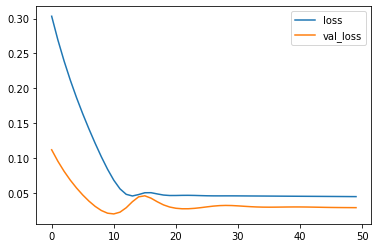

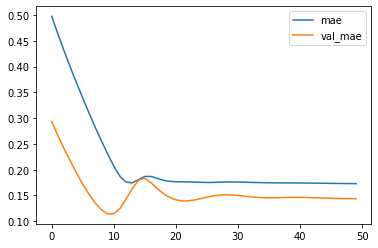

Test MSE: 661538.256
bestmse=457969.6446102282
Test MAE: 691.940
bestmae=562.92460
Test MAPE: 37.618
bestmape=26.92363


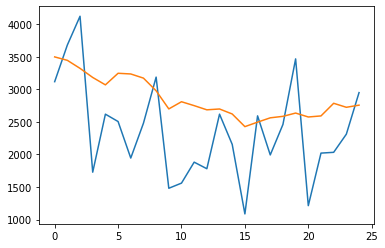

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3498.41925275 3445.76721811 3322.49789482 3182.79599023 3069.17348081
 3247.11444312 3236.43494385 3172.76869822 2978.27105445 2699.6746853
 2809.90875852 2750.05661976 2685.76356077 2698.605272   2621.784841
 2427.58661574 2496.58400291 2562.86610752 2585.77700353 2636.01905632
 2575.74526399 2592.02361679 2786.02112979 2724.65253025 2757.54351717]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total par




 59%|█████▊    | 75/128 [05:43<04:06,  4.64s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


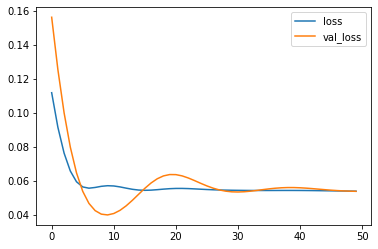

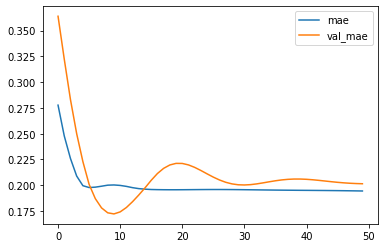

Test MSE: 1244900.415
bestmse=457969.6446102282
Test MAE: 969.659
bestmae=562.92460
Test MAPE: 53.791
bestmape=26.92363


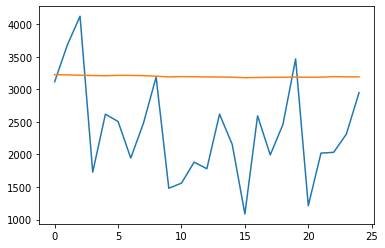

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3225.28228587 3222.36428249 3217.1822046  3212.06540483 3208.92502546
 3215.49487299 3214.2121222  3210.64478093 3202.46091413 3191.71714103
 3196.1021086  3193.46114266 3190.35648692 3189.9863385  3186.50407398
 3179.07571167 3182.1268537  3185.00569022 3185.77654582 3187.81666619
 3185.88572526 3187.34508562 3195.15263486 3192.2562952  3193.00491321]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 59%|█████▉    | 76/128 [05:47<03:54,  4.52s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


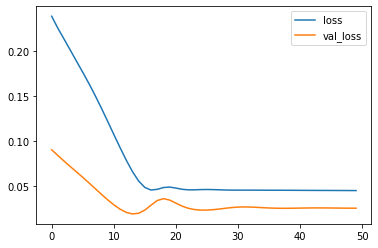

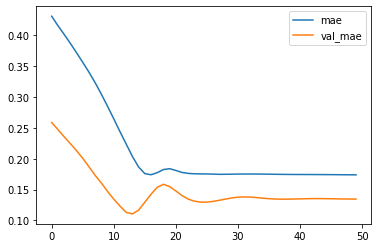

Test MSE: 582899.807
bestmse=457969.6446102282
Test MAE: 648.123
bestmae=562.92460
Test MAPE: 34.748
bestmape=26.92363


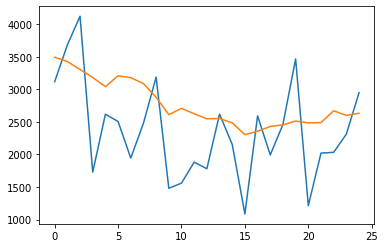

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3493.10948801 3427.42593348 3305.47881478 3182.73415536 3041.41206235
 3208.30309004 3179.60826629 3088.35749871 2878.59108913 2611.86443293
 2707.37994158 2625.97067446 2549.11595452 2551.81172538 2486.43490624
 2304.36277193 2356.71983558 2430.65856069 2454.46383858 2513.34254438
 2485.45745617 2489.18304306 2671.51944613 2600.53430456 2633.08756691]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 60%|██████    | 77/128 [05:52<03:53,  4.58s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


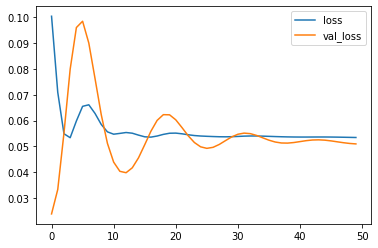

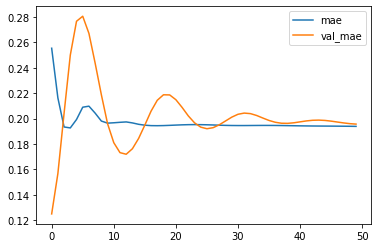

Test MSE: 1181678.750
bestmse=457969.6446102282
Test MAE: 941.642
bestmae=562.92460
Test MAPE: 52.312
bestmape=26.92363


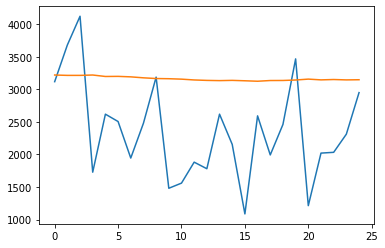

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3220.33764815 3214.74180746 3214.75730205 3220.37337178 3197.84137577
 3199.53085941 3192.06792122 3177.19742364 3166.3535096  3163.4365105
 3156.85920262 3144.44101006 3137.72238582 3134.2896179  3138.02682573
 3131.85137278 3124.81467915 3135.73793119 3136.51179963 3143.59139031
 3157.40180004 3145.73409057 3151.1464352  3145.3682462  3147.81266046]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 61%|██████    | 78/128 [05:56<03:46,  4.52s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


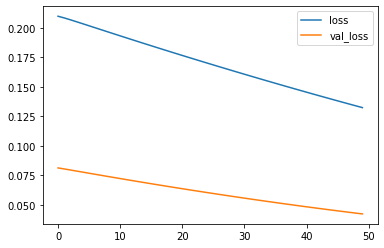

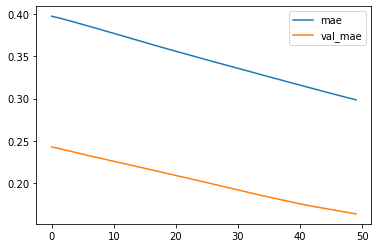

Test MSE: 977062.475
bestmse=457969.6446102282
Test MAE: 788.061
bestmae=562.92460
Test MAPE: 29.815
bestmape=26.92363


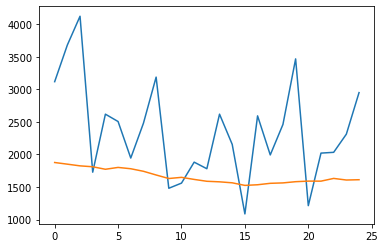

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1876.5477384  1851.09135467 1825.06576014 1811.18583998 1772.71960008
 1801.08724418 1780.80605185 1741.77390093 1684.86824402 1630.66764756
 1648.64326715 1616.76394752 1588.2724902  1579.80190185 1564.67757283
 1525.05619727 1534.85189545 1556.96037281 1563.2872925  1581.93660374
 1590.8321813  1590.30070269 1632.21617351 1607.62752241 1612.21323811]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 62%|██████▏   | 79/128 [06:00<03:35,  4.39s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


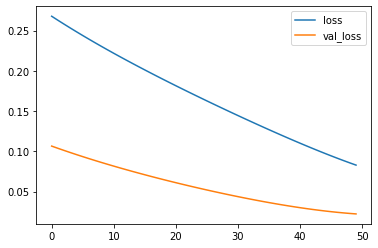

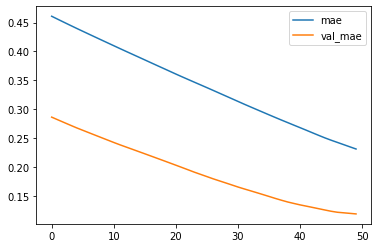

Test MSE: 516395.100
bestmse=457969.6446102282
Test MAE: 570.618
bestmae=562.92460
Test MAPE: 25.481
bestmape=25.48086


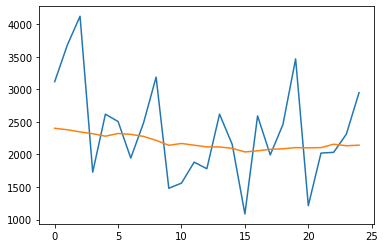

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2402.44622111 2379.60074669 2346.63888639 2319.09726149 2280.63998836
 2322.50133574 2309.04572332 2277.81710452 2217.03615147 2141.04963043
 2169.24633196 2142.34608245 2116.65283242 2115.41391122 2094.40978172
 2038.67568761 2056.31117955 2079.44810998 2087.14052585 2105.54988623
 2101.36570266 2105.61021468 2157.34204313 2134.11953381 2142.81142214]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 62%|██████▎   | 80/128 [06:04<03:26,  4.30s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


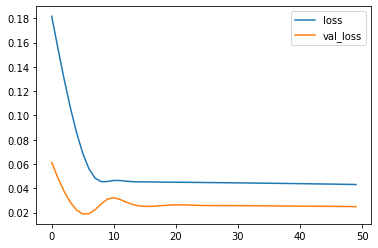

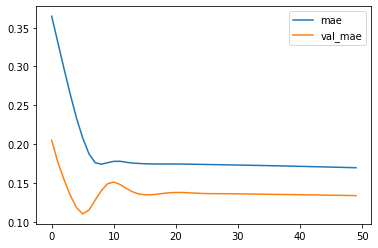

Test MSE: 578561.400
bestmse=457969.6446102282
Test MAE: 643.623
bestmae=562.92460
Test MAPE: 34.368
bestmape=25.48086


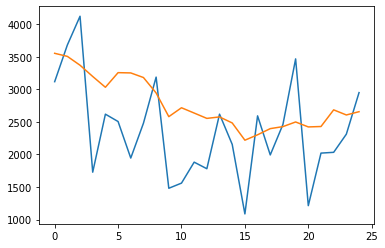

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3553.72516549 3506.70627332 3370.60442078 3197.83678478 3032.07112306
 3256.64074355 3252.42650336 3181.93044549 2944.82929242 2580.91213423
 2717.50163579 2636.20714337 2554.21439034 2576.62099499 2484.07499486
 2219.17741704 2302.33513331 2396.90963286 2427.91128469 2499.22697741
 2423.03235549 2429.3722232  2685.20876855 2606.73256898 2657.15897864]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 63%|██████▎   | 81/128 [06:09<03:31,  4.49s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


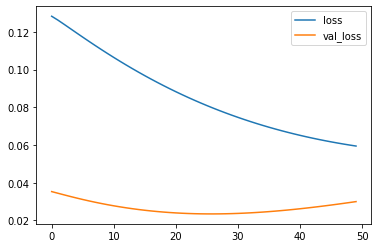

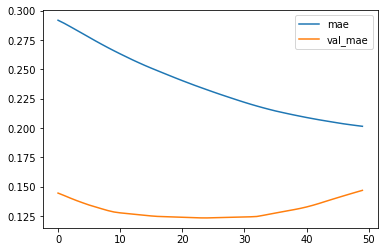

Test MSE: 695275.840
bestmse=457969.6446102282
Test MAE: 706.982
bestmae=562.92460
Test MAPE: 38.181
bestmape=25.48086


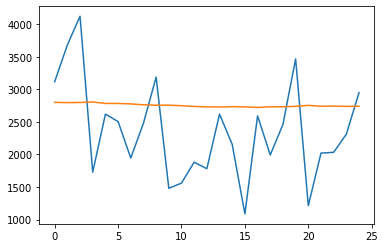

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2800.46595669 2796.17108727 2798.66055059 2806.60669029 2783.7782886
 2783.41961765 2776.54920387 2763.14667475 2755.94886613 2757.65269661
 2748.4715811  2737.29252493 2732.11102092 2729.02300751 2734.61540496
 2730.89641762 2722.13939464 2732.70612776 2732.83438849 2739.32317638
 2754.31303966 2740.55011797 2743.444736   2738.91744781 2741.33976793]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 64%|██████▍   | 82/128 [06:13<03:20,  4.36s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


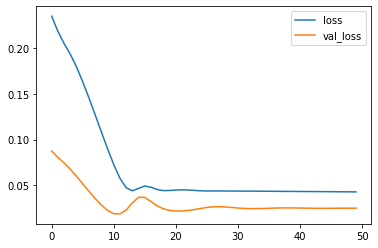

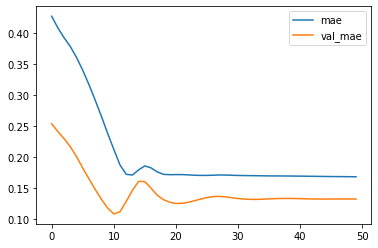

Test MSE: 573803.256
bestmse=457969.6446102282
Test MAE: 639.786
bestmae=562.92460
Test MAPE: 34.273
bestmape=25.48086


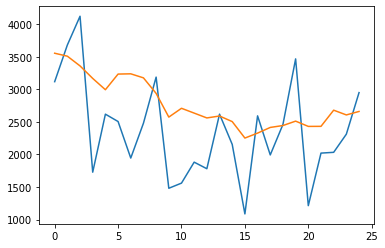

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3554.99514759 3509.56588507 3360.04400027 3168.05920517 2994.47351247
 3234.82981962 3238.72943366 3176.74607211 2938.2349118  2574.09752965
 2709.33900231 2635.38679117 2561.13214868 2590.706864   2504.92812389
 2252.0051344  2328.08469468 2415.24374408 2444.43970287 2512.04013842
 2431.11019915 2431.92926013 2680.21233875 2607.31835037 2660.75917417]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 65%|██████▍   | 83/128 [06:18<03:19,  4.43s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


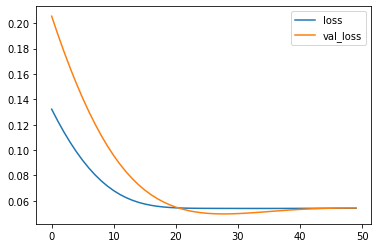

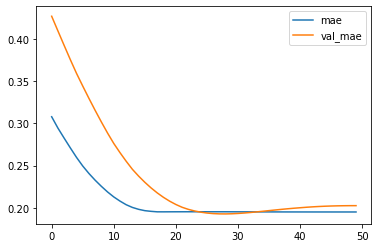

Test MSE: 1259866.362
bestmse=457969.6446102282
Test MAE: 974.812
bestmae=562.92460
Test MAPE: 54.110
bestmape=25.48086


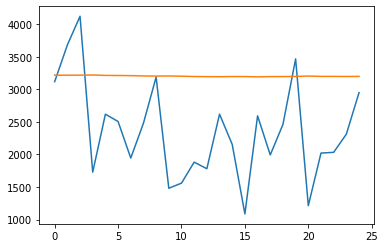

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3218.27658141 3217.13428617 3218.00026131 3220.64524436 3214.54841208
 3212.99680156 3210.80933917 3206.2238028  3204.02586722 3205.47719336
 3202.03122634 3197.1012224  3195.18362403 3194.04061145 3196.699224
 3196.39765346 3191.87969071 3195.75018066 3196.28043979 3198.7287277
 3204.25627744 3199.33129489 3199.29901451 3197.92587864 3198.97850615]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total par




 66%|██████▌   | 84/128 [06:22<03:12,  4.39s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


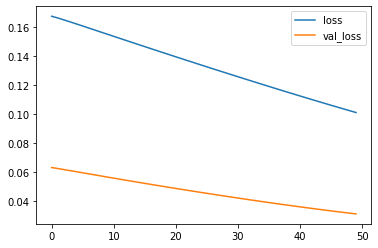

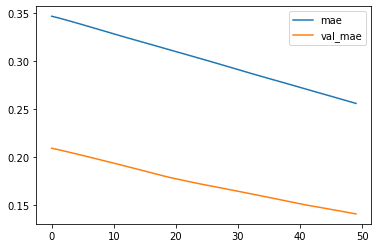

Test MSE: 721858.881
bestmse=457969.6446102282
Test MAE: 677.305
bestmae=562.92460
Test MAPE: 26.516
bestmape=25.48086


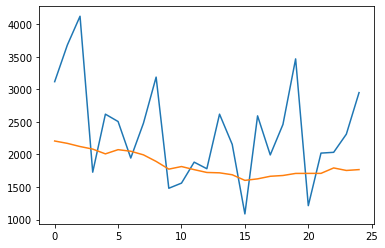

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2206.86625189 2170.64428785 2122.00140536 2082.48777455 2009.25692242
 2073.75184143 2049.64628422 1994.14798039 1893.52126724 1774.87887093
 1814.61329958 1766.97598696 1723.60248286 1718.05534968 1688.43314633
 1602.08634317 1625.41993289 1665.03452957 1677.08372146 1708.85314432
 1709.52636969 1709.77830017 1793.15243849 1754.43555933 1767.60839558]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 66%|██████▋   | 85/128 [06:26<03:03,  4.28s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


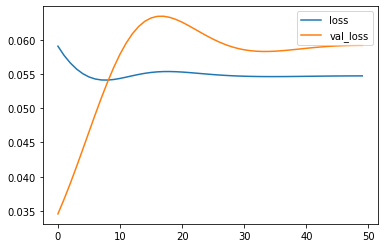

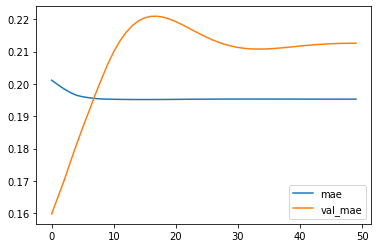

Test MSE: 1371487.763
bestmse=457969.6446102282
Test MAE: 1023.480
bestmae=562.92460
Test MAPE: 56.686
bestmape=25.48086


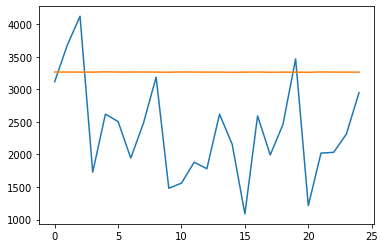

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3266.0090853  3266.02013236 3264.94684541 3264.67454243 3269.06940931
 3265.87738132 3266.17952573 3266.65196711 3264.78759551 3263.58776945
 3267.25568205 3265.66949564 3264.70567507 3264.89490986 3263.2431584
 3264.52748734 3266.25800294 3262.90744239 3264.98371679 3263.97083002
 3262.77114743 3267.6307084  3264.8393876  3264.95932716 3264.44284099]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 67%|██████▋   | 86/128 [06:30<02:56,  4.20s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


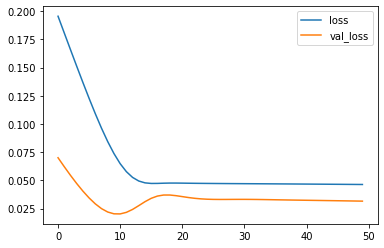

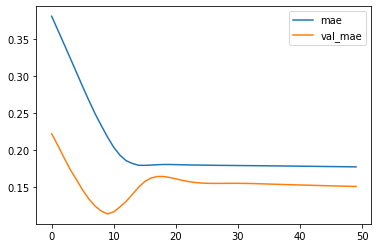

Test MSE: 730857.577
bestmse=457969.6446102282
Test MAE: 725.702
bestmae=562.92460
Test MAPE: 39.821
bestmape=25.48086


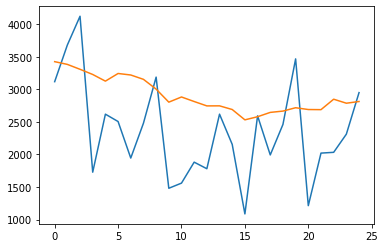

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3425.5324378  3383.51399255 3308.10787284 3228.63958943 3126.38651872
 3243.79300666 3220.67795515 3154.01365077 3004.03467572 2803.63345158
 2882.97404814 2813.27883077 2745.94280744 2746.85325778 2690.49371326
 2531.76947963 2579.69824827 2646.14620233 2666.2636255  2717.8350563
 2690.30921292 2688.34972179 2848.85439801 2787.27748239 2813.46046174]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total p




 68%|██████▊   | 87/128 [06:35<02:59,  4.38s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


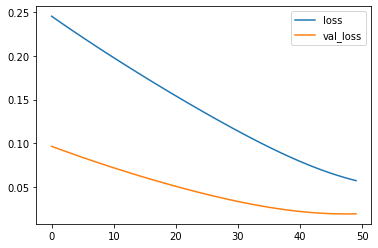

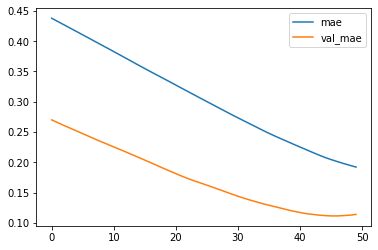

Test MSE: 446883.433
bestmse=446883.4326575031
Test MAE: 548.580
bestmae=548.58041
Test MAPE: 27.327
bestmape=25.48086


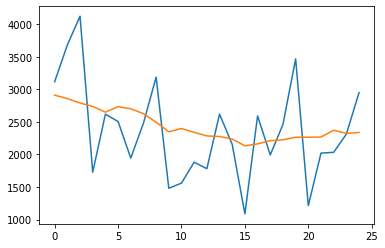

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2910.56947368 2858.83348465 2790.32690281 2737.66023439 2650.01597494
 2734.4568724  2701.463736   2627.10034448 2495.80037862 2348.3843227
 2398.8391391  2339.74551767 2284.91735464 2275.94642031 2236.96577454
 2132.97802764 2162.78265104 2211.16872513 2225.43407309 2263.81487757
 2264.79175377 2267.61635923 2372.27969873 2323.18266708 2337.54786903]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 69%|██████▉   | 88/128 [06:39<02:52,  4.31s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


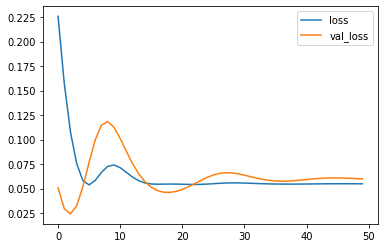

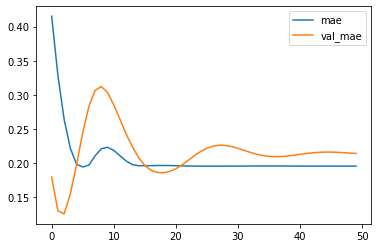

Test MSE: 1386828.078
bestmse=446883.4326575031
Test MAE: 1029.858
bestmae=548.58041
Test MAPE: 57.023
bestmape=25.48086


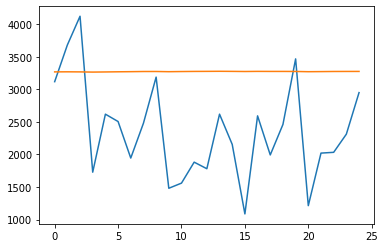

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3268.46942455 3269.5622232  3268.34001607 3265.30279046 3267.43415672
 3269.80454129 3271.69057661 3274.21217686 3274.53225482 3271.41282183
 3273.71175915 3275.51759565 3276.38600975 3277.53662616 3276.20581347
 3274.34761101 3276.20581347 3275.44858736 3275.50583124 3274.88647825
 3271.2682057  3272.77964509 3274.66783243 3275.29019827 3275.50769633]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 70%|██████▉   | 89/128 [06:43<02:46,  4.27s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


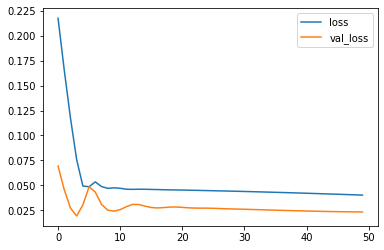

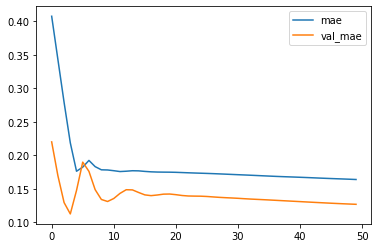

Test MSE: 538614.702
bestmse=446883.4326575031
Test MAE: 612.031
bestmae=548.58041
Test MAPE: 32.308
bestmape=25.48086


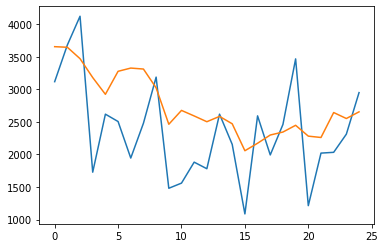

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3655.65801477 3646.5357213  3471.27360058 3181.45212191 2923.85823238
 3277.2215696  3326.97726458 3312.02384228 3023.29774469 2463.94351178
 2676.86048698 2591.62090105 2503.00493026 2584.92379707 2471.2325663
 2057.32413805 2172.55248904 2298.8165713  2344.59532279 2447.99958378
 2281.56019455 2260.9199726  2644.09302634 2552.28760999 2654.89160436]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 70%|███████   | 90/128 [06:49<02:54,  4.59s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


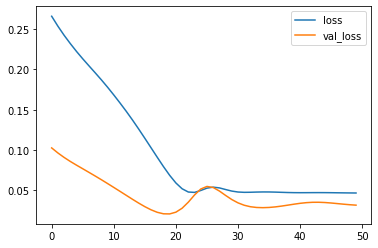

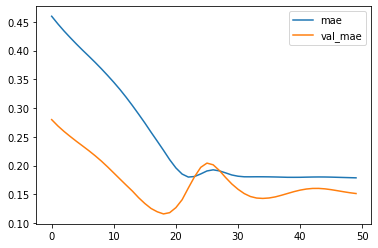

Test MSE: 733747.488
bestmse=446883.4326575031
Test MAE: 728.583
bestmae=548.58041
Test MAPE: 40.025
bestmape=25.48086


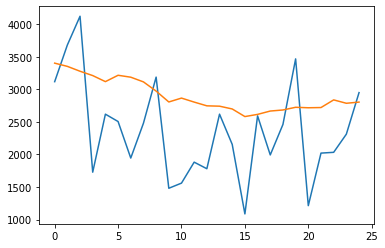

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3402.61551613 3353.21060133 3278.23359555 3211.78248519 3118.81856167
 3216.33588463 3186.91812372 3114.81550694 2973.61837488 2806.33883482
 2866.0166595  2804.57216519 2747.02843267 2741.63689095 2698.92018509
 2582.16518706 2615.72086298 2667.03075093 2683.30322152 2724.6736201
 2717.42315859 2720.74330384 2838.23357731 2786.39328676 2804.50502199]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 71%|███████   | 91/128 [06:53<02:47,  4.52s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


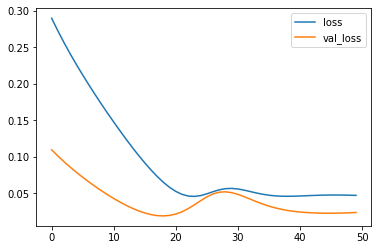

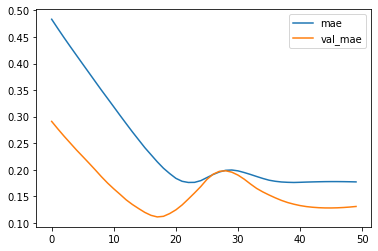

Test MSE: 550564.529
bestmse=446883.4326575031
Test MAE: 630.342
bestmae=548.58041
Test MAPE: 33.632
bestmape=25.48086


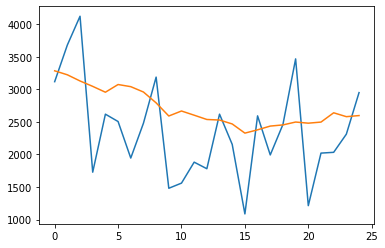

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3284.87790316 3223.63871211 3128.87626898 3045.95599288 2956.18868834
 3074.29458463 3041.46959317 2959.31084722 2792.5397591  2590.84430671
 2667.59142536 2603.21572858 2537.41653854 2529.06639189 2468.66046518
 2327.95915985 2378.51497799 2436.03403395 2453.98235869 2498.16731995
 2480.64767873 2497.48340619 2640.20245081 2580.65790826 2597.47584563]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 72%|███████▏  | 92/128 [06:57<02:40,  4.45s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


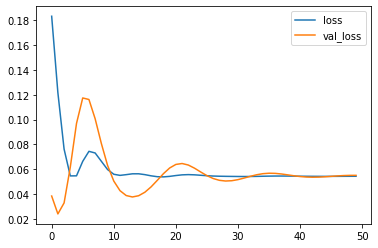

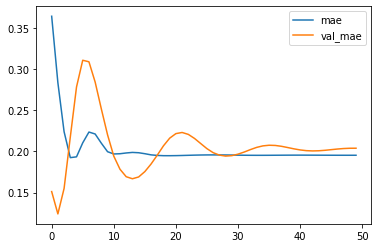

Test MSE: 1275364.105
bestmse=446883.4326575031
Test MAE: 981.536
bestmae=548.58041
Test MAPE: 54.469
bestmape=25.48086


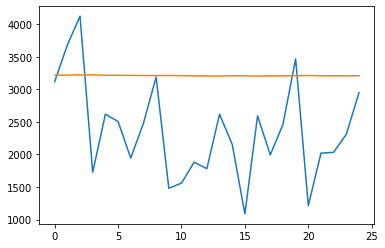

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3218.57714766 3218.71789014 3220.74194205 3223.28721458 3216.63286418
 3215.55943376 3214.47653443 3212.39652985 3212.09768522 3213.05562359
 3210.44636416 3207.50870562 3206.27573836 3206.16842401 3208.79260415
 3208.0568983  3205.08911139 3207.51157498 3207.46867794 3209.63878065
 3213.38660514 3208.9452545  3208.8499915  3207.79707706 3209.10823458]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 73%|███████▎  | 93/128 [07:02<02:34,  4.42s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


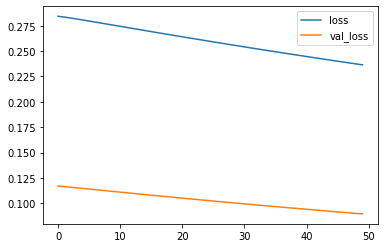

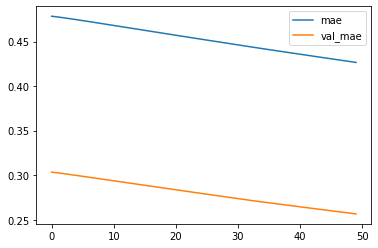

Test MSE: 2075518.756
bestmse=446883.4326575031
Test MAE: 1235.039
bestmae=548.58041
Test MAPE: 47.207
bestmape=25.48086


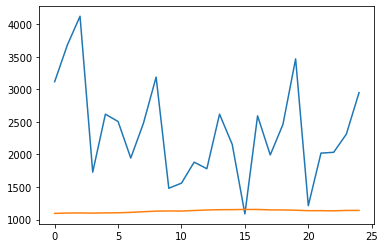

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[1095.14773591 1100.47461823 1101.91416202 1098.78968074 1102.97900227
 1104.26302633 1110.80228819 1120.64319685 1129.63652121 1132.32752175
 1131.12470975 1139.33848074 1147.13984291 1151.84282607 1152.73935101
 1155.56607263 1154.93491936 1149.30558777 1147.73052016 1143.50633581
 1136.727957   1136.83747717 1134.46329965 1140.32959618 1140.58692465]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 73%|███████▎  | 94/128 [07:06<02:23,  4.23s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


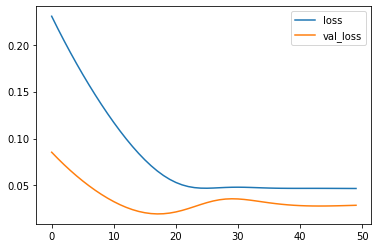

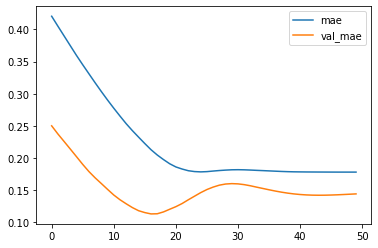

Test MSE: 668624.985
bestmse=446883.4326575031
Test MAE: 693.824
bestmae=548.58041
Test MAPE: 37.804
bestmape=25.48086


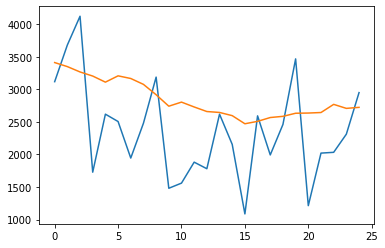

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3411.60352319 3349.59577203 3267.38982499 3204.48094893 3110.86438775
 3207.68273276 3166.86726987 3076.66927326 2917.60258061 2741.4206841
 2804.15165937 2729.63260466 2659.52893281 2645.31351185 2596.44229943
 2471.65622842 2508.55557841 2567.43112791 2585.74343193 2633.14667588
 2636.26123095 2644.28799987 2769.5290091  2707.93602502 2723.6205622 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 74%|███████▍  | 95/128 [07:10<02:18,  4.21s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


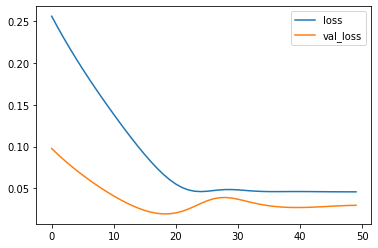

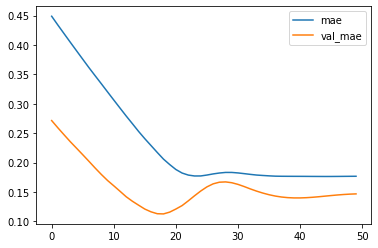

Test MSE: 690674.514
bestmse=446883.4326575031
Test MAE: 706.031
bestmae=548.58041
Test MAPE: 38.547
bestmape=25.48086


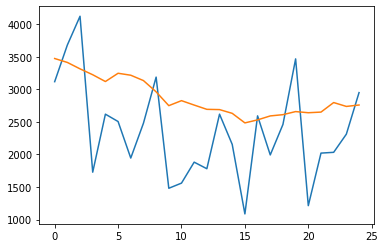

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3473.77913237 3413.62025821 3314.93338102 3224.51917756 3120.33473551
 3247.19550276 3217.1482026  3134.93192583 2962.02770793 2749.78546453
 2826.60403043 2758.84233642 2693.19952691 2689.16376138 2631.74986774
 2484.9464218  2531.26533175 2592.05647105 2611.44407058 2658.72149277
 2641.09955859 2650.85655618 2797.52241594 2737.87271106 2759.70199895]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 75%|███████▌  | 96/128 [07:14<02:13,  4.18s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


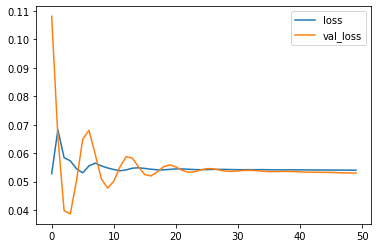

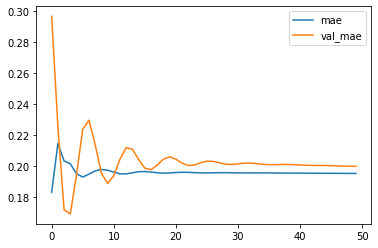

Test MSE: 1228279.073
bestmse=446883.4326575031
Test MAE: 961.142
bestmae=548.58041
Test MAPE: 53.391
bestmape=25.48086


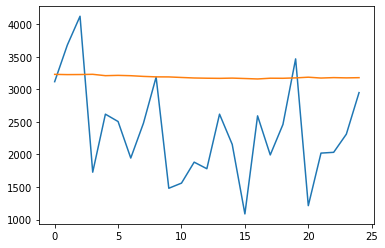

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3230.2282148  3226.64667016 3227.76572353 3231.01513886 3210.25296879
 3214.84912181 3209.77191931 3199.05999619 3191.87682134 3191.05976892
 3182.59212166 3174.71542066 3171.14707512 3169.11312389 3172.73627436
 3166.54747885 3159.7155146  3171.13774967 3170.1829676  3176.21839541
 3186.79330623 3173.89822477 3180.46649414 3176.4711867  3179.56006092]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 76%|███████▌  | 97/128 [07:18<02:13,  4.31s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


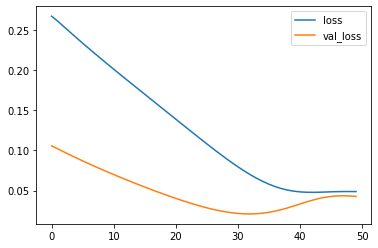

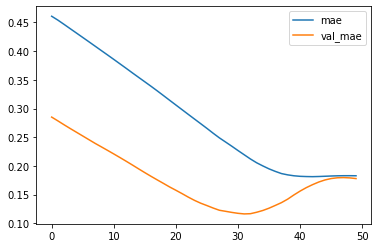

Test MSE: 989907.993
bestmse=446883.4326575031
Test MAE: 856.330
bestmae=548.58041
Test MAPE: 47.443
bestmape=25.48086


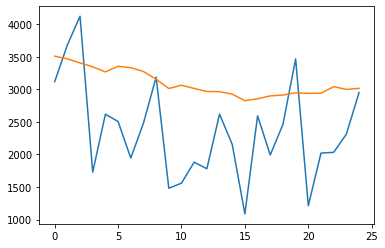

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3509.5185405  3469.76029611 3405.45002091 3346.26931417 3268.25766522
 3354.47670978 3332.87467581 3274.25679553 3155.86008883 3013.49024624
 3063.42212039 3013.92796826 2967.69815218 2964.58115816 2927.05155158
 2826.12283748 2855.18608803 2899.48410237 2912.66167307 2946.82034659
 2938.26618791 2940.20989752 3041.59699309 2999.44512224 3015.33897978]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 77%|███████▋  | 98/128 [07:23<02:06,  4.23s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


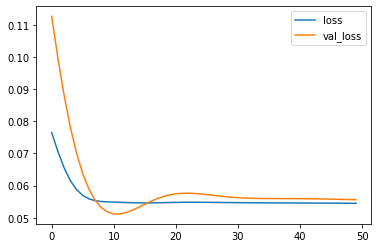

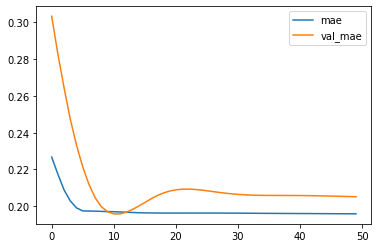

Test MSE: 1289152.717
bestmse=446883.4326575031
Test MAE: 987.599
bestmae=548.58041
Test MAPE: 54.769
bestmape=25.48086


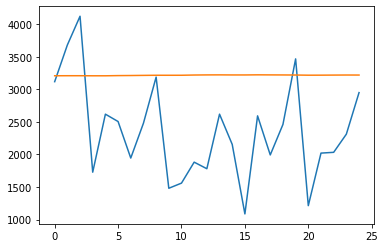

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3208.92287344 3209.53117937 3209.4752267  3208.48715997 3208.39777917
 3211.34734559 3212.57529145 3214.67251223 3216.64692408 3216.46184987
 3216.63688129 3220.23865497 3221.95582801 3222.56126457 3221.35110879
 3221.27550095 3223.18492162 3222.14348465 3221.35340428 3220.20364869
 3217.58133364 3218.047032   3219.23982811 3220.26447928 3219.83952594]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 77%|███████▋  | 99/128 [07:27<02:03,  4.25s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


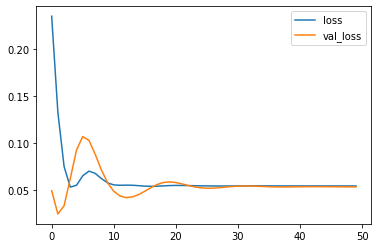

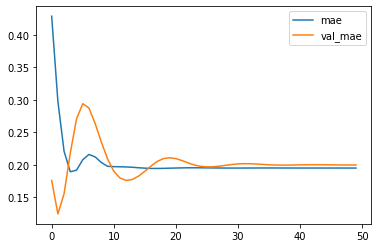

Test MSE: 1227406.777
bestmse=446883.4326575031
Test MAE: 960.544
bestmae=548.58041
Test MAPE: 53.348
bestmape=25.48086


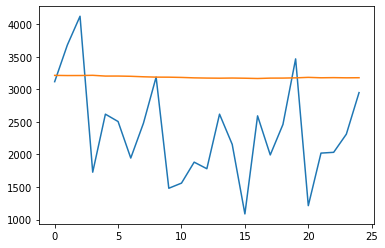

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3214.77078807 3212.19553065 3212.54616737 3215.70950168 3204.05169153
 3204.43833882 3200.76425707 3193.16158068 3187.93588841 3187.18196207
 3183.25451517 3176.65956068 3173.3758564  3171.59971786 3173.86307502
 3171.07333237 3166.89911985 3172.67300481 3173.13138628 3176.75353247
 3184.2757231  3177.90400541 3180.14354682 3177.38579762 3178.71833193]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 78%|███████▊  | 100/128 [07:31<02:00,  4.29s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


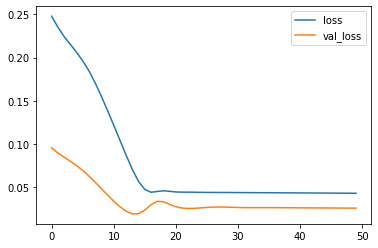

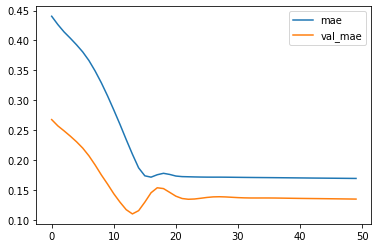

Test MSE: 592841.241
bestmse=446883.4326575031
Test MAE: 649.144
bestmae=548.58041
Test MAPE: 34.958
bestmape=25.48086


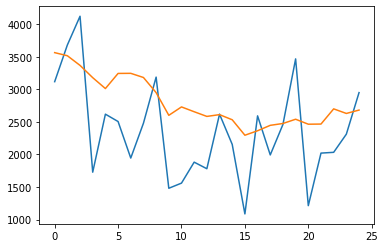

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3564.01127446 3516.60960865 3368.05326605 3179.74958265 3012.37018859
 3244.71407366 3246.2724272  3182.29299009 2950.01883066 2601.29167414
 2730.31838351 2656.4073478  2584.60027587 2611.89628291 2533.03601849
 2295.54635304 2364.32007301 2447.55669689 2475.85038304 2541.15489411
 2464.80876958 2467.04788059 2700.38098013 2630.12351018 2681.71703511]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 79%|███████▉  | 101/128 [07:37<02:04,  4.61s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


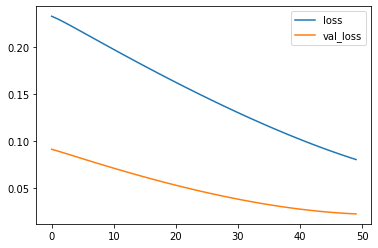

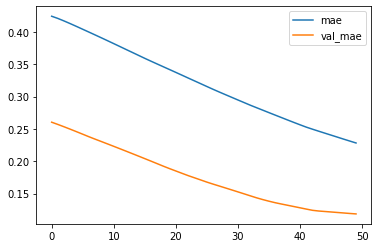

Test MSE: 510983.246
bestmse=446883.4326575031
Test MAE: 571.141
bestmae=548.58041
Test MAPE: 26.342
bestmape=25.48086


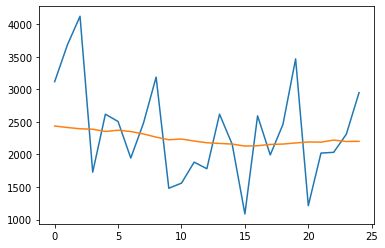

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2436.84879088 2414.18265194 2394.47626567 2387.96021879 2353.22164607
 2372.4082464  2352.36198354 2315.01314712 2266.54092026 2225.91060331
 2236.81950852 2206.23090217 2179.9817839  2169.81145391 2159.36437342
 2129.09821224 2134.06673744 2154.57109484 2159.83480623 2176.96693936
 2191.9703604  2189.47408232 2221.12966302 2198.97563446 2202.00618878]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 80%|███████▉  | 102/128 [07:40<01:53,  4.36s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


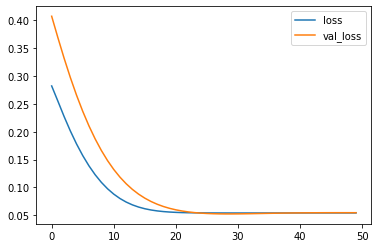

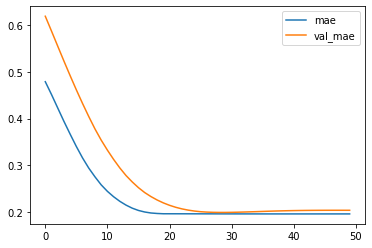

Test MSE: 1268811.262
bestmse=446883.4326575031
Test MAE: 978.656
bestmae=548.58041
Test MAPE: 54.300
bestmape=25.48086


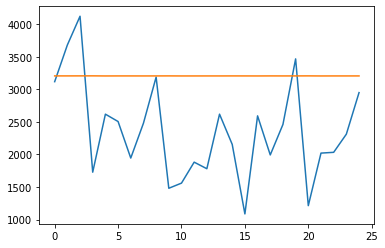

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3206.66927212 3206.69437909 3207.10742456 3207.45246601 3205.94791311
 3206.50485736 3206.39467365 3206.10831076 3206.42681056 3206.92407197
 3205.9334228  3206.08392113 3206.2514922  3206.18018842 3206.59639019
 3206.36655384 3205.91850209 3206.65808159 3206.27157778 3206.51217425
 3207.12377995 3205.88693905 3206.31017077 3206.29309803 3206.42250651]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 80%|████████  | 103/128 [07:45<01:48,  4.34s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


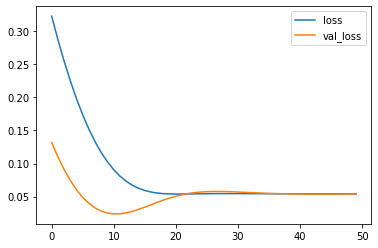

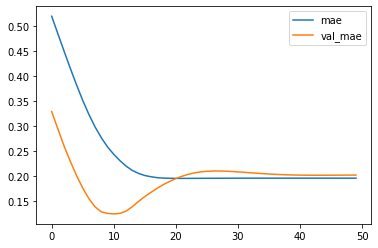

Test MSE: 1250533.746
bestmse=446883.4326575031
Test MAE: 970.440
bestmae=548.58041
Test MAPE: 53.870
bestmape=25.48086


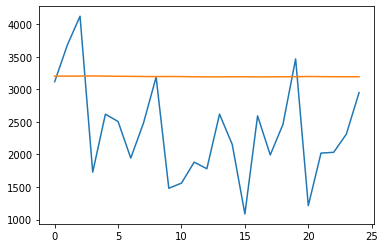

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3203.48355675 3203.0663507  3204.12156063 3206.49940556 3203.03349644
 3200.9342671  3199.69613498 3197.26133311 3196.23610806 3197.80278277
 3196.09751761 3193.18582684 3192.11497885 3191.54827875 3192.97263283
 3193.5653007  3191.36220026 3192.51482522 3193.16028947 3194.16098142
 3197.54382235 3195.53239566 3194.18651879 3193.59471172 3194.01349592]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 81%|████████▏ | 104/128 [07:49<01:46,  4.43s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


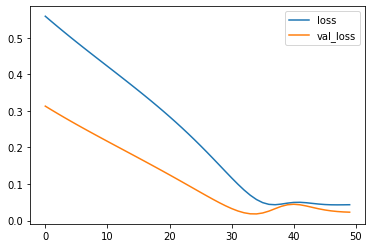

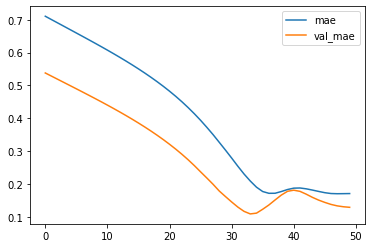

Test MSE: 532613.959
bestmse=446883.4326575031
Test MAE: 619.519
bestmae=548.58041
Test MAPE: 33.065
bestmape=25.48086


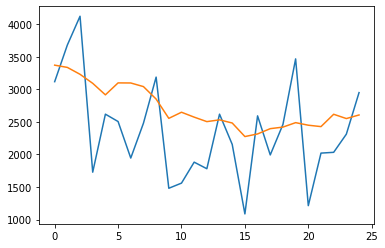

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3371.70109308 3337.18403554 3231.33134317 3092.72912371 2915.87134767
 3099.35162413 3098.02181572 3042.4467563  2851.0196228  2554.72097719
 2648.65819019 2573.44733095 2504.57017028 2531.82672352 2483.21963638
 2275.10813457 2315.49290538 2396.46502435 2420.44303817 2488.81992459
 2449.42723763 2427.97713667 2617.47476393 2551.56122959 2606.66657352]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 82%|████████▏ | 105/128 [07:54<01:40,  4.39s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


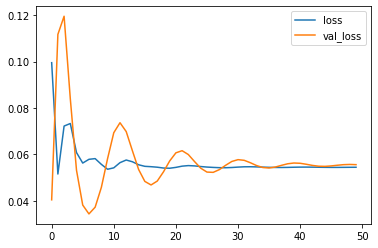

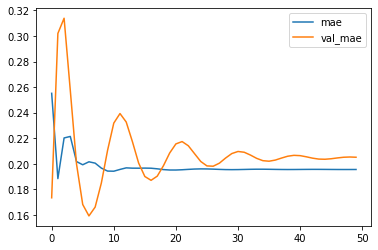

Test MSE: 1288101.441
bestmse=446883.4326575031
Test MAE: 987.688
bestmae=548.58041
Test MAPE: 54.771
bestmape=25.48086


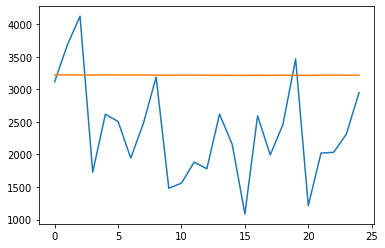

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3222.66900933 3221.95826697 3220.64094031 3219.61628914 3221.53646994
 3221.39902723 3221.1255765  3220.98067343 3219.03581607 3216.8051697
 3219.21271259 3218.54501075 3217.56526518 3217.5533573  3216.18596017
 3215.68095148 3217.22223228 3216.01781523 3216.79785281 3216.70373756
 3215.58066708 3218.19853461 3218.36696649 3217.78907585 3217.62767392]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total p




 83%|████████▎ | 106/128 [07:58<01:37,  4.45s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


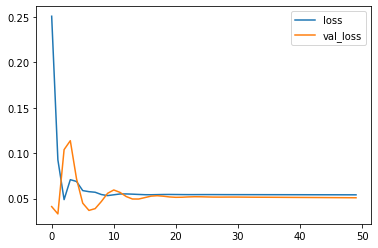

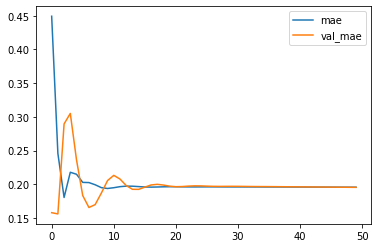

Test MSE: 1179978.782
bestmse=446883.4326575031
Test MAE: 940.579
bestmae=548.58041
Test MAPE: 52.232
bestmape=25.48086


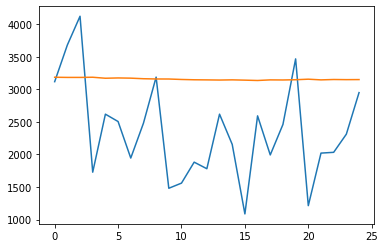

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3185.99045718 3183.50673258 3183.43628961 3186.13722533 3170.77348346
 3175.28068608 3172.14834094 3163.3521511  3159.49600798 3158.97392654
 3151.92632931 3147.24882972 3145.51774025 3143.12540501 3146.08759665
 3141.50593394 3136.28253716 3145.58617467 3144.13599628 3147.930448
 3156.25003588 3145.6695298  3151.37641501 3149.25250912 3150.21618623]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total pa




 84%|████████▎ | 107/128 [08:03<01:38,  4.68s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


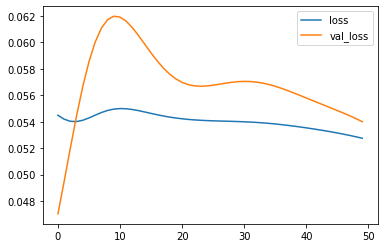

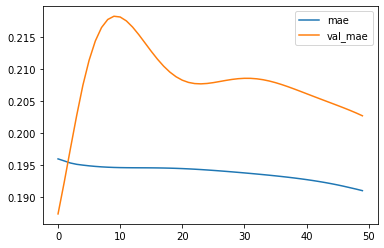

Test MSE: 1251609.182
bestmse=446883.4326575031
Test MAE: 975.719
bestmae=548.58041
Test MAPE: 54.082
bestmape=25.48086


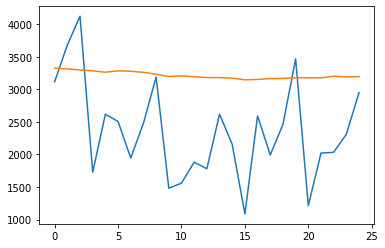

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3324.67847073 3314.1499002  3298.46062857 3284.86642569 3263.25248384
 3284.35998231 3278.05669904 3262.00316119 3232.0009101  3196.76966697
 3207.96995646 3194.21406472 3181.90031713 3180.6300481  3172.24776453
 3146.72918725 3152.6260246  3165.07850611 3168.35302842 3177.86053449
 3177.71749651 3176.32585323 3201.90196133 3190.75618982 3195.02035701]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 84%|████████▍ | 108/128 [08:08<01:30,  4.53s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


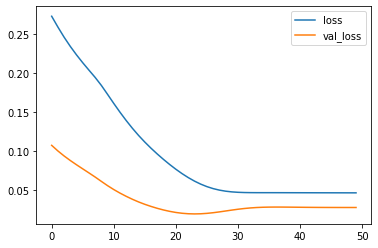

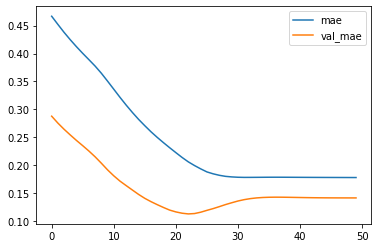

Test MSE: 642684.697
bestmse=446883.4326575031
Test MAE: 678.823
bestmae=548.58041
Test MAPE: 36.875
bestmape=25.48086


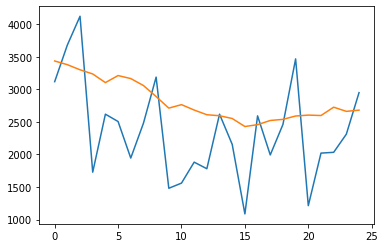

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3435.87765574 3379.13447678 3300.54393291 3236.66348898 3103.92568302
 3211.97602403 3165.78264892 3058.90243602 2889.4797653  2712.00937927
 2765.27086759 2682.31974578 2610.30952263 2594.97275281 2552.37555611
 2429.35228109 2457.69589424 2522.18952203 2539.24446917 2590.67271852
 2604.81353593 2598.16980219 2726.40671813 2662.13862264 2680.65321708]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 85%|████████▌ | 109/128 [08:12<01:27,  4.62s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


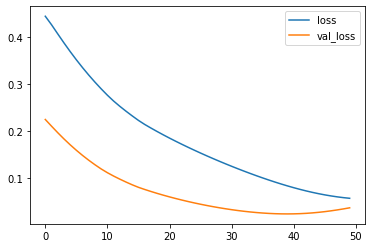

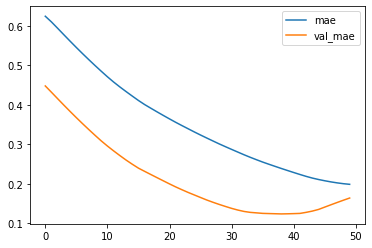

Test MSE: 848412.263
bestmse=446883.4326575031
Test MAE: 790.083
bestmae=548.58041
Test MAPE: 43.414
bestmape=25.48086


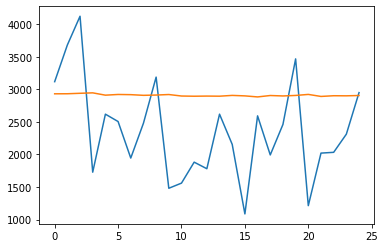

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2931.76707029 2932.51482749 2939.70087171 2946.38032907 2910.89715546
 2921.54537863 2918.64186555 2908.35173947 2912.60600734 2920.69719356
 2897.70394671 2894.59771281 2896.86436975 2895.17904669 2907.21073544
 2899.88653117 2883.87746853 2905.51680428 2898.79143703 2906.60300338
 2922.37032181 2891.32692069 2902.09723544 2900.88951862 2905.56271416]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 86%|████████▌ | 110/128 [08:16<01:19,  4.44s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


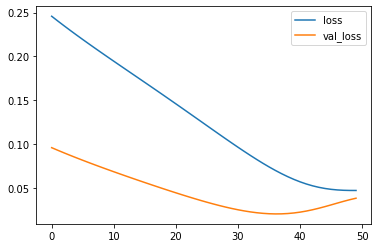

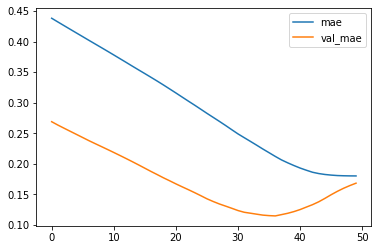

Test MSE: 890948.513
bestmse=446883.4326575031
Test MAE: 811.149
bestmae=548.58041
Test MAPE: 44.862
bestmape=25.48086


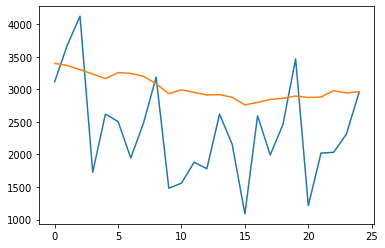

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3398.99824786 3366.42088282 3302.51246256 3235.86150074 3164.33820927
 3257.84114349 3245.50716686 3199.91047674 3085.31826454 2933.58481467
 2993.02548611 2954.01614666 2914.07110643 2918.80025464 2877.84691864
 2761.26982141 2799.43786228 2845.40484428 2862.17830646 2897.48817027
 2875.30551976 2882.28568685 2980.21648568 2943.76590478 2964.79435217]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 87%|████████▋ | 111/128 [08:21<01:15,  4.43s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


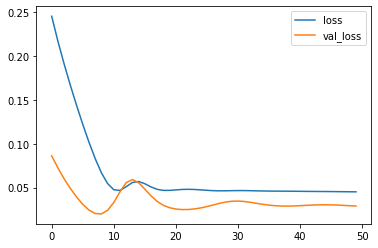

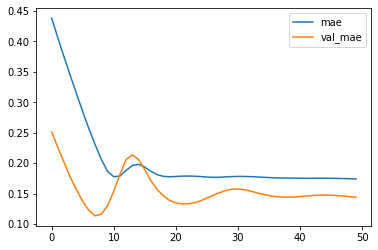

Test MSE: 669081.947
bestmse=446883.4326575031
Test MAE: 694.875
bestmae=548.58041
Test MAPE: 37.800
bestmape=25.48086


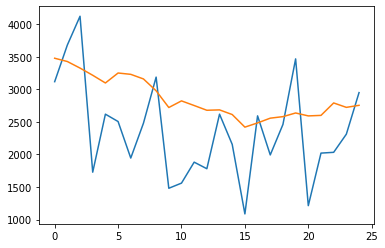

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3478.00714552 3427.66782117 3326.8474257  3216.37863821 3098.12927353
 3251.18980592 3230.7141422  3160.10990918 2978.18196058 2721.19594657
 2823.00240022 2751.78240091 2678.84895873 2684.78596723 2613.29452574
 2419.89140224 2484.71615505 2557.65103191 2581.11399424 2637.27928257
 2592.32274836 2600.22369552 2791.25715178 2723.55098003 2754.88174832]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 88%|████████▊ | 112/128 [08:25<01:10,  4.40s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


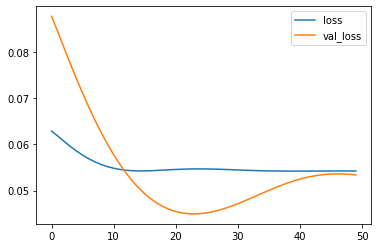

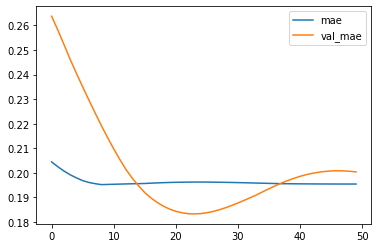

Test MSE: 1237061.347
bestmse=446883.4326575031
Test MAE: 964.671
bestmae=548.58041
Test MAPE: 53.533
bestmape=25.48086


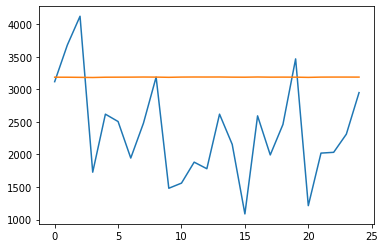

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3186.69474345 3186.45342964 3184.57112449 3182.21680838 3186.51382983
 3187.20577782 3187.84263396 3189.4060089  3188.23961097 3184.99177378
 3188.74806291 3189.74760711 3189.43728501 3189.87558091 3187.64837778
 3186.91453701 3189.85219556 3187.58639944 3188.19011438 3187.36043674
 3184.05019081 3188.19312721 3188.82151872 3188.72037351 3188.26887852]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




 88%|████████▊ | 113/128 [08:29<01:03,  4.21s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


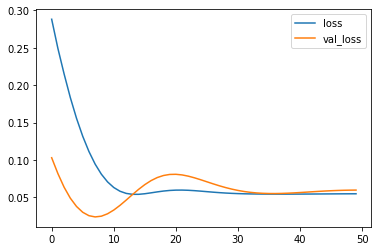

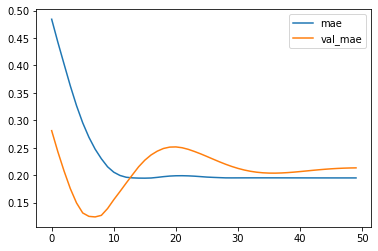

Test MSE: 1383630.063
bestmse=446883.4326575031
Test MAE: 1028.038
bestmae=548.58041
Test MAPE: 56.954
bestmape=25.48086


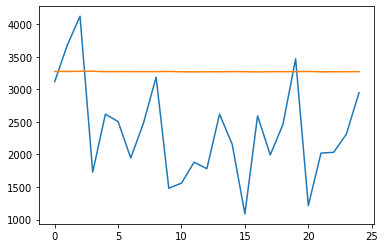

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3274.38878644 3275.23252398 3276.86662883 3278.36372137 3271.62945908
 3272.84750563 3273.01851994 3271.29202145 3272.30992961 3274.49968749
 3270.05116343 3269.13784373 3270.03581232 3269.97096461 3272.29027444
 3271.3235845  3267.94892126 3271.7260133  3270.94439757 3272.01854533
 3275.16652852 3269.26567405 3270.35976392 3270.80336815 3271.70592773]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 89%|████████▉ | 114/128 [08:33<00:59,  4.27s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


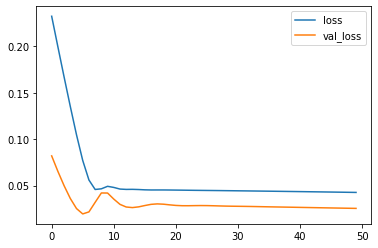

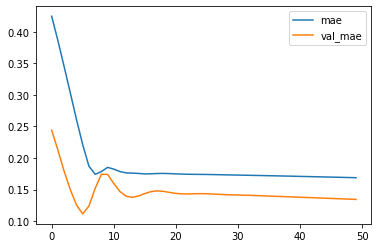

Test MSE: 589944.340
bestmse=446883.4326575031
Test MAE: 646.689
bestmae=548.58041
Test MAPE: 34.729
bestmape=25.48086


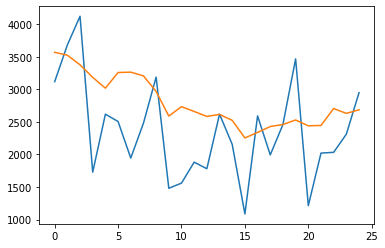

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3568.91502368 3524.66478431 3376.92448986 3184.41990882 3018.32068312
 3258.90711355 3264.21013528 3206.81761843 2968.46757311 2590.00372547
 2734.17725253 2660.60968012 2584.13342977 2615.82616878 2523.87728405
 2253.8132664  2338.69676381 2428.89289534 2460.17732334 2529.90510803
 2440.10265374 2446.03478432 2705.64311337 2630.97757745 2685.97115952]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 90%|████████▉ | 115/128 [08:39<00:59,  4.60s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


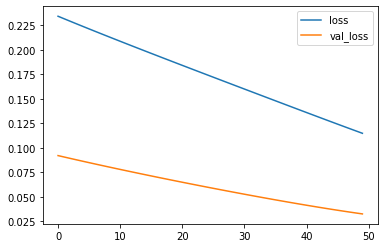

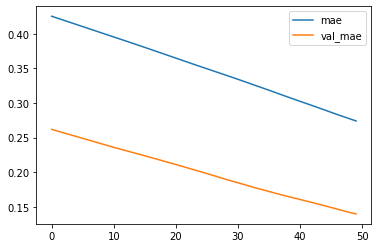

Test MSE: 751121.730
bestmse=446883.4326575031
Test MAE: 673.175
bestmae=548.58041
Test MAPE: 26.418
bestmape=25.48086


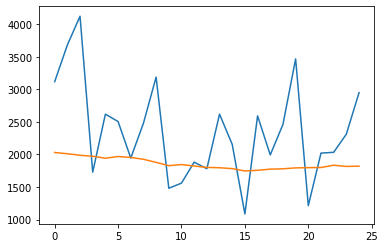

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2030.67818624 2010.99647653 1987.88960272 1972.72327334 1942.31084615
 1968.61017835 1954.72530854 1925.97725803 1878.67637876 1828.06310153
 1844.9473213  1822.30392209 1801.26256254 1796.17983651 1782.56978038
 1746.67277223 1756.97997105 1774.51998478 1779.75428516 1793.92107034
 1797.79973799 1799.72515538 1834.81945795 1816.36877868 1820.54005009]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 91%|█████████ | 116/128 [08:43<00:52,  4.38s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


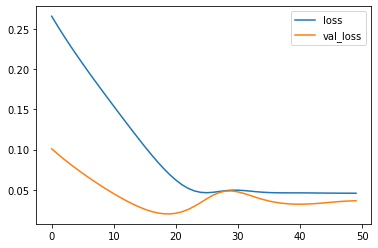

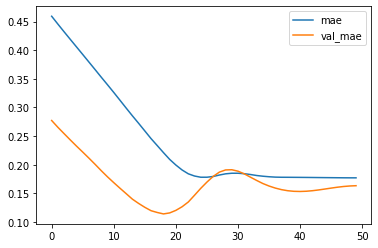

Test MSE: 846171.749
bestmse=446883.4326575031
Test MAE: 786.721
bestmae=548.58041
Test MAPE: 43.485
bestmape=25.48086


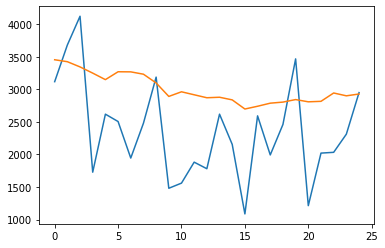

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3454.7319833  3424.90160733 3344.71598202 3249.4934358  3149.44332206
 3270.35560334 3268.78275949 3232.84335643 3098.73829681 2891.64398581
 2962.57604408 2916.7391879  2871.17104799 2878.93240041 2838.4473452
 2698.16984546 2740.60965735 2787.87115455 2804.39483827 2843.1565513
 2808.74436915 2816.22782332 2944.25986642 2900.78493017 2928.67647445]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 16)             1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total pa




 91%|█████████▏| 117/128 [08:47<00:47,  4.30s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


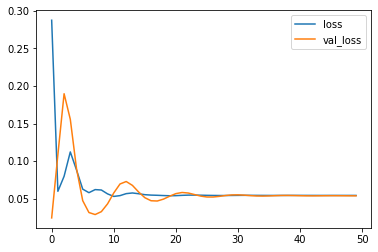

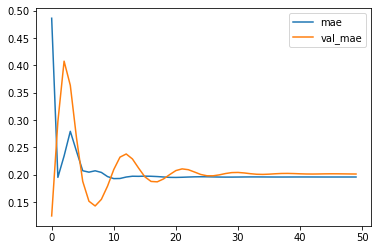

Test MSE: 1245951.836
bestmse=446883.4326575031
Test MAE: 968.091
bestmae=548.58041
Test MAPE: 53.776
bestmape=25.48086


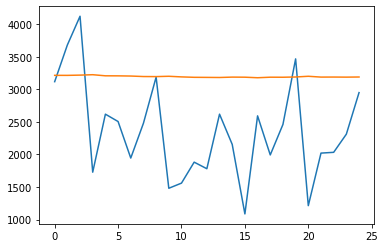

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3215.44092888 3214.90823078 3218.81014031 3225.10323733 3208.17999417
 3207.51630944 3204.60375786 3197.01011997 3195.98561227 3200.9560743
 3191.41657478 3185.12405163 3183.87386817 3182.35439456 3188.13473558
 3186.88469559 3178.52594084 3186.79488438 3186.16735369 3190.10871702
 3200.9619565  3188.39426988 3189.08578748 3187.78840292 3189.79681677]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 92%|█████████▏| 118/128 [08:51<00:43,  4.39s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


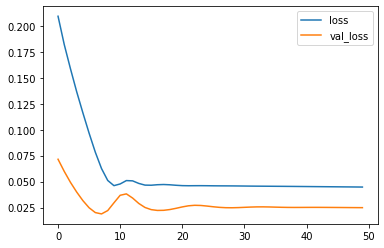

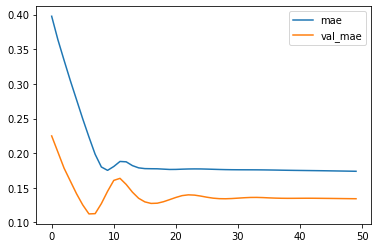

Test MSE: 578153.461
bestmse=446883.4326575031
Test MAE: 646.058
bestmae=548.58041
Test MAPE: 34.574
bestmape=25.48086


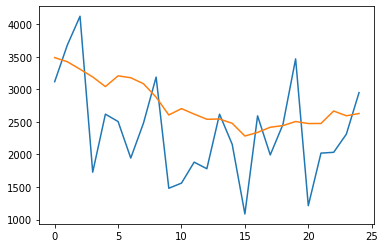

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3487.52512479 3424.06877339 3309.26881897 3190.709993   3042.50945199
 3207.69679266 3178.28190112 3087.11577988 2879.73108888 2606.61219901
 2704.44443506 2619.99751192 2540.65791965 2544.47130919 2478.37800896
 2283.14279425 2338.84740561 2418.1960364  2443.25867116 2505.90672171
 2475.05886799 2476.22254002 2667.43547523 2594.27922666 2629.24978775]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 93%|█████████▎| 119/128 [08:56<00:39,  4.42s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


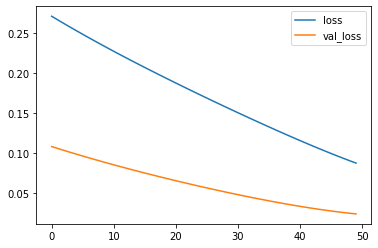

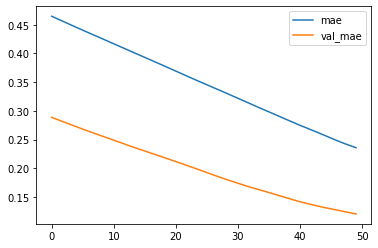

Test MSE: 545022.701
bestmse=446883.4326575031
Test MAE: 580.932
bestmae=548.58041
Test MAPE: 24.636
bestmape=24.63604


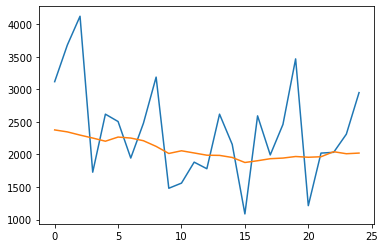

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2377.04973543 2346.85107613 2297.65605557 2252.32363421 2203.53290755
 2267.43659335 2252.02808934 2211.01679212 2124.15242678 2015.41350928
 2056.67350894 2023.04574016 1988.83340946 1985.88764495 1954.12116319
 1876.80863565 1903.76089245 1935.01210752 1944.74830219 1968.62237316
 1957.37215668 1965.00811774 2042.42293823 2011.33075786 2021.42404532]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total 




 94%|█████████▍| 120/128 [09:00<00:35,  4.41s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


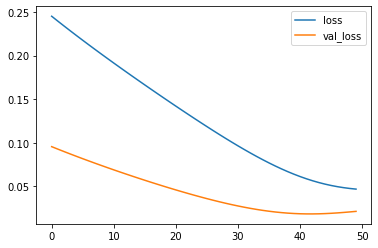

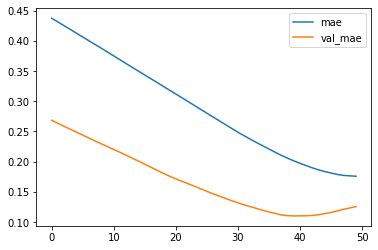

Test MSE: 497567.065
bestmse=446883.4326575031
Test MAE: 603.920
bestmae=548.58041
Test MAPE: 31.530
bestmape=24.63604


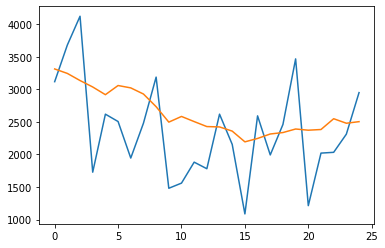

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3313.44504005 3244.84391254 3135.58183759 3036.54045004 2918.36224568
 3058.94059861 3022.62186515 2928.4602676  2733.88816375 2496.76477307
 2583.98321837 2505.15451699 2428.57281739 2422.93737942 2358.77975458
 2193.80359936 2245.95995075 2314.66078877 2336.64731801 2391.14966434
 2372.84912473 2383.35933131 2549.07277054 2479.66592461 2504.03488976]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 64)             16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 95%|█████████▍| 121/128 [09:05<00:31,  4.47s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


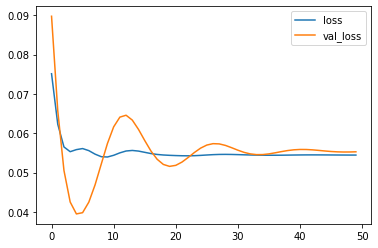

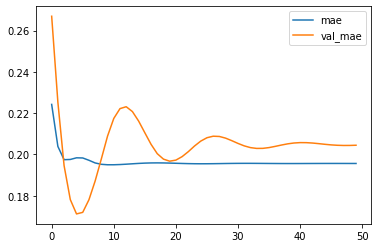

Test MSE: 1280708.408
bestmse=446883.4326575031
Test MAE: 984.337
bestmae=548.58041
Test MAPE: 54.584
bestmape=24.63604


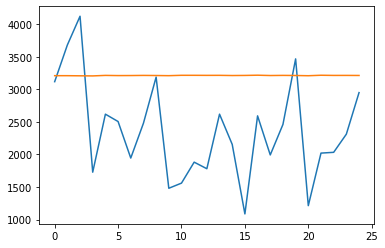

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3210.19744653 3210.09300154 3208.15244824 3206.52207357 3214.41685158
 3211.64274698 3212.32422179 3214.29748589 3212.65850312 3210.27778882
 3215.88525045 3215.75971562 3214.94137198 3215.35341316 3212.53856355
 3213.96865636 3217.48592716 3212.57586533 3214.57581455 3212.88747865
 3209.40707922 3216.76729405 3214.1730988  3214.36491603 3213.41802472]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 95%|█████████▌| 122/128 [09:09<00:26,  4.44s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


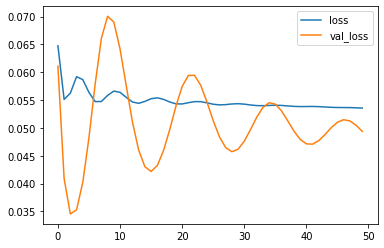

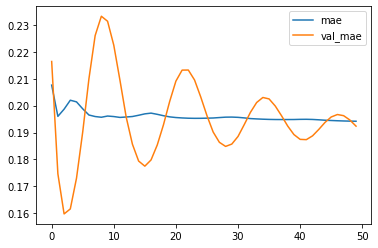

Test MSE: 1144122.326
bestmse=446883.4326575031
Test MAE: 926.112
bestmae=548.58041
Test MAPE: 51.390
bestmape=24.63604


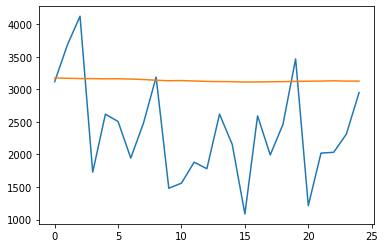

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3175.4022038  3170.3086459  3165.91808307 3164.89515352 3161.58619881
 3163.07052267 3158.43362463 3150.73611563 3140.19721538 3132.19842279
 3135.28629273 3128.2300874  3122.20211995 3119.73059016 3117.78171569
 3112.91569865 3113.67507678 3116.97241056 3118.58686024 3121.98060477
 3125.71910381 3126.95264494 3131.37147105 3126.59899539 3126.86283374]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 96%|█████████▌| 123/128 [09:13<00:21,  4.37s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


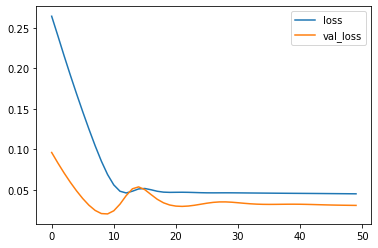

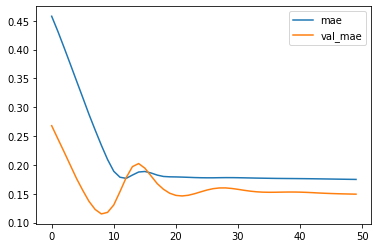

Test MSE: 715961.025
bestmse=446883.4326575031
Test MAE: 718.999
bestmae=548.58041
Test MAPE: 39.377
bestmape=24.63604


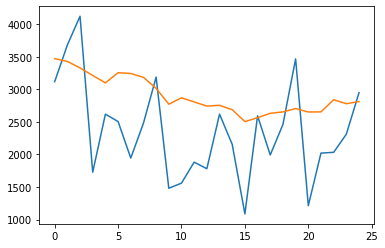

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3471.90227902 3429.03622258 3329.39513719 3213.51744831 3099.85060716
 3255.88021767 3243.93905747 3184.85619617 3015.54858708 2772.32592517
 2870.31755459 2807.2441203  2743.19237512 2755.0138827  2687.66824698
 2504.45855188 2564.29117894 2632.19275463 2653.48604465 2705.02906871
 2652.45192456 2653.98689276 2840.76665503 2779.82889104 2812.60868996]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total 




 97%|█████████▋| 124/128 [09:18<00:17,  4.42s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


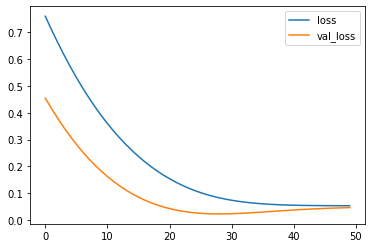

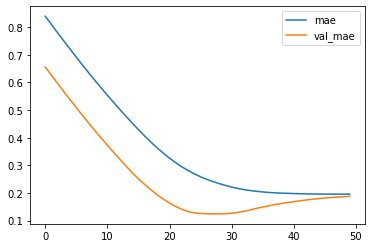

Test MSE: 1094817.207
bestmse=446883.4326575031
Test MAE: 903.811
bestmae=548.58041
Test MAPE: 50.114
bestmape=24.63604


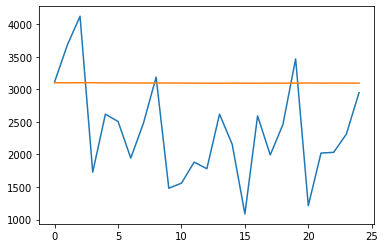

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3101.71469182 3100.82346624 3101.46103972 3102.47851747 3099.39308649
 3100.30927557 3098.98176265 3097.35784405 3097.38696814 3098.25323021
 3095.96419221 3095.51599699 3095.05603737 3094.40239543 3095.63464534
 3095.24111158 3093.72407693 3095.90393549 3094.96536535 3096.12114662
 3098.14218569 3095.31169802 3096.49760765 3095.66836041 3095.98198229]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total 




 98%|█████████▊| 125/128 [09:23<00:13,  4.61s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


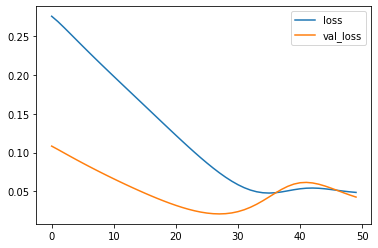

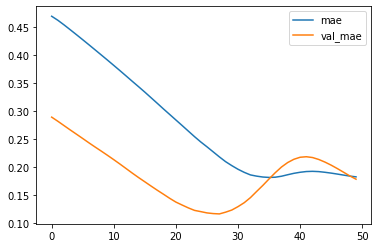

Test MSE: 989972.981
bestmse=446883.4326575031
Test MAE: 859.438
bestmae=548.58041
Test MAPE: 47.583
bestmape=24.63604


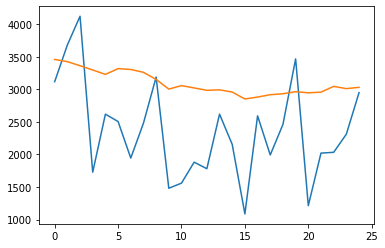

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3459.30661607 3425.74620569 3362.85712826 3297.7376914  3229.7087158
 3318.73141944 3305.43821323 3261.78365457 3152.67839056 3003.95878094
 3057.54622942 3021.60223538 2985.29010147 2992.60483682 2958.62635958
 2852.33580172 2881.69043654 2918.11978412 2932.64810961 2964.18375075
 2946.89896727 2957.2437548  3045.70205384 3011.35558021 3031.08276939]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 32)             4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total p




 98%|█████████▊| 126/128 [09:27<00:08,  4.42s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


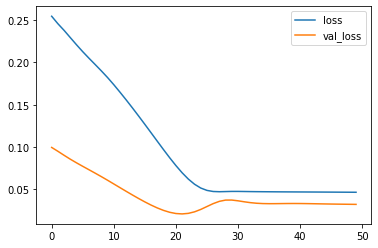

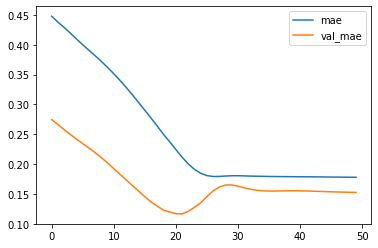

Test MSE: 742858.837
bestmse=446883.4326575031
Test MAE: 733.867
bestmae=548.58041
Test MAPE: 40.341
bestmape=24.63604


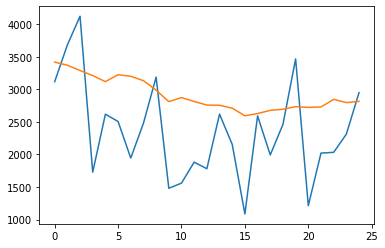

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[3418.32716882 3371.24371588 3289.61264664 3211.39655524 3118.8261655
 3224.9808588  3201.24042863 3133.28290027 2987.41687673 2811.25664395
 2873.65706807 2814.05083412 2758.63201177 2755.62477106 2711.46807307
 2594.34364396 2628.15354586 2677.65157163 2694.41613877 2734.54022753
 2723.67694527 2729.32873863 2846.66980499 2796.7966094  2816.30257034]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total p




 99%|█████████▉| 127/128 [09:32<00:04,  4.54s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


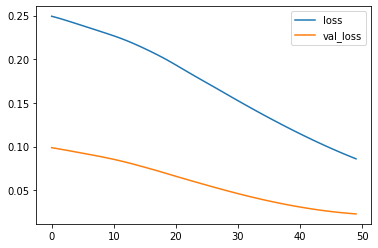

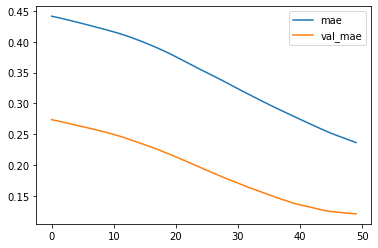

Test MSE: 531007.999
bestmse=446883.4326575031
Test MAE: 579.330
bestmae=548.58041
Test MAPE: 26.132
bestmape=24.63604


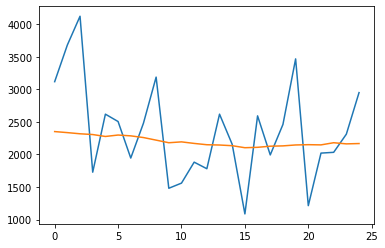

[3118. 3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882.
 1781. 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312.
 2950.]
[2351.68524319 2335.6954053  2317.7301513  2306.01294523 2276.46950603
 2298.52260458 2285.86639798 2259.90866399 2220.20651573 2180.16721678
 2193.48674944 2169.79732227 2149.59582663 2145.19421673 2134.67927569
 2103.73859793 2109.93392125 2127.07767531 2131.90933168 2146.06090921
 2150.41660923 2147.24481028 2180.36505967 2162.80840361 2167.72363031]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 6, 8)              320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total 




100%|██████████| 128/128 [09:36<00:00,  4.50s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmsalesdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 6   #前幾期預測後一期(改這邊)
n_features = 1    #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(LSTM(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(LSTM(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': (0.1, 1, 10),
     'first_neuron':[ 8, 16, 32, 64],
     'second_neuron':[ 8, 16, 32, 64],
     'batch_size': [20,40,60,80,100],
     'epochs': [50],
     'dropout': (0, 0.25, 10),#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu','elu','tanh','sigmoid'],
     'last_activation': ['relu','elu','tanh','sigmoid'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=.001,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )


#十二期-ARIMA

In [ ]:
import warnings
from pandas import read_csv
from pandas import datetime
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
#from sklearn.metrics import mean_absolute_percentage_error
import numpy as np

# MAPE公式引用
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 評估對於給定的順序的ARIMA模型（P，d，q）的
def evaluate_arima_model(X, arima_order):
  # 準備訓練數據集
  train_size = int(len(X) * 0.8)#訓練集
  train, test = X[0:train_size], X[train_size:]#測試集
  history = [x for x in train]
  print(test)#列出實際值

  # 做出預測
  predictions = list()
  for t in range(len(test)):
    model = ARIMA(history, order=arima_order)
    model_fit = model.fit(disp=0)
    yhat = model_fit.forecast()[0]
    print(yhat)#列出預測值
    predictions.append(yhat)#遞延預測值的實際值(每次預測一個)
    history.append(test[t])#遞延預測值的預測值(每次預測一個)

  # calculate out of sample error計算樣品的誤差出
  error = mean_squared_error(test, predictions)
  return error

# 用於ARIMA模型評估P，d和q值的組合
def evaluate_models(dataset, p_values, d_values, q_values):
  dataset = dataset.astype('float32')
  best_score, best_cfg = float("inf"), None
  for p in p_values:
    for d in d_values:
      for q in q_values:
        order = (p,d,q)
        try:
          mse = evaluate_arima_model(dataset, order)
          if mse < best_score:
            best_score, best_cfg = mse, order
          print('ARIMA%s MSE=%.3f' % (order,mse))
        except:
          continue
  print('Best ARIMA%s MSE=%.3f' % (best_cfg, best_score))
 
# 載入數據集
series = read_csv('arimasalesdata-2.csv', header=0, parse_dates=[0], index_col=0, squeeze=True)

# 評估參數
p_values = range(12, 13)
d_values = range(0, 3)
q_values = range(0, 3)

warnings.filterwarnings("ignore")
evaluate_models(series.values, p_values, d_values, q_values)

#十二期包含經濟特徵指標-BPN




  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-12)  var2(t-12)  var3(t-12)  ...   var8(t)   var9(t)  var10(t)
12     0.120066    0.122944    0.000000  ...  0.820717  0.000000  0.634679
13     0.030744    0.000000    0.014761  ...  0.852590  0.000000  0.547320
14     0.050270    0.008658    0.030229  ...  0.816733  0.000000  0.564527
15     0.120482    0.069264    0.061049  ...  0.705179  0.007407  0.624090
16     0.146240    0.103030    0.088795  ...  0.605578  0.007407  0.612839
..          ...         ...         ...  ...       ...       ...       ...
125    0.447029    0.952381    0.839239  ...  0.107570  0.059259  0.495036
126    0.092439    0.946320    0.859406  ...  0.071713  0.059259  0.501655
127    0.108849    0.961039    0.863189  ...  0.059761  0.051852  0.478491
128    0.175737    0.967100    0.862208  ...  0.043825  0.051852  0.489742
129    0.154757    0.912554    0.861686  ...  0.019920  0.051852  0.536069

[118 rows x 130 columns]
(94, 120) 94 (94,)
(94, 120) (94,) (24, 120) (24,)
{'activation': 'tanh', 

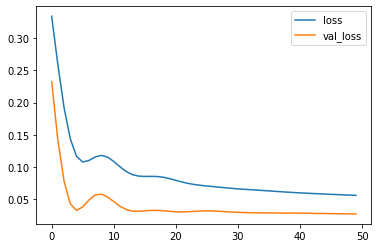

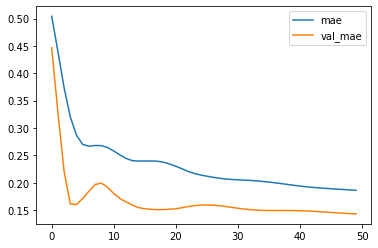

Test MSE: 617930.390
bestmse=617930.3903768478
Test MAE: 688.331
bestmae=688.33052
Test MAPE: 31.972
bestmape=31.97158


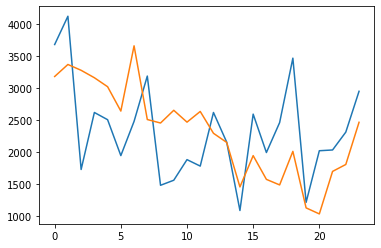

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3181.25872654 3369.20287818 3277.97449166 3162.02119493 3021.48344356
 2641.05508339 3660.62718558 2508.81640393 2454.26269591 2653.25233465
 2467.98587686 2634.80488342 2293.76404536 2150.94457287 1455.41786511
 1944.45024663 1573.4702477  1486.66800417 2011.2112487  1127.91829906
 1033.58755565 1697.89122754 1806.39033765 2465.37876946]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 16)                1936      
_________________________________________________________________
dense_2 (Dense)              (None, 8)                 136       
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 9         
Total params: 2,081
Trainab




100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 12   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times*n_features))
x_val = x_val.reshape((x_val.shape[0], n_times*n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(Dense(params['first_neuron'],input_shape=(x_train.shape[1],),activation=params['activation']))##

    model.add(Dense(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.28],
     'first_neuron':[16],
     'second_neuron':[8],
     'batch_size': [80],
     'epochs': [50],
     'dropout': [0.08],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['tanh'],
     'last_activation': ['tanh'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

#十二期包含經濟特徵指標-RNN

  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-12)  var2(t-12)  var3(t-12)  ...   var8(t)   var9(t)  var10(t)
12     0.120066    0.122944    0.000000  ...  0.820717  0.000000  0.634679
13     0.030744    0.000000    0.014761  ...  0.852590  0.000000  0.547320
14     0.050270    0.008658    0.030229  ...  0.816733  0.000000  0.564527
15     0.120482    0.069264    0.061049  ...  0.705179  0.007407  0.624090
16     0.146240    0.103030    0.088795  ...  0.605578  0.007407  0.612839
..          ...         ...         ...  ...       ...       ...       ...
125    0.447029    0.952381    0.839239  ...  0.107570  0.059259  0.495036
126    0.092439    0.946320    0.859406  ...  0.071713  0.059259  0.501655
127    0.108849    0.961039    0.863189  ...  0.059761  0.051852  0.478491
128    0.175737    0.967100    0.862208  ...  0.043825  0.051852  0.489742
129    0.154757    0.912554    0.861686  ...  0.019920  0.051852  0.536069

[118 rows x 130 columns]
(94, 120) 94 (94,)
(94, 12, 10) (94,) (24, 12, 10) (24,)
{'activation': 'r

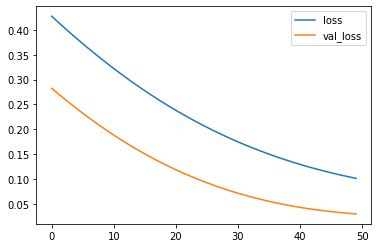

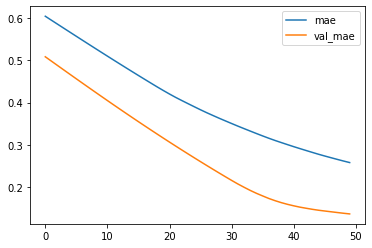

Test MSE: 690525.329
bestmse=690525.3291557888
Test MAE: 661.381
bestmae=661.38054
Test MAPE: 27.894
bestmape=27.89436


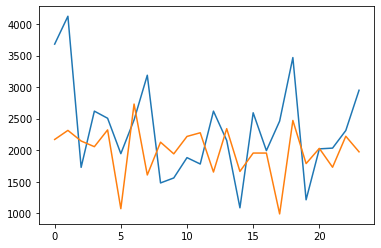

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2170.01761797 2313.7219317  2145.45238808 2055.56758294 2321.53378499
 1072.78849376 2731.09469092 1607.41551201 2126.99675915 1942.09334809
 2218.06424588 2276.21183681 1653.81142861 2341.23830616 1663.64970103
 1954.55773747 1954.62014621  990.01656396 2471.34949303 1787.59806016
 2028.77149147 1729.63353488 2220.90542194 1974.09856123]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
simple_rnn_1 (SimpleRNN)     (None, 12, 8)             152       
_________________________________________________________________
simple_rnn_2 (SimpleRNN)     (None, 32)                1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 1,497
Trainab

100%|██████████| 1/1 [00:02<00:00,  2.98s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 12   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(SimpleRNN(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(SimpleRNN(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()

    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.04],
     'first_neuron':[8],
     'second_neuron':[32],
     'batch_size': [60],
     'epochs': [50],
     'dropout': [0.37],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu'],
     'last_activation': ['elu'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

#十二期包含經濟特徵指標-LSTM

In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 12   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(LSTM(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(LSTM(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.1],
     'first_neuron':[16],
     'second_neuron':[16],
     'batch_size': [80],
     'epochs': [50],
     'dropout': [0.12],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['tanh'],
     'last_activation': ['relu'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1.,#要處理的排列比例
                         print_params=True#打印每個排列超參數

                         )




  0%|          | 0/128 [00:00<?, ?it/s]

     var1(t-12)  var2(t-12)  var3(t-12)  ...   var8(t)   var9(t)  var10(t)
12     0.120066    0.122944    0.000000  ...  0.820717  0.000000  0.634679
13     0.030744    0.000000    0.014761  ...  0.852590  0.000000  0.547320
14     0.050270    0.008658    0.030229  ...  0.816733  0.000000  0.564527
15     0.120482    0.069264    0.061049  ...  0.705179  0.007407  0.624090
16     0.146240    0.103030    0.088795  ...  0.605578  0.007407  0.612839
..          ...         ...         ...  ...       ...       ...       ...
125    0.447029    0.952381    0.839239  ...  0.107570  0.059259  0.495036
126    0.092439    0.946320    0.859406  ...  0.071713  0.059259  0.501655
127    0.108849    0.961039    0.863189  ...  0.059761  0.051852  0.478491
128    0.175737    0.967100    0.862208  ...  0.043825  0.051852  0.489742
129    0.154757    0.912554    0.861686  ...  0.019920  0.051852  0.536069

[118 rows x 130 columns]
(94, 120) 94 (94,)
(94, 12, 10) (94,) (24, 12, 10) (24,)
{'activation': 't

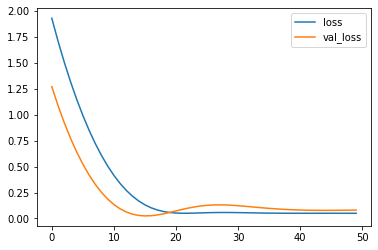

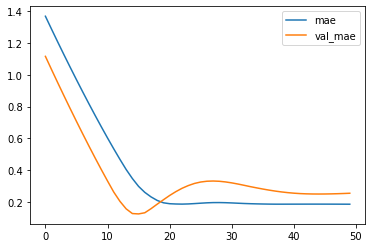

Test MSE: 1876418.339
bestmse=1876418.3391873671
Test MAE: 1222.977
bestmae=1222.97723
Test MAPE: 67.695
bestmape=67.69545


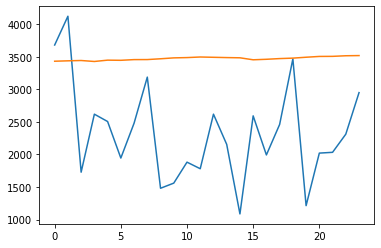

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3432.16325939 3438.30456686 3443.14117289 3428.26464963 3448.70315504
 3446.30895472 3456.87482703 3457.58671713 3469.7321763  3483.51145339
 3488.00689161 3496.97739553 3492.51667666 3488.01291728 3484.74241209
 3454.16413546 3461.94528651 3472.70025015 3479.68945575 3493.43085718
 3505.70256853 3506.94902182 3516.0948441  3518.86550546]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




  1%|          | 1/128 [00:04<10:04,  4.76s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


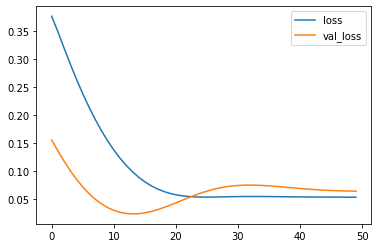

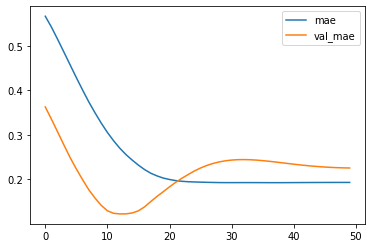

Test MSE: 1493482.460
bestmse=1493482.4601533965
Test MAE: 1086.429
bestmae=1086.42894
Test MAPE: 60.258
bestmape=60.25772


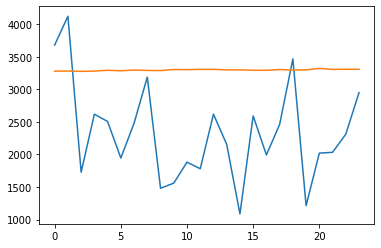

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3279.42452657 3281.80552781 3276.62316298 3280.85490632 3293.10767984
 3285.43613863 3296.84560502 3290.76570201 3288.36518908 3305.3943119
 3302.64545774 3307.33285666 3306.87289703 3299.72013748 3299.200495
 3293.34641123 3292.80983949 3304.18229103 3297.3747164  3299.81482661
 3321.20567513 3306.89728665 3308.59939551 3308.87915885]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 6,825
Trainable 




  2%|▏         | 2/128 [00:09<09:55,  4.72s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


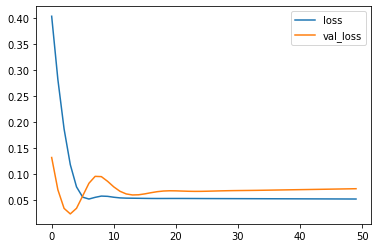

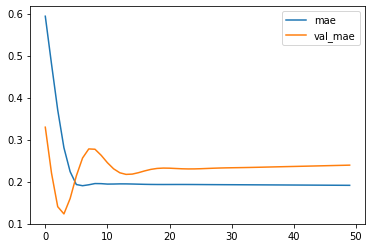

Test MSE: 1671298.069
bestmse=1493482.4601533965
Test MAE: 1151.337
bestmae=1086.42894
Test MAPE: 63.863
bestmape=60.25772


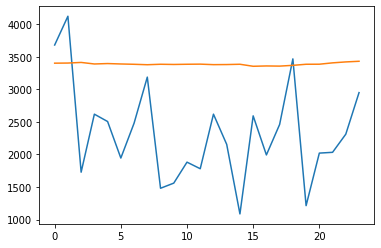

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3402.22140849 3404.09768796 3413.5749222  3389.89977014 3396.31538916
 3389.9131127  3385.06316411 3378.3657732  3385.50303817 3382.49680173
 3385.5891192  3387.35779738 3379.64551115 3381.07101297 3385.50246429
 3354.56652099 3359.53382671 3357.12427527 3368.92081934 3385.50691181
 3386.29354894 3407.07408297 3421.53928238 3431.38939095]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Traina




  2%|▏         | 3/128 [00:15<10:45,  5.16s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


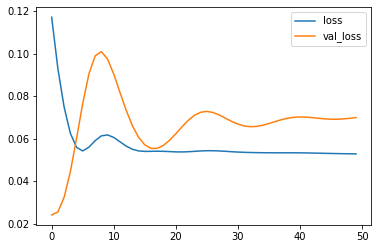

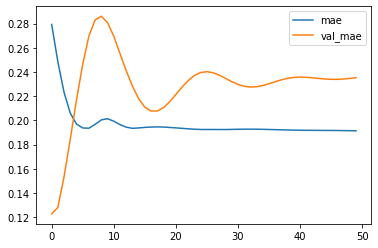

Test MSE: 1619949.124
bestmse=1493482.4601533965
Test MAE: 1132.865
bestmae=1086.42894
Test MAPE: 62.841
bestmape=60.25772


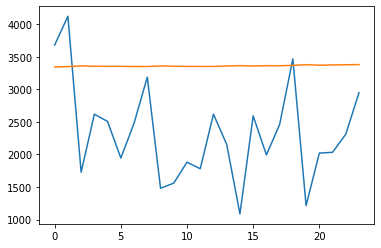

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3344.57983053 3349.87510496 3360.80524349 3355.31929958 3353.21045786
 3354.00469881 3350.40622491 3351.24422371 3359.71875745 3354.49866045
 3352.49082047 3352.11149007 3351.99169397 3359.1481837  3363.96886474
 3358.77430511 3363.61291969 3362.73876685 3368.39127755 3378.64037168
 3371.07930112 3375.31649625 3378.00451982 3380.53071105]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Traina




  3%|▎         | 4/128 [00:20<10:23,  5.03s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


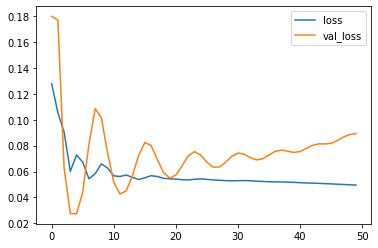

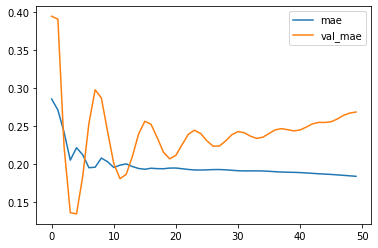

Test MSE: 2070517.024
bestmse=1493482.4601533965
Test MAE: 1293.259
bestmae=1086.42894
Test MAPE: 71.287
bestmape=60.25772


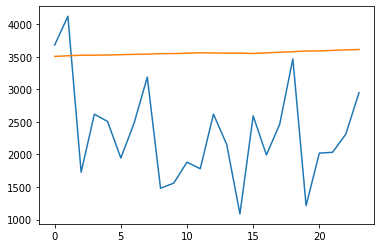

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3506.15851104 3515.47706926 3525.00050032 3524.47368443 3527.46155691
 3532.66458118 3537.7267195  3540.80899417 3548.42142642 3549.8153652
 3555.2668767  3561.7487781  3559.1752423  3555.83328986 3556.38650393
 3551.38117909 3560.73130035 3569.70639527 3578.42123854 3589.30934083
 3590.10157323 3598.63335085 3606.72927153 3612.0548178 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 52,289
Trainab




  4%|▍         | 5/128 [00:25<10:32,  5.14s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


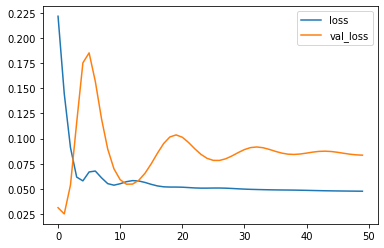

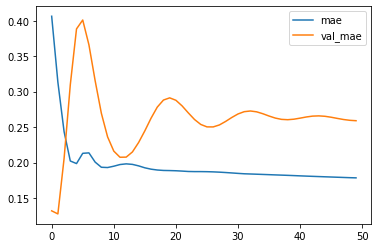

Test MSE: 1936617.651
bestmse=1493482.4601533965
Test MAE: 1246.888
bestmae=1086.42894
Test MAPE: 68.848
bestmape=60.25772


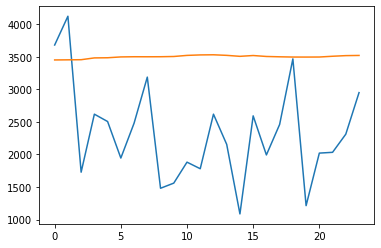

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3451.71886039 3453.48753858 3455.5328238  3483.04977214 3485.39088917
 3498.154984   3500.9939363  3500.4889276  3501.18761861 3504.77777135
 3521.64276636 3528.9820348  3531.03506732 3522.22123086 3507.32175267
 3519.75730491 3505.11147881 3500.115049   3496.43106794 3495.99693263
 3496.78686953 3508.527174   3518.14242482 3520.86545467]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 22,529
Traina




  5%|▍         | 6/128 [00:30<10:24,  5.12s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


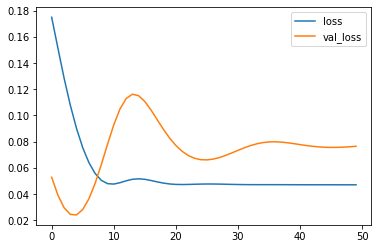

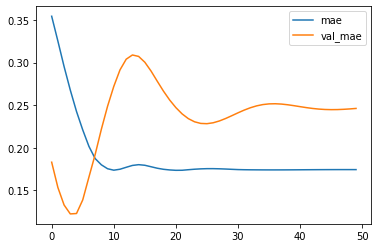

Test MSE: 1770146.831
bestmse=1493482.4601533965
Test MAE: 1185.111
bestmae=1086.42894
Test MAPE: 65.705
bestmape=60.25772


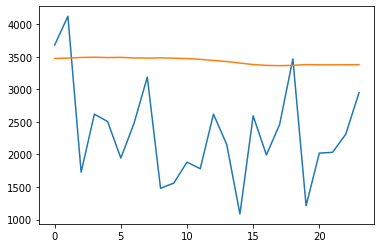

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3474.68011379 3480.71984565 3489.69092345 3493.75997365 3488.6702894
 3491.23579097 3483.04001629 3480.0707947  3484.50167215 3478.73309553
 3473.1619314  3460.8750124  3443.55550957 3427.26324034 3404.07458955
 3380.79799265 3368.35182375 3363.82769185 3368.62929159 3380.42153162
 3377.07025373 3376.93367183 3377.4723956  3379.17464793]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainabl




  5%|▌         | 7/128 [00:35<09:57,  4.94s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


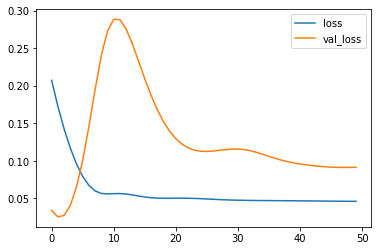

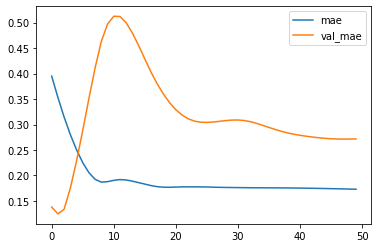

Test MSE: 2121331.714
bestmse=1493482.4601533965
Test MAE: 1308.258
bestmae=1086.42894
Test MAPE: 72.131
bestmape=60.25772


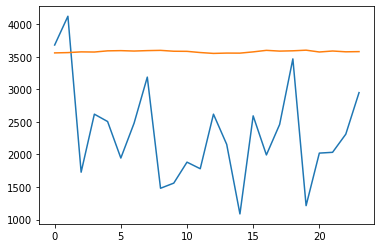

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3560.02687061 3564.59146059 3575.77195144 3573.34475338 3591.48633003
 3594.77749467 3588.51423907 3595.14993858 3598.89790654 3585.50169003
 3583.93128514 3565.51023209 3552.23711145 3557.23526287 3556.42954445
 3575.7553091  3599.16475773 3587.5925982  3592.14685845 3601.87573624
 3573.95965886 3589.09155583 3576.77249992 3579.66338778]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainab




  6%|▋         | 8/128 [00:39<09:37,  4.81s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


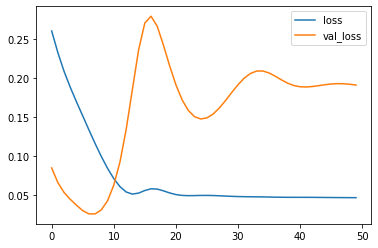

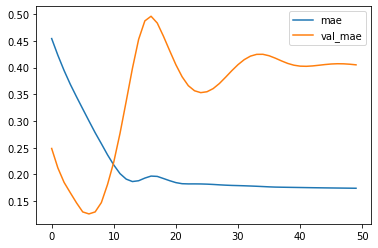

Test MSE: 4424149.428
bestmse=1493482.4601533965
Test MAE: 1950.935
bestmae=1086.42894
Test MAPE: 104.477
bestmape=60.25772


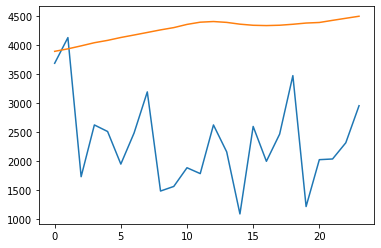

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3886.40538371 3929.34173965 3980.69710708 4034.84149981 4075.30733025
 4124.91324425 4167.55549002 4211.41119134 4255.78366578 4294.97147989
 4350.15343595 4388.36824751 4399.65978289 4384.82744789 4354.1745677
 4335.17361546 4329.94447994 4335.93227625 4352.60502362 4373.55025935
 4383.23322725 4419.9898262  4455.58490515 4490.70424294]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 24,401
Trainab




  7%|▋         | 9/128 [00:44<09:40,  4.87s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


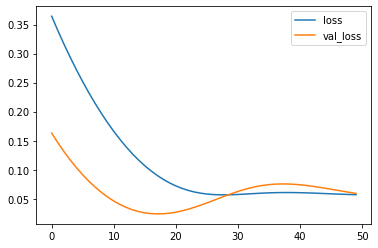

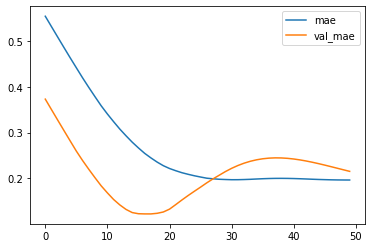

Test MSE: 1369469.095
bestmse=1369469.0949771449
Test MAE: 1036.146
bestmae=1036.14567
Test MAPE: 57.565
bestmape=57.56454


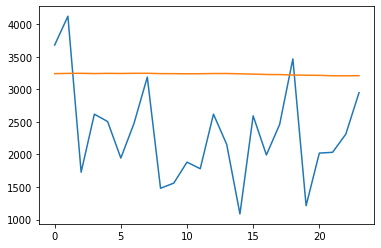

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3241.82605517 3245.10904211 3246.58820111 3242.62660873 3245.83757454
 3244.17979741 3246.60642159 3246.84328789 3241.6698181  3241.02363652
 3239.41966003 3240.14446229 3243.44107872 3243.36518395 3239.07547939
 3234.56009907 3228.41993934 3227.0907048  3220.25400609 3217.25623429
 3215.22199613 3208.8304798  3208.25976259 3210.22470552]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




  8%|▊         | 10/128 [00:49<09:13,  4.69s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


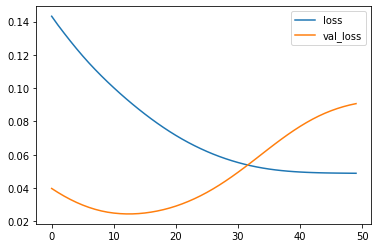

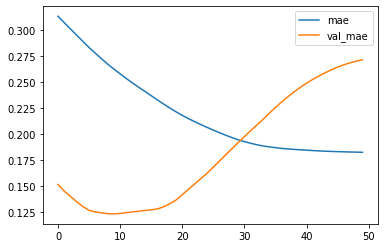

Test MSE: 2101804.027
bestmse=1369469.0949771449
Test MAE: 1304.974
bestmae=1036.14567
Test MAPE: 71.814
bestmape=57.56454


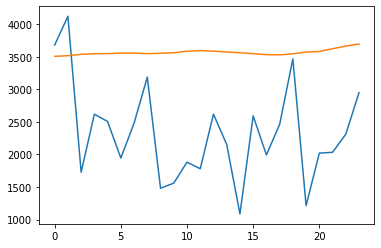

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3507.16164196 3517.1243732  3538.0983026  3547.77294934 3548.77952349
 3556.38191295 3556.52222502 3548.64466321 3554.31510746 3562.2896539
 3586.16221845 3595.61821938 3586.99978685 3573.16398323 3562.20701611
 3547.93937266 3532.66372037 3530.20180297 3546.28776467 3572.56285071
 3582.67335439 3624.34116292 3664.88504016 3697.15394819]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 8,657
Trainabl




  9%|▊         | 11/128 [00:53<09:08,  4.69s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


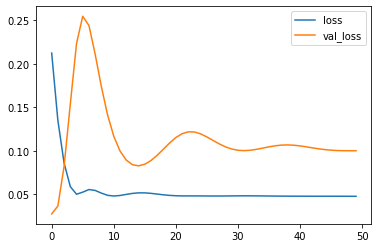

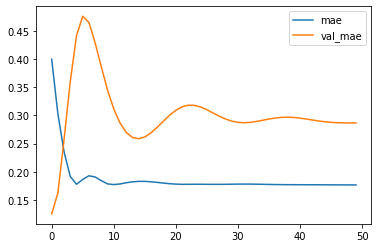

Test MSE: 2320575.424
bestmse=1369469.0949771449
Test MAE: 1380.264
bestmae=1036.14567
Test MAPE: 75.645
bestmape=57.56454


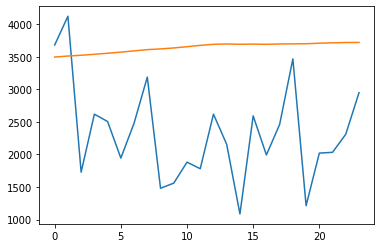

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3495.73008144 3512.1755749  3523.51215935 3538.74391031 3554.79630041
 3571.67592919 3590.99796367 3610.18915498 3621.14210498 3635.69611132
 3655.24626052 3675.75764787 3692.0803324  3697.06786716 3692.45679343
 3694.91182435 3691.99511218 3697.14046216 3698.60814369 3700.95557332
 3708.46585608 3714.43213212 3719.38925159 3720.97429025]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 21,545
Traina




  9%|▉         | 12/128 [00:58<09:11,  4.75s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


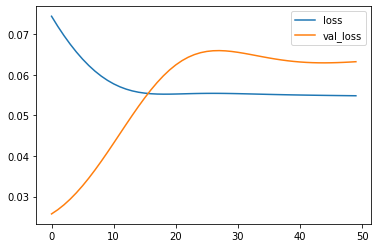

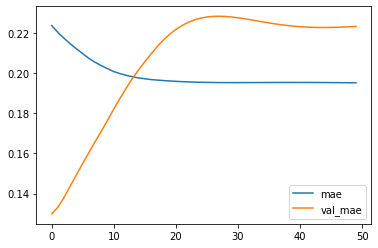

Test MSE: 1465023.356
bestmse=1369469.0949771449
Test MAE: 1074.337
bestmae=1036.14567
Test MAPE: 59.652
bestmape=57.56454


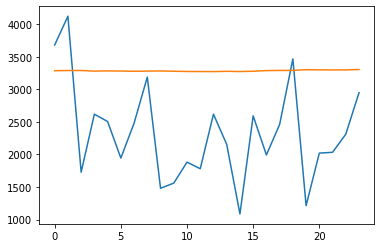

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3286.5134427  3289.34220874 3289.37448913 3280.46754169 3283.54723394
 3281.35116345 3277.85397822 3280.26051682 3282.48442018 3277.95311487
 3274.99221444 3273.37747782 3272.87462115 3277.34079182 3273.96096373
 3278.41536999 3288.16433334 3290.64432776 3291.41719192 3302.5549292
 3299.72085482 3297.99665183 3299.27151185 3304.76262063]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainabl




 10%|█         | 13/128 [01:03<08:55,  4.66s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


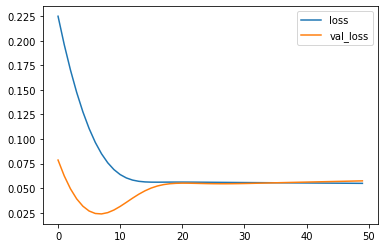

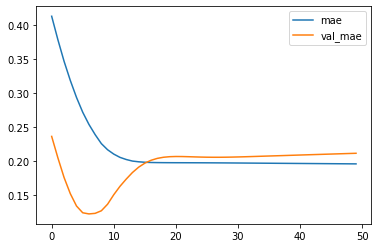

Test MSE: 1329694.486
bestmse=1329694.4860877146
Test MAE: 1017.624
bestmae=1017.62361
Test MAPE: 56.623
bestmape=56.62346


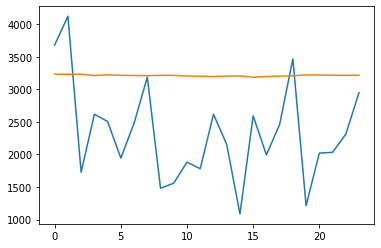

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3232.75096279 3231.78484672 3233.77819639 3211.66713661 3224.49364018
 3215.53662229 3213.7878862  3209.67120451 3216.65495831 3214.38155836
 3205.53271562 3202.17440778 3196.65417492 3203.44080317 3207.12091058
 3185.1967901  3197.48586112 3201.88761449 3208.41126519 3221.91608727
 3221.18884605 3216.89612865 3216.69010806 3215.757994  ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,161
Trainab




 11%|█         | 14/128 [01:08<09:22,  4.93s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


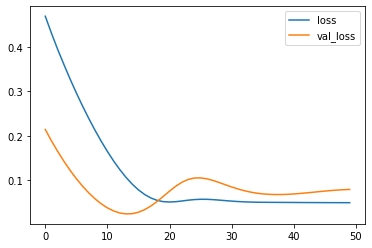

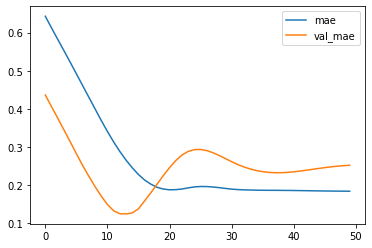

Test MSE: 1842591.350
bestmse=1329694.4860877146
Test MAE: 1210.731
bestmae=1017.62361
Test MAPE: 67.070
bestmape=56.62346


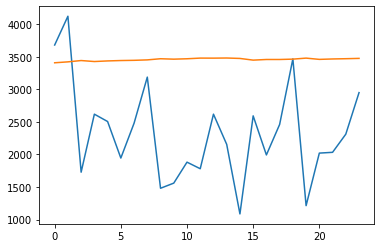

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3408.28050858 3422.37111205 3442.58580679 3427.40140039 3436.73129261
 3442.71722382 3445.96663916 3452.7110877  3470.31178856 3463.82902634
 3469.92270231 3480.13592935 3479.42776942 3481.43948305 3474.93950462
 3448.98464    3458.82427537 3458.8400569  3464.29070759 3479.86047006
 3460.50916803 3466.88059878 3470.79728556 3475.67348886]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 8,657
Trainab




 12%|█▏        | 15/128 [01:13<09:07,  4.85s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


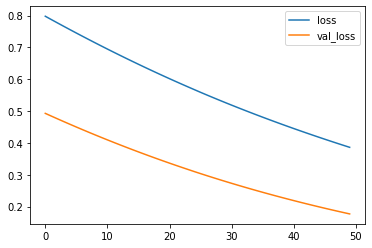

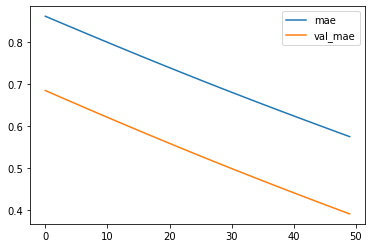

Test MSE: 4105501.476
bestmse=1329694.4860877146
Test MAE: 1884.662
bestmae=1017.62361
Test MAPE: 78.815
bestmape=56.62346


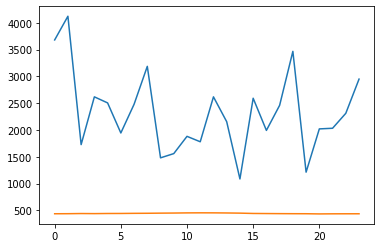

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[437.66149874 438.75824277 441.80077671 440.26602371 442.5426517
 443.14672531 445.44429968 446.67877336 449.12964369 450.87529521
 453.78920974 454.96435924 454.48524658 452.34383754 449.23315613
 443.21336637 441.48622228 439.882461   438.71104167 438.09871863
 434.65762953 436.51267569 437.10046564 437.33302788]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainable params: 2,225
Non-trai




 12%|█▎        | 16/128 [01:17<08:38,  4.63s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


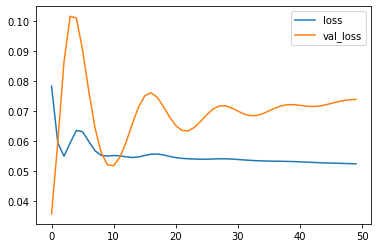

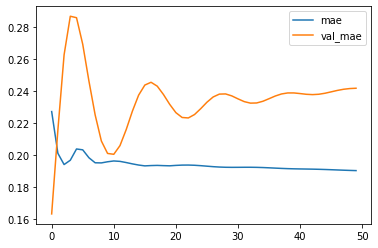

Test MSE: 1709901.787
bestmse=1329694.4860877146
Test MAE: 1164.640
bestmae=1017.62361
Test MAPE: 64.577
bestmape=56.62346


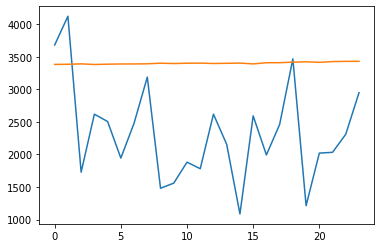

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3383.04442054 3385.01682383 3391.80431288 3381.75923079 3386.86799634
 3389.63162774 3390.47895199 3392.43959087 3401.93375438 3396.92211694
 3401.645096   3403.1913982  3397.22741765 3400.36076707 3403.75623322
 3390.95842332 3408.84003526 3409.75622433 3418.01426429 3423.09462309
 3415.28477836 3426.6240887  3430.06130415 3430.80260527]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 21,545
Traina




 13%|█▎        | 17/128 [01:22<08:42,  4.71s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


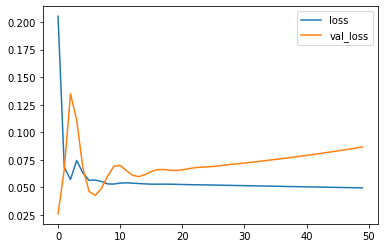

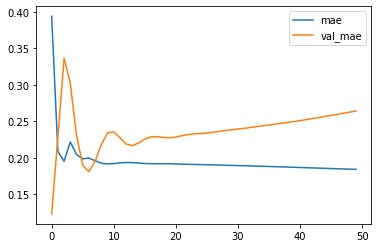

Test MSE: 2008534.074
bestmse=1329694.4860877146
Test MAE: 1272.365
bestmae=1017.62361
Test MAPE: 70.183
bestmape=56.62346


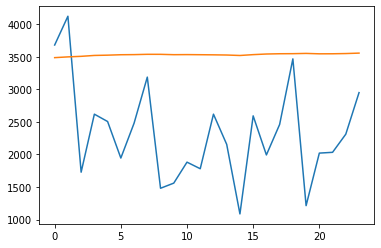

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3487.10964036 3498.73344851 3507.28473783 3520.98797667 3525.27423799
 3531.78770244 3533.60831618 3538.22799802 3537.9218365  3532.59284699
 3533.80888498 3532.11452341 3530.26378131 3527.43860197 3520.32257032
 3533.3945483  3542.94552529 3547.05646825 3548.1715045  3552.11602414
 3545.94257975 3546.572119   3549.98752725 3556.77157307]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Traina




 14%|█▍        | 18/128 [01:28<09:26,  5.15s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


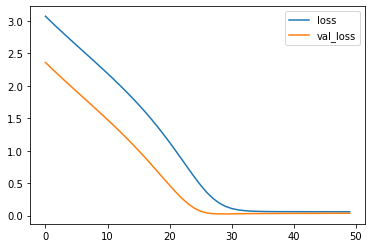

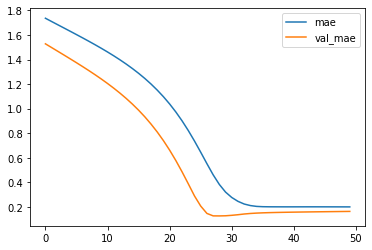

Test MSE: 824982.063
bestmse=824982.0630525431
Test MAE: 786.453
bestmae=786.45310
Test MAPE: 43.090
bestmape=43.09024


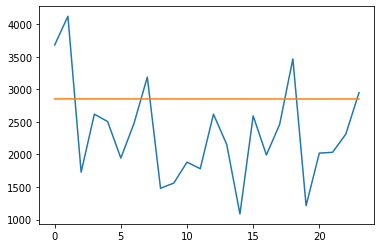

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2853.71740222 2853.73476189 2853.74466121 2853.34495831 2853.27164596
 2853.07079023 2852.84597528 2852.77581924 2852.68399948 2852.60552227
 2852.60939592 2852.56305563 2852.57496351 2852.58213693 2852.54311353
 2852.27439725 2852.24355155 2852.09262282 2852.07497621 2852.0636422
 2852.03939605 2852.22906125 2852.36750823 2852.57309842]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 8,657
Trainabl




 15%|█▍        | 19/128 [01:33<09:03,  4.98s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


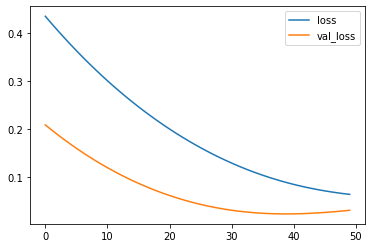

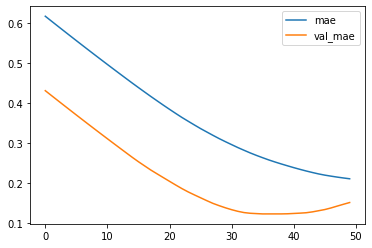

Test MSE: 727786.004
bestmse=727786.0035139363
Test MAE: 725.953
bestmae=725.95265
Test MAPE: 39.336
bestmape=39.33572


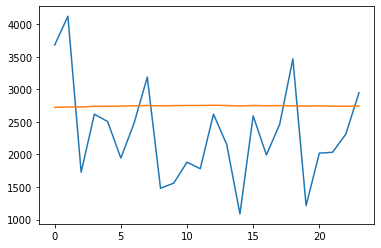

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2724.46300852 2728.82215178 2729.15298986 2739.25545931 2740.12674278
 2743.02810383 2747.37548268 2751.45055854 2746.60907459 2750.71829593
 2752.44651604 2752.75325143 2755.87297136 2752.01496315 2745.00768054
 2752.3572787  2748.3740226  2750.85172153 2745.6748085  2742.23070657
 2746.77119386 2741.52312052 2740.04611355 2743.24158478]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainab




 16%|█▌        | 20/128 [01:37<08:43,  4.85s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


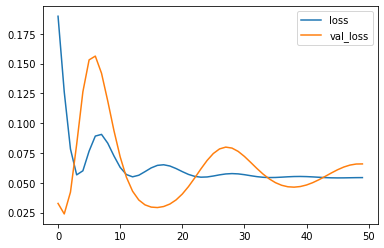

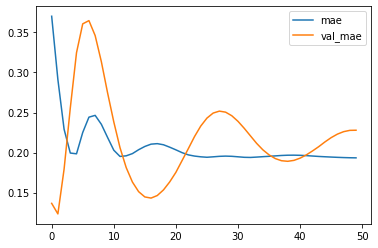

Test MSE: 1524834.105
bestmse=727786.0035139363
Test MAE: 1097.122
bestmae=725.95265
Test MAPE: 60.917
bestmape=39.33572


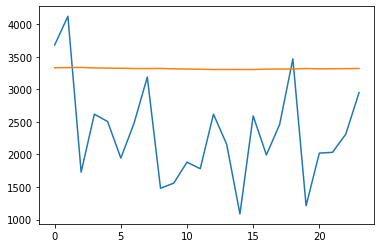

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3331.83424312 3334.00147647 3337.03124171 3329.00791603 3325.90885556
 3324.50989538 3319.81173635 3319.24231035 3321.58227962 3314.81545001
 3311.64264679 3309.55848163 3304.88915974 3305.24266583 3305.47250217
 3304.40710598 3310.68556923 3311.20664638 3313.35895902 3320.50956655
 3314.6721251  3316.66447049 3318.22325444 3321.0279178 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 30,401
Traina




 16%|█▋        | 21/128 [01:42<08:42,  4.88s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


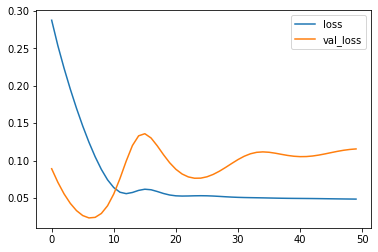

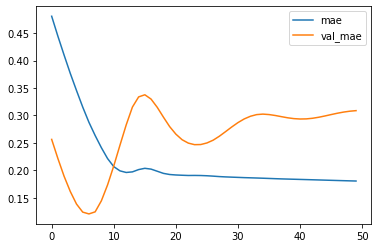

Test MSE: 2677352.016
bestmse=727786.0035139363
Test MAE: 1486.724
bestmae=725.95265
Test MAPE: 81.240
bestmape=39.33572


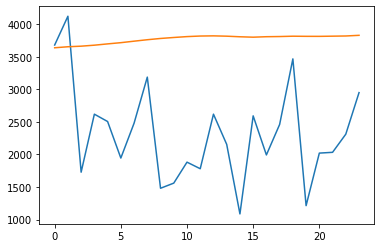

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3638.76633465 3654.44972408 3663.28680241 3678.51396239 3698.37228167
 3717.09174895 3740.08083522 3762.35831833 3781.72195864 3796.75801873
 3810.3154937  3819.00049555 3821.65552139 3816.76497126 3807.66591966
 3801.3834393  3808.61969745 3811.31059039 3816.39510977 3814.49673617
 3814.06575716 3816.91159594 3819.83318603 3829.99705994]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,361
Traina




 17%|█▋        | 22/128 [01:47<08:40,  4.91s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


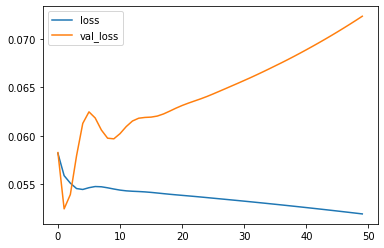

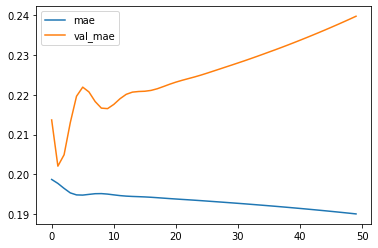

Test MSE: 1677245.148
bestmse=727786.0035139363
Test MAE: 1154.413
bestmae=725.95265
Test MAPE: 63.970
bestmape=39.33572


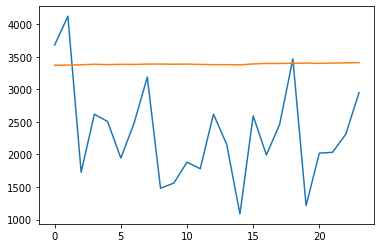

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3370.58232665 3373.36331773 3376.87857997 3385.21854037 3380.07562935
 3384.65973103 3382.85934633 3388.10239828 3389.06205827 3386.02311105
 3387.73698431 3382.86522853 3379.32012486 3379.05571264 3376.41603792
 3390.44380224 3398.18851233 3397.33171916 3400.72072923 3403.56183356
 3399.14845926 3402.80389011 3406.79575431 3410.02364939]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 8,657
Trainab




 18%|█▊        | 23/128 [01:53<09:09,  5.23s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


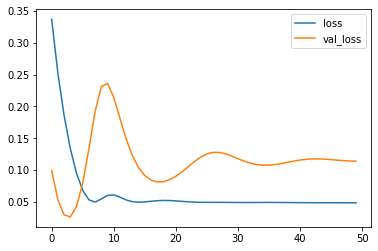

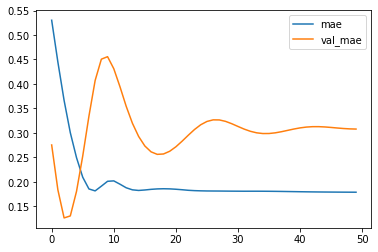

Test MSE: 2642773.403
bestmse=727786.0035139363
Test MAE: 1482.141
bestmae=725.95265
Test MAPE: 80.802
bestmape=39.33572


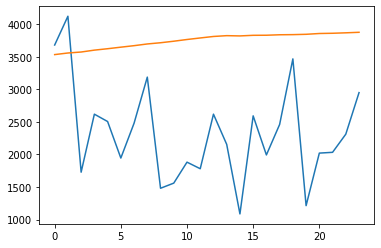

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3533.97215199 3558.47253418 3573.58721495 3602.53683853 3624.16268826
 3648.02836633 3671.04126835 3697.28794765 3715.97068703 3739.42403698
 3765.86066842 3789.43194938 3812.30769563 3824.81756449 3820.76486969
 3830.1551621  3831.3198384  3838.49756145 3840.53882957 3845.67384982
 3857.88702607 3861.55579948 3868.43596911 3876.54422808]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




 19%|█▉        | 24/128 [01:58<08:48,  5.08s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


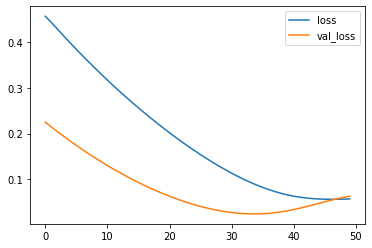

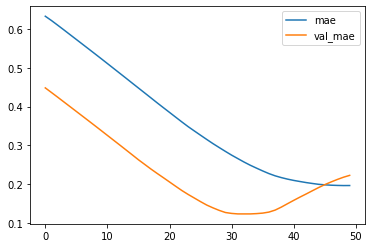

Test MSE: 1452007.673
bestmse=727786.0035139363
Test MAE: 1070.071
bestmae=725.95265
Test MAPE: 59.365
bestmape=39.33572


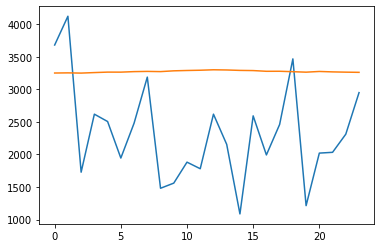

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3251.01950896 3253.31084245 3249.89787316 3257.79953766 3264.94096321
 3264.48344254 3272.49399954 3275.81113195 3272.7079109  3284.65882695
 3289.9222514  3293.82903886 3300.75310981 3297.76122022 3291.24373865
 3288.5824002  3277.53289598 3277.96559662 3271.34553516 3264.08804369
 3274.92263228 3268.35020232 3264.24112445 3261.40575886]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainab




 20%|█▉        | 25/128 [02:02<08:23,  4.89s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


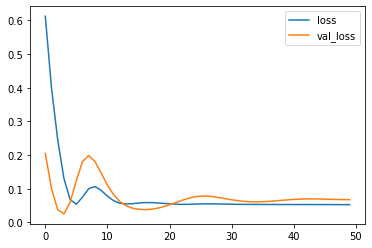

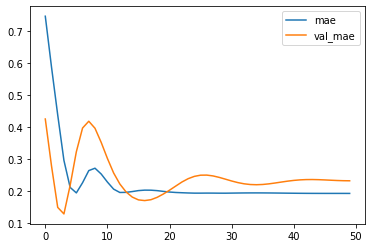

Test MSE: 1569708.325
bestmse=727786.0035139363
Test MAE: 1114.837
bestmae=725.95265
Test MAPE: 61.847
bestmape=39.33572


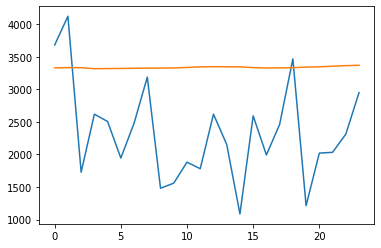

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3330.54905337 3334.09960884 3332.89203548 3317.19272107 3319.29654139
 3321.45660132 3324.13802534 3325.60168976 3326.66149068 3328.89170665
 3336.22265393 3345.73632914 3347.92838252 3346.98177814 3346.02556139
 3334.51408899 3328.62600321 3330.11735702 3332.81743193 3341.73040503
 3346.15898699 3355.75472611 3363.99612373 3369.62123197]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 8,657
Trainab




 20%|██        | 26/128 [02:07<08:12,  4.83s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


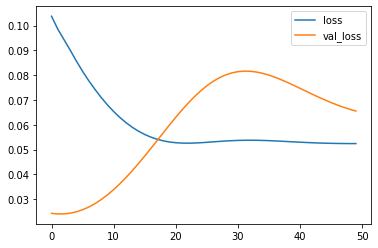

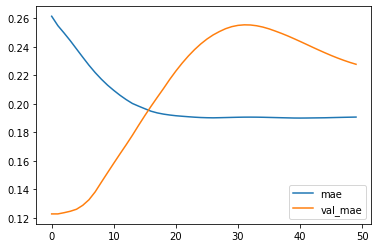

Test MSE: 1518921.798
bestmse=727786.0035139363
Test MAE: 1096.658
bestmae=725.95265
Test MAPE: 60.786
bestmape=39.33572


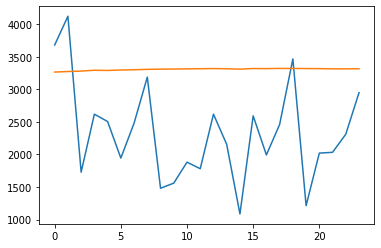

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3265.85327864 3273.88707751 3281.02735531 3293.62445295 3290.41406101
 3297.5335359  3300.93933177 3307.5205133  3310.33019805 3311.88539529
 3314.79077345 3316.99416083 3319.55679303 3316.44539428 3310.63865507
 3319.57429618 3318.79311085 3321.67754263 3320.61975026 3319.78074718
 3318.26844698 3314.98502964 3314.8395527  3316.54395705]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainab




 21%|██        | 27/128 [02:11<07:46,  4.62s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


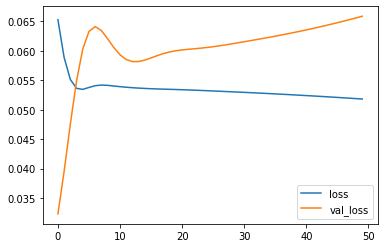

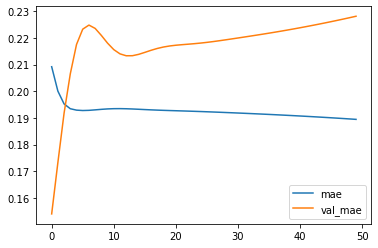

Test MSE: 1526110.366
bestmse=727786.0035139363
Test MAE: 1098.289
bestmae=725.95265
Test MAPE: 60.938
bestmape=39.33572


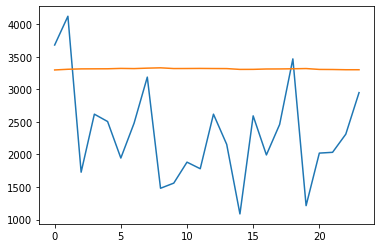

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3298.01860249 3308.66510403 3314.4937939  3315.37827647 3316.08901882
 3321.78399616 3319.0347116  3325.83654749 3330.71777219 3319.7130301
 3320.28389078 3321.49777675 3320.01689613 3319.04131114 3306.56759632
 3307.18737972 3312.76514339 3313.56167984 3316.0037986  3319.55349326
 3306.1806621  3304.99317431 3301.50330597 3301.42253327]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainabl




 22%|██▏       | 28/128 [02:17<08:15,  4.96s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


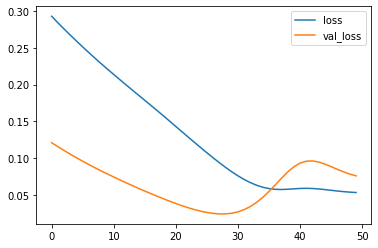

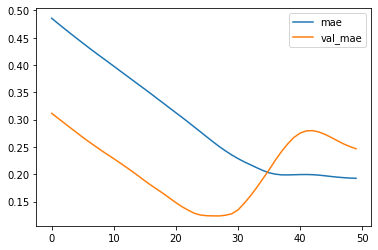

Test MSE: 1764451.443
bestmse=727786.0035139363
Test MAE: 1187.393
bestmae=725.95265
Test MAPE: 65.637
bestmape=39.33572


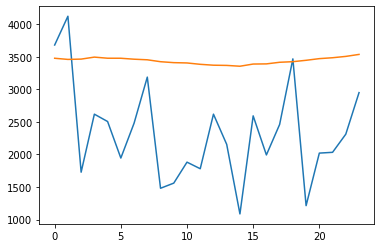

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3477.69840157 3460.03801787 3464.69127131 3495.29938936 3478.20254946
 3477.80313349 3463.22072041 3454.1675787  3424.82413441 3410.35362667
 3405.58717668 3384.64610153 3371.01488382 3367.92514879 3355.30940026
 3388.78459042 3391.2556898  3416.01345426 3425.12699616 3446.49316812
 3471.93498981 3485.75185561 3506.2666862  3536.74969983]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,161
Trainab




 23%|██▎       | 29/128 [02:21<07:53,  4.79s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


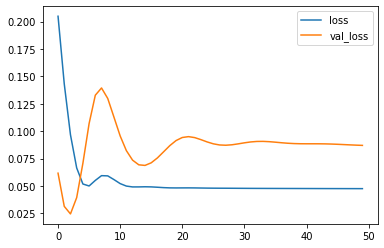

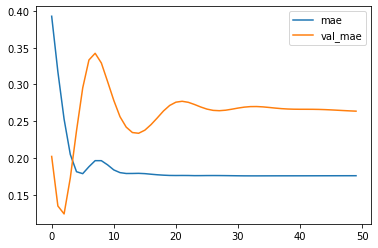

Test MSE: 2017283.710
bestmse=727786.0035139363
Test MAE: 1269.880
bestmae=725.95265
Test MAPE: 70.198
bestmape=39.33572


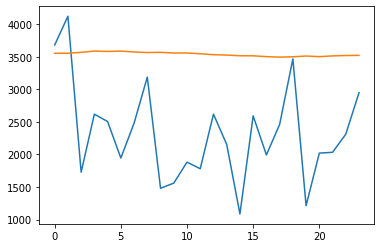

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3553.7713623  3554.78080583 3568.57844687 3587.89244711 3582.35973251
 3587.35673618 3574.54558372 3565.7928648  3568.91244125 3558.17125058
 3558.38702703 3546.77297473 3532.34923768 3526.90002167 3516.27561426
 3515.18066359 3502.70063615 3495.07672644 3500.19682598 3511.95807683
 3502.55257678 3513.87911844 3519.85084629 3521.97245669]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Traina




 23%|██▎       | 30/128 [02:26<08:00,  4.90s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


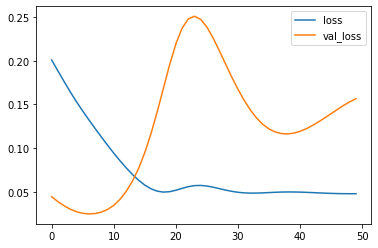

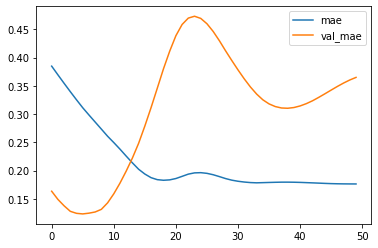

Test MSE: 3628645.468
bestmse=727786.0035139363
Test MAE: 1756.091
bestmae=725.95265
Test MAPE: 94.732
bestmape=39.33572


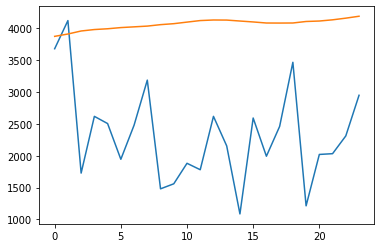

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3875.44899046 3912.34159744 3959.7733916  3982.49304426 3994.62645209
 4013.15969741 4024.79699159 4036.5189321  4059.29453743 4074.60318744
 4099.22006595 4123.45044065 4132.400859   4131.03848326 4116.22623384
 4101.7135464  4085.11540258 4084.29820669 4085.30937183 4109.06773555
 4116.19323611 4135.16004288 4161.29252136 4191.31672311]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 52,289
Traina




 24%|██▍       | 31/128 [02:32<08:17,  5.13s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


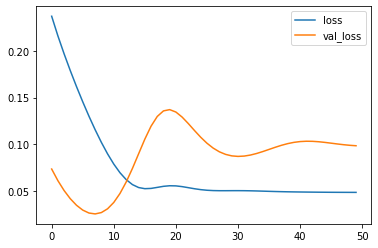

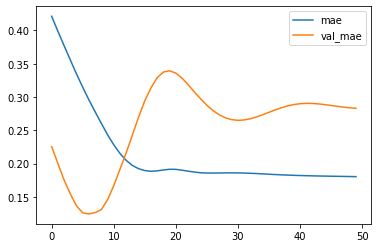

Test MSE: 2279058.504
bestmse=727786.0035139363
Test MAE: 1362.642
bestmae=725.95265
Test MAPE: 74.857
bestmape=39.33572


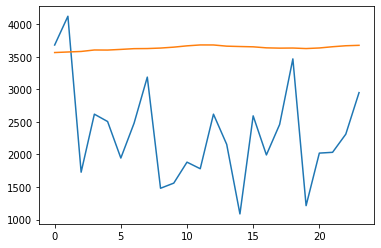

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3565.57967079 3573.977162   3582.21798575 3604.7892921  3603.55948114
 3613.71560776 3625.19307816 3626.8068105  3634.33746576 3648.43667734
 3668.3354547  3682.24614882 3681.84587204 3663.53299415 3657.97187281
 3653.33927882 3637.60682321 3633.11482823 3634.73774254 3626.74253666
 3635.63757622 3654.67726493 3669.81117046 3676.3183223 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainab




 25%|██▌       | 32/128 [02:36<07:52,  4.93s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


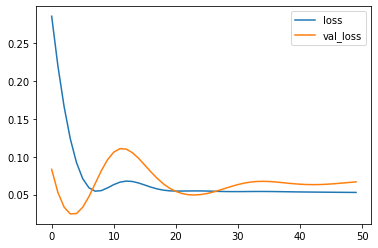

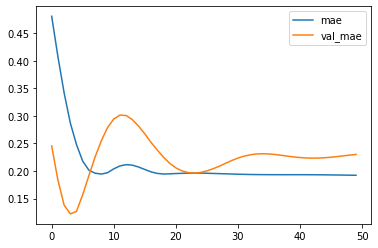

Test MSE: 1548751.222
bestmse=727786.0035139363
Test MAE: 1107.099
bestmae=725.95265
Test MAPE: 61.417
bestmape=39.33572


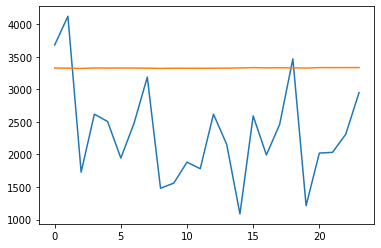

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3327.78456116 3326.02147824 3321.46133578 3328.37679863 3326.755319
 3327.50436741 3327.68714613 3325.52522111 3321.98743433 3324.73471034
 3324.13013458 3323.59528446 3325.05277973 3325.57916522 3328.68310362
 3333.92773372 3329.97647107 3331.24387074 3330.22467136 3327.00854069
 3334.47420478 3333.93548101 3334.60303938 3334.16976488]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,361
Trainabl




 26%|██▌       | 33/128 [02:41<07:49,  4.94s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


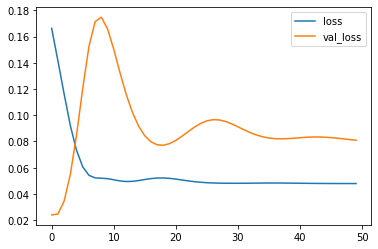

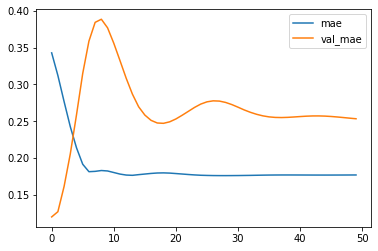

Test MSE: 1874853.873
bestmse=727786.0035139363
Test MAE: 1218.771
bestmae=725.95265
Test MAPE: 67.488
bestmape=39.33572


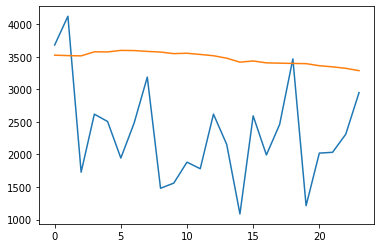

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3525.22545874 3518.40238953 3514.37924922 3576.5811131  3574.68446112
 3598.62388194 3596.02021778 3582.69401383 3573.1028657  3548.85556173
 3554.78281438 3536.06133854 3516.61879063 3478.67111719 3418.09388924
 3436.01997638 3406.98886275 3402.26674449 3398.48233557 3394.79318964
 3363.41364211 3345.59070873 3323.29070109 3287.08631194]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,161
Trainab




 27%|██▋       | 34/128 [02:46<07:29,  4.78s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


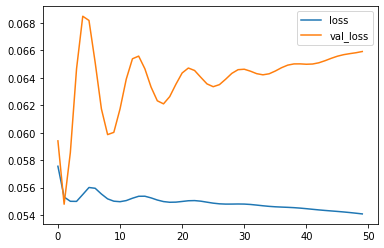

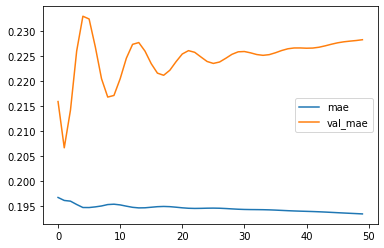

Test MSE: 1527709.493
bestmse=727786.0035139363
Test MAE: 1098.705
bestmae=725.95265
Test MAPE: 60.972
bestmape=39.33572


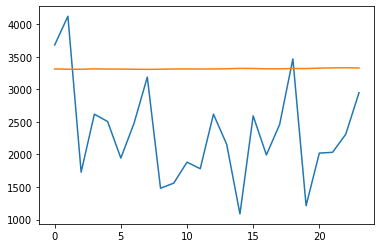

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3314.05133742 3309.99878609 3308.57471895 3315.2020973  3311.17780924
 3311.34738886 3309.15490508 3307.19139683 3309.43380761 3313.17818886
 3313.70572209 3312.6426214  3313.13572222 3316.30967319 3322.19646776
 3320.21100885 3315.66636097 3315.01917511 3320.75231504 3319.3137576
 3326.23538959 3330.29511434 3331.32995176 3328.39430177]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainabl




 27%|██▋       | 35/128 [02:51<07:20,  4.74s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


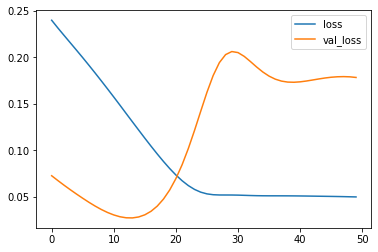

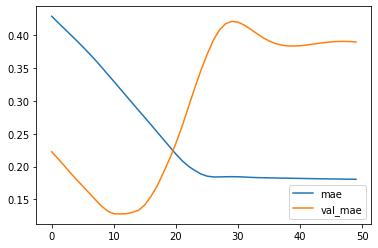

Test MSE: 4130889.223
bestmse=727786.0035139363
Test MAE: 1877.471
bestmae=725.95265
Test MAPE: 100.963
bestmape=39.33572


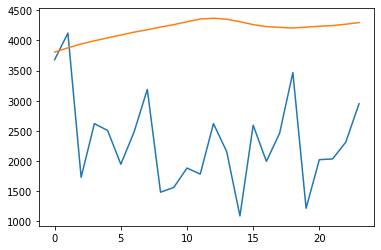

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3807.9089551  3877.46271265 3942.56665492 3994.45974183 4043.14114559
 4090.2283287  4138.26498556 4178.47171211 4222.99109817 4263.16511393
 4309.9920454  4356.67407382 4369.1661526  4352.167732   4311.87836766
 4263.07960677 4229.86552906 4218.0698458  4206.95248103 4221.51480854
 4235.96264827 4246.99967074 4269.8840251  4297.35018563]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,361
Traina




 28%|██▊       | 36/128 [02:56<07:28,  4.88s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


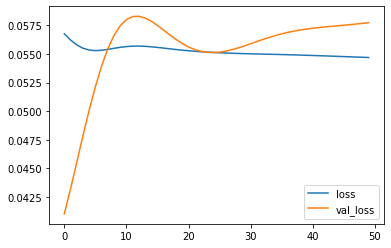

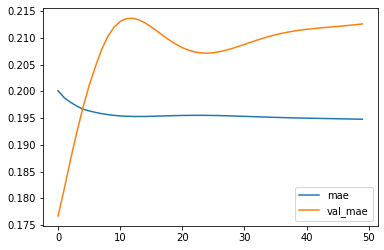

Test MSE: 1338208.969
bestmse=727786.0035139363
Test MAE: 1023.497
bestmae=725.95265
Test MAPE: 56.863
bestmape=39.33572


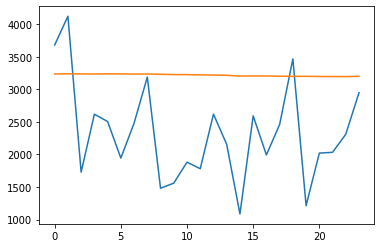

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3236.36650944 3239.19470161 3237.43850517 3235.40455395 3238.37721878
 3237.48757136 3235.01431996 3236.32805991 3231.80421495 3227.01337534
 3226.32357937 3222.8565225  3220.24453717 3215.74092126 3204.78510189
 3206.26569557 3205.63099146 3202.56449831 3199.54807562 3200.46971649
 3197.45028096 3196.92504323 3196.54298693 3200.3784706 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainab




 29%|██▉       | 37/128 [03:00<07:11,  4.74s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


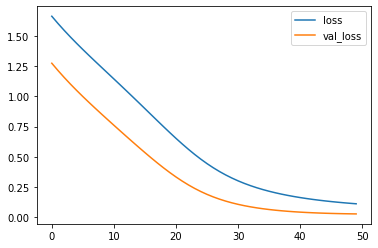

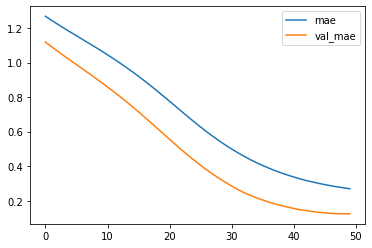

Test MSE: 595602.233
bestmse=595602.2331654079
Test MAE: 593.839
bestmae=593.83903
Test MAPE: 26.356
bestmape=26.35621


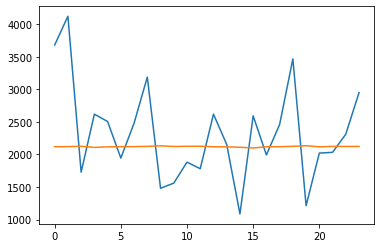

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2118.75184655 2120.59979102 2125.6639379  2109.00087464 2116.57966354
 2120.01257494 2120.54620558 2124.44094169 2132.92558995 2122.61631083
 2125.49113023 2126.57288182 2118.50644389 2116.76911354 2110.90685207
 2099.5662505  2118.58814913 2119.6348227  2125.43890774 2134.48767367
 2117.43380255 2123.23293793 2123.04040337 2122.91974646]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 6,825
Trainab




 30%|██▉       | 38/128 [03:06<07:37,  5.08s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


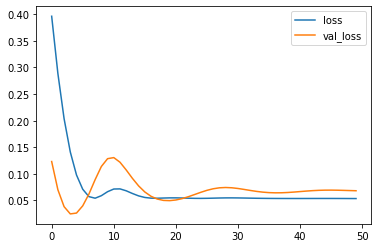

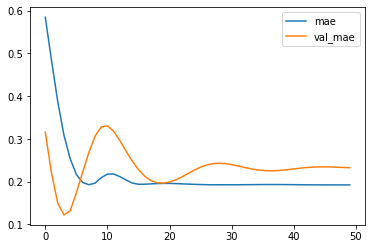

Test MSE: 1583666.781
bestmse=595602.2331654079
Test MAE: 1119.925
bestmae=593.83903
Test MAPE: 62.123
bestmape=26.35621


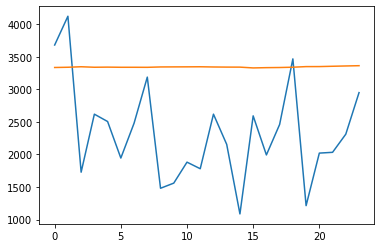

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3335.86957824 3339.56360209 3347.25121176 3339.56589758 3341.55652136
 3339.18283701 3339.1765244  3338.55028492 3344.21685553 3345.1439482
 3345.85569483 3347.02223623 3343.67253649 3341.91619658 3341.39167619
 3329.21465397 3333.42215115 3335.6061703  3340.19916701 3349.4733935
 3349.89734256 3354.78459293 3359.36582524 3363.57102692]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 30,401
Trainabl




 30%|███       | 39/128 [03:11<07:34,  5.11s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


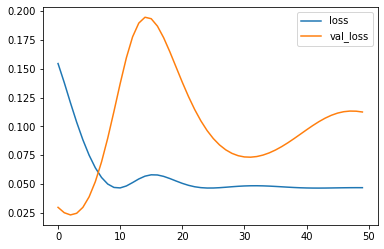

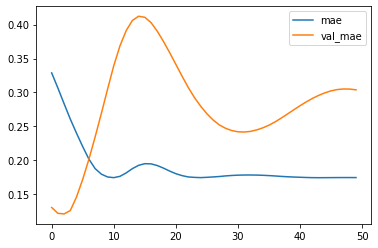

Test MSE: 2608523.312
bestmse=595602.2331654079
Test MAE: 1463.168
bestmae=593.83903
Test MAPE: 80.116
bestmape=26.35621


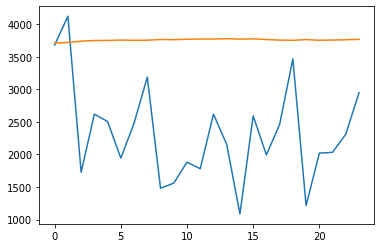

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3711.05402565 3720.64086974 3740.49086785 3749.96896291 3751.37036204
 3757.14955533 3753.31235003 3754.97457469 3765.64001405 3763.37780464
 3768.80923057 3773.09262252 3773.08372748 3778.71744382 3771.68146753
 3776.35337186 3765.39726555 3756.81412625 3753.41679502 3764.52612555
 3754.06125498 3757.56905687 3761.72045791 3768.10164452]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainab




 31%|███▏      | 40/128 [03:15<07:05,  4.84s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


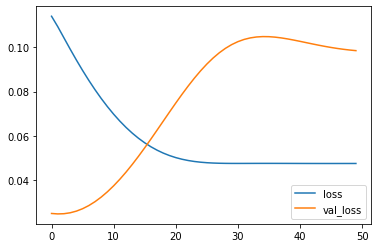

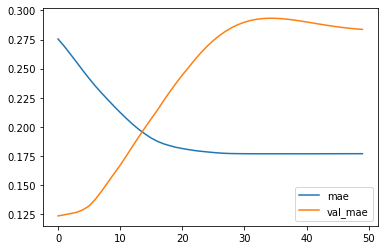

Test MSE: 2283003.726
bestmse=595602.2331654079
Test MAE: 1365.665
bestmae=593.83903
Test MAPE: 74.964
bestmape=26.35621


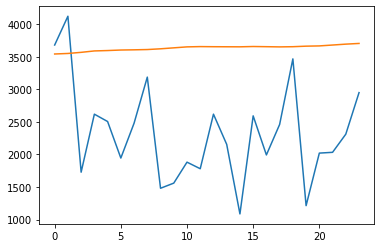

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3543.22213233 3551.29624581 3568.52737212 3590.16010833 3596.13499248
 3604.15487492 3607.28420722 3611.50275147 3622.87635076 3637.69376504
 3652.48162484 3656.72398484 3655.00982463 3654.14442337 3653.46409631
 3658.04963267 3655.35787892 3652.32409656 3655.16591823 3663.38723028
 3667.3168292  3680.87430418 3694.59475923 3705.25618148]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




 32%|███▏      | 41/128 [03:20<06:57,  4.80s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


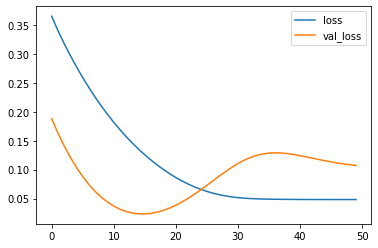

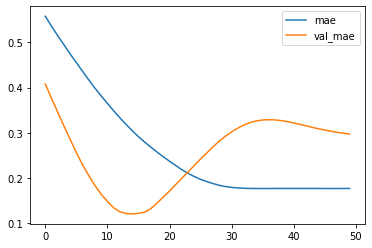

Test MSE: 2485101.150
bestmse=595602.2331654079
Test MAE: 1430.617
bestmae=593.83903
Test MAPE: 78.265
bestmape=26.35621


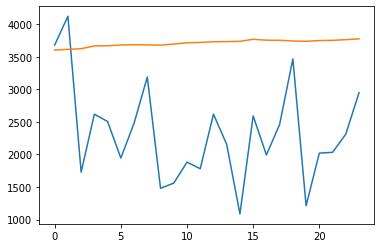

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3604.33334959 3613.90527296 3624.80370498 3666.72573948 3669.94086587
 3681.00744283 3684.97749984 3682.72619402 3679.19199395 3695.80850172
 3714.88807464 3721.11575007 3730.97088003 3733.47755957 3738.03813243
 3768.86719179 3755.18690789 3753.88163257 3742.8001349  3738.3595016
 3749.64931536 3753.09800828 3763.25843894 3776.26528227]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 21,545
Trainab




 33%|███▎      | 42/128 [03:25<06:54,  4.82s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


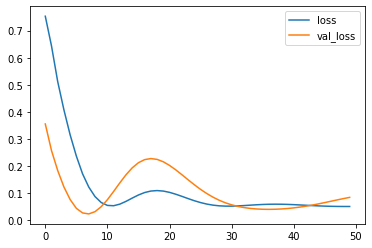

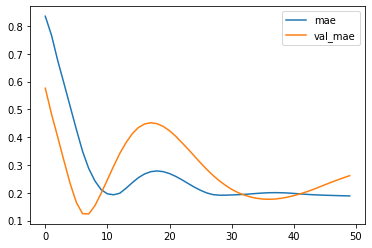

Test MSE: 1969709.775
bestmse=595602.2331654079
Test MAE: 1258.874
bestmae=593.83903
Test MAPE: 69.478
bestmape=26.35621


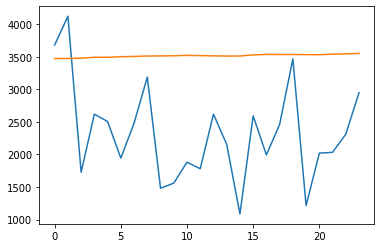

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3472.43196428 3474.09619749 3479.28200555 3492.58152437 3492.83919358
 3501.04816735 3505.52151144 3512.11216187 3513.51872587 3516.0526644
 3522.07001519 3517.85434031 3514.71353054 3511.57501626 3512.13425601
 3529.22564411 3536.48858738 3535.06911123 3535.2593503  3533.93112004
 3532.02815545 3540.50627589 3545.30012834 3552.40152621]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 22,529
Trainab




 34%|███▎      | 43/128 [03:30<06:47,  4.79s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


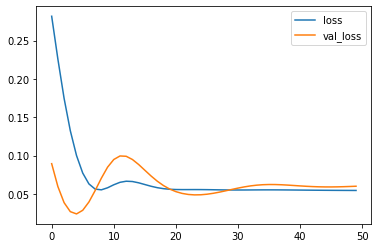

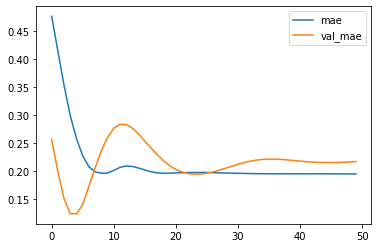

Test MSE: 1388006.847
bestmse=595602.2331654079
Test MAE: 1043.403
bestmae=593.83903
Test MAPE: 57.968
bestmape=26.35621


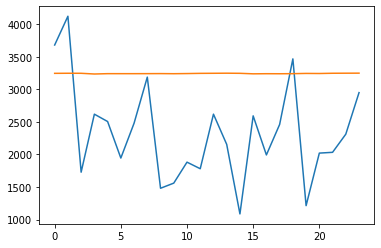

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3246.03670865 3247.31257296 3246.7887699  3235.8498798  3241.12607294
 3241.03941804 3241.04501331 3241.44442928 3242.19534278 3240.48390847
 3242.73148412 3245.83771801 3247.00468981 3248.30709577 3246.49222076
 3238.62957966 3240.43670738 3239.78880417 3241.15376234 3244.81722742
 3243.57350004 3247.39549768 3248.21714109 3248.96963274]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 6,825
Trainab




 34%|███▍      | 44/128 [03:34<06:35,  4.70s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


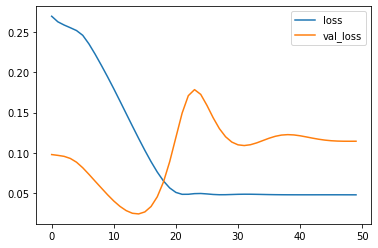

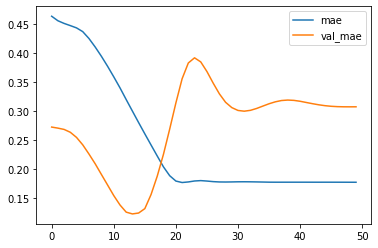

Test MSE: 2654614.875
bestmse=595602.2331654079
Test MAE: 1480.293
bestmae=593.83903
Test MAPE: 80.864
bestmape=26.35621


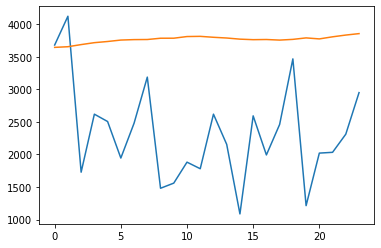

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3644.81869173 3654.90681434 3687.65261126 3717.14626694 3735.13662791
 3757.27609444 3764.07333934 3765.60672939 3785.2217263  3785.70205843
 3811.22049224 3814.14036071 3799.84832764 3788.64201248 3771.24934077
 3763.14050794 3765.68621087 3756.67037094 3767.73838258 3790.42102039
 3774.94279075 3807.01313853 3834.05606735 3856.18290865]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 24,401
Traina




 35%|███▌      | 45/128 [03:40<06:50,  4.94s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


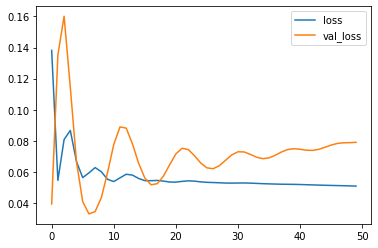

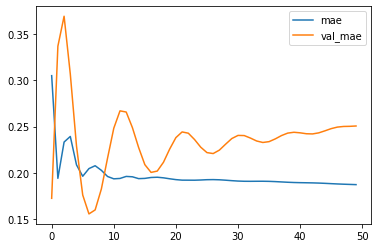

Test MSE: 1830194.599
bestmse=595602.2331654079
Test MAE: 1206.221
bestmae=593.83903
Test MAPE: 66.832
bestmape=26.35621


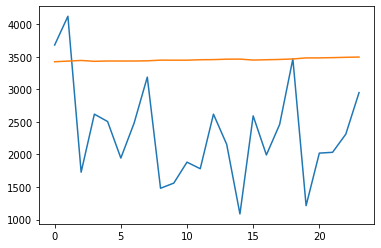

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3424.15657604 3434.20036691 3443.93713546 3430.58109009 3435.54696113
 3435.14137602 3435.42156976 3438.44387466 3448.73672664 3448.06472075
 3448.24405622 3454.84474945 3456.92618871 3463.45141757 3464.61494613
 3450.1039803  3454.87487781 3459.47820425 3467.0102942  3482.9682821
 3483.58318758 3487.18883491 3492.28741419 3496.23709869]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 30,401
Trainab




 36%|███▌      | 46/128 [03:45<06:50,  5.01s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


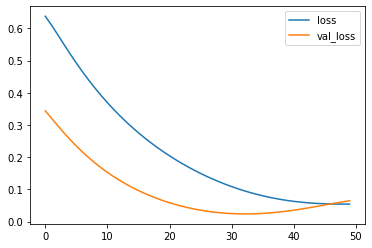

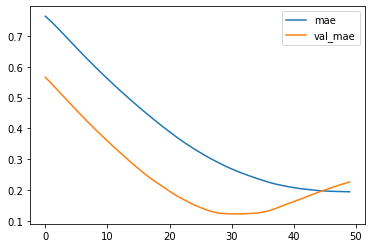

Test MSE: 1503641.037
bestmse=595602.2331654079
Test MAE: 1089.219
bestmae=593.83903
Test MAPE: 60.471
bestmape=26.35621


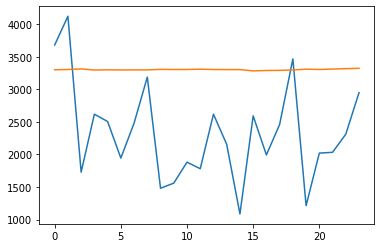

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3300.59099054 3304.95702028 3314.06841016 3296.70557988 3300.63144863
 3298.05762589 3298.91298437 3299.0771122  3307.05208904 3305.03434974
 3305.86675328 3309.50396365 3305.16677105 3303.92175245 3303.26638889
 3283.59945643 3289.5869658  3292.02334583 3298.02175879 3310.28873569
 3305.20823342 3311.71395057 3317.88782537 3323.24464774]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainab




 37%|███▋      | 47/128 [03:49<06:23,  4.73s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


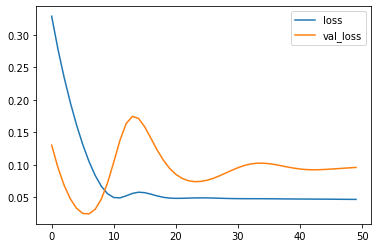

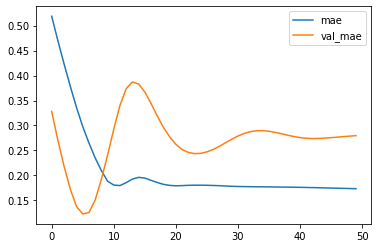

Test MSE: 2226476.487
bestmse=595602.2331654079
Test MAE: 1345.901
bestmae=593.83903
Test MAPE: 73.973
bestmape=26.35621


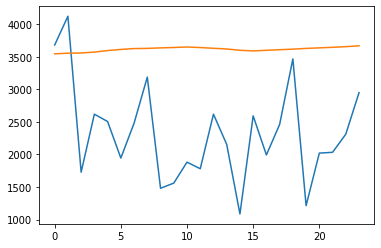

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3546.06653643 3555.01236379 3558.89117491 3572.31751978 3595.84690797
 3613.34086835 3626.61427593 3629.19842839 3636.99536097 3642.91888344
 3650.6501075  3642.19981992 3630.76366842 3620.23337626 3600.18424404
 3590.47229552 3600.3627187  3608.94069314 3617.76572013 3628.91378713
 3637.36579633 3645.83530867 3655.8580097  3669.03185022]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 8,657
Trainab




 38%|███▊      | 48/128 [03:54<06:17,  4.72s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


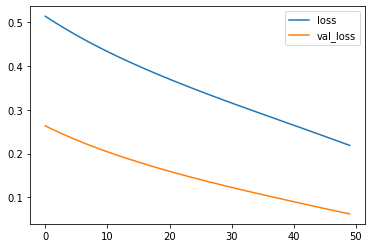

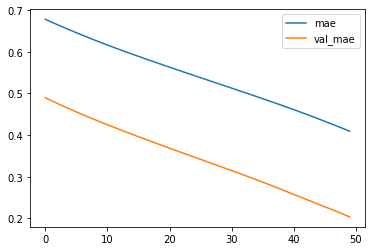

Test MSE: 1433941.270
bestmse=595602.2331654079
Test MAE: 979.008
bestmae=593.83903
Test MAPE: 37.255
bestmape=26.35621


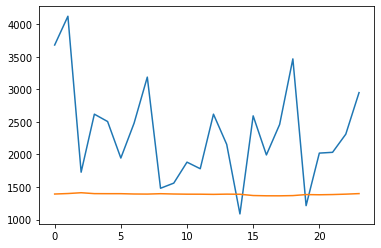

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1392.44862473 1400.03013954 1412.43520474 1398.61618692 1397.74332529
 1397.82625002 1392.86138326 1391.55452979 1397.47633064 1392.69854665
 1390.06066528 1389.77853471 1387.23032108 1390.77893972 1388.84441209
 1369.46111661 1365.32972941 1364.85786191 1368.44607782 1384.008093
 1381.13155198 1384.36217296 1390.58827025 1398.94867489]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 6,825
Trainable




 38%|███▊      | 49/128 [03:58<06:08,  4.67s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


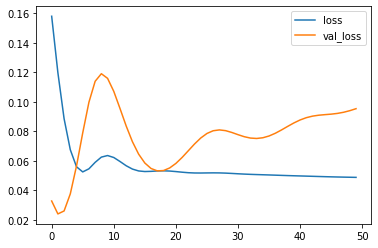

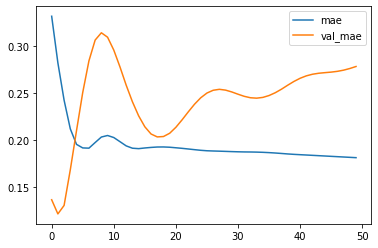

Test MSE: 2209520.593
bestmse=595602.2331654079
Test MAE: 1339.023
bestmae=593.83903
Test MAPE: 73.680
bestmape=26.35621


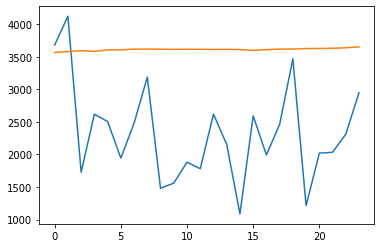

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3566.22929561 3579.49524283 3594.19472611 3583.0739181  3606.43716991
 3608.29766786 3617.99010468 3618.38091254 3617.17003942 3613.87370992
 3616.14940536 3614.95632231 3613.07946897 3614.49808431 3611.63273382
 3598.58227611 3610.80922532 3618.44748187 3618.42280531 3627.24209356
 3627.87364137 3631.42563152 3638.46103394 3653.26840544]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




 39%|███▉      | 50/128 [04:03<06:03,  4.66s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


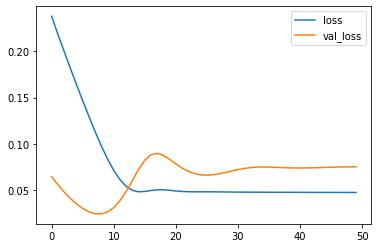

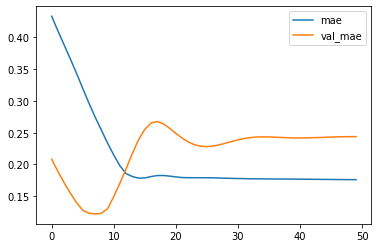

Test MSE: 1737310.521
bestmse=595602.2331654079
Test MAE: 1173.562
bestmae=593.83903
Test MAPE: 65.092
bestmape=26.35621


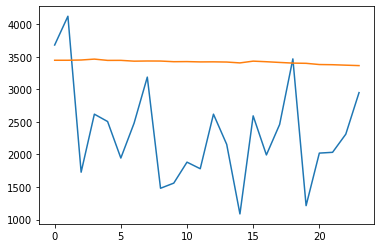

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3446.88139355 3446.974648   3450.826774   3464.70647895 3444.93768394
 3445.48745477 3433.05907595 3435.66073155 3434.88399374 3424.89400351
 3426.45049196 3421.63870597 3422.6716783  3419.565014   3406.3225956
 3433.43496311 3424.40793264 3413.46402115 3403.33013213 3399.94198287
 3381.33327317 3378.54668683 3371.56020713 3364.88290179]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,161
Trainabl




 40%|███▉      | 51/128 [04:08<05:59,  4.67s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


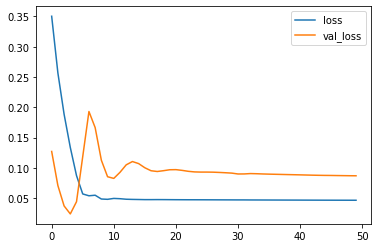

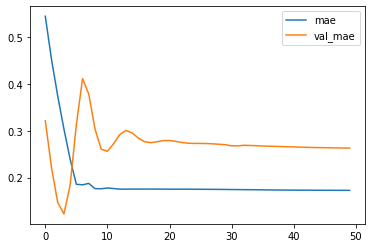

Test MSE: 2011282.427
bestmse=595602.2331654079
Test MAE: 1265.508
bestmae=593.83903
Test MAPE: 70.034
bestmape=26.35621


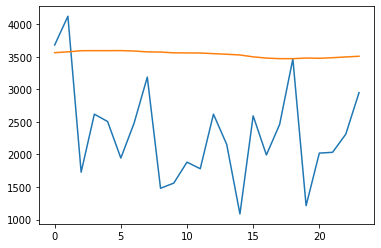

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3563.88703084 3575.77309918 3593.71841109 3594.66071141 3594.45698631
 3595.38953078 3588.94808745 3575.68960059 3572.88565457 3561.00618577
 3559.79445183 3558.32017076 3548.43491244 3539.2426064  3527.69856668
 3499.62582183 3480.41167557 3471.4876554  3471.47302163 3481.01596439
 3477.10329473 3486.47579706 3497.76675856 3508.24741066]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 22,529
Traina




 41%|████      | 52/128 [04:14<06:34,  5.19s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


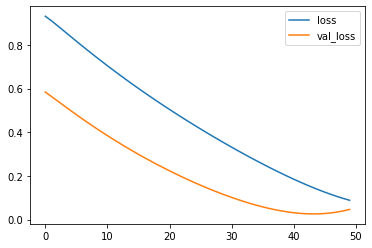

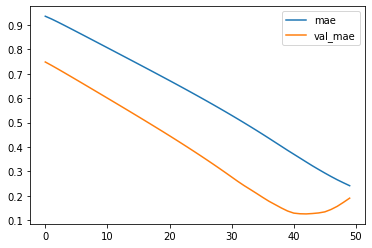

Test MSE: 1086467.014
bestmse=595602.2331654079
Test MAE: 916.352
bestmae=593.83903
Test MAPE: 50.128
bestmape=26.35621


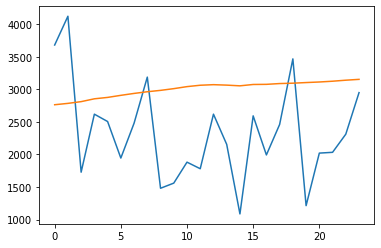

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2763.8846761  2784.7161414  2811.46438617 2854.87763101 2876.38813215
 2908.23266071 2937.63722253 2963.46310908 2984.51164204 3011.03478491
 3042.06398267 3063.27391756 3071.99406916 3065.08520585 3054.18777812
 3075.0011664  3077.07600611 3089.18846756 3094.77813911 3104.45249891
 3113.20335275 3125.18640572 3140.78213596 3153.65684491]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 31,649
Traina




 41%|████▏     | 53/128 [04:19<06:30,  5.21s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


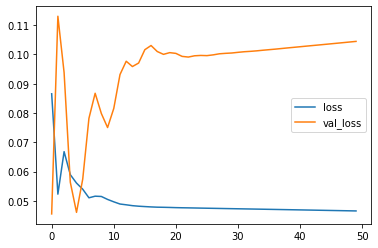

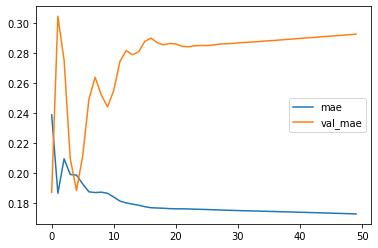

Test MSE: 2421084.287
bestmse=595602.2331654079
Test MAE: 1409.230
bestmae=593.83903
Test MAPE: 77.229
bestmape=26.35621


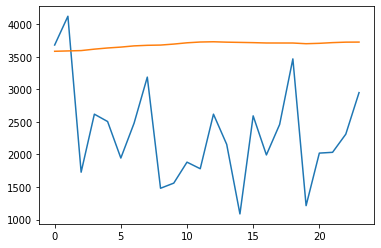

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3584.87502015 3590.28148258 3595.52180862 3617.65065849 3635.56756365
 3649.16520977 3667.82212484 3676.54041135 3680.33428919 3695.54882395
 3715.14717853 3727.19163597 3730.99268723 3724.88695991 3721.27959096
 3717.59274054 3712.27637625 3711.92660034 3711.7779671  3701.12486601
 3707.15885913 3717.98240066 3725.10101473 3726.09180737]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 52,289
Traina




 42%|████▏     | 54/128 [04:26<07:08,  5.79s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


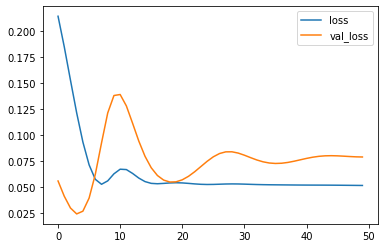

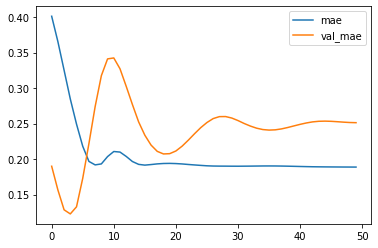

Test MSE: 1831956.304
bestmse=595602.2331654079
Test MAE: 1209.695
bestmae=593.83903
Test MAPE: 66.902
bestmape=26.35621


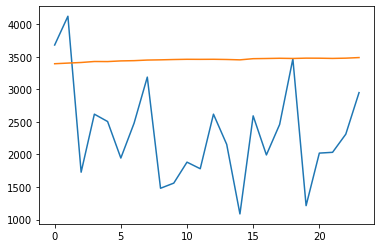

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3393.62420928 3403.50875026 3412.75213104 3427.93725479 3426.86583292
 3437.02827215 3440.82372814 3450.03941953 3453.44392419 3458.20449197
 3461.76308167 3460.85664845 3461.91171491 3458.88883615 3453.20949686
 3471.18924117 3474.03421915 3477.49840665 3474.55730486 3479.43436897
 3478.60426092 3475.27952468 3479.20108938 3488.29296756]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 8,657
Trainab




 43%|████▎     | 55/128 [04:31<06:37,  5.45s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


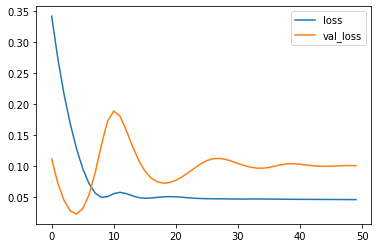

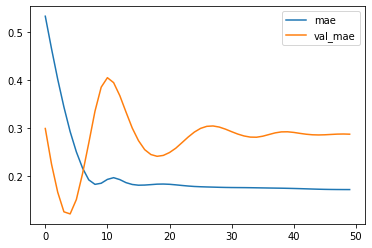

Test MSE: 2343329.622
bestmse=595602.2331654079
Test MAE: 1384.624
bestmae=593.83903
Test MAPE: 75.939
bestmape=26.35621


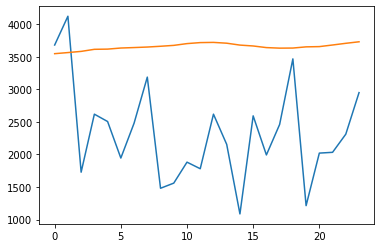

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3548.0825541  3565.07093191 3583.25727069 3614.98415518 3618.13730323
 3634.88924515 3641.99293852 3649.97953629 3661.91438389 3675.54187143
 3702.76901364 3718.21596718 3721.28389502 3709.00644493 3679.95696735
 3666.32460189 3641.47702622 3633.06863141 3634.4797864  3652.78893411
 3656.5676043  3681.39452052 3707.31523967 3730.78207564]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 30,401
Traina




 44%|████▍     | 56/128 [04:36<06:27,  5.38s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


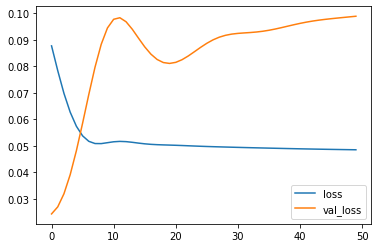

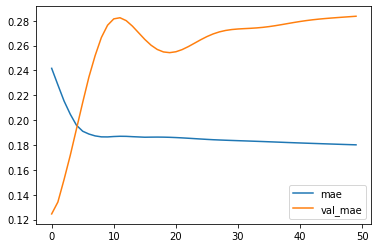

Test MSE: 2292598.017
bestmse=595602.2331654079
Test MAE: 1365.059
bestmae=593.83903
Test MAPE: 75.041
bestmape=26.35621


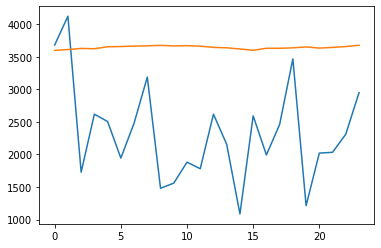

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3598.64396751 3611.34952724 3628.70059311 3623.58738005 3653.94069827
 3657.76326978 3664.95648742 3668.59168923 3675.49337912 3666.87236416
 3671.4834379  3663.54160225 3644.91338086 3638.23004985 3620.30654514
 3600.03962791 3631.25260866 3630.58117664 3638.11154497 3651.47734618
 3633.88783586 3644.48842752 3657.59340322 3677.59404314]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainab




 45%|████▍     | 57/128 [04:41<06:12,  5.24s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


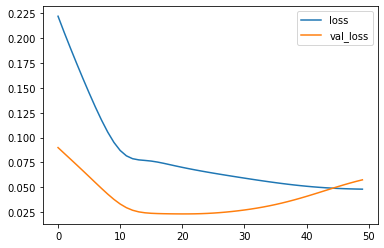

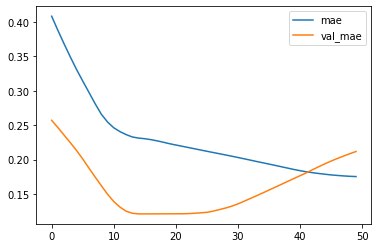

Test MSE: 1331728.925
bestmse=595602.2331654079
Test MAE: 1019.412
bestmae=593.83903
Test MAPE: 56.689
bestmape=26.35621


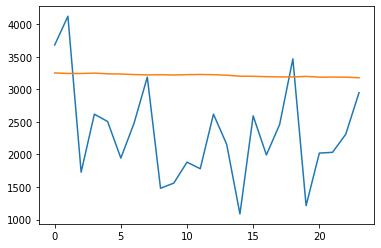

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3252.33353585 3244.45540017 3243.5899989  3249.69486541 3238.79299015
 3235.63682926 3227.49801153 3222.16615266 3224.84642893 3220.29130787
 3226.01210952 3228.61649102 3225.38142252 3217.42308801 3202.21056181
 3200.7550751  3194.85092086 3191.39132434 3191.13480288 3199.04593629
 3187.40921599 3188.46284777 3187.37119687 3178.3609522 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,361
Traina




 45%|████▌     | 58/128 [04:47<06:28,  5.55s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


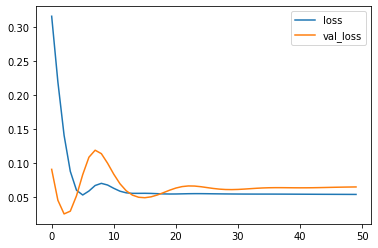

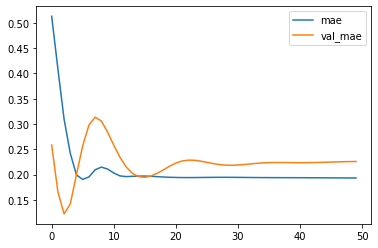

Test MSE: 1497231.452
bestmse=595602.2331654079
Test MAE: 1087.325
bestmae=593.83903
Test MAPE: 60.343
bestmape=26.35621


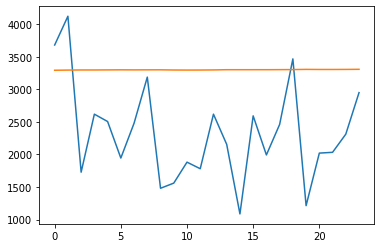

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3293.51742554 3296.18206376 3297.88374221 3297.82233775 3298.91384518
 3300.02342963 3299.20451212 3299.86131036 3300.18181872 3297.34917903
 3296.4196474  3297.03756571 3298.48688328 3301.9074564  3301.8516472
 3301.95365322 3301.96713924 3302.85578239 3303.98358732 3306.76113516
 3305.39918983 3305.35356688 3306.30103207 3307.95780492]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 22,529
Trainab




 46%|████▌     | 59/128 [04:53<06:23,  5.56s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


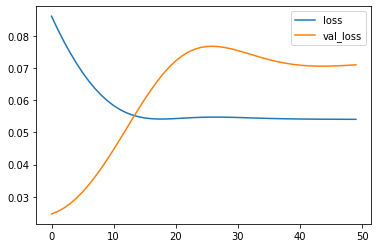

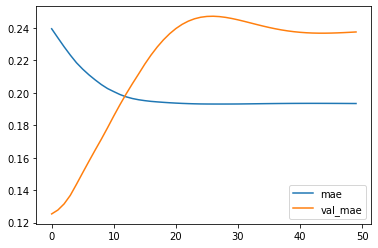

Test MSE: 1645863.129
bestmse=595602.2331654079
Test MAE: 1143.046
bestmae=593.83903
Test MAPE: 63.345
bestmape=26.35621


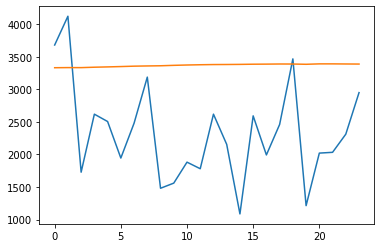

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3332.26350051 3334.28496999 3333.77450949 3340.12485039 3344.87795782
 3350.1934613  3356.25586116 3359.60756946 3362.34193331 3368.89140832
 3374.11595285 3378.04196507 3380.9220928  3381.93110591 3383.59189588
 3386.31879938 3387.57830828 3389.57797056 3389.01141393 3385.10835665
 3391.46228427 3391.48294371 3389.86835057 3388.60353333]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainab




 47%|████▋     | 60/128 [04:57<05:56,  5.25s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


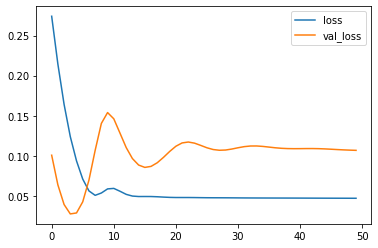

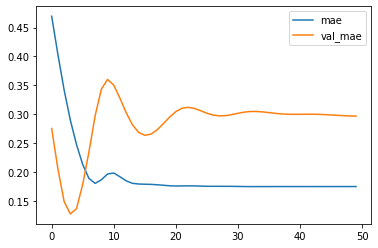

Test MSE: 2476864.873
bestmse=595602.2331654079
Test MAE: 1428.176
bestmae=593.83903
Test MAPE: 78.149
bestmape=26.35621


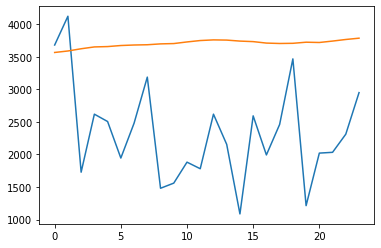

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3566.63703275 3589.36156332 3623.63759398 3651.73214602 3657.10733235
 3673.30950344 3681.28146744 3685.24836814 3698.48533475 3703.44905376
 3728.26191008 3749.80368733 3759.81204152 3756.68385696 3741.38295424
 3733.30625832 3710.75188124 3704.67542148 3707.34077704 3724.23475266
 3719.87618327 3741.66156983 3766.11432052 3786.06417263]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 31,649
Traina




 48%|████▊     | 61/128 [05:03<06:00,  5.37s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


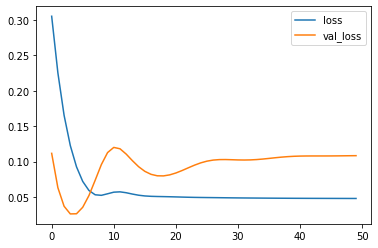

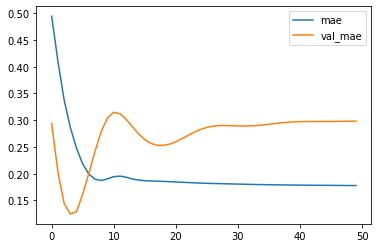

Test MSE: 2511783.593
bestmse=595602.2331654079
Test MAE: 1435.358
bestmae=593.83903
Test MAPE: 78.593
bestmape=26.35621


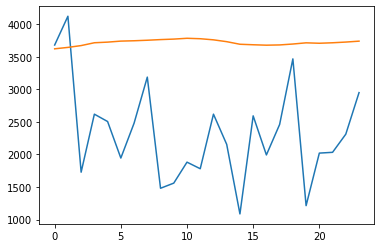

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3622.73718643 3644.55499685 3672.41684318 3715.8229146  3725.50674331
 3741.14020574 3746.41955519 3754.54130018 3764.401595   3772.01173174
 3784.45330966 3777.73038137 3760.73540401 3732.41646743 3692.76352882
 3685.01996648 3678.54609931 3682.33940327 3696.36458516 3714.64159596
 3708.16227698 3715.58188772 3726.45019138 3740.42114222]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 6,825
Trainab




 48%|████▊     | 62/128 [05:08<05:46,  5.25s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


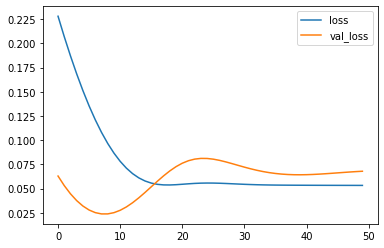

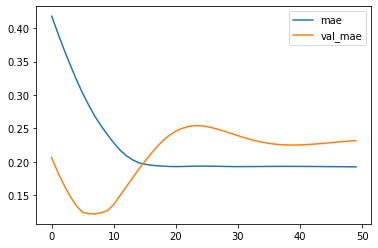

Test MSE: 1572766.357
bestmse=595602.2331654079
Test MAE: 1115.356
bestmae=593.83903
Test MAPE: 61.900
bestmape=26.35621


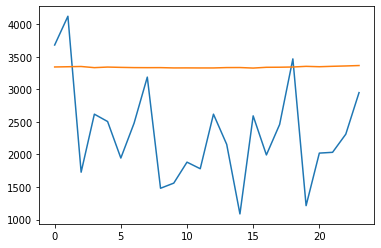

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3343.87497038 3347.35981733 3351.24436718 3333.52645266 3342.42206609
 3337.69492644 3334.13691062 3333.27150935 3333.76891422 3329.15626234
 3329.72611874 3328.83259767 3328.84751838 3334.56688535 3335.1624226
 3327.07467961 3338.87552774 3340.03145248 3343.4415524  3353.46296221
 3347.7905094  3354.20153743 3359.48246503 3365.94715023]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,161
Trainabl




 49%|████▉     | 63/128 [05:13<05:27,  5.04s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


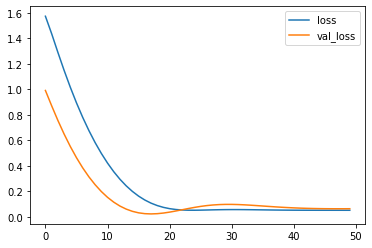

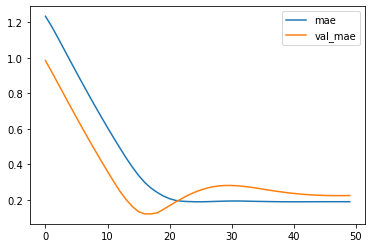

Test MSE: 1490604.278
bestmse=595602.2331654079
Test MAE: 1085.082
bestmae=593.83903
Test MAPE: 60.228
bestmape=26.35621


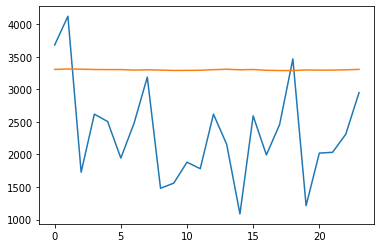

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3305.96746808 3312.67820156 3309.75517678 3305.27164644 3303.56996799
 3303.64543235 3296.16413021 3300.6093545  3296.03529561 3290.73356509
 3291.45879775 3293.53177238 3301.87603682 3309.0368306  3300.72972447
 3304.75544721 3292.63021708 3289.80388999 3289.073349   3298.22691858
 3295.07649642 3296.08780503 3300.03347242 3306.64621699]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainab




 50%|█████     | 64/128 [05:17<05:17,  4.97s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


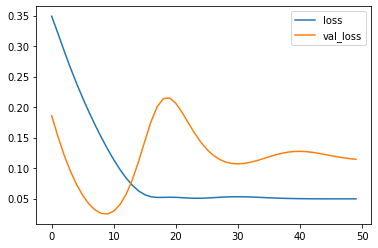

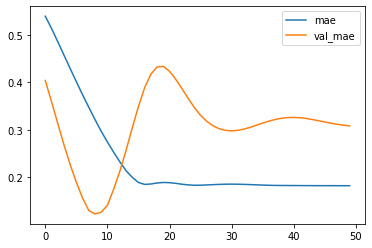

Test MSE: 2650168.733
bestmse=595602.2331654079
Test MAE: 1483.451
bestmae=593.83903
Test MAPE: 80.884
bestmape=26.35621


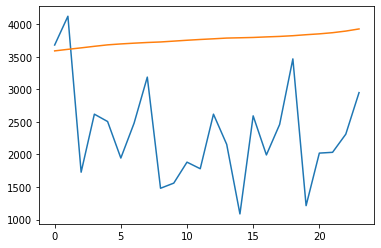

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3590.94143713 3614.84269536 3637.40625441 3661.22028387 3683.54252911
 3697.79553878 3709.53469551 3719.83802068 3727.94455802 3741.01280582
 3754.33470571 3766.15018761 3776.53155959 3787.80157471 3792.20576704
 3797.10808158 3805.72192311 3813.15272439 3824.10223114 3839.33512986
 3852.50466633 3870.28298104 3895.12854815 3927.95640898]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 22,529
Traina




 51%|█████     | 65/128 [05:22<05:12,  4.96s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


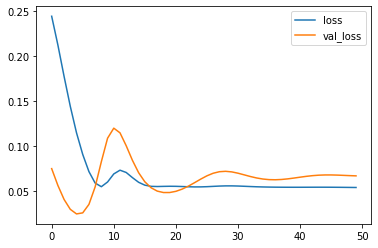

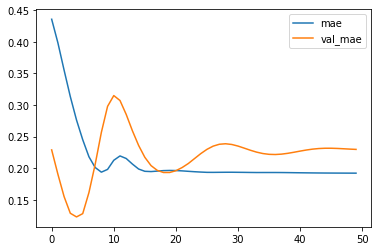

Test MSE: 1544470.595
bestmse=595602.2331654079
Test MAE: 1105.222
bestmae=593.83903
Test MAPE: 61.316
bestmape=26.35621


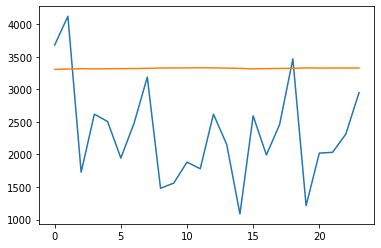

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3306.6806494  3311.6353299  3318.22598034 3313.9239375  3316.94739014
 3317.72627997 3320.03511661 3322.79946536 3328.44652426 3328.74336034
 3329.98421836 3332.09679025 3329.82855517 3326.6573301  3322.23764318
 3314.66495168 3318.85279369 3321.30323362 3323.08812374 3329.91951412
 3327.13723183 3327.67308623 3327.21327007 3328.30635566]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




 52%|█████▏    | 66/128 [05:27<05:01,  4.86s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


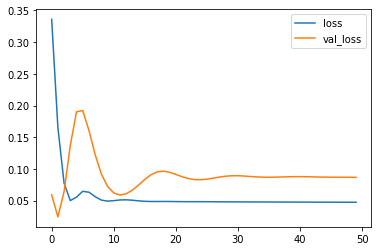

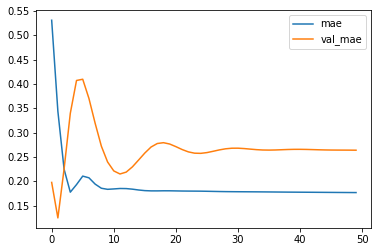

Test MSE: 2010769.970
bestmse=595602.2331654079
Test MAE: 1270.319
bestmae=593.83903
Test MAPE: 70.143
bestmape=26.35621


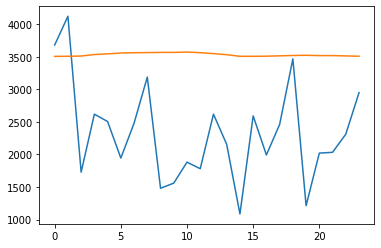

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3506.34559381 3508.0861522  3511.78706253 3534.87342036 3545.08349109
 3558.11185467 3562.72465003 3564.75386679 3567.76957214 3567.78850996
 3573.010759   3563.24400556 3549.13675976 3532.11739278 3507.79462445
 3507.73551548 3509.46918738 3514.93447185 3520.56675351 3523.46022379
 3518.56795204 3518.47842777 3513.70953882 3508.98082101]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 24,401
Traina




 52%|█████▏    | 67/128 [05:32<05:06,  5.03s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


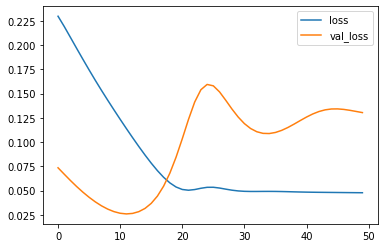

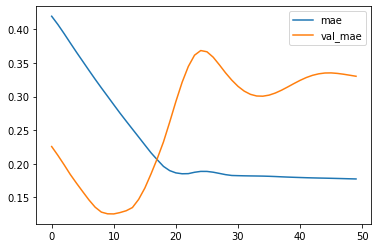

Test MSE: 3021862.954
bestmse=595602.2331654079
Test MAE: 1589.348
bestmae=593.83903
Test MAPE: 86.299
bestmape=26.35621


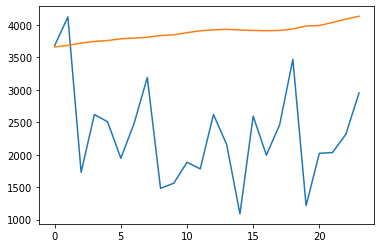

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3658.53053868 3685.47390044 3718.75512135 3744.16939712 3758.63703549
 3784.72561264 3796.49633241 3809.45066631 3835.11486399 3846.17656302
 3879.45520151 3908.4587692  3922.90373957 3931.39046812 3920.9330579
 3913.1702708  3910.17465103 3914.0023874  3936.09709179 3982.41930151
 3990.45553935 4036.7975477  4087.84359729 4132.74001825]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 24,401
Trainab




 53%|█████▎    | 68/128 [05:38<05:02,  5.03s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


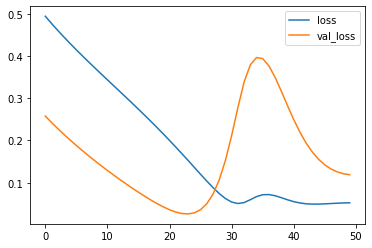

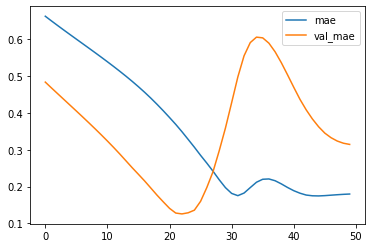

Test MSE: 2754145.646
bestmse=595602.2331654079
Test MAE: 1514.433
bestmae=593.83903
Test MAPE: 82.492
bestmape=26.35621


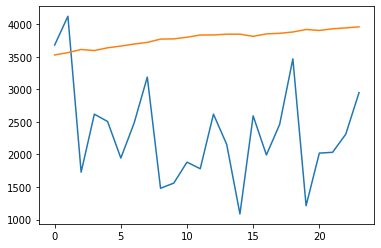

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3528.60901701 3563.777421   3612.2507956  3596.27013969 3638.41225469
 3664.70340919 3696.19357085 3721.52664351 3772.20828342 3775.14077711
 3800.86465764 3834.85805559 3835.79174781 3847.03450394 3847.84395254
 3814.81667066 3851.54141963 3860.84677875 3881.05229151 3919.55863082
 3904.94752407 3930.46107996 3944.4742105  3959.97883832]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 21,545
Traina




 54%|█████▍    | 69/128 [05:42<04:54,  4.99s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


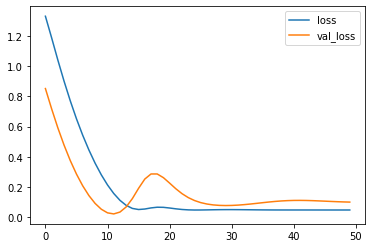

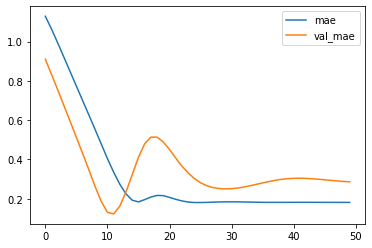

Test MSE: 2347732.503
bestmse=595602.2331654079
Test MAE: 1378.512
bestmae=593.83903
Test MAPE: 75.823
bestmape=26.35621


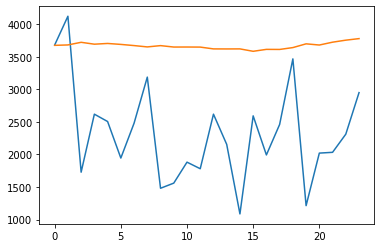

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3676.02507293 3682.25332224 3722.67439055 3693.86220968 3705.06221223
 3690.42126405 3672.42401659 3651.86958873 3671.78701699 3649.90005481
 3650.29401898 3649.20107687 3621.48700297 3620.73408091 3621.60206461
 3584.64346218 3614.18589711 3613.11074507 3641.60471308 3699.2592032
 3680.85307086 3724.58309388 3755.63452923 3779.37108576]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainabl




 55%|█████▍    | 70/128 [05:47<04:43,  4.89s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


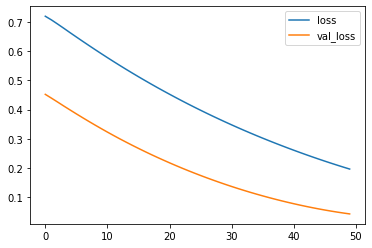

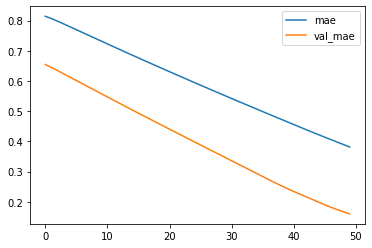

Test MSE: 1001509.384
bestmse=595602.2331654079
Test MAE: 771.078
bestmae=593.83903
Test MAPE: 29.705
bestmape=26.35621


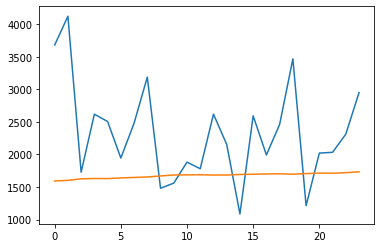

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1592.52489299 1602.49508458 1625.91235223 1630.96172187 1629.80328643
 1639.94843772 1647.00026727 1654.51815385 1670.06101599 1684.77628079
 1686.79136592 1688.04965535 1683.92336127 1684.34551698 1692.91244435
 1696.75818601 1700.39561158 1703.31533659 1697.23794428 1706.41482747
 1714.19648066 1711.87889245 1720.62644652 1733.60710686]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




 55%|█████▌    | 71/128 [05:52<04:34,  4.82s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


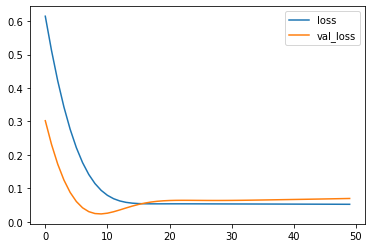

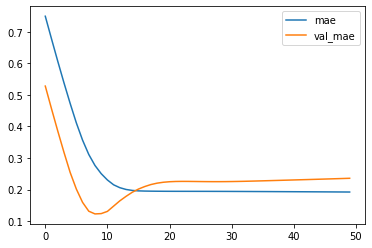

Test MSE: 1623188.044
bestmse=595602.2331654079
Test MAE: 1133.941
bestmae=593.83903
Test MAPE: 62.914
bestmape=26.35621


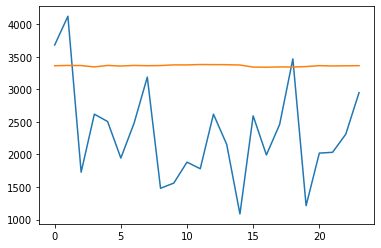

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3362.70117813 3367.10120988 3365.60139143 3344.58370417 3367.35572278
 3358.31104571 3367.41899234 3363.51464385 3365.74285126 3375.64360416
 3375.29626721 3381.52379918 3380.0178116  3378.83290625 3373.8466627
 3342.04646587 3339.89128387 3344.73190701 3342.93869573 3350.16950208
 3363.99110234 3359.29179555 3361.7657643  3363.74333245]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainabl




 56%|█████▋    | 72/128 [05:58<04:47,  5.13s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


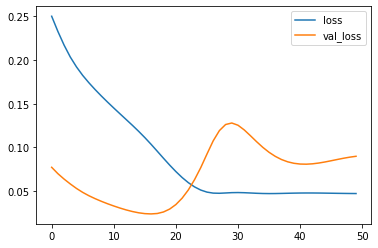

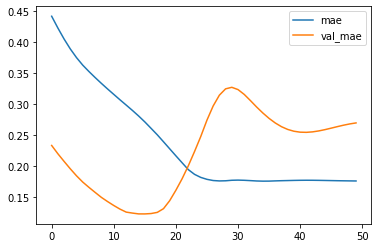

Test MSE: 2084349.487
bestmse=595602.2331654079
Test MAE: 1297.959
bestmae=593.83903
Test MAPE: 71.531
bestmape=26.35621


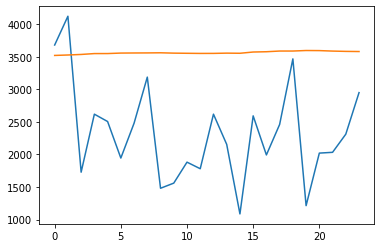

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3521.07118833 3527.78981256 3536.23235285 3549.61192703 3549.97748446
 3557.3517592  3558.74598491 3559.70263207 3561.64634168 3556.37703502
 3554.09789634 3552.01416159 3552.46063519 3556.38047826 3554.3902849
 3573.46784925 3577.88437986 3588.61179757 3588.65598583 3596.7002579
 3595.28537273 3587.93577456 3583.29428554 3581.05818737]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainable




 57%|█████▋    | 73/128 [06:02<04:33,  4.97s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


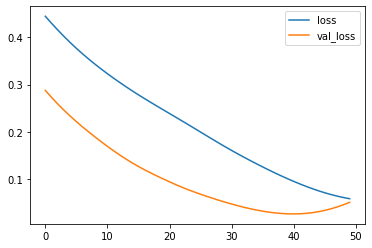

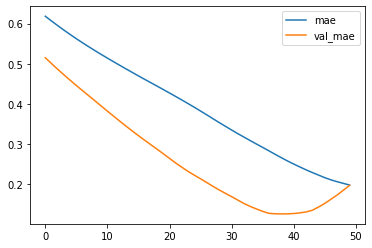

Test MSE: 1161742.145
bestmse=595602.2331654079
Test MAE: 948.374
bestmae=593.83903
Test MAPE: 52.224
bestmape=26.35621


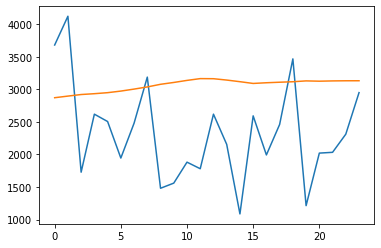

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2871.69571185 2896.57671565 2920.79331738 2933.48553455 2949.13119179
 2973.60001093 3004.12118715 3037.25334442 3077.79133946 3106.06867021
 3137.71822524 3165.05655545 3163.56419736 3142.81666106 3117.77884632
 3090.90621448 3101.51971829 3109.66126192 3117.07671207 3130.05658334
 3125.49629742 3129.82287335 3131.93487138 3132.25279731]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainab




 58%|█████▊    | 74/128 [06:06<04:15,  4.73s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


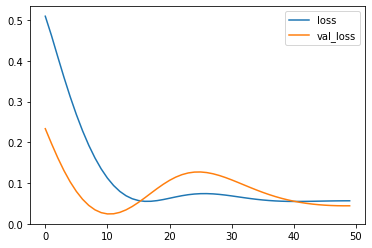

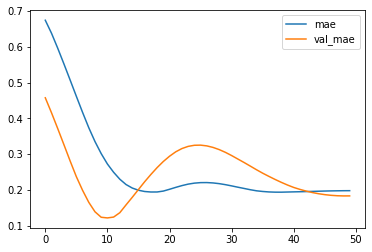

Test MSE: 1018696.205
bestmse=595602.2331654079
Test MAE: 884.835
bestmae=593.83903
Test MAPE: 48.956
bestmape=26.35621


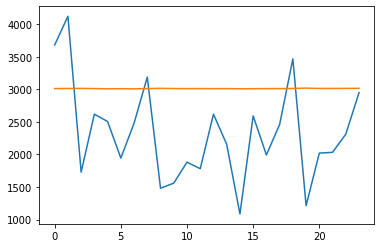

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3011.79115021 3013.9704349  3014.77414477 3011.81023151 3008.6160515
 3010.36622226 3007.75265878 3011.88096142 3015.83781934 3012.41193789
 3011.35887998 3011.73821038 3010.9858622  3011.79832363 3008.71117103
 3010.07670307 3011.87852246 3011.54294991 3014.19252396 3019.28206474
 3013.90415251 3014.26425815 3015.09293151 3015.67598701]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 31,649
Trainab




 59%|█████▊    | 75/128 [06:11<04:14,  4.81s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


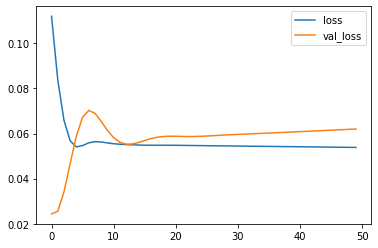

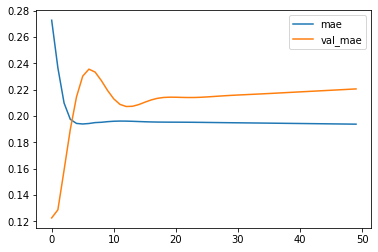

Test MSE: 1437072.414
bestmse=595602.2331654079
Test MAE: 1062.238
bestmae=593.83903
Test MAPE: 59.023
bestmape=26.35621


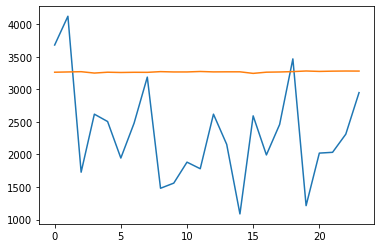

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3263.22020346 3267.39298129 3271.41038287 3250.38121814 3263.41718554
 3259.14713615 3262.15810704 3261.34736723 3272.30462128 3267.31020004
 3267.52253324 3274.63842142 3268.26340395 3269.40483838 3269.38690484
 3245.47373873 3263.79493779 3266.96630633 3272.68237352 3282.18198884
 3275.66952866 3279.74804777 3281.65818578 3280.81287009]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 24,401
Traina




 59%|█████▉    | 76/128 [06:18<04:34,  5.28s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


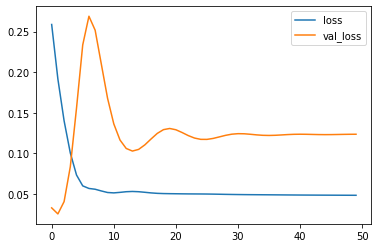

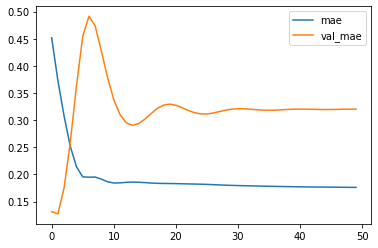

Test MSE: 2859489.440
bestmse=595602.2331654079
Test MAE: 1542.071
bestmae=593.83903
Test MAPE: 83.964
bestmape=26.35621


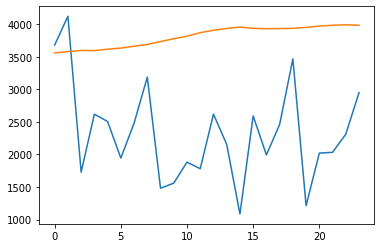

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3559.13650584 3580.84528029 3598.26062    3595.12267959 3617.19356823
 3633.94292772 3662.53416729 3690.00233638 3733.96678674 3778.15619552
 3816.41806471 3870.96244729 3907.64501655 3935.73096049 3957.1350081
 3937.28558385 3931.46650636 3934.08623898 3937.38371623 3951.20029509
 3972.38081896 3984.32599628 3991.90342224 3984.58366549]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainabl




 60%|██████    | 77/128 [06:23<04:26,  5.23s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


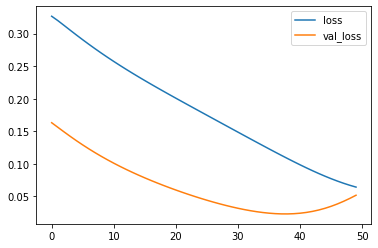

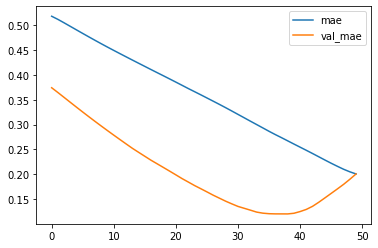

Test MSE: 1201703.815
bestmse=595602.2331654079
Test MAE: 966.715
bestmae=593.83903
Test MAPE: 53.620
bestmape=26.35621


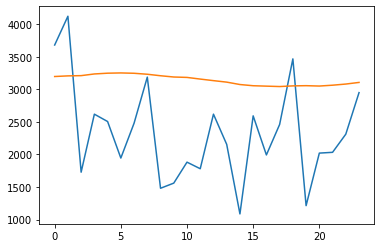

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3197.33292383 3207.04042482 3210.80044413 3236.55961788 3248.33248967
 3252.22880393 3247.09665304 3232.11812377 3209.04639971 3189.74029022
 3183.50759339 3158.05343342 3133.93941158 3111.10785359 3074.25699592
 3055.73178482 3049.44083983 3043.32736522 3053.39238942 3056.58341312
 3050.96375668 3063.94520611 3081.55638015 3106.59706426]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainab




 61%|██████    | 78/128 [06:27<04:12,  5.06s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


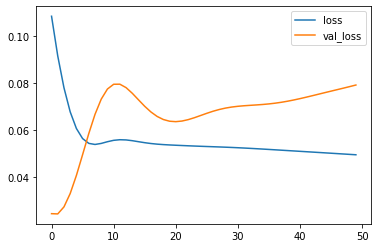

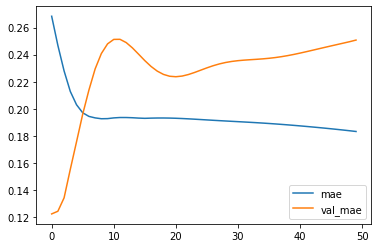

Test MSE: 1832015.239
bestmse=595602.2331654079
Test MAE: 1207.251
bestmae=593.83903
Test MAPE: 66.873
bestmape=26.35621


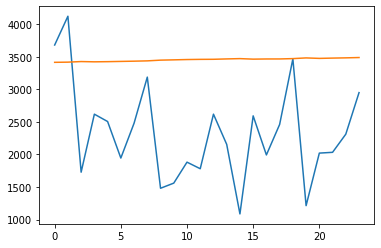

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3415.26354504 3417.97394967 3427.01776594 3423.01456773 3425.41092008
 3429.24970353 3432.97586429 3437.63170016 3448.80501759 3453.24995494
 3457.96633446 3460.7189188  3461.88789916 3467.44069934 3472.17257345
 3464.13346624 3466.75032949 3467.09580135 3472.26381934 3482.86527181
 3475.68668795 3480.19962931 3483.91603422 3488.80514967]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Traina




 62%|██████▏   | 79/128 [06:33<04:09,  5.09s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


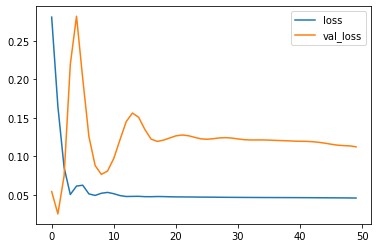

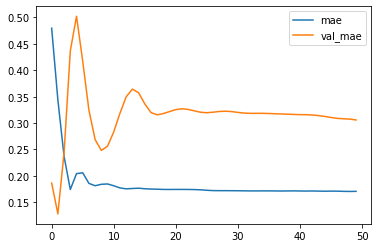

Test MSE: 2608289.678
bestmse=595602.2331654079
Test MAE: 1472.261
bestmae=593.83903
Test MAPE: 80.264
bestmape=26.35621


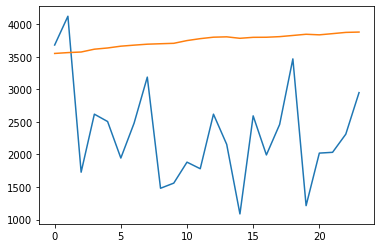

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3551.55104566 3564.58916509 3573.65263653 3616.99615574 3635.61749065
 3663.21449435 3679.19888043 3693.81830835 3700.72717166 3707.24924421
 3749.37930787 3778.87353742 3801.25890875 3806.70152521 3784.23437691
 3799.19296408 3800.44400835 3809.67763329 3827.81519282 3846.22419453
 3837.42212248 3855.84001923 3874.84097147 3880.02764034]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 31,649
Traina




 62%|██████▎   | 80/128 [06:38<04:11,  5.24s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


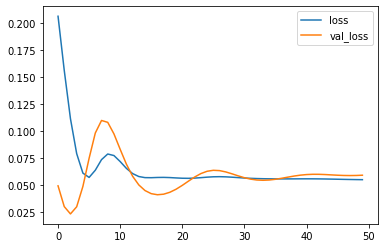

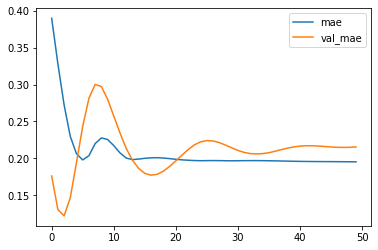

Test MSE: 1375142.275
bestmse=595602.2331654079
Test MAE: 1037.461
bestmae=593.83903
Test MAPE: 57.678
bestmape=26.35621


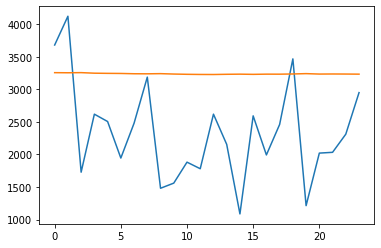

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3256.50903958 3254.84652799 3256.93887085 3248.43492609 3245.86555088
 3244.31508809 3239.76269293 3238.78925997 3241.34055817 3235.23497432
 3231.20896465 3228.94044262 3228.11636025 3231.40867263 3233.45309705
 3230.55933982 3233.65395278 3233.23244268 3236.40969342 3241.63237286
 3234.99222583 3236.20539445 3235.24516058 3233.49011189]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




 63%|██████▎   | 81/128 [06:43<03:58,  5.07s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


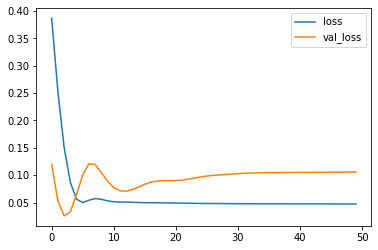

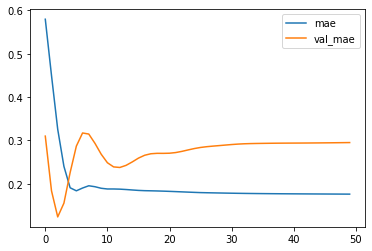

Test MSE: 2451023.671
bestmse=595602.2331654079
Test MAE: 1419.006
bestmae=593.83903
Test MAPE: 77.729
bestmape=26.35621


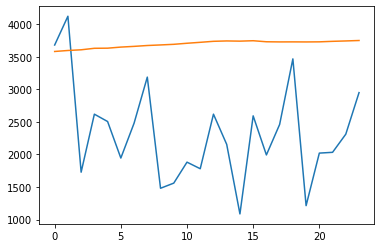

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3581.8842783  3597.06495452 3607.70313489 3630.77887607 3632.53005111
 3649.28457546 3660.25875878 3673.54479158 3682.29320645 3691.87459874
 3708.12382746 3722.61298609 3737.98820543 3743.66840553 3740.61023355
 3746.89960039 3731.03917098 3728.74425077 3729.25585902 3728.38271046
 3729.81395102 3737.66798401 3743.60757494 3750.41428876]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Traina




 64%|██████▍   | 82/128 [06:49<04:09,  5.41s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


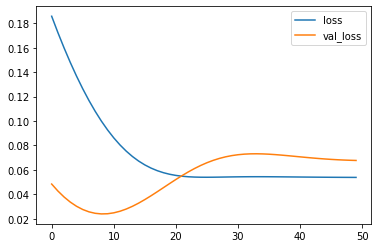

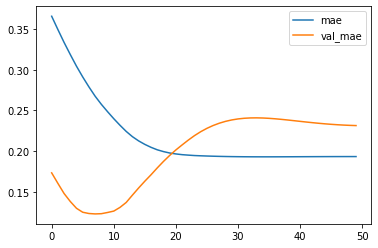

Test MSE: 1569201.949
bestmse=595602.2331654079
Test MAE: 1114.193
bestmae=593.83903
Test MAPE: 61.810
bestmape=26.35621


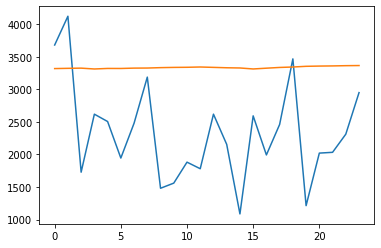

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3319.2579484  3322.95914567 3325.8869049  3313.06011438 3321.32274532
 3320.82089293 3326.25074071 3327.43449831 3333.53333914 3337.18819612
 3339.0258826  3343.41142404 3337.61960554 3331.7041173  3328.41280919
 3313.28478587 3325.2757296  3336.57859898 3343.26135612 3353.97815716
 3357.74377173 3360.00354218 3363.79727656 3365.76810169]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,161
Trainab




 65%|██████▍   | 83/128 [06:54<03:52,  5.16s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


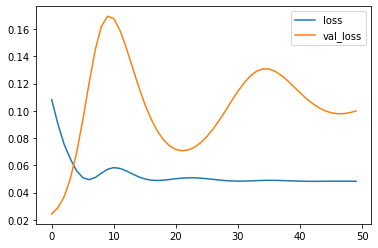

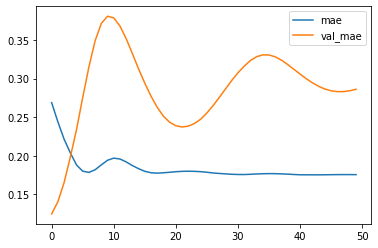

Test MSE: 2314206.715
bestmse=595602.2331654079
Test MAE: 1377.987
bestmae=593.83903
Test MAPE: 75.505
bestmape=26.35621


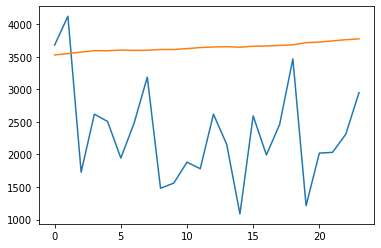

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3528.46497476 3549.71092021 3572.00504565 3594.60475874 3592.97180164
 3603.16121292 3598.69360757 3600.10332787 3612.80085337 3612.35323203
 3626.02863801 3641.86353004 3651.07333922 3655.1773957  3647.41116536
 3662.34794533 3666.06836736 3674.93930423 3684.00507116 3716.8696599
 3726.43928778 3744.90797234 3762.52847183 3775.50719535]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 6,825
Trainabl




 66%|██████▌   | 84/128 [06:58<03:33,  4.85s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


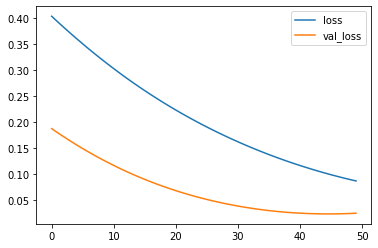

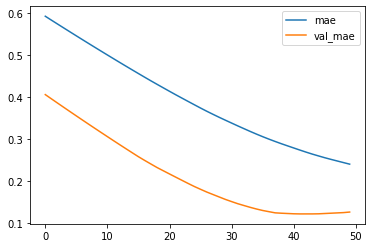

Test MSE: 581130.996
bestmse=581130.9961952495
Test MAE: 609.960
bestmae=593.83903
Test MAPE: 31.716
bestmape=26.35621


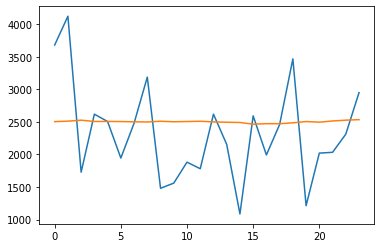

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2504.48767596 2511.7702744  2526.62785983 2506.74113381 2507.06092483
 2505.88979244 2501.39664972 2499.03587753 2510.38752615 2502.31742978
 2506.09236979 2510.21952468 2500.16267818 2495.23755217 2491.3244521
 2465.4271183  2473.03926361 2472.62679201 2485.94969618 2505.68979752
 2496.04771811 2514.70305502 2526.89471102 2534.93396169]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Trainab




 66%|██████▋   | 85/128 [07:03<03:27,  4.82s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


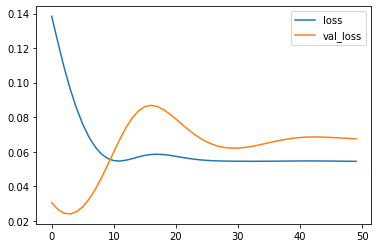

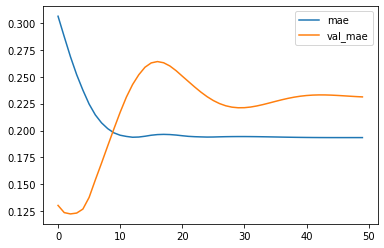

Test MSE: 1563775.830
bestmse=581130.9961952495
Test MAE: 1113.350
bestmae=593.83903
Test MAPE: 61.721
bestmape=26.35621


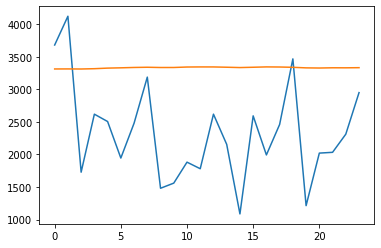

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3313.184358   3313.94560122 3312.71449906 3317.44450808 3326.3419866
 3330.79495817 3336.32437301 3339.49158096 3335.65064549 3335.8688609
 3343.08273798 3344.51613057 3344.2705127  3339.90850008 3334.83416694
 3339.52285707 3344.89632177 3343.27455521 3338.69949204 3330.09841919
 3327.76390171 3331.38619137 3330.98806661 3333.04640746]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainable




 67%|██████▋   | 86/128 [07:07<03:17,  4.71s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


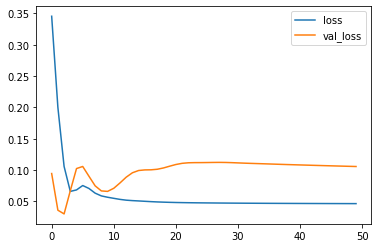

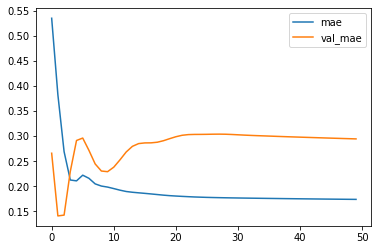

Test MSE: 2449746.555
bestmse=581130.9961952495
Test MAE: 1415.705
bestmae=593.83903
Test MAPE: 77.619
bestmape=26.35621


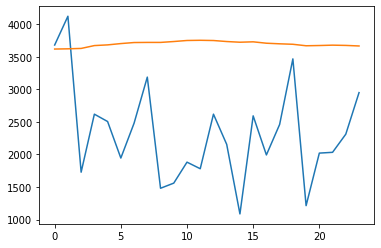

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3619.20499492 3622.64450586 3628.65181386 3672.44151974 3683.09404695
 3703.25020659 3719.17691839 3721.04659832 3720.99839294 3734.73176014
 3750.71643317 3753.70459259 3750.16551459 3734.58456159 3724.00835955
 3730.13445938 3708.75652301 3699.64111602 3692.40629256 3669.58391654
 3673.34336197 3678.94321978 3674.97545826 3666.40465724]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainab




 68%|██████▊   | 87/128 [07:13<03:25,  5.02s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


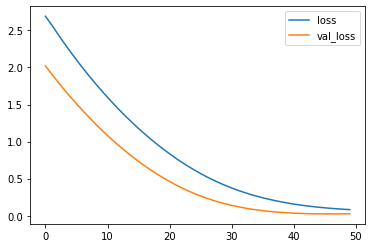

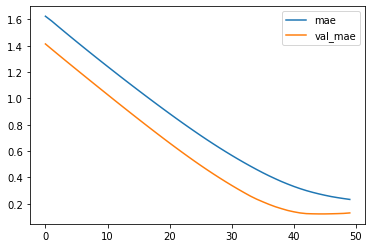

Test MSE: 606023.201
bestmse=581130.9961952495
Test MAE: 628.247
bestmae=593.83903
Test MAPE: 33.023
bestmape=26.35621


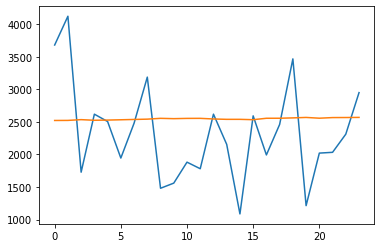

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2522.18120086 2523.20456082 2534.9184671  2525.23765123 2528.28262413
 2532.9416163  2537.79486465 2542.52473021 2555.01594818 2550.04175597
 2554.07336092 2554.84177756 2545.15536642 2539.58018517 2539.64531982
 2534.17888761 2556.00530612 2556.35422122 2561.76355302 2568.78805184
 2557.04918206 2566.59126401 2567.51878709 2569.27641821]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainab




 69%|██████▉   | 88/128 [07:17<03:13,  4.84s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


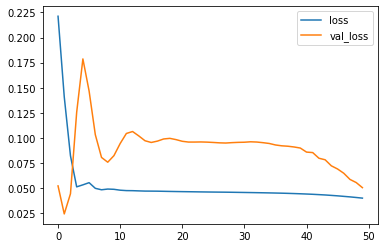

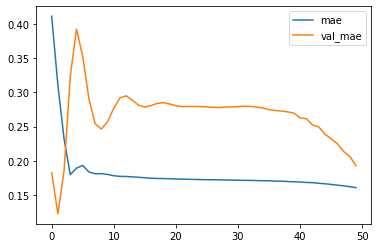

Test MSE: 1174244.749
bestmse=581130.9961952495
Test MAE: 926.815
bestmae=593.83903
Test MAPE: 50.045
bestmape=26.35621


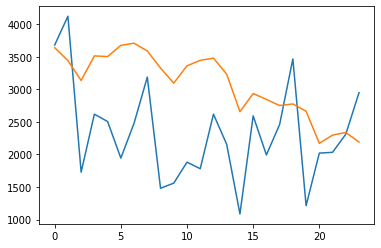

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3640.5510813  3442.25396442 3135.83764172 3513.69633973 3503.54050004
 3676.01359546 3709.18405879 3589.48322451 3326.89390945 3095.64497507
 3361.96346372 3445.09693384 3480.4360652  3233.21207017 2657.37748098
 2935.91933215 2845.12206811 2751.38485003 2776.24820721 2662.96155727
 2171.16414553 2297.32751298 2337.47082651 2191.11155868]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 21,545
Traina




 70%|██████▉   | 89/128 [07:24<03:26,  5.29s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


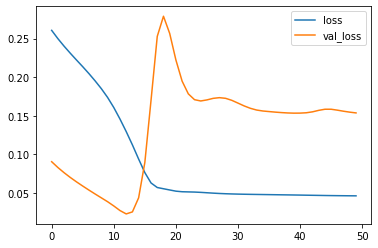

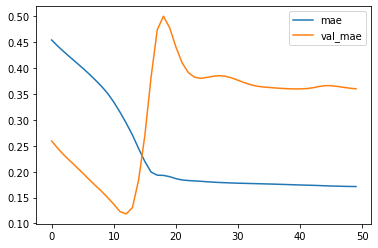

Test MSE: 3559822.109
bestmse=581130.9961952495
Test MAE: 1733.868
bestmae=593.83903
Test MAPE: 93.638
bestmape=26.35621


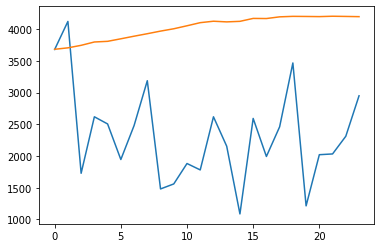

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3683.64152229 3706.58756804 3746.22443819 3798.86470842 3809.20045745
 3849.25912464 3890.11777151 3929.41404772 3970.52003407 4007.45826399
 4054.60455608 4103.65553439 4126.33128572 4115.96684301 4124.54453051
 4170.63891244 4168.70208931 4195.38864267 4203.15028203 4201.45649433
 4199.11623812 4204.93588948 4201.86250985 4198.35470796]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 2,537
Trainab




 70%|███████   | 90/128 [07:29<03:24,  5.39s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


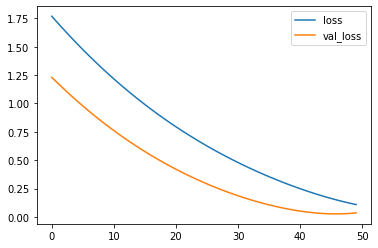

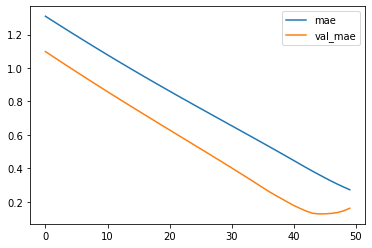

Test MSE: 848277.932
bestmse=581130.9961952495
Test MAE: 774.581
bestmae=593.83903
Test MAPE: 41.893
bestmape=26.35621


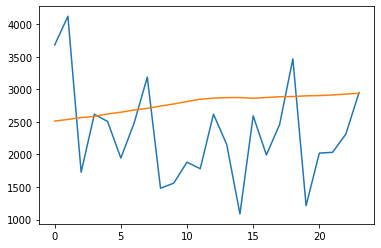

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2512.91629982 2538.01135844 2567.62237126 2585.10413682 2622.62771773
 2648.70539129 2682.17914677 2708.5903843  2743.76725292 2775.81521964
 2812.6230368  2849.07763481 2864.97149235 2873.15449834 2874.09321195
 2863.22060424 2875.20308334 2886.31829607 2889.81591171 2900.51879632
 2904.35958833 2914.26163244 2927.59371859 2939.72468746]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 52,289
Traina




 71%|███████   | 91/128 [07:35<03:20,  5.41s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


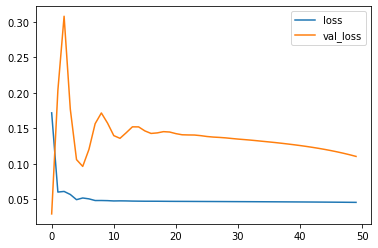

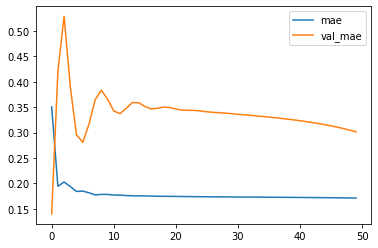

Test MSE: 2558272.200
bestmse=581130.9961952495
Test MAE: 1451.383
bestmae=593.83903
Test MAPE: 79.352
bestmape=26.35621


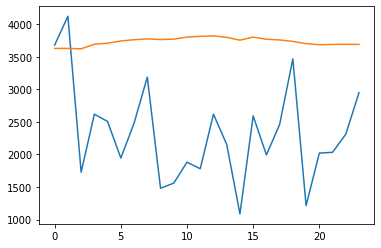

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3629.07791495 3628.80762053 3622.54092169 3692.90871882 3708.48020291
 3743.21791482 3762.51441193 3775.43775666 3765.18550622 3771.09009087
 3803.14121389 3814.25829172 3820.98868036 3799.08019793 3755.5257802
 3802.46662557 3769.76759934 3759.04592037 3736.35180509 3702.22813785
 3685.75280297 3690.05427194 3692.57529831 3690.45540953]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 30,401
Trainab




 72%|███████▏  | 92/128 [07:41<03:24,  5.69s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


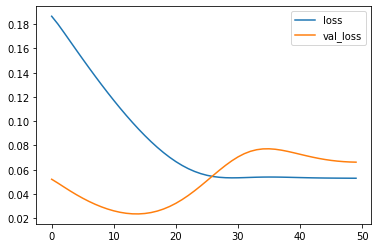

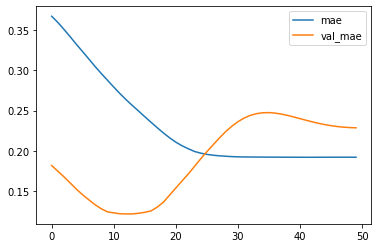

Test MSE: 1535097.417
bestmse=581130.9961952495
Test MAE: 1100.857
bestmae=593.83903
Test MAPE: 61.127
bestmape=26.35621


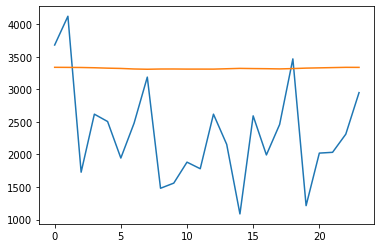

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3338.59978151 3337.49392724 3335.89396787 3331.93337977 3325.66467237
 3321.32690591 3312.94261378 3308.88331944 3312.52454692 3312.82525665
 3311.30420488 3311.26719004 3310.93247831 3316.56074286 3322.15070134
 3319.31734431 3317.3740651  3314.11417657 3319.21576869 3326.36264604
 3330.22997969 3334.29415196 3338.29620242 3337.6833055 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 2,225
Trainab




 73%|███████▎  | 93/128 [07:45<03:04,  5.28s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


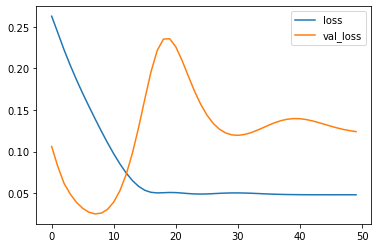

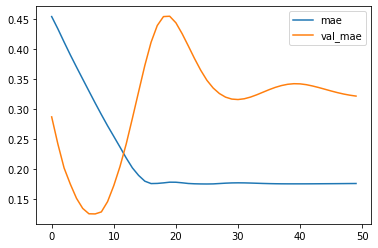

Test MSE: 2876305.937
bestmse=581130.9961952495
Test MAE: 1549.480
bestmae=593.83903
Test MAPE: 84.296
bestmape=26.35621


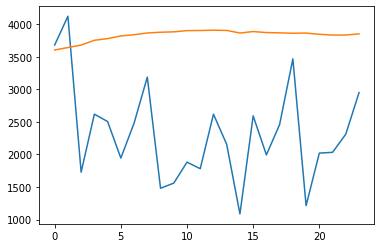

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3604.41397882 3642.36021757 3680.77990198 3753.77603984 3779.40350962
 3820.18755293 3839.23671055 3865.73187709 3877.45553923 3883.22124648
 3902.0526191  3903.96247017 3908.82518744 3905.36099994 3865.29630709
 3887.97578859 3872.33486581 3867.98174822 3861.6854949  3864.58384311
 3845.81330109 3833.81618822 3834.73754215 3852.07024407]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 21,545
Traina




 73%|███████▎  | 94/128 [07:50<02:55,  5.17s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


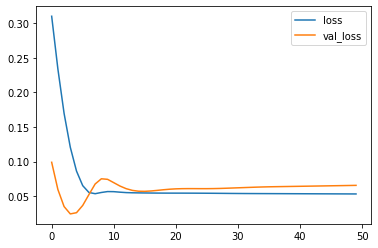

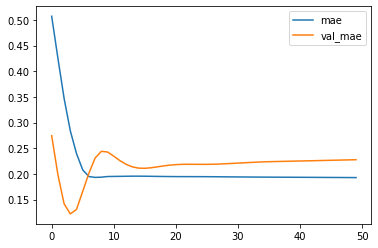

Test MSE: 1519965.886
bestmse=581130.9961952495
Test MAE: 1095.775
bestmae=593.83903
Test MAPE: 60.825
bestmape=26.35621


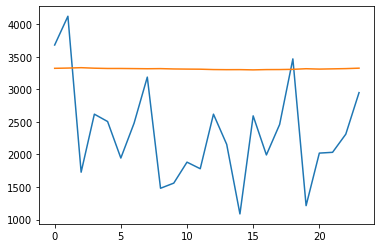

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3323.14751965 3327.03881252 3332.96965188 3325.0556491  3320.80912852
 3320.85288638 3318.81678313 3316.67881733 3318.51119548 3313.36010677
 3311.18656081 3309.71974009 3304.17310905 3302.4292509  3303.07500207
 3299.35443658 3303.67656499 3304.28501439 3307.59956437 3316.94624239
 3311.25169545 3314.96953505 3318.70645595 3325.55836231]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 31,649
Traina




 74%|███████▍  | 95/128 [07:57<03:05,  5.62s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


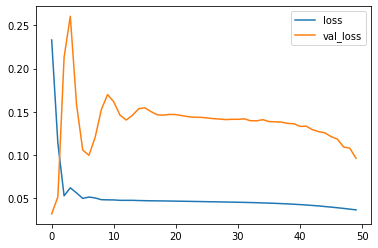

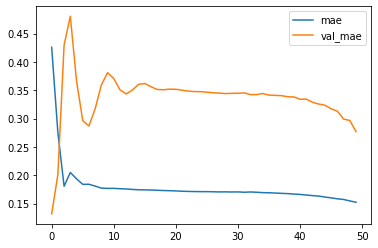

Test MSE: 2231155.079
bestmse=581130.9961952495
Test MAE: 1333.293
bestmae=593.83903
Test MAPE: 72.986
bestmape=26.35621


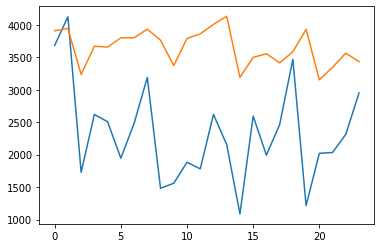

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3907.18190062 3942.95143712 3233.88464993 3669.55149269 3656.11280954
 3799.07560694 3799.12352538 3932.21856761 3762.37381291 3371.9342292
 3789.25232697 3859.49760211 4005.99459958 4130.99314725 3189.71130961
 3498.54349637 3553.0672195  3413.4655993  3584.07790983 3929.14805734
 3151.79562962 3344.91023821 3563.33754694 3430.72455847]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 31,649
Trainab




 75%|███████▌  | 96/128 [08:03<03:09,  5.93s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


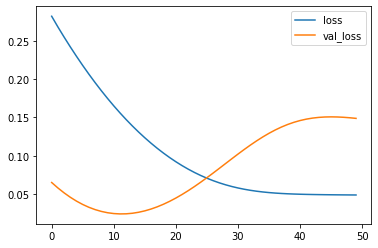

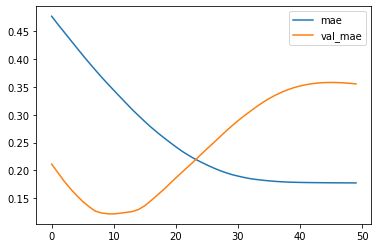

Test MSE: 3448890.904
bestmse=581130.9961952495
Test MAE: 1710.871
bestmae=593.83903
Test MAPE: 92.391
bestmape=26.35621


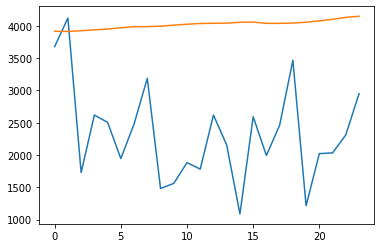

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3917.86972106 3914.39233446 3926.28500235 3939.85567641 3951.73686683
 3971.80120671 3988.39160323 3989.0759474  3997.06914473 4012.18038225
 4026.62104857 4038.34327602 4041.33459175 4043.5026859  4057.07020366
 4059.74847138 4040.46058238 4040.53748143 4045.05960476 4057.58812451
 4078.48257244 4102.88080513 4132.99453115 4150.40441906]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainab




 76%|███████▌  | 97/128 [08:08<02:50,  5.50s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


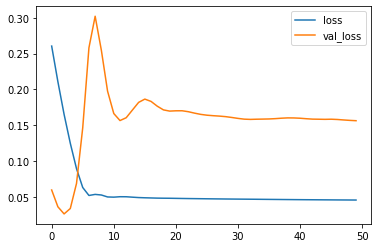

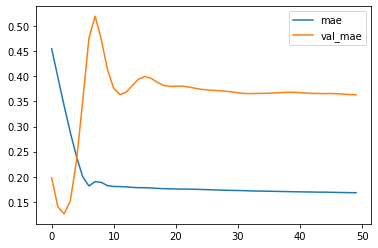

Test MSE: 3618043.021
bestmse=581130.9961952495
Test MAE: 1748.057
bestmae=593.83903
Test MAPE: 94.310
bestmape=26.35621


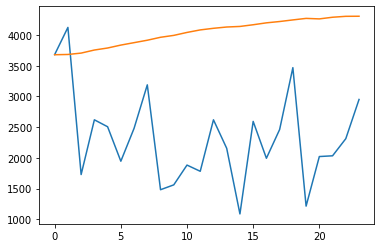

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3678.27551794 3682.63351345 3704.96379292 3754.97400081 3787.85092783
 3835.47956061 3874.93279123 3914.59376407 3962.44563365 3993.26579797
 4041.33057463 4082.37544346 4108.62269664 4129.57166255 4138.78835821
 4166.41003847 4197.53119946 4219.0526042  4245.14261603 4270.01142502
 4261.72612607 4288.64452434 4303.6475867  4304.91957736]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




 77%|███████▋  | 98/128 [08:14<02:48,  5.61s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


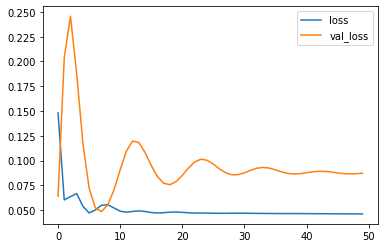

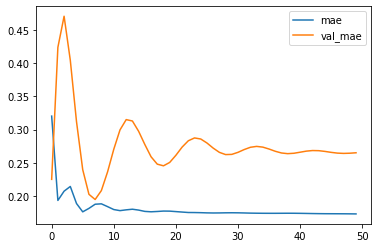

Test MSE: 2020047.611
bestmse=581130.9961952495
Test MAE: 1276.099
bestmae=593.83903
Test MAPE: 70.387
bestmape=26.35621


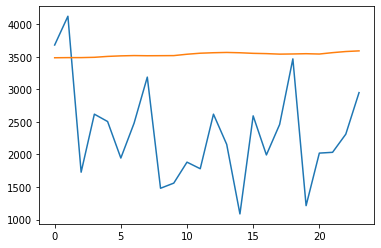

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3485.37769008 3487.41063702 3487.64936841 3492.32988083 3506.13842547
 3514.35457265 3518.94412613 3516.33414936 3517.30715191 3518.49162686
 3539.44145358 3555.24133933 3562.62651765 3567.0152154  3562.13556886
 3553.2382338  3548.93159997 3540.9926337  3543.68151808 3547.66506112
 3542.60780072 3563.92634118 3581.15115488 3590.9529146 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 21,545
Traina




 77%|███████▋  | 99/128 [08:19<02:37,  5.42s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


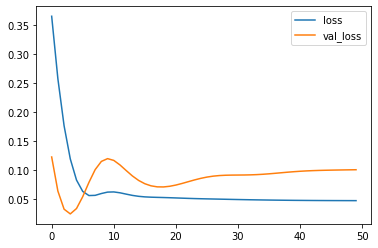

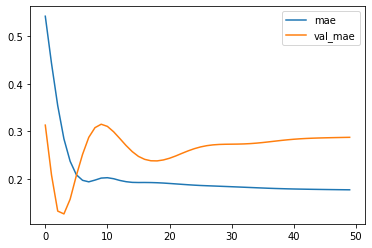

Test MSE: 2336611.961
bestmse=581130.9961952495
Test MAE: 1384.561
bestmae=593.83903
Test MAPE: 75.885
bestmape=26.35621


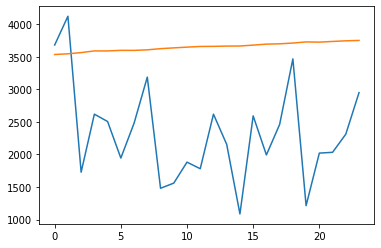

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3535.44987631 3546.13683593 3564.79805505 3590.33341813 3590.34977353
 3599.27408063 3598.64798462 3607.08880329 3624.9560684  3637.09607577
 3648.58961463 3658.8843317  3660.40480959 3664.60929394 3665.87095487
 3679.61981666 3694.56061375 3699.63308179 3711.22389221 3728.7913084
 3725.21292007 3736.03359222 3745.5773958  3751.48628449]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 2,537
Trainabl




 78%|███████▊  | 100/128 [08:24<02:27,  5.25s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


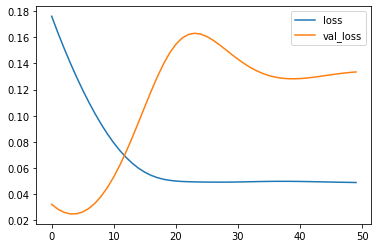

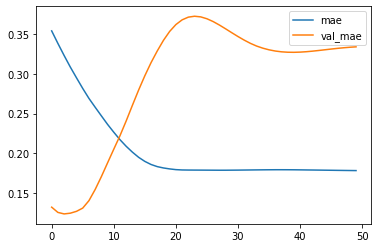

Test MSE: 3092440.573
bestmse=581130.9961952495
Test MAE: 1609.321
bestmae=593.83903
Test MAPE: 87.341
bestmape=26.35621


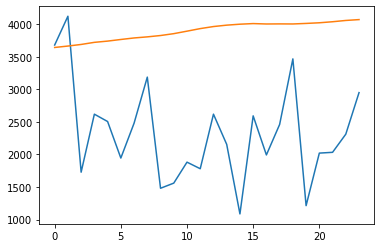

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3643.37712145 3665.19378412 3689.7245816  3722.02132249 3741.17549896
 3766.10628629 3789.47498989 3806.2292273  3826.93027985 3855.58321083
 3893.89299846 3933.17865801 3964.73969305 3986.23642123 4000.87851715
 4010.29377306 4004.13668406 4005.4881562  4004.40382218 4012.70662427
 4022.65787804 4038.58344209 4058.31723082 4071.50742674]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 52,289
Traina




 79%|███████▉  | 101/128 [08:29<02:24,  5.34s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


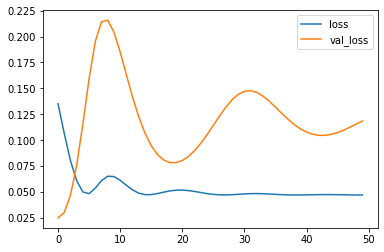

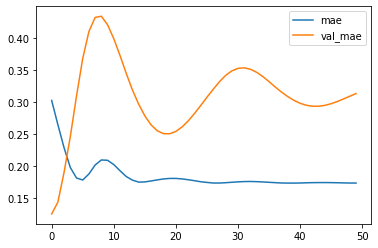

Test MSE: 2744558.166
bestmse=581130.9961952495
Test MAE: 1508.347
bestmae=593.83903
Test MAPE: 82.283
bestmape=26.35621


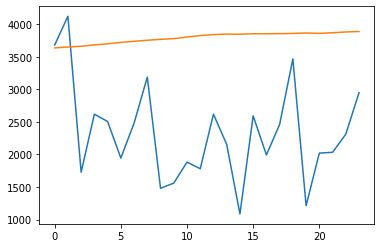

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3636.78503633 3650.35571039 3661.87277806 3682.67282379 3699.80926096
 3721.11575007 3738.32420838 3754.55019522 3768.09016705 3778.95760989
 3804.01522326 3826.00146556 3840.95488787 3849.03990495 3846.21845579
 3854.06388068 3853.89946592 3855.98635697 3858.90421689 3865.74421537
 3859.47895122 3869.75874758 3881.57308173 3888.44665182]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 22,529
Traina




 80%|███████▉  | 102/128 [08:34<02:14,  5.16s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


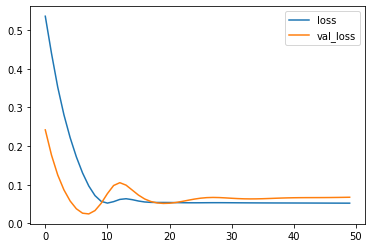

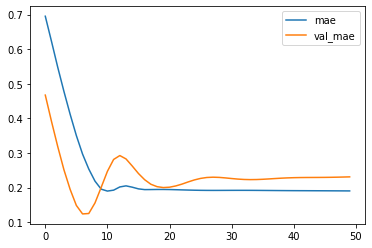

Test MSE: 1562784.436
bestmse=581130.9961952495
Test MAE: 1110.865
bestmae=593.83903
Test MAPE: 61.675
bestmape=26.35621


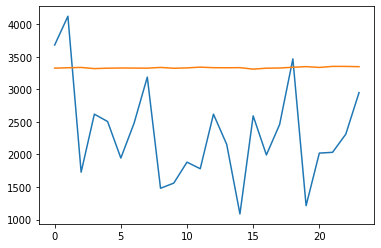

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3325.78418154 3331.61947095 3336.46941954 3318.73357147 3325.18003619
 3327.77035779 3326.85402524 3325.5774436  3336.71116376 3324.06514341
 3329.99670011 3341.19498104 3332.78056055 3331.75834835 3333.43922389
 3310.59461027 3325.07774323 3327.97752613 3339.53318679 3349.17397499
 3336.83956796 3352.84246147 3352.54906863 3348.10212272]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 6,825
Trainab




 80%|████████  | 103/128 [08:39<02:07,  5.12s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


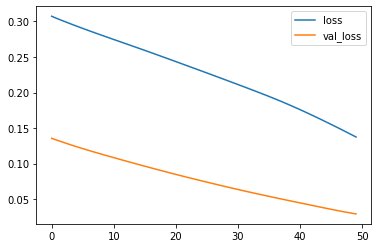

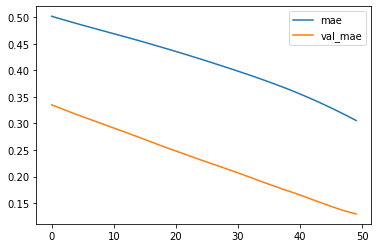

Test MSE: 677751.639
bestmse=581130.9961952495
Test MAE: 625.401
bestmae=593.83903
Test MAPE: 25.909
bestmape=25.90887


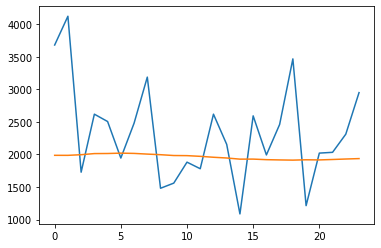

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1987.01846272 1986.57787132 1996.4342925  2013.60401434 2014.90039462
 2020.4454475  2016.32862234 2005.77408403 1996.40818125 1983.92313242
 1982.11457002 1971.29504561 1957.17000973 1945.91333717 1928.31321019
 1928.91290802 1920.17955732 1916.13489676 1913.0293802  1918.36037827
 1916.38094503 1922.85409486 1930.23798198 1936.64901   ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 30,401
Traina




 81%|████████▏ | 104/128 [08:44<02:02,  5.10s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


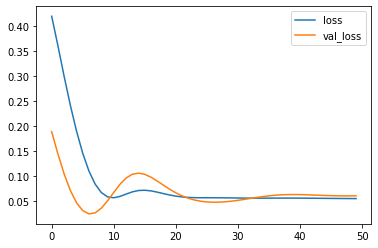

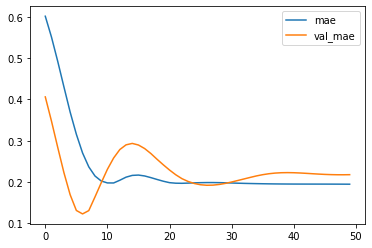

Test MSE: 1402131.707
bestmse=581130.9961952495
Test MAE: 1049.218
bestmae=593.83903
Test MAPE: 58.261
bestmape=25.90887


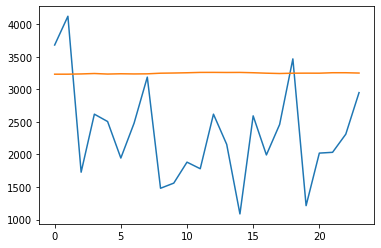

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3232.85469043 3233.13402337 3236.91814536 3243.47063321 3235.07185078
 3239.47948635 3236.75573915 3238.57434434 3248.27596313 3251.06771433
 3254.97105855 3260.41539663 3260.77923244 3259.38070267 3260.22142738
 3255.33661598 3248.42086619 3243.41812378 3248.27998024 3249.01511222
 3248.48600084 3255.48065823 3255.43804812 3250.52669507]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 2,537
Trainab




 82%|████████▏ | 105/128 [08:49<01:53,  4.93s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


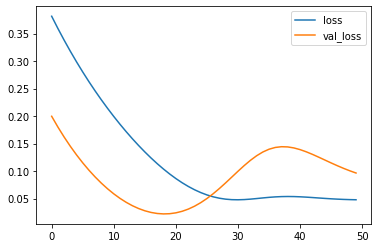

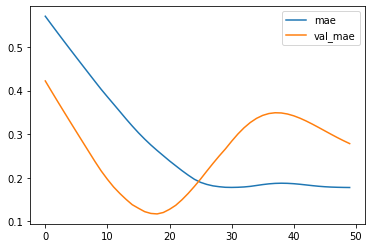

Test MSE: 2233947.606
bestmse=581130.9961952495
Test MAE: 1340.381
bestmae=593.83903
Test MAPE: 73.794
bestmape=25.90887


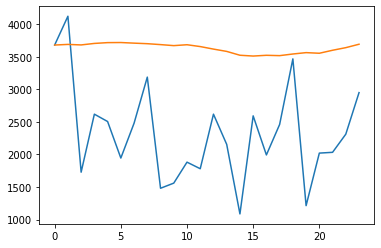

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3680.73628759 3690.39314425 3682.48201084 3705.47769666 3717.79790032
 3719.33932459 3709.87242007 3701.40835953 3687.34472811 3671.69978821
 3685.3901149  3657.24506199 3618.43256116 3582.90175605 3524.0246284
 3511.6705662  3523.20255458 3517.92636144 3543.11567879 3564.12203205
 3554.56474245 3600.5165168  3640.60904253 3693.12420833]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainabl




 83%|████████▎ | 106/128 [08:53<01:43,  4.71s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


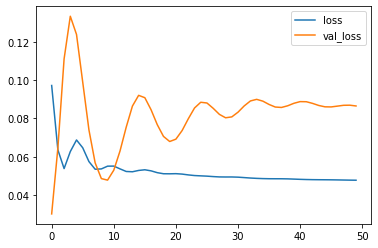

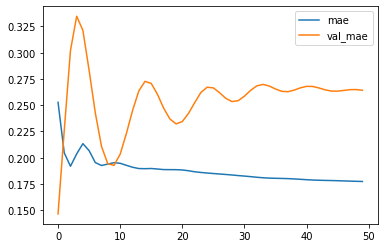

Test MSE: 2005103.597
bestmse=581130.9961952495
Test MAE: 1271.814
bestmae=593.83903
Test MAPE: 70.130
bestmape=25.90887


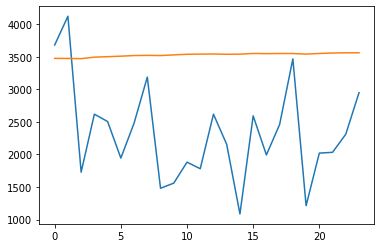

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3476.1632899  3474.54697514 3471.66469538 3494.60528934 3501.76751781
 3509.62872422 3519.29791915 3522.2464813  3519.4692204  3529.27643192
 3538.86786699 3541.3025254  3543.18942153 3538.9553827  3540.67212534
 3551.19409633 3548.71065867 3550.42252338 3550.60874534 3541.59261847
 3551.4015516  3558.33681309 3561.91835773 3561.11292624]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 52,289
Traina




 84%|████████▎ | 107/128 [08:58<01:44,  4.96s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


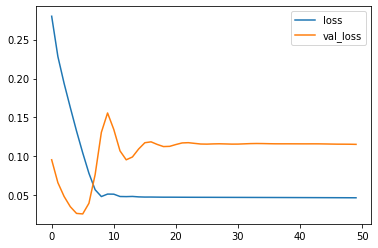

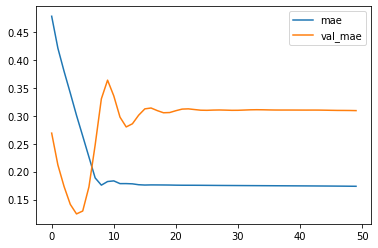

Test MSE: 2675792.183
bestmse=581130.9961952495
Test MAE: 1488.847
bestmae=593.83903
Test MAPE: 81.258
bestmape=25.90887


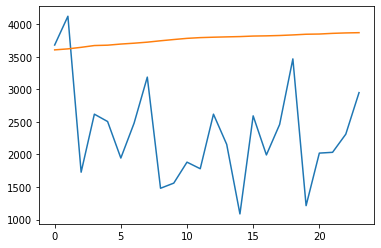

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3606.44922125 3621.73577714 3645.52570391 3673.08569276 3678.62012899
 3695.91323364 3709.09309983 3724.95410311 3746.19660532 3765.40587366
 3783.37758374 3794.72220242 3801.03280258 3806.09264541 3810.6276809
 3818.63694668 3821.83801317 3827.29325485 3836.0453999  3846.55761504
 3849.79225314 3860.25511515 3866.80502057 3870.64767766]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainabl




 84%|████████▍ | 108/128 [09:04<01:44,  5.23s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


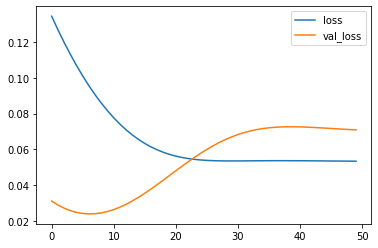

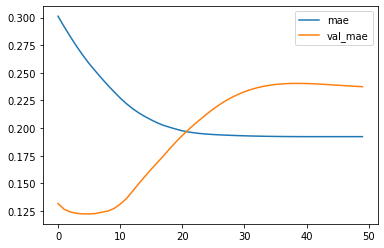

Test MSE: 1643130.999
bestmse=581130.9961952495
Test MAE: 1142.991
bestmae=593.83903
Test MAPE: 63.306
bestmape=25.90887


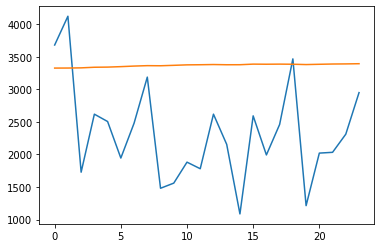

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3326.80467212 3327.46261811 3330.2776112  3339.56388903 3341.85321397
 3348.97010642 3357.68753213 3364.11477208 3362.4862625  3369.19168764
 3376.31604046 3378.26204556 3381.30902702 3378.08715761 3378.49876839
 3387.56783509 3386.04606599 3387.61604047 3385.83459359 3380.82941222
 3385.15096676 3389.21442169 3390.88955849 3393.95103025]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 2,537
Trainab




 85%|████████▌ | 109/128 [09:09<01:35,  5.02s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


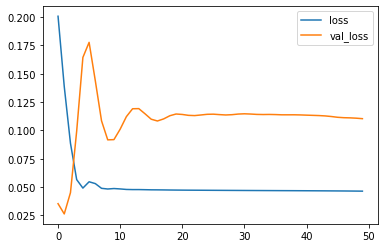

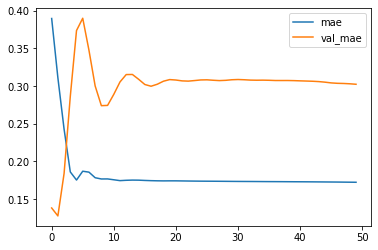

Test MSE: 2557562.187
bestmse=581130.9961952495
Test MAE: 1455.615
bestmae=593.83903
Test MAPE: 79.476
bestmape=25.90887


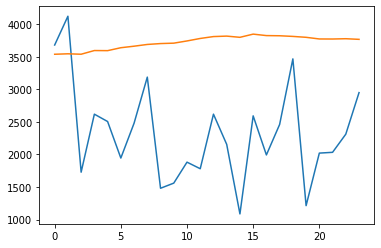

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3539.20846093 3546.18934536 3539.5969733  3596.25550592 3594.55884886
 3639.47449458 3662.98236251 3689.74983203 3703.32796645 3709.67586839
 3743.55908263 3781.78250229 3810.77172315 3817.84729671 3799.33528471
 3848.34006619 3825.83992016 3823.21559656 3813.2379446  3799.40558422
 3774.05931246 3773.25072467 3777.79522908 3768.08787155]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 2,537
Trainab




 86%|████████▌ | 110/128 [09:15<01:34,  5.26s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


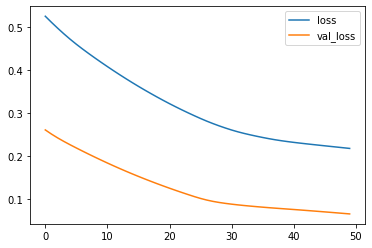

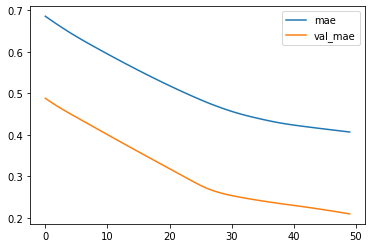

Test MSE: 1501737.969
bestmse=581130.9961952495
Test MAE: 1008.987
bestmae=593.83903
Test MAPE: 38.528
bestmape=25.90887


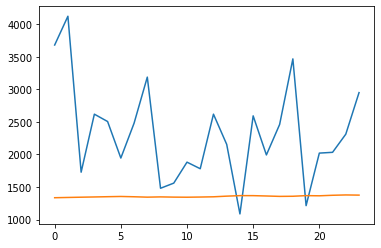

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1335.67097749 1339.76445317 1343.76754378 1347.41827604 1351.40852623
 1354.9486085  1350.48297584 1344.45852336 1348.44543791 1344.94907762
 1343.4762671  1346.23745954 1349.915666   1359.90357594 1367.78673302
 1367.64157888 1362.29906748 1356.31457095 1358.16943777 1367.80534804
 1365.31419896 1373.31302741 1378.35074024 1375.64801116]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 21,545
Traina




 87%|████████▋ | 111/128 [09:19<01:27,  5.15s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


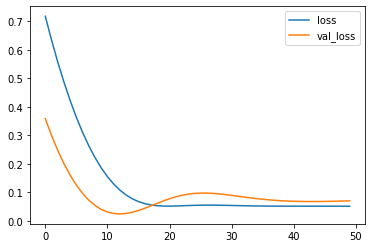

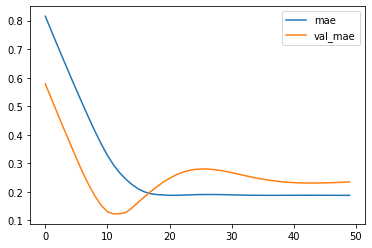

Test MSE: 1614053.447
bestmse=581130.9961952495
Test MAE: 1130.168
bestmae=593.83903
Test MAPE: 62.716
bestmape=25.90887


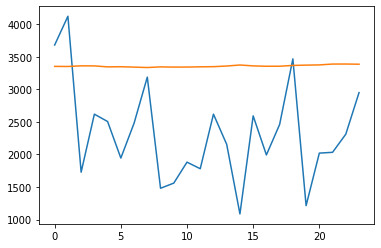

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3352.77617908 3351.46803439 3361.28012383 3360.33065009 3345.42270726
 3347.82723731 3341.6017139  3335.50402081 3345.05298924 3342.01289427
 3342.87714779 3346.1493746  3348.68876493 3358.45092738 3374.1533981
 3360.48071802 3354.82605529 3355.48342741 3367.44926417 3372.21844006
 3375.61333233 3388.54040724 3389.09032154 3386.13243395]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainabl




 88%|████████▊ | 112/128 [09:24<01:19,  4.96s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


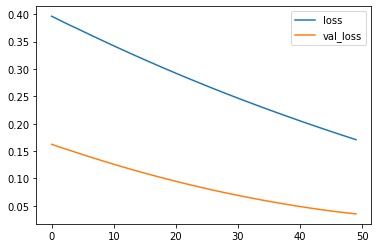

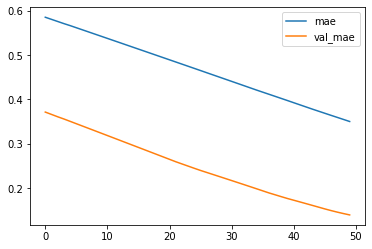

Test MSE: 818569.065
bestmse=581130.9961952495
Test MAE: 672.109
bestmae=593.83903
Test MAPE: 26.742
bestmape=25.90887


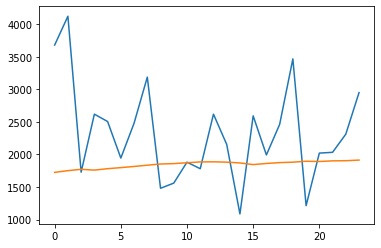

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1725.22769266 1751.27380317 1772.35146022 1759.71835202 1781.72410601
 1798.07763624 1815.70573956 1835.44010216 1853.68196321 1859.60376406
 1872.58119637 1885.69449323 1887.25815511 1882.2136634  1869.67467046
 1844.56756049 1862.01905423 1874.95818049 1881.68139571 1895.97027248
 1891.99935466 1901.90182918 1904.2865606  1913.715446  ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainab




 88%|████████▊ | 113/128 [09:28<01:10,  4.69s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


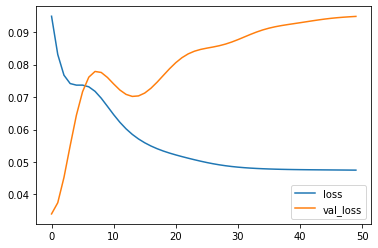

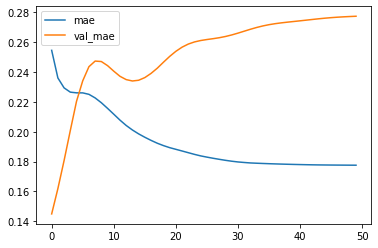

Test MSE: 2198365.307
bestmse=581130.9961952495
Test MAE: 1335.333
bestmae=593.83903
Test MAPE: 73.483
bestmape=25.90887


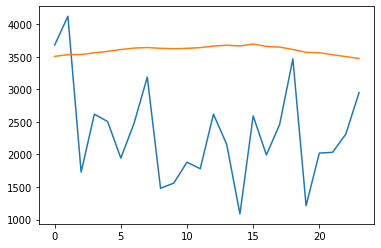

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3506.93381417 3532.95524812 3535.06136394 3560.72125757 3582.74566245
 3611.67749596 3633.99629796 3642.14874518 3630.5831852  3624.42781782
 3629.64231956 3641.27502275 3664.34789455 3677.78456914 3666.66318727
 3696.87275016 3659.47628224 3649.70522475 3612.43673062 3568.63899052
 3562.54072356 3532.11337566 3503.33849657 3473.69534683]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainab




 89%|████████▉ | 114/128 [09:33<01:06,  4.75s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


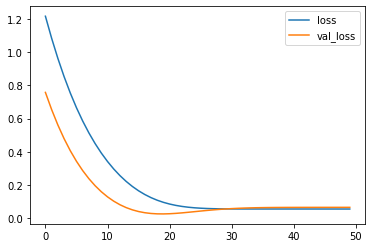

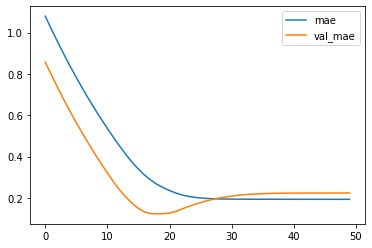

Test MSE: 1476355.675
bestmse=581130.9961952495
Test MAE: 1078.460
bestmae=593.83903
Test MAPE: 59.870
bestmape=25.90887


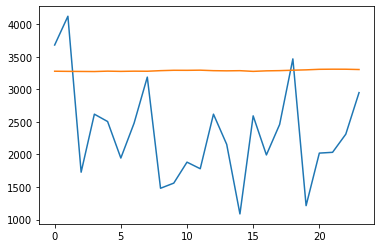

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3278.6090523  3276.48887658 3275.14027381 3273.80903071 3279.77229393
 3276.21327382 3279.42725247 3278.29155678 3287.28372443 3293.04154092
 3292.38244718 3294.70893043 3287.04843628 3284.4652881  3287.01558203
 3276.28013009 3284.40101427 3287.58816433 3294.12271863 3299.61813146
 3308.03986883 3309.81729859 3309.23840368 3304.68643892]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,857
Trainab




 90%|████████▉ | 115/128 [09:39<01:06,  5.08s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


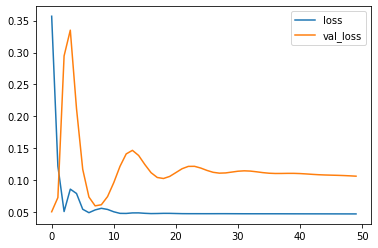

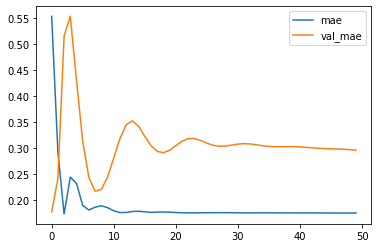

Test MSE: 2462359.774
bestmse=581130.9961952495
Test MAE: 1422.608
bestmae=593.83903
Test MAPE: 77.917
bestmape=25.90887


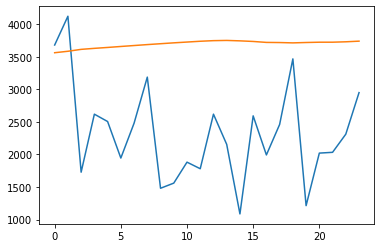

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3562.75248289 3585.09510064 3614.31559253 3629.88879824 3643.73636627
 3658.68146741 3673.1749301  3687.63080406 3701.02042103 3714.48923254
 3726.64100432 3738.91845441 3748.1314199  3751.55514932 3745.07037854
 3735.7328825  3721.15477347 3719.03201532 3713.89469957 3719.67647529
 3724.26229858 3724.44421649 3730.56285596 3740.42458546]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 30,401
Traina




 91%|█████████ | 116/128 [09:44<01:02,  5.24s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


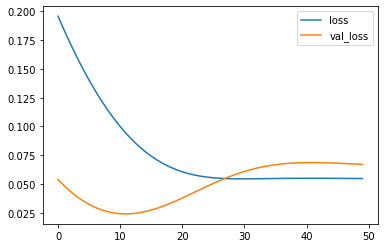

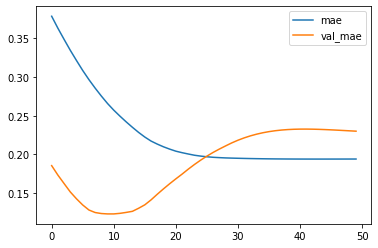

Test MSE: 1554674.707
bestmse=581130.9961952495
Test MAE: 1107.574
bestmae=593.83903
Test MAPE: 61.495
bestmape=25.90887


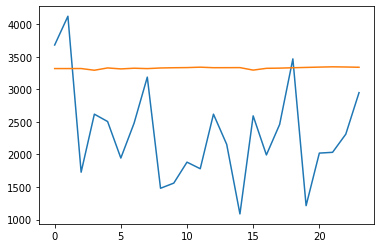

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3319.30543643 3319.39682579 3319.92909348 3293.59418112 3329.13230312
 3314.01417911 3324.7203635  3318.74289691 3328.44250715 3332.12620127
 3334.31725037 3340.74951172 3332.72819459 3333.10379481 3334.11452955
 3295.70790076 3323.15397573 3326.05849308 3331.92161536 3336.91919291
 3341.89008534 3346.24951553 3343.43208349 3339.28125632]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,161
Trainab




 91%|█████████▏| 117/128 [09:49<00:54,  4.96s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


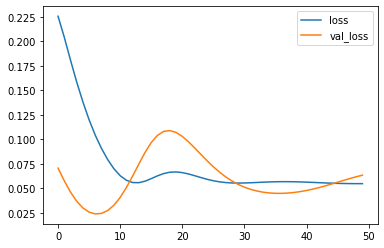

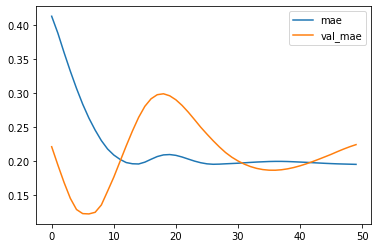

Test MSE: 1473121.888
bestmse=581130.9961952495
Test MAE: 1079.342
bestmae=593.83903
Test MAPE: 59.825
bestmape=25.90887


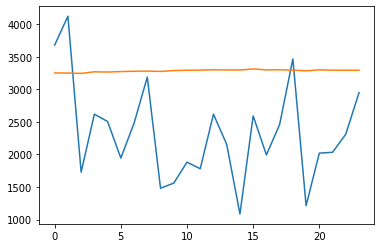

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3251.91747755 3250.40732938 3244.52024788 3269.99449342 3266.01353282
 3273.1575408  3278.36171281 3280.52263355 3275.82777429 3288.47092527
 3293.20437753 3295.00433183 3301.17447644 3297.37184703 3296.50371987
 3313.67516333 3299.2449702  3300.99356282 3295.29872894 3284.44907618
 3299.43291378 3294.30148023 3293.28113312 3292.32721186]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 8,033
Trainab




 92%|█████████▏| 118/128 [09:53<00:47,  4.73s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


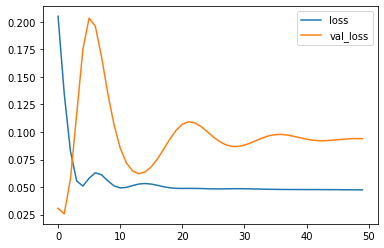

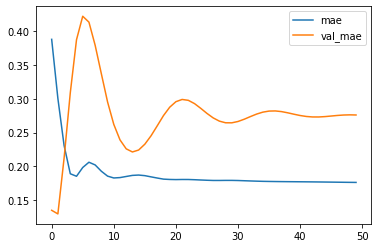

Test MSE: 2175965.264
bestmse=581130.9961952495
Test MAE: 1329.393
bestmae=593.83903
Test MAPE: 73.150
bestmape=25.90887


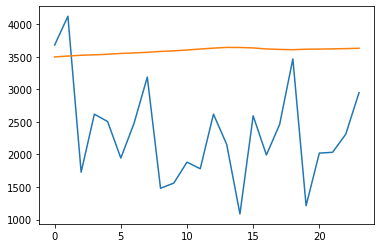

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3498.37248206 3511.48434424 3524.14657652 3529.89105046 3539.52609992
 3551.65376902 3559.74022079 3569.0868988  3582.68425798 3591.38159811
 3604.4099617  3619.78518105 3633.13376606 3644.33348167 3643.22160172
 3636.52449775 3620.28559875 3613.83181715 3609.09822142 3616.75627661
 3618.57545567 3622.20577955 3625.8326602  3631.17915285]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 24,401
Traina




 93%|█████████▎| 119/128 [09:58<00:43,  4.85s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


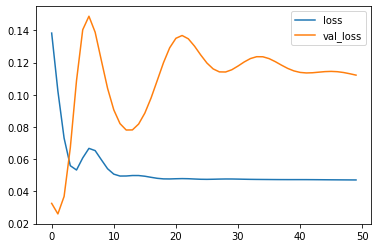

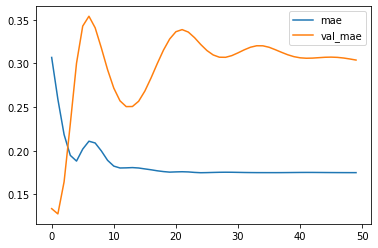

Test MSE: 2600395.301
bestmse=581130.9961952495
Test MAE: 1462.771
bestmae=593.83903
Test MAPE: 79.989
bestmape=25.90887


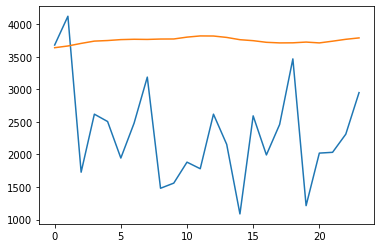

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3639.8033241  3666.17223847 3705.90322387 3741.12758052 3749.9345305
 3764.08166051 3769.30075324 3766.9501673  3772.92218208 3773.82402432
 3802.28642929 3820.61939275 3819.29288411 3797.61854208 3762.85787523
 3747.77074039 3722.6755383  3713.53344619 3714.88979626 3726.27286446
 3713.39227331 3740.02459562 3768.88067782 3790.31083667]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Trainab




 94%|█████████▍| 120/128 [10:03<00:38,  4.84s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


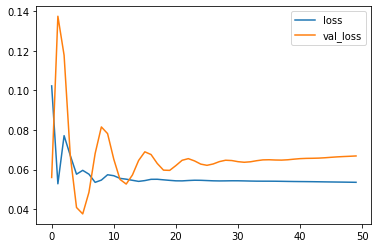

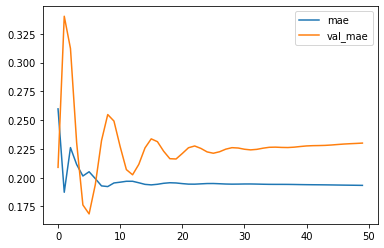

Test MSE: 1550124.049
bestmse=581130.9961952495
Test MAE: 1107.445
bestmae=593.83903
Test MAPE: 61.443
bestmape=25.90887


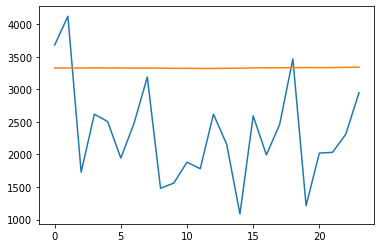

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3327.61311644 3328.60276133 3327.81009853 3330.33815485 3327.78456116
 3329.61478728 3325.76796961 3327.05775034 3325.94515306 3323.2607162
 3323.21954077 3320.76077968 3320.67613333 3323.9363088  3324.04764026
 3329.63888997 3331.81501836 3331.93022346 3333.26146656 3335.05266929
 3333.34396088 3334.29788214 3337.65059471 3340.21867871]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 22,529
Trainab




 95%|█████████▍| 121/128 [10:08<00:35,  5.03s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


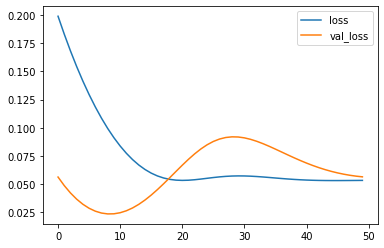

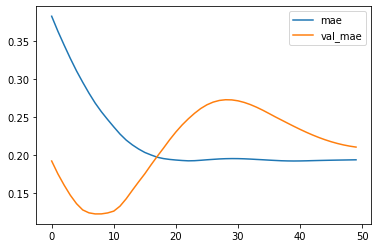

Test MSE: 1311280.947
bestmse=581130.9961952495
Test MAE: 1011.049
bestmae=593.83903
Test MAPE: 56.187
bestmape=25.90887


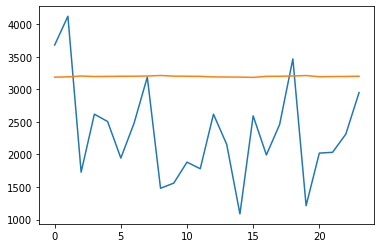

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3187.0057829  3192.19804704 3204.5513919  3197.74525195 3199.01006919
 3201.58805251 3201.87929332 3205.22067189 3213.00540966 3203.06505948
 3201.87111562 3199.68637913 3191.73392683 3189.30902427 3188.19111866
 3183.87229002 3200.31390983 3201.28576463 3205.65107703 3212.3672623
 3194.16571587 3197.03494    3198.3970288  3201.74213755]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,889
Trainabl




 95%|█████████▌| 122/128 [10:12<00:28,  4.78s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


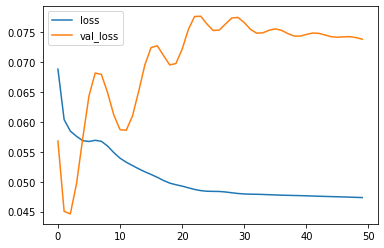

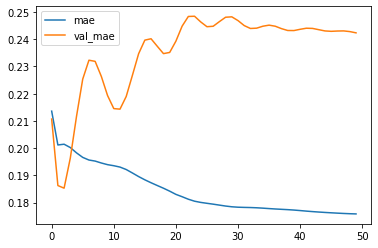

Test MSE: 1711768.736
bestmse=581130.9961952495
Test MAE: 1166.740
bestmae=593.83903
Test MAPE: 64.650
bestmape=25.90887


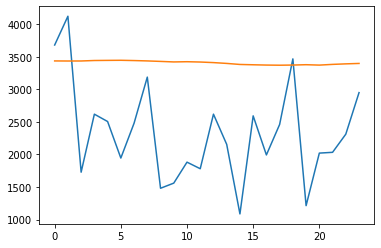

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3436.59184134 3435.50750732 3435.90204537 3443.15236342 3445.09750772
 3446.54854691 3442.36845219 3436.79327095 3429.3033607  3421.27587444
 3424.64809871 3419.8300001  3411.02764112 3398.43068695 3382.54055959
 3377.60424304 3373.12688184 3370.92593342 3373.42386138 3378.67595184
 3372.62244701 3383.59806502 3391.67949539 3398.13126844]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            5504      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 13,857
Traina




 96%|█████████▌| 123/128 [10:17<00:24,  4.81s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


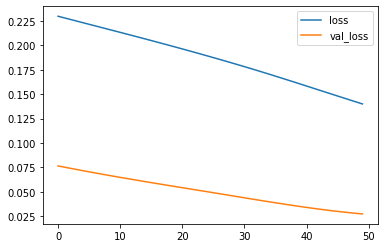

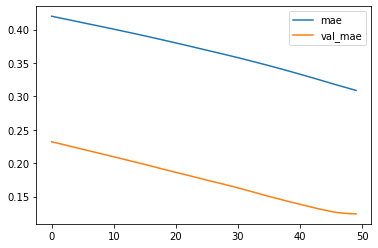

Test MSE: 629699.691
bestmse=581130.9961952495
Test MAE: 597.193
bestmae=593.83903
Test MAPE: 25.487
bestmape=25.48723


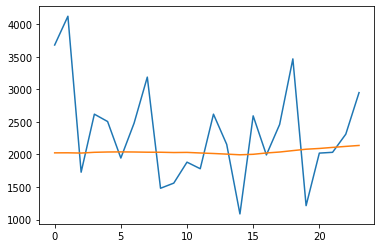

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2024.87711403 2025.65564519 2021.76026347 2033.30824858 2037.95088536
 2039.5818339  2037.9879002  2034.78790972 2034.29222646 2029.7146526
 2031.80943441 2022.88806841 2014.96775302 2005.39834034 1995.14673552
 2002.64962965 2022.95305958 2037.55398008 2059.35643938 2080.76959723
 2092.29620555 2108.4892664  2124.04991862 2138.51719832]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1728      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 22,529
Trainab




 97%|█████████▋| 124/128 [10:22<00:19,  4.86s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


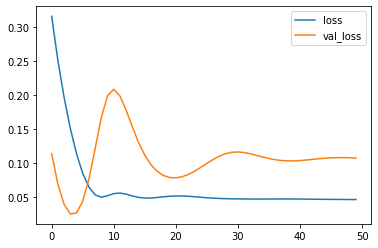

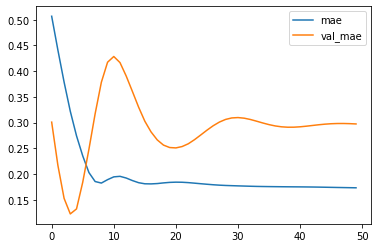

Test MSE: 2490360.203
bestmse=581130.9961952495
Test MAE: 1431.726
bestmae=593.83903
Test MAPE: 78.353
bestmape=25.48723


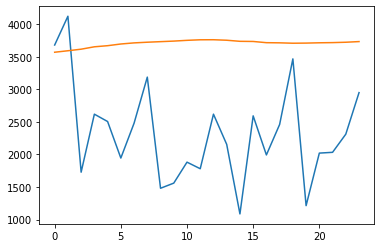

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3570.30724084 3592.89375484 3617.08883631 3653.7145921  3670.72276855
 3696.74879348 3713.74491858 3724.1188302  3732.76767802 3741.33647048
 3753.03660381 3761.35604823 3762.18902564 3754.51834524 3737.93426132
 3735.69471991 3716.93422067 3714.56957483 3708.70200503 3710.59377909
 3715.2866298  3718.01539838 3723.71797955 3733.82503998]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 52,289
Traina




 98%|█████████▊| 125/128 [10:28<00:15,  5.07s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


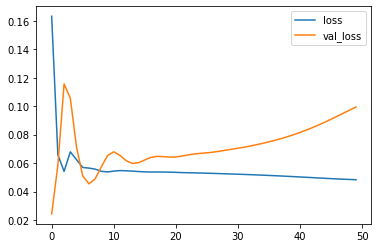

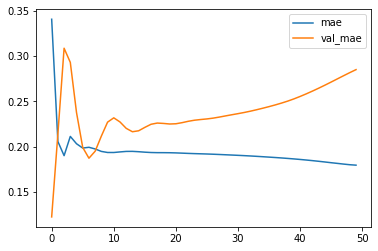

Test MSE: 2304085.684
bestmse=581130.9961952495
Test MAE: 1373.200
bestmae=593.83903
Test MAPE: 75.348
bestmape=25.48723


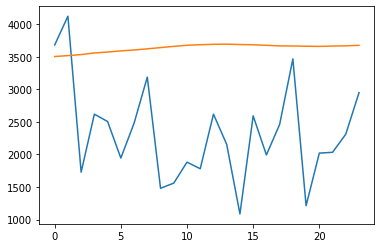

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3504.35568738 3518.27843285 3534.32910132 3559.26476657 3573.30085206
 3590.72106969 3604.77264977 3622.35900378 3641.6618135  3660.07483232
 3677.29993296 3685.82367635 3691.89898837 3694.16808426 3688.63536966
 3684.59128296 3676.60382438 3667.29559588 3665.96277463 3662.55913079
 3660.09032691 3665.12176299 3668.50187802 3676.38603938]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             608       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,361
Traina




 98%|█████████▊| 126/128 [10:34<00:10,  5.42s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


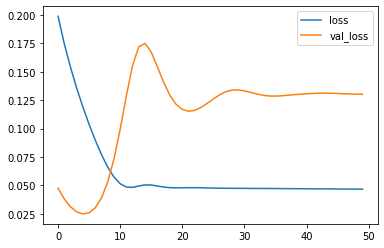

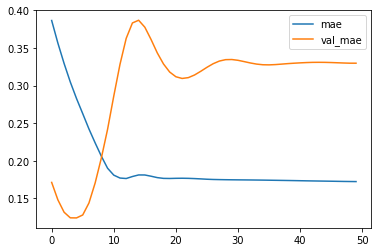

Test MSE: 3019729.011
bestmse=581130.9961952495
Test MAE: 1587.859
bestmae=593.83903
Test MAPE: 86.329
bestmape=25.48723


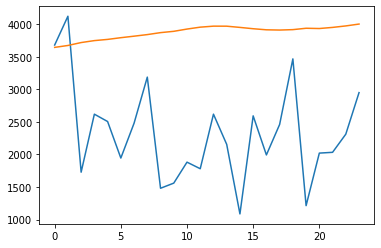

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3644.74953997 3673.97433591 3718.80504835 3748.82953703 3767.33839273
 3793.56441259 3816.83957481 3841.19620168 3871.29472005 3891.52261388
 3926.11628354 3955.40248394 3970.76421726 3970.27154684 3951.54318452
 3931.20711553 3914.74067569 3910.89629698 3917.31392455 3938.48784888
 3934.40818202 3951.5664264  3974.31391191 4002.91117716]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 52,289
Traina




 99%|█████████▉| 127/128 [10:40<00:05,  5.61s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


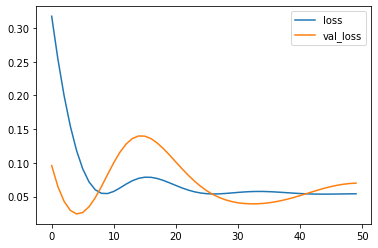

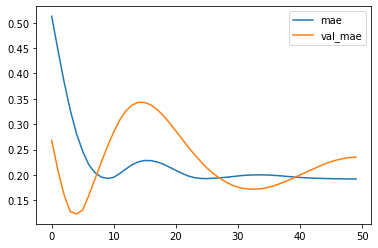

Test MSE: 1618600.455
bestmse=581130.9961952495
Test MAE: 1131.940
bestmae=593.83903
Test MAPE: 62.808
bestmape=25.48723


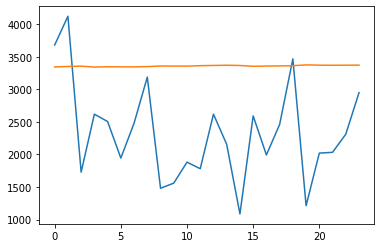

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3344.0917511  3351.64249194 3356.25672197 3342.4256528  3347.47172266
 3345.44164509 3345.61710691 3350.00723934 3358.44418436 3357.60489434
 3357.18166262 3363.96140438 3367.29187936 3370.75922316 3366.6287685
 3354.57928967 3357.88035363 3360.10655248 3363.62281901 3375.42624956
 3371.63495415 3370.09324294 3371.0190444  3372.09376603]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            19200     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 31,649
Trainab




100%|██████████| 128/128 [10:45<00:00,  5.05s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 12   #前幾期預測後一期(改這邊)
n_features = 10   #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(LSTM(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(LSTM(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -9:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -9:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': (0.1, 1, 10),
     'first_neuron':[ 8, 16, 32, 64],
     'second_neuron':[ 8, 16, 32, 64],
     'batch_size': [20,40,60,80,100],
     'epochs': [50],
     'dropout': (0, 0.25, 10),#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu','elu','tanh','sigmoid'],
     'last_activation': ['relu','elu','tanh','sigmoid'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=.001,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )


#十二期不包含經濟特徵指標-BPN

  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-12)  var1(t-11)  var1(t-10)  ...  var1(t-2)  var1(t-1)   var1(t)
12     0.120066    0.030744    0.050270  ...   0.342127   0.498130  0.119651
13     0.030744    0.050270    0.120482  ...   0.498130   0.119651  0.072497
14     0.050270    0.120482    0.146240  ...   0.119651   0.072497  0.057748
15     0.120482    0.146240    0.294765  ...   0.072497   0.057748  0.185085
16     0.146240    0.294765    0.389697  ...   0.057748   0.185085  0.143955
..          ...         ...         ...  ...        ...        ...       ...
125    0.447029    0.092439    0.108849  ...   0.296012   0.505193  0.036975
126    0.092439    0.108849    0.175737  ...   0.505193   0.036975  0.204612
127    0.108849    0.175737    0.154757  ...   0.036975   0.204612  0.207104
128    0.175737    0.154757    0.328833  ...   0.204612   0.207104  0.265060
129    0.154757    0.328833    0.232447  ...   0.207104   0.265060  0.397590

[118 rows x 13 columns]
(94, 12) 94 (94,)
(94, 12) (94,) (24, 12) (24,)
{'a

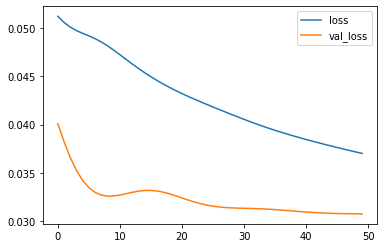

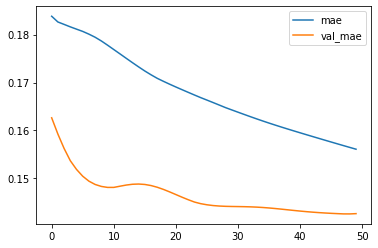

Test MSE: 711867.894
bestmse=711867.8943067178
Test MAE: 686.472
bestmae=686.47216
Test MAPE: 36.862
bestmape=36.86222


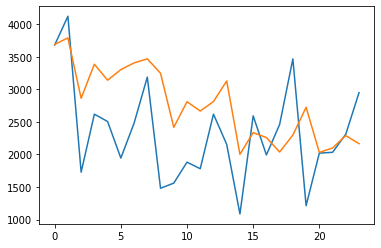

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3690.37018931 3790.60781622 2863.12089372 3385.99312615 3140.61886895
 3303.07155883 3406.3733834  3468.78930211 3247.68903399 2416.86378902
 2810.04993141 2667.14825153 2812.35632908 3128.84571022 2002.56656146
 2335.95780897 2259.58614707 2037.98675245 2297.83711267 2724.72871196
 2032.18905175 2099.14904445 2289.8490802  2165.9393858 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 16)                208       
_________________________________________________________________
dense_2 (Dense)              (None, 8)                 136       
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 9         
Total params: 353
Trainable

100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmsalesdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 12   #前幾期預測後一期(改這邊)
n_features = 1    #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times))
x_val = x_val.reshape((x_val.shape[0], n_times))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(Dense(params['first_neuron'],input_shape=(x_train.shape[1],),activation=params['activation']))##

    model.add(Dense(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()
    
    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    #x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.28],
     'first_neuron':[16],
     'second_neuron':[8],
     'batch_size': [80],
     'epochs': [50],
     'dropout': [0.08],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['tanh'],
     'last_activation': ['tanh'],
     'weight_regulizer': [None]}

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=
                         1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

#十二期不包含經濟特徵指標-RNN

  0%|          | 0/1 [00:00<?, ?it/s]

     var1(t-12)  var1(t-11)  var1(t-10)  ...  var1(t-2)  var1(t-1)   var1(t)
12     0.120066    0.030744    0.050270  ...   0.342127   0.498130  0.119651
13     0.030744    0.050270    0.120482  ...   0.498130   0.119651  0.072497
14     0.050270    0.120482    0.146240  ...   0.119651   0.072497  0.057748
15     0.120482    0.146240    0.294765  ...   0.072497   0.057748  0.185085
16     0.146240    0.294765    0.389697  ...   0.057748   0.185085  0.143955
..          ...         ...         ...  ...        ...        ...       ...
125    0.447029    0.092439    0.108849  ...   0.296012   0.505193  0.036975
126    0.092439    0.108849    0.175737  ...   0.505193   0.036975  0.204612
127    0.108849    0.175737    0.154757  ...   0.036975   0.204612  0.207104
128    0.175737    0.154757    0.328833  ...   0.204612   0.207104  0.265060
129    0.154757    0.328833    0.232447  ...   0.207104   0.265060  0.397590

[118 rows x 13 columns]
(94, 12) 94 (94,)
(94, 12, 1) (94,) (24, 12, 1) (24

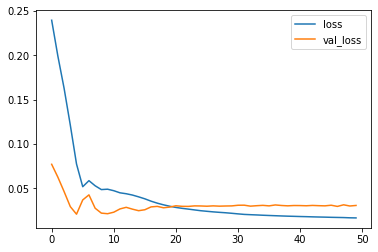

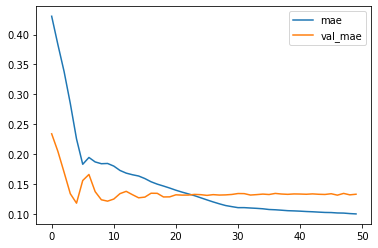

Test MSE: 710831.841
bestmse=710831.8411260819
Test MAE: 640.273
bestmae=640.27307
Test MAPE: 34.430
bestmape=34.43032


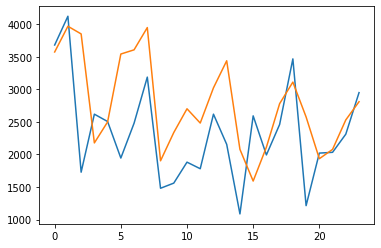

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3574.10972679 3969.16454482 3851.3414247  2177.44404346 2499.86168152
 3542.62042594 3606.98722768 3948.99518609 1902.89649546 2336.75664091
 2701.72341377 2482.68421239 3023.64637285 3439.02549547 2078.71082598
 1591.78703511 2112.36886659 2780.58683449 3111.40712863 2576.05415142
 1934.71111086 2078.04039824 2530.93105042 2810.32998168]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
simple_rnn_1 (SimpleRNN)     (None, 12, 64)            4224      
_________________________________________________________________
simple_rnn_2 (SimpleRNN)     (None, 16)                1296      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 5,537
Trainab

100%|██████████| 1/1 [00:03<00:00,  3.67s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmsalesdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 12   #前幾期預測後一期(改這邊)
n_features = 1    #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(SimpleRNN(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(SimpleRNN(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.55],
     'first_neuron':[64],
     'second_neuron':[16],
     'batch_size': [20],
     'epochs': [50],
     'dropout': [0.02],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu'],
     'last_activation': ['relu'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )

#十二期不包含經濟特徵指標-LSTM

In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmsalesdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 12   #前幾期預測後一期(改這邊)
n_features = 1    #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(LSTM(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(LSTM(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': [0.29],
     'first_neuron':[8],
     'second_neuron':[64],
     'batch_size': [60],
     'epochs': [50],
     'dropout': [0.18],#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu'],
     'last_activation': ['relu'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=1,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )





  0%|          | 0/128 [00:00<?, ?it/s]

     var1(t-12)  var1(t-11)  var1(t-10)  ...  var1(t-2)  var1(t-1)   var1(t)
12     0.120066    0.030744    0.050270  ...   0.342127   0.498130  0.119651
13     0.030744    0.050270    0.120482  ...   0.498130   0.119651  0.072497
14     0.050270    0.120482    0.146240  ...   0.119651   0.072497  0.057748
15     0.120482    0.146240    0.294765  ...   0.072497   0.057748  0.185085
16     0.146240    0.294765    0.389697  ...   0.057748   0.185085  0.143955
..          ...         ...         ...  ...        ...        ...       ...
125    0.447029    0.092439    0.108849  ...   0.296012   0.505193  0.036975
126    0.092439    0.108849    0.175737  ...   0.505193   0.036975  0.204612
127    0.108849    0.175737    0.154757  ...   0.036975   0.204612  0.207104
128    0.175737    0.154757    0.328833  ...   0.204612   0.207104  0.265060
129    0.154757    0.328833    0.232447  ...   0.207104   0.265060  0.397590

[118 rows x 13 columns]
(94, 12) 94 (94,)
(94, 12, 1) (94,) (24, 12, 1) (24

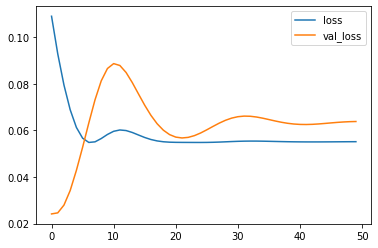

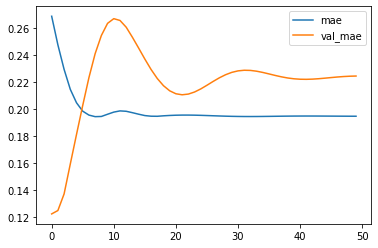

Test MSE: 1477885.571
bestmse=1477885.5709704233
Test MAE: 1080.335
bestmae=1080.33538
Test MAPE: 59.939
bestmape=59.93897


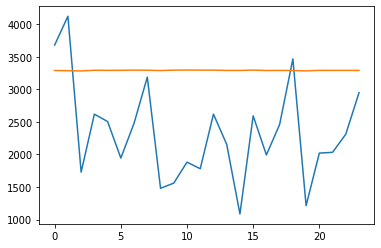

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3289.89714444 3286.68388313 3282.93046337 3293.48543209 3292.04357487
 3292.77841991 3295.68566316 3293.60192841 3289.15039152 3295.1614297
 3296.38435417 3295.52842182 3295.53157812 3290.8065905  3290.77187115
 3295.9373067  3289.9581185  3291.06741601 3289.04192942 3283.5161013
 3292.09005862 3291.21289295 3291.59480578 3290.43515086]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Trainabl




  1%|          | 1/128 [00:04<09:31,  4.50s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


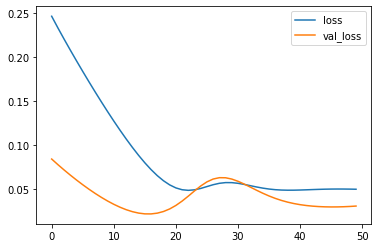

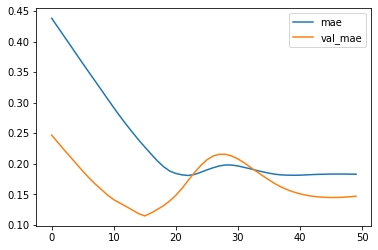

Test MSE: 710160.839
bestmse=710160.8391152258
Test MAE: 708.411
bestmae=708.41148
Test MAPE: 38.550
bestmape=38.55029


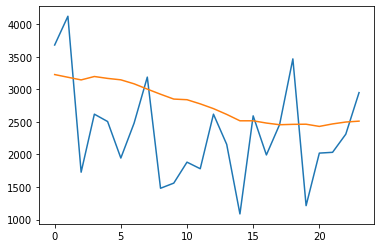

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3227.34048325 3185.89691579 3145.16552538 3197.4423902  3168.38358718
 3146.4036575  3085.20377678 3004.04055792 2925.32691818 2850.83196616
 2841.06650394 2777.19581586 2704.10298032 2615.44526023 2517.17831498
 2517.16023797 2482.58665389 2456.74685091 2462.65272677 2464.682087
 2430.99255508 2469.30234271 2498.28395975 2511.88088852]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 7,505
Trainable




  2%|▏         | 2/128 [00:08<09:07,  4.34s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


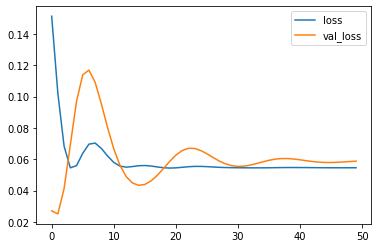

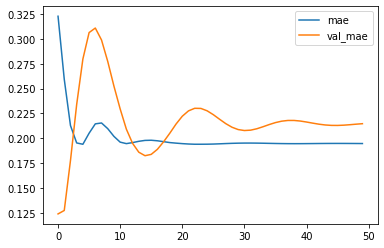

Test MSE: 1362610.214
bestmse=710160.8391152258
Test MAE: 1033.359
bestmae=708.41148
Test MAPE: 57.414
bestmape=38.55029


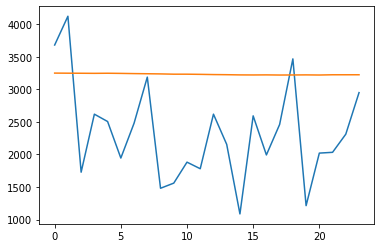

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3249.73518002 3248.44468194 3247.43021703 3246.09079623 3247.61127412
 3245.30186361 3242.14570272 3239.87402439 3237.33750343 3233.13890129
 3233.02082682 3230.56235266 3227.20418829 3225.23293275 3222.11938196
 3221.16302174 3222.36198699 3220.08543074 3221.03992587 3222.34907484
 3220.34783441 3224.10340619 3224.12578726 3224.22205454]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 7,505
Trainab




  2%|▏         | 3/128 [00:12<09:05,  4.37s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


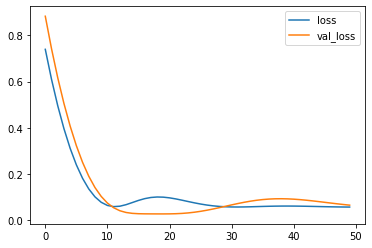

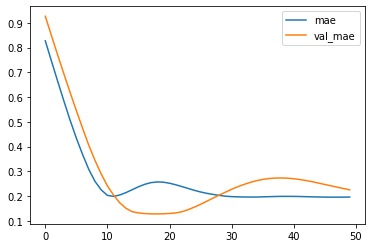

Test MSE: 1481980.727
bestmse=710160.8391152258
Test MAE: 1083.624
bestmae=708.41148
Test MAPE: 59.991
bestmape=38.55029


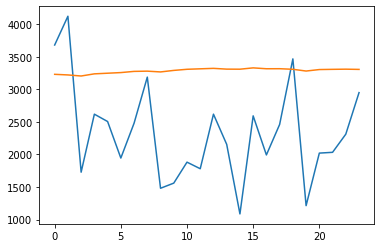

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3230.92934477 3221.55956835 3205.12999988 3238.24451053 3247.99175227
 3257.75649714 3276.03924668 3279.61218321 3267.73945743 3291.04962593
 3308.29524255 3315.49104261 3322.51697612 3310.75945544 3309.72117478
 3329.98536611 3316.56906402 3317.18023932 3308.34244365 3281.39477783
 3304.19950724 3307.49669755 3310.09060585 3306.54736727]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 49,985
Traina




  3%|▎         | 4/128 [00:18<09:44,  4.72s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


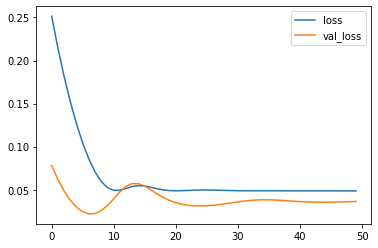

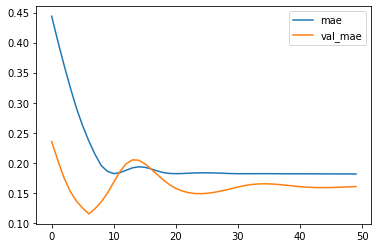

Test MSE: 841486.139
bestmse=710160.8391152258
Test MAE: 771.998
bestmae=708.41148
Test MAPE: 42.588
bestmape=38.55029


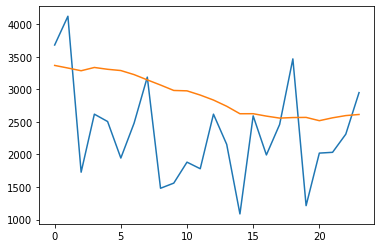

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3367.5938803  3327.60666037 3285.94315588 3336.28965366 3308.28390855
 3289.0116576  3226.7472415  3145.56336319 3066.45403767 2983.18699849
 2977.15759635 2912.43470609 2835.93263143 2740.50449502 2625.56265038
 2626.05962485 2589.22899622 2558.60495317 2567.0010097  2569.40683097
 2518.94168484 2562.99408132 2597.24514848 2614.27355397]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 19,241
Traina




  4%|▍         | 5/128 [00:23<09:41,  4.73s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


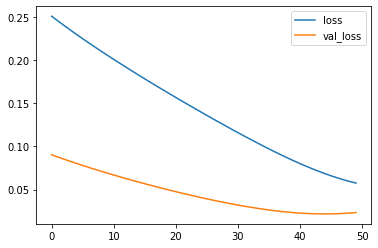

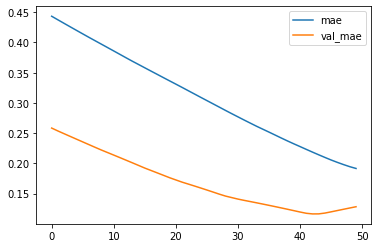

Test MSE: 540505.199
bestmse=540505.1994585395
Test MAE: 617.979
bestmae=617.97912
Test MAPE: 31.591
bestmape=31.59150


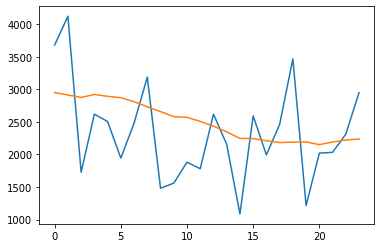

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2950.92569429 2913.32722288 2876.21410501 2921.80118275 2893.01611739
 2871.85826153 2810.54877096 2732.46180111 2658.10816544 2580.65848213
 2570.84395373 2507.95014185 2435.02674246 2347.43771833 2246.32306921
 2244.68537766 2210.87561923 2183.31089592 2189.81230903 2192.31167167
 2151.10066646 2191.1078285  2221.91802177 2237.18886787]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Traina




  5%|▍         | 6/128 [00:27<09:39,  4.75s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


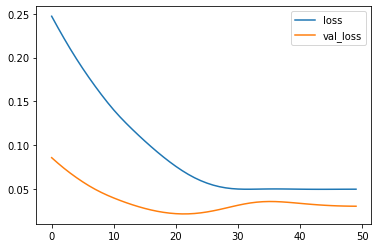

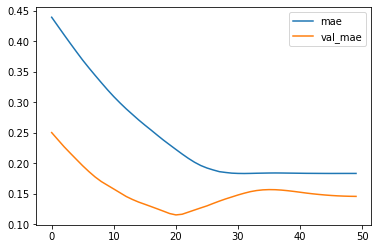

Test MSE: 702194.616
bestmse=540505.1994585395
Test MAE: 701.050
bestmae=617.97912
Test MAPE: 38.183
bestmape=31.59150


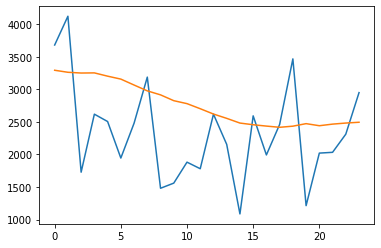

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3293.38787359 3262.37904835 3250.83615637 3252.99965954 3202.67626017
 3157.60122108 3066.5541786  2976.94655436 2915.46734071 2826.09184831
 2780.72399026 2702.76155096 2620.94712913 2554.671911   2482.40904003
 2456.61399919 2435.88152707 2417.40122157 2434.6200096  2473.43925345
 2441.50534409 2466.14144737 2482.63012481 2494.78103578]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,961
Trainab




  5%|▌         | 7/128 [00:32<09:16,  4.60s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


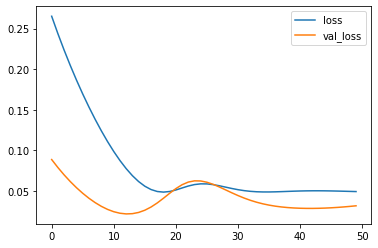

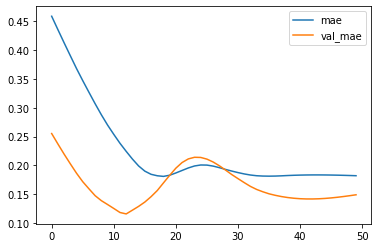

Test MSE: 735420.167
bestmse=540505.1994585395
Test MAE: 717.983
bestmae=617.97912
Test MAPE: 39.174
bestmape=31.59150


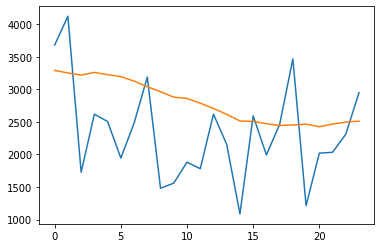

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3291.08233672 3252.61602509 3218.79823244 3259.90335798 3225.05646664
 3196.80280817 3126.56743234 3040.88754195 2963.89724439 2880.2804293
 2860.43215281 2788.27257907 2706.90061373 2616.44824767 2514.41540092
 2507.2815792  2472.51689523 2444.7884745  2453.73114556 2465.50315654
 2426.42896938 2466.83382577 2496.73980957 2511.81058902]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Trainab




  6%|▋         | 8/128 [00:37<09:22,  4.69s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


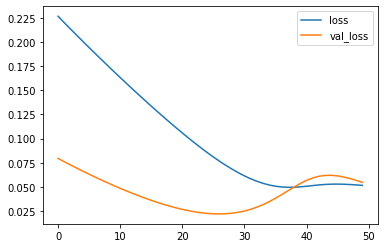

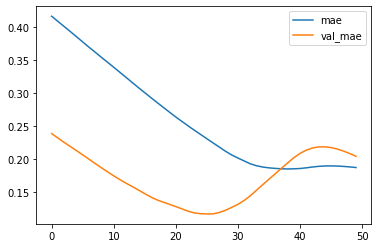

Test MSE: 1266819.652
bestmse=540505.1994585395
Test MAE: 982.717
bestmae=617.97912
Test MAPE: 54.667
bestmape=31.59150


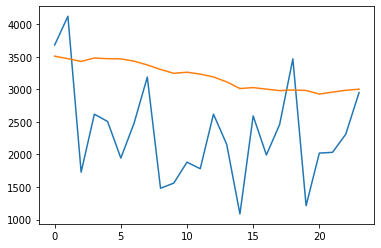

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3509.83331013 3471.28823435 3428.72173989 3481.52613795 3471.16657317
 3468.29146683 3433.07959193 3374.9573949  3306.11280155 3246.26841009
 3263.21618634 3233.69383699 3190.53252262 3115.19555467 3012.3874048
 3027.24929428 3003.22680527 2980.9804548  2990.37906837 2982.59203511
 2927.47736573 2958.06468087 2985.70515549 3002.25939798]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 7,505
Trainabl




  7%|▋         | 9/128 [00:41<08:57,  4.52s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


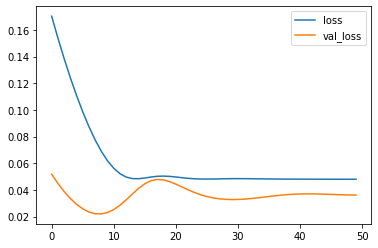

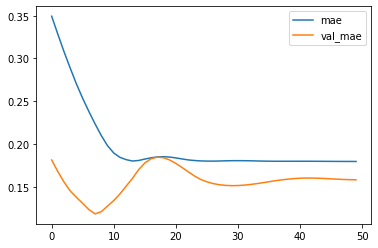

Test MSE: 837759.215
bestmse=540505.1994585395
Test MAE: 760.877
bestmae=617.97912
Test MAPE: 41.832
bestmape=31.59150


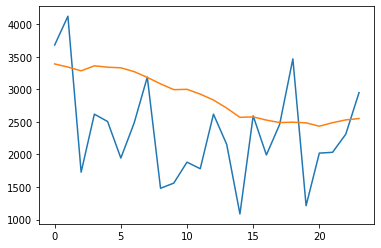

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3390.54265195 3342.46725863 3284.86929506 3361.57782072 3340.45669276
 3330.73068434 3272.91923982 3183.31477189 3084.89847606 2995.50806296
 3000.42429394 2927.11338645 2836.40048182 2712.59415638 2570.49460822
 2576.83533674 2527.94504303 2490.2690987  2495.45576757 2486.0575844
 2433.883156   2488.12037277 2531.16762978 2551.75548577]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,961
Trainabl




  8%|▊         | 10/128 [00:45<08:47,  4.47s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


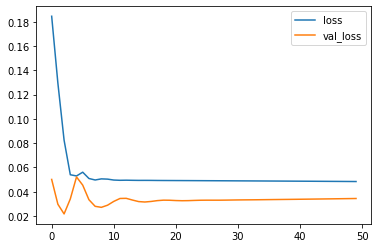

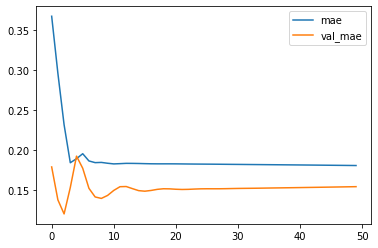

Test MSE: 797609.360
bestmse=540505.1994585395
Test MAE: 740.366
bestmae=617.97912
Test MAPE: 40.541
bestmape=31.59150


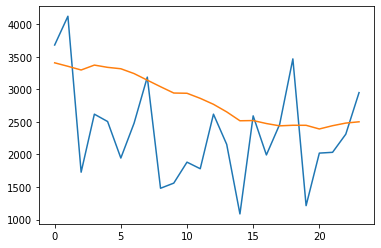

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3407.70089632 3354.25361645 3297.41345286 3372.81340343 3338.08673859
 3316.52688432 3242.50796038 3141.23420483 3040.75038618 2943.66045552
 2940.03945708 2862.03397727 2770.58967084 2654.02964634 2517.61589354
 2520.91207957 2475.20147556 2439.66349703 2448.52324337 2447.96242547
 2391.60804582 2442.02082598 2482.15524447 2501.94928992]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Traina




  9%|▊         | 11/128 [00:52<09:54,  5.08s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


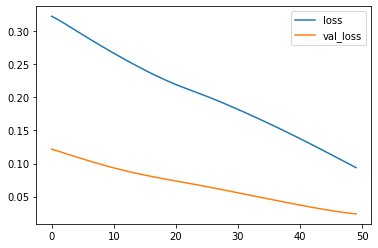

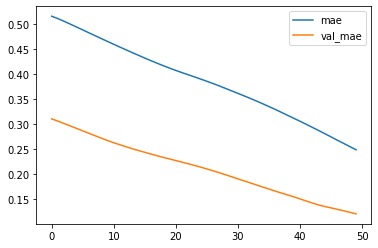

Test MSE: 554667.030
bestmse=540505.1994585395
Test MAE: 580.817
bestmae=580.81703
Test MAPE: 25.731
bestmape=25.73123


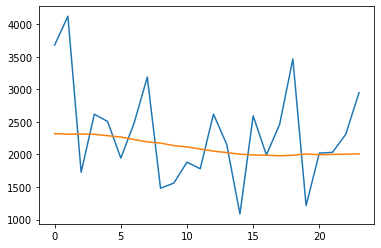

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2319.97873122 2311.60089517 2313.70141572 2309.57569551 2287.88169831
 2267.77661341 2229.36833474 2194.13192675 2174.41965827 2136.71903738
 2116.11116755 2084.29583481 2051.84457847 2029.07550097 2004.77540064
 1992.04530782 1987.31063607 1980.47322002 1987.40876845 2008.54782996
 1994.98798776 2001.34227404 2004.81550005 2008.89717546]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,281
Trainab




  9%|▉         | 12/128 [00:56<09:10,  4.74s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


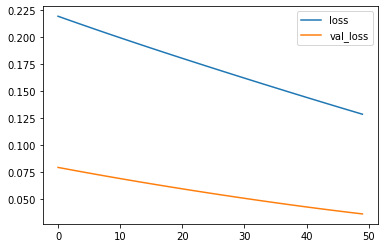

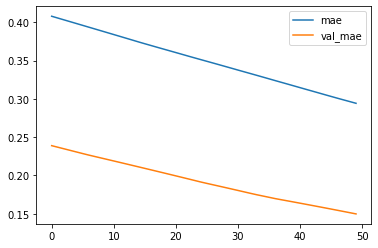

Test MSE: 846235.833
bestmse=540505.1994585395
Test MAE: 720.950
bestmae=580.81703
Test MAPE: 28.185
bestmape=25.73123


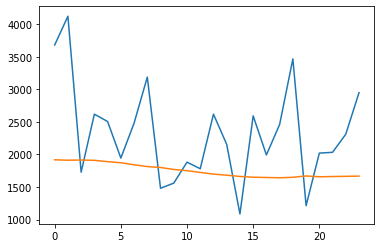

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1918.16440046 1911.75243989 1914.52690315 1909.92207029 1890.0406526
 1872.7432439  1842.04961869 1814.07529315 1799.70220044 1770.13824525
 1750.7484937  1724.49291936 1698.57829762 1682.0747712  1662.42792431
 1650.91013929 1646.46735397 1641.9950859  1649.57401827 1669.9244341
 1657.09972388 1661.38612866 1664.18455115 1667.66581139]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 1,937
Trainable




 10%|█         | 13/128 [01:00<08:38,  4.51s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


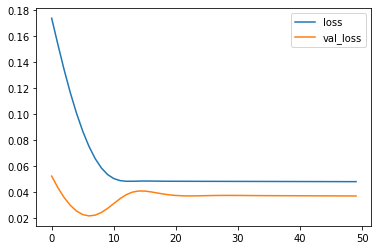

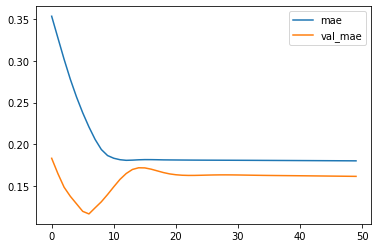

Test MSE: 861083.169
bestmse=540505.1994585395
Test MAE: 777.288
bestmae=580.81703
Test MAPE: 42.878
bestmape=25.73123


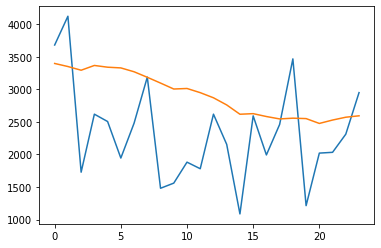

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3397.60258746 3350.76188302 3293.90349895 3367.20106387 3340.35095656
 3329.49585199 3270.30338085 3185.42963928 3096.61697334 3005.24526191
 3013.459544   2949.4192763  2870.63634133 2760.83324713 2617.9304195
 2626.9654842  2582.81739432 2545.92421347 2557.29236096 2551.10829991
 2476.63874179 2528.75334388 2572.17433602 2593.78354341]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,961
Trainabl




 11%|█         | 14/128 [01:05<09:13,  4.85s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


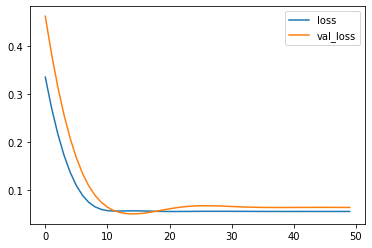

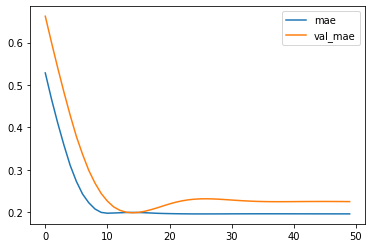

Test MSE: 1479752.022
bestmse=540505.1994585395
Test MAE: 1082.062
bestmae=580.81703
Test MAPE: 59.957
bestmape=25.73123


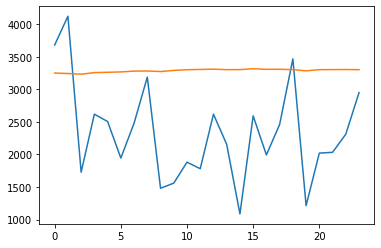

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3250.35453302 3243.62658334 3232.88410145 3257.08363044 3262.2045908
 3268.06599146 3280.1639626  3281.91384643 3273.86641806 3291.07057232
 3301.63257098 3305.77823329 3310.32503319 3302.59940439 3303.28575712
 3317.14681119 3307.56513196 3308.63698423 3302.70169735 3284.94963735
 3302.6697039  3303.73337847 3304.75802964 3301.84648234]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainabl




 12%|█▏        | 15/128 [01:10<09:07,  4.84s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


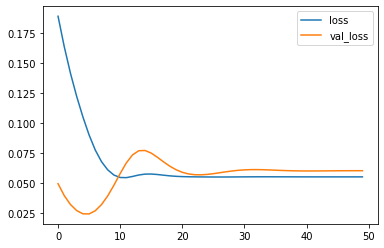

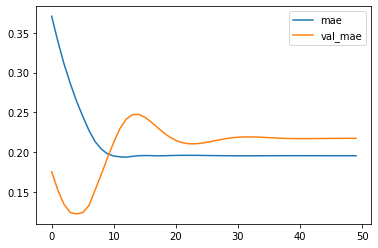

Test MSE: 1393096.659
bestmse=540505.1994585395
Test MAE: 1045.738
bestmae=580.81703
Test MAPE: 58.080
bestmape=25.73123


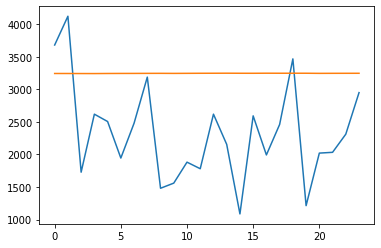

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3243.80204517 3243.67866236 3242.95601213 3242.58858961 3243.89917326
 3244.64922595 3244.93974942 3245.79697299 3246.13340634 3245.22123438
 3246.19567162 3247.14155865 3247.58157617 3248.14598078 3247.33653218
 3247.03309655 3248.08945423 3247.59477526 3247.81959021 3247.61256534
 3245.8114633  3246.49006873 3246.78704828 3246.99938148]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Traina




 12%|█▎        | 16/128 [01:15<09:13,  4.95s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


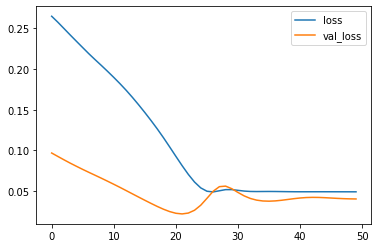

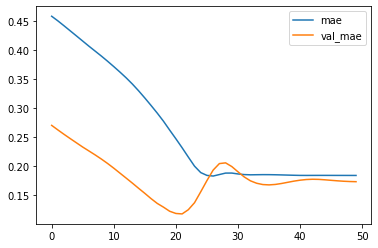

Test MSE: 936747.116
bestmse=540505.1994585395
Test MAE: 832.626
bestmae=580.81703
Test MAPE: 46.268
bestmape=25.73123


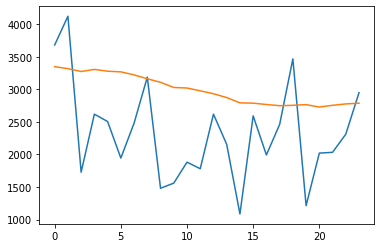

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3349.11816579 3317.5696125  3274.24574846 3306.35225028 3278.74176055
 3268.66482848 3222.39684981 3162.81730098 3108.14853132 3028.97464502
 3020.53253514 2977.68455571 2932.56030697 2874.21286458 2792.67232388
 2787.9675653  2767.55890131 2748.97415084 2755.04802817 2765.5012778
 2728.07798129 2755.21229947 2776.37991118 2787.27389568]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,281
Trainabl




 13%|█▎        | 17/128 [01:20<09:05,  4.92s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


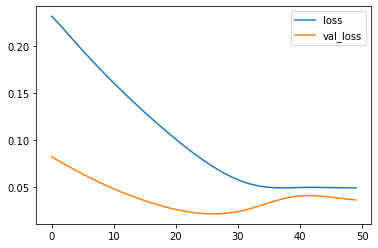

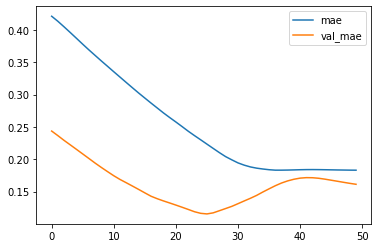

Test MSE: 845625.109
bestmse=540505.1994585395
Test MAE: 776.363
bestmae=580.81703
Test MAPE: 42.934
bestmape=25.73123


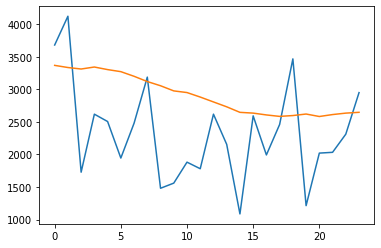

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3368.46832007 3335.50918567 3312.48896676 3343.13782984 3303.54729998
 3271.90678346 3200.7609573  3119.98381186 3055.47669804 2976.39262295
 2950.90833461 2881.82056236 2806.8230406  2731.98017776 2647.01590765
 2635.21835929 2607.23815155 2584.91275001 2597.74886596 2621.0983448
 2583.14493263 2613.0061543  2635.0404585  2647.49107492]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 7,505
Trainabl




 14%|█▍        | 18/128 [01:25<08:48,  4.80s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


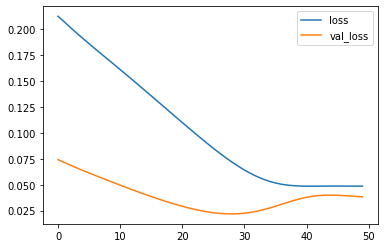

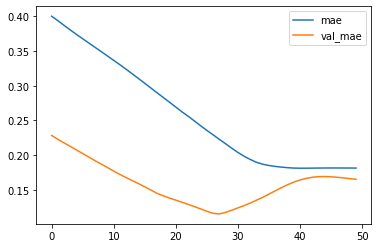

Test MSE: 887333.067
bestmse=540505.1994585395
Test MAE: 794.944
bestmae=580.81703
Test MAPE: 43.968
bestmape=25.73123


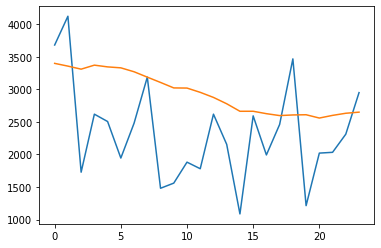

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3399.13253427 3357.00863975 3310.30107397 3371.94068527 3345.11295903
 3330.51935542 3270.32432723 3187.69787437 3106.1712501  3022.08701503
 3019.8707155  2954.19175196 2876.29559505 2778.70955074 2663.39540565
 2663.61462533 2626.60939568 2597.3526063  2607.01434088 2610.19790423
 2559.50736928 2600.32068014 2632.955576   2649.97881663]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable




 15%|█▍        | 19/128 [01:29<08:40,  4.77s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


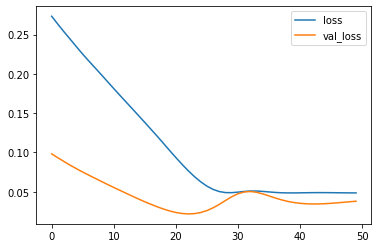

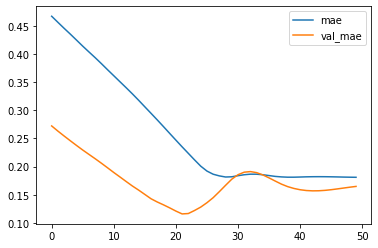

Test MSE: 877878.540
bestmse=540505.1994585395
Test MAE: 793.365
bestmae=580.81703
Test MAPE: 43.850
bestmape=25.73123


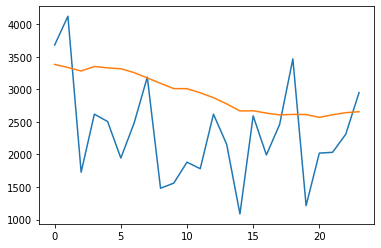

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3382.76293558 3336.19180822 3281.61686689 3351.71853018 3329.98091859
 3317.00951195 3257.64358753 3175.35313761 3092.16859275 3011.67336267
 3010.50811249 2947.0580737  2872.20158136 2777.20801067 2668.45653969
 2671.21385849 2635.62466174 2608.00958103 2614.96808439 2613.44330245
 2569.75359404 2610.11827928 2641.88590878 2657.24635088]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 7,505
Trainab




 16%|█▌        | 20/128 [01:34<08:28,  4.71s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


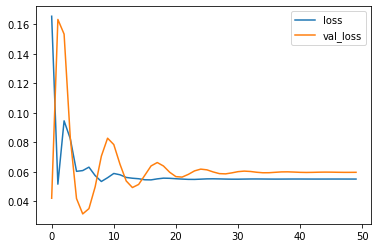

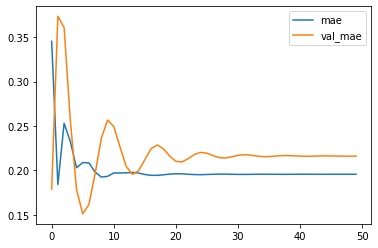

Test MSE: 1382573.461
bestmse=540505.1994585395
Test MAE: 1040.653
bestmae=580.81703
Test MAPE: 57.849
bestmape=25.73123


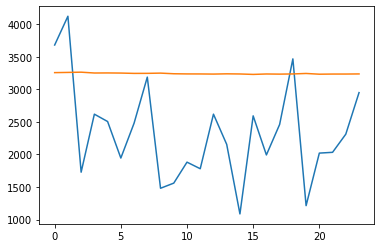

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3257.05651492 3260.16647899 3263.86724585 3251.22222978 3252.20111454
 3250.34405982 3245.30932397 3245.9153344  3249.5070653  3239.69526279
 3237.13564342 3236.64483809 3234.75578994 3238.54852003 3236.30037051
 3229.62363905 3236.18430459 3234.0077458  3236.84712851 3244.1957224
 3232.90045685 3235.18332571 3235.2550599  3236.95688182]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 49,985
Trainab




 16%|█▋        | 21/128 [01:40<09:02,  5.07s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


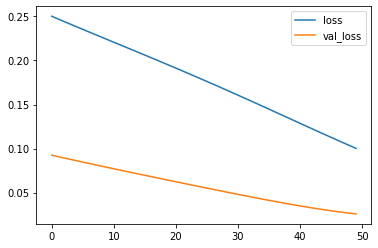

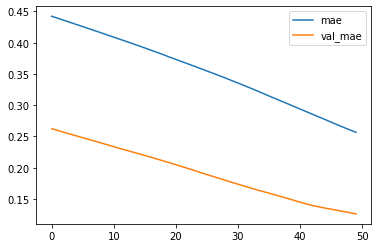

Test MSE: 598160.997
bestmse=540505.1994585395
Test MAE: 606.639
bestmae=580.81703
Test MAPE: 25.958
bestmape=25.73123


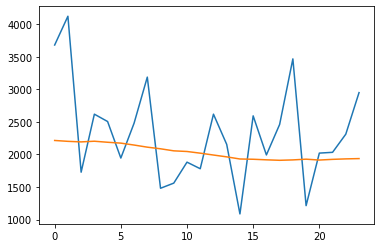

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2215.06848264 2201.68998447 2193.12822196 2203.41935232 2187.53783306
 2174.2434791  2144.7707698  2112.27475134 2087.19296354 2055.76334554
 2045.82062814 2020.03354979 1991.32990274 1963.33161798 1930.52800331
 1926.52007064 1917.79991904 1910.44802538 1916.53603435 1927.64170644
 1914.41707811 1925.00088397 1932.20959619 1936.65309885]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Traina




 17%|█▋        | 22/128 [01:44<08:44,  4.95s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


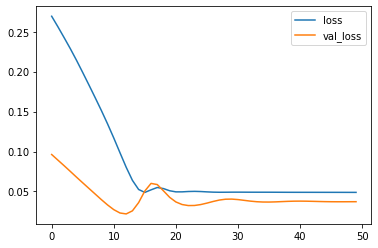

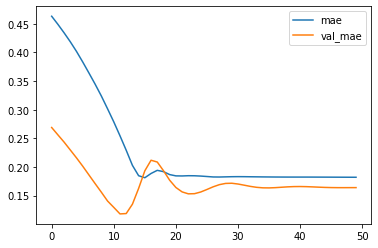

Test MSE: 861921.935
bestmse=540505.1994585395
Test MAE: 789.272
bestmae=580.81703
Test MAPE: 43.613
bestmape=25.73123


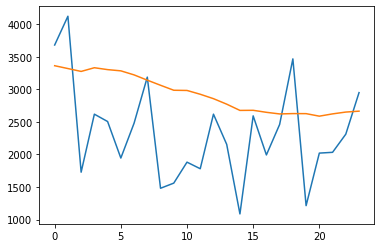

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3363.14435196 3319.67113733 3275.43151462 3332.18918389 3303.20699298
 3284.41392642 3222.36198699 3141.20192444 3062.80262393 2986.31389183
 2983.23979485 2924.82162255 2857.0846051  2772.70855534 2676.7029587
 2678.36260092 2647.48906636 2622.52097726 2627.91395366 2627.04166591
 2588.33518821 2623.35797179 2651.32526737 2665.24413919]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainabl




 18%|█▊        | 23/128 [01:49<08:37,  4.93s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


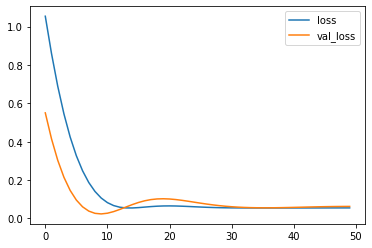

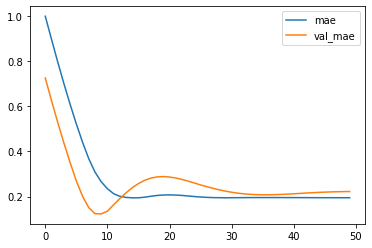

Test MSE: 1454398.430
bestmse=540505.1994585395
Test MAE: 1069.101
bestmae=580.81703
Test MAPE: 59.420
bestmape=25.73123


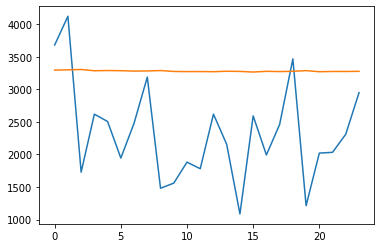

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3294.862872   3299.69531745 3305.01211214 3285.71948868 3289.13762283
 3286.70267749 3280.41933632 3282.82329249 3288.74408907 3275.0114392
 3272.73086584 3273.26987654 3271.51253235 3278.16587847 3275.51859993
 3266.20133293 3276.92588127 3273.2941227  3277.54078674 3287.74612302
 3270.94267595 3275.10713261 3274.65305519 3276.87796283]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainabl




 19%|█▉        | 24/128 [01:54<08:20,  4.82s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


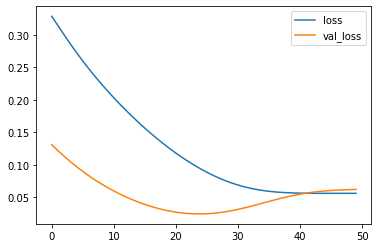

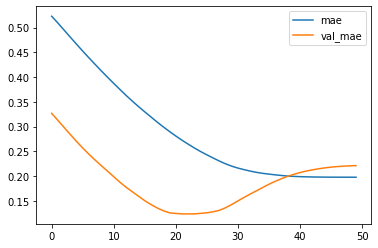

Test MSE: 1439108.874
bestmse=540505.1994585395
Test MAE: 1063.875
bestmae=580.81703
Test MAPE: 58.993
bestmape=25.73123


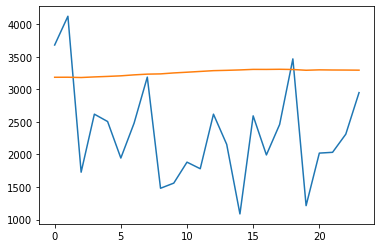

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3185.65961909 3186.3551538  3181.94622701 3191.10697001 3198.8653096
 3207.78473878 3222.65595371 3233.77934414 3237.67924511 3252.41789526
 3263.46840376 3275.28560728 3287.31629175 3292.24816078 3298.49850422
 3306.7305764  3306.22915441 3308.42422062 3304.98872679 3293.42144519
 3299.69287848 3297.28203583 3296.44131112 3294.73791105]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable 




 20%|█▉        | 25/128 [01:59<08:36,  5.01s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


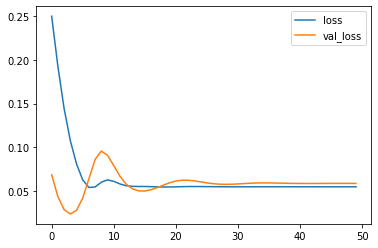

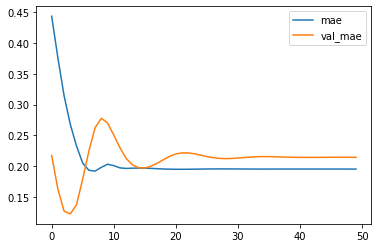

Test MSE: 1357700.901
bestmse=540505.1994585395
Test MAE: 1030.747
bestmae=580.81703
Test MAPE: 57.294
bestmape=25.73123


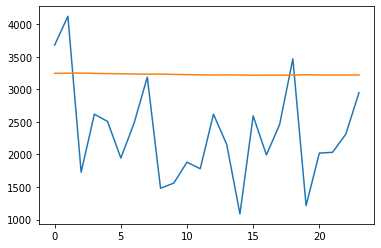

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3246.49982458 3247.79706568 3250.15238607 3245.24992806 3242.37109154
 3240.09008777 3235.66207969 3233.65825683 3234.97744858 3229.84128058
 3225.88270104 3223.36067039 3220.91295636 3221.83674926 3220.99731576
 3217.16513187 3218.78001195 3218.60727602 3220.21699125 3225.36205429
 3221.14207536 3220.56576288 3220.48843342 3221.33274484]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Traina




 20%|██        | 26/128 [02:05<08:41,  5.11s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


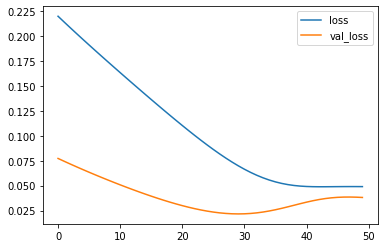

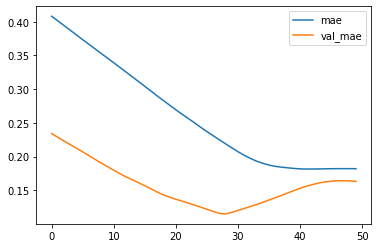

Test MSE: 883941.353
bestmse=540505.1994585395
Test MAE: 786.334
bestmae=580.81703
Test MAPE: 43.552
bestmape=25.73123


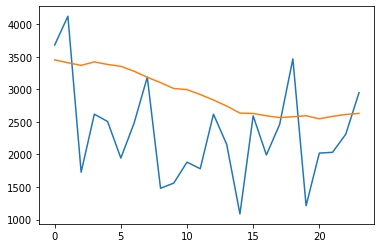

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3452.50764954 3408.70388377 3368.68036634 3421.98288661 3382.32793945
 3354.04659158 3278.47490937 3185.45575052 3103.56156027 3013.43515438
 2996.02182323 2920.69590235 2836.73318499 2743.68820184 2635.78936344
 2629.43701398 2594.17592943 2566.68624008 2579.38936085 2594.91220915
 2547.69475675 2585.33038646 2614.46910137 2630.06640977]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 29,249
Traina




 21%|██        | 27/128 [02:10<08:34,  5.09s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


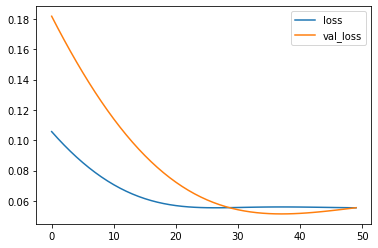

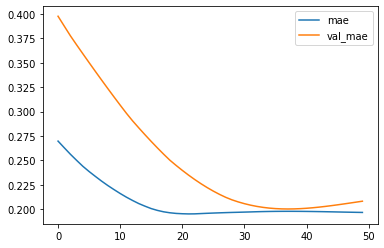

Test MSE: 1284719.417
bestmse=540505.1994585395
Test MAE: 1001.991
bestmae=580.81703
Test MAPE: 55.578
bestmape=25.73123


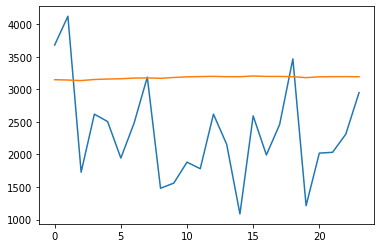

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3148.36587453 3143.50760478 3134.90093666 3151.86291629 3158.36002535
 3163.17582846 3173.13239056 3175.64236987 3169.62200624 3182.43875396
 3192.09145004 3196.0658111  3199.91678935 3194.20014828 3194.35997206
 3205.42597514 3198.68253088 3198.8212648  3194.27503878 3179.94068253
 3192.73504919 3194.87904066 3195.60369945 3193.35483259]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,281
Trainab




 22%|██▏       | 28/128 [02:14<07:56,  4.77s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


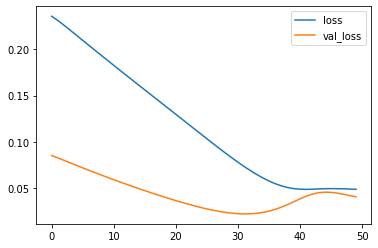

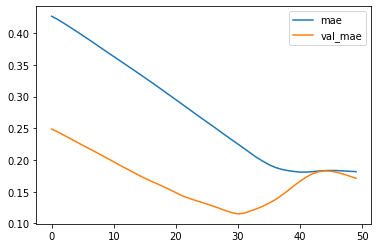

Test MSE: 930478.210
bestmse=540505.1994585395
Test MAE: 824.080
bestmae=580.81703
Test MAPE: 45.652
bestmape=25.73123


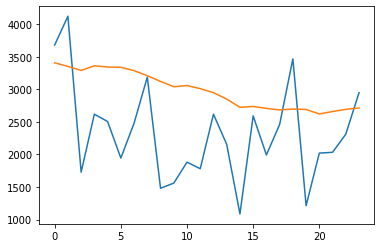

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3407.63346618 3353.29510421 3290.64432776 3361.5370757  3343.47957152
 3338.97925538 3287.7842856  3209.98826963 3122.55949968 3040.75612491
 3058.30474675 3011.26433432 2949.70707387 2850.84932584 2724.6255582
 2737.37745821 2708.06701165 2684.56416512 2697.88133055 2691.51147795
 2622.55124909 2659.72132391 2693.08546954 2714.61777788]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Trainab




 23%|██▎       | 29/128 [02:19<07:55,  4.80s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


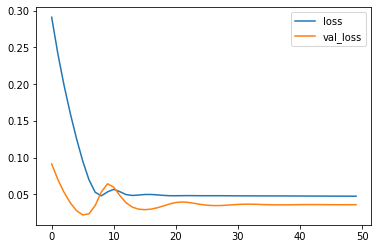

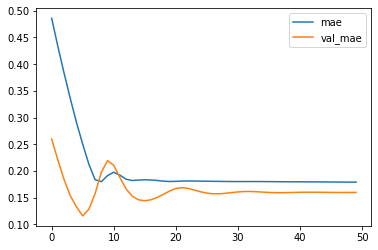

Test MSE: 836725.783
bestmse=540505.1994585395
Test MAE: 769.406
bestmae=580.81703
Test MAPE: 42.332
bestmape=25.73123


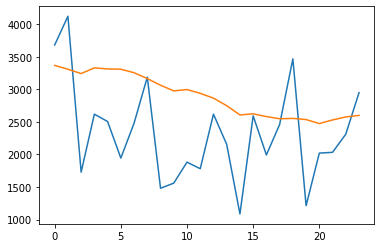

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3367.80764818 3309.17384291 3242.39820707 3330.4817667  3313.72523379
 3309.32175881 3255.76228666 3165.51077634 3063.40461725 2976.93565077
 2996.7987045  2939.30776834 2865.22012305 2749.2669698  2607.25737631
 2624.34632546 2581.85543883 2548.32903045 2553.89847296 2535.94584417
 2474.54998565 2530.19390988 2576.76130706 2599.73274672]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Traina




 23%|██▎       | 30/128 [02:24<08:05,  4.95s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


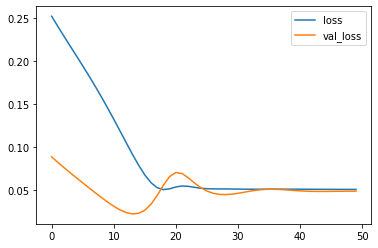

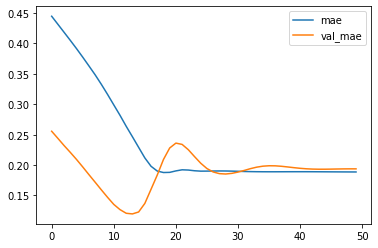

Test MSE: 1139064.038
bestmse=540505.1994585395
Test MAE: 932.769
bestmae=580.81703
Test MAPE: 51.939
bestmape=25.73123


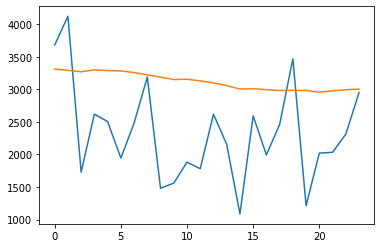

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3311.58640718 3292.11946964 3269.81888813 3299.84179866 3288.42013747
 3283.42786825 3258.11717665 3222.99181318 3187.18870509 3150.84156489
 3155.4083069  3130.09087229 3098.85522354 3057.25039762 3005.22575021
 3010.54555774 2995.67391241 2982.30208552 2986.26525605 2983.1996237
 2957.40544367 2977.92500871 2994.76303166 3003.1291033 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainabl




 24%|██▍       | 31/128 [02:29<07:57,  4.93s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


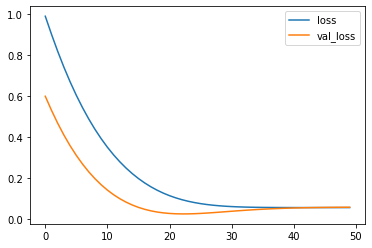

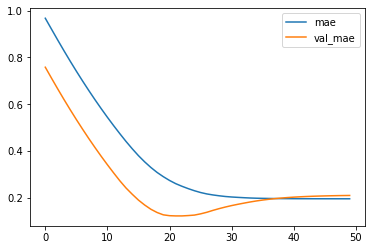

Test MSE: 1306587.823
bestmse=540505.1994585395
Test MAE: 1009.195
bestmae=580.81703
Test MAPE: 56.100
bestmape=25.73123


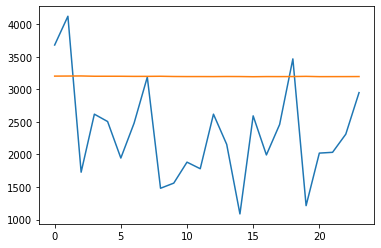

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3203.41612661 3204.51810724 3205.78851974 3201.40900397 3201.37342381
 3201.15076089 3199.42469281 3199.67461473 3201.16783363 3197.68399096
 3196.51357591 3196.57885402 3196.11186445 3197.56204283 3196.83824486
 3194.18278861 3196.47254395 3196.05132079 3196.99433845 3199.66041136
 3195.39251399 3195.74286377 3196.05964196 3196.75991112]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 1,937
Trainab




 25%|██▌       | 32/128 [02:34<08:09,  5.10s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


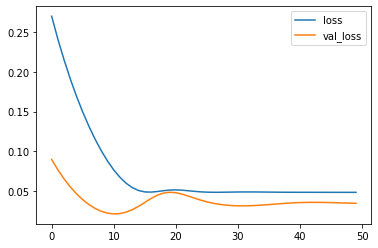

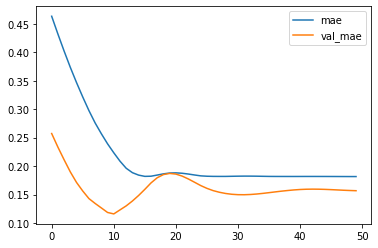

Test MSE: 811669.359
bestmse=540505.1994585395
Test MAE: 754.474
bestmae=580.81703
Test MAPE: 41.546
bestmape=25.73123


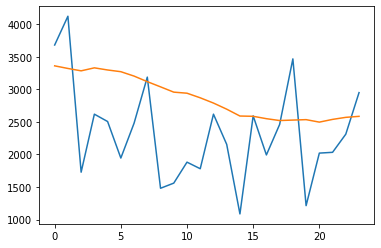

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3361.14798945 3321.11041212 3284.48078269 3330.48850971 3297.66552681
 3271.31727189 3203.8204205  3118.40078175 3038.59549111 2957.29569036
 2941.01188576 2870.26748413 2789.61644739 2695.74910349 2590.35967052
 2586.27785164 2549.71048748 2521.1429202  2528.3780306  2534.96437699
 2496.81470007 2538.78436607 2570.16965234 2585.55620569]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Traina




 26%|██▌       | 33/128 [02:39<07:58,  5.04s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


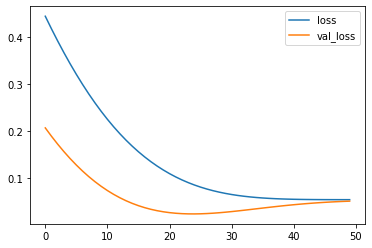

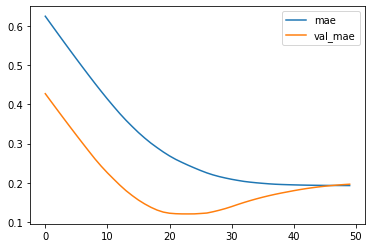

Test MSE: 1166987.912
bestmse=540505.1994585395
Test MAE: 947.581
bestmae=580.81703
Test MAPE: 52.801
bestmape=25.73123


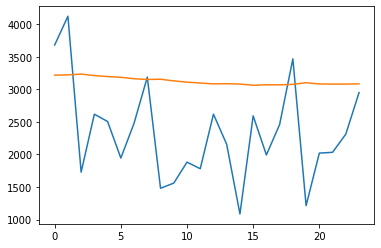

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3217.7094509  3222.4014408  3234.63240713 3211.59855872 3196.67555171
 3185.32232493 3163.10968953 3151.65517408 3155.59424192 3130.10593647
 3110.70241195 3097.40174538 3084.20208055 3086.88522619 3081.30803639
 3062.64825195 3070.50773674 3068.94737464 3076.96840483 3102.09230059
 3082.65405673 3080.91263753 3080.71752053 3084.65113658]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 1,937
Trainab




 27%|██▋       | 34/128 [02:44<07:45,  4.95s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


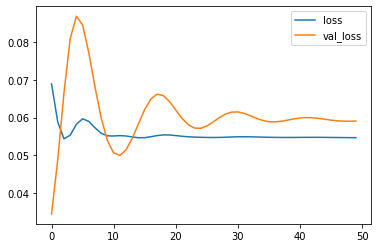

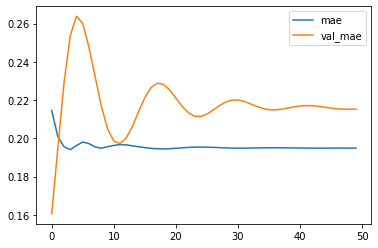

Test MSE: 1369511.020
bestmse=540505.1994585395
Test MAE: 1036.440
bestmae=580.81703
Test MAPE: 57.568
bestmape=25.73123


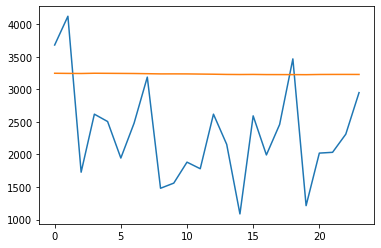

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3247.2465775  3245.18508035 3243.74408394 3247.57698518 3246.32565397
 3244.97905976 3243.63404369 3240.71130586 3237.48154569 3237.80119324
 3237.24582714 3234.82350701 3232.57650524 3229.3575052  3228.017654
 3229.32895499 3227.04522532 3226.81567591 3226.43605858 3225.47051638
 3228.62280363 3229.31245613 3229.4999693  3229.05378264]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Trainabl




 27%|██▋       | 35/128 [02:49<07:36,  4.91s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


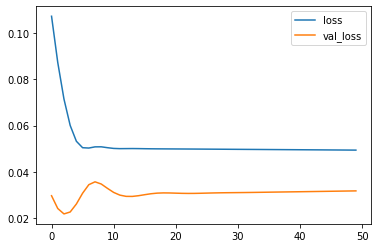

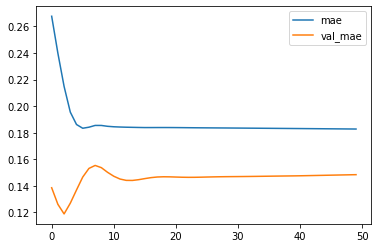

Test MSE: 738892.797
bestmse=540505.1994585395
Test MAE: 714.435
bestmae=580.81703
Test MAPE: 38.941
bestmape=25.73123


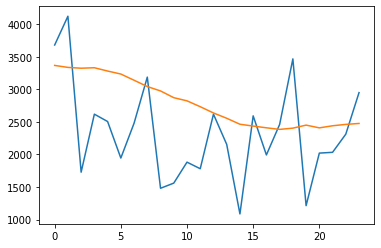

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3367.65212846 3337.33969873 3324.85350215 3332.15589923 3281.48717147
 3235.30369568 3140.07985824 3043.25993508 2975.64759165 2872.16313183
 2823.74814886 2733.65574497 2637.48530316 2556.08837432 2464.19687694
 2436.20906538 2409.61806196 2385.21954232 2404.36310214 2450.84513563
 2408.63932067 2440.74869186 2462.03753436 2476.27519292]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,281
Trainab




 28%|██▊       | 36/128 [02:54<07:54,  5.15s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


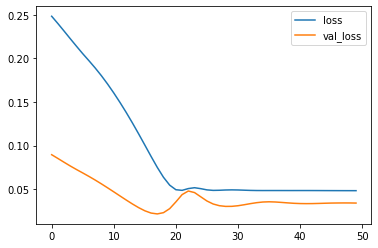

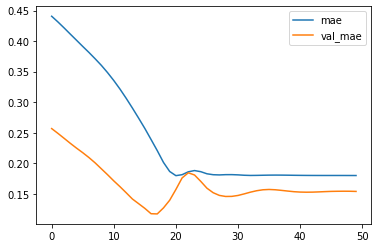

Test MSE: 788188.885
bestmse=540505.1994585395
Test MAE: 741.804
bestmae=580.81703
Test MAPE: 40.751
bestmape=25.73123


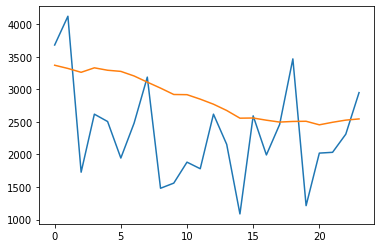

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3370.55291563 3321.14340985 3261.94878668 3330.75091338 3293.63951713
 3276.08171332 3205.68393129 3111.00053924 3019.23644179 2921.23118287
 2918.37903148 2849.69038826 2772.15089375 2675.57687539 2557.43755096
 2560.05613583 2526.41179645 2497.63548267 2507.11931646 2509.91938883
 2455.33110493 2494.47057021 2527.59454978 2546.00168639]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Traina




 29%|██▉       | 37/128 [03:00<07:57,  5.25s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


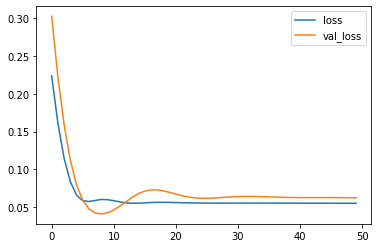

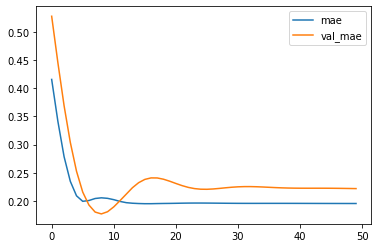

Test MSE: 1446851.273
bestmse=540505.1994585395
Test MAE: 1068.766
bestmae=580.81703
Test MAPE: 59.263
bestmape=25.73123


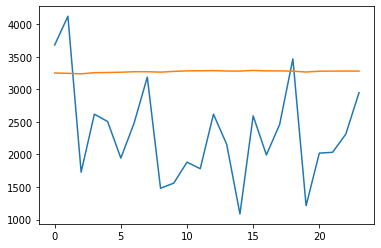

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3251.6786027  3246.40441811 3238.49256736 3256.38250047 3258.93623763
 3263.0448851  3271.05458128 3271.13478011 3264.33552665 3276.16851169
 3283.39845723 3285.62393874 3288.17824978 3281.31572676 3280.86207974
 3291.06712908 3283.21338302 3283.96544427 3279.52868462 3266.43475598
 3279.27158928 3280.14545518 3281.44714379 3279.5301193 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainab




 30%|██▉       | 38/128 [03:05<07:40,  5.12s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


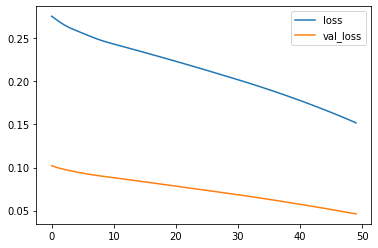

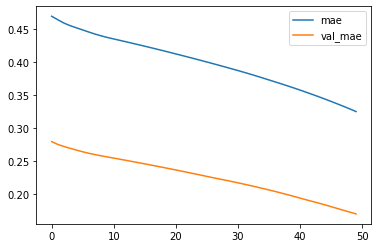

Test MSE: 1068482.473
bestmse=540505.1994585395
Test MAE: 816.790
bestmae=580.81703
Test MAPE: 30.942
bestmape=25.73123


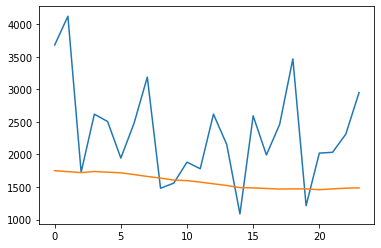

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1751.19116539 1736.03660041 1721.49148911 1739.05431432 1727.92009202
 1718.50914016 1691.25653231 1662.46838239 1637.06569169 1606.33680913
 1598.84980412 1575.0525246  1549.40701367 1523.48410663 1490.21594134
 1486.4585762  1477.20059751 1469.08297724 1471.35691519 1472.09688923
 1458.60063939 1471.88348001 1482.14860673 1487.2928807 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Traina




 30%|███       | 39/128 [03:10<07:28,  5.04s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


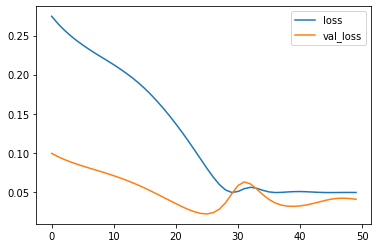

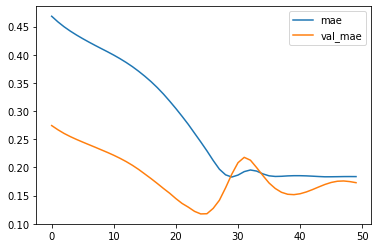

Test MSE: 941377.737
bestmse=540505.1994585395
Test MAE: 832.281
bestmae=580.81703
Test MAPE: 46.242
bestmape=25.73123


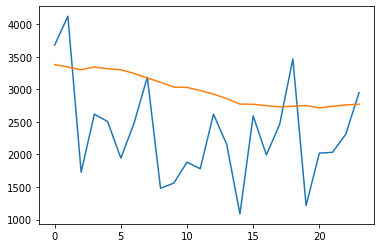

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3380.85007167 3342.168414   3302.20242739 3342.8607924  3316.07524586
 3301.29599416 3244.54621565 3173.8668052  3108.14967906 3035.34492803
 3029.72527158 2982.31141096 2927.06747657 2859.26274204 2773.58572102
 2770.90056682 2749.35391164 2731.62150681 2740.41410995 2752.76214647
 2715.65404999 2740.7455219  2760.72205913 2772.15448046]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 29,249
Traina




 31%|███▏      | 40/128 [03:15<07:24,  5.05s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


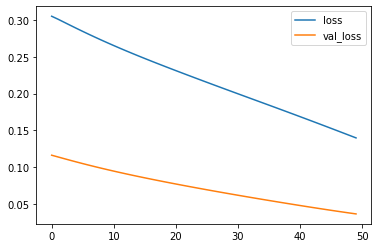

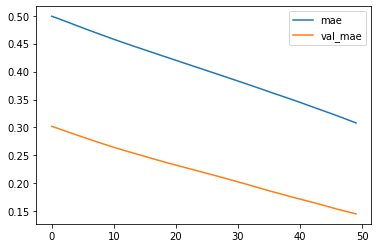

Test MSE: 838207.471
bestmse=540505.1994585395
Test MAE: 699.641
bestmae=580.81703
Test MAPE: 27.379
bestmape=25.73123


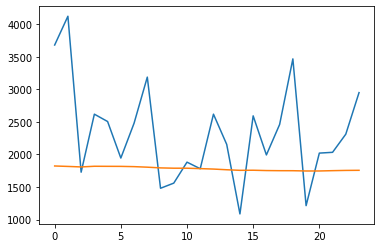

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1823.19278044 1816.40026999 1808.59444237 1818.82502908 1817.84693339
 1817.15484193 1813.18550226 1804.85135233 1793.80070037 1789.13546732
 1788.90986329 1782.75420898 1775.85581887 1765.29489622 1756.4620502
 1757.9359726  1752.90762109 1750.98270583 1750.55832636 1746.4190484
 1746.62521246 1751.3846325  1755.15526846 1756.72144103]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,961
Trainable




 32%|███▏      | 41/128 [03:19<07:12,  4.98s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


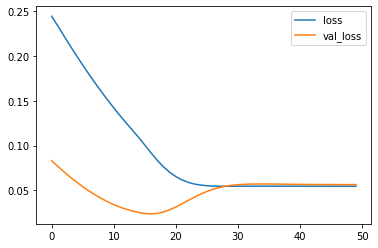

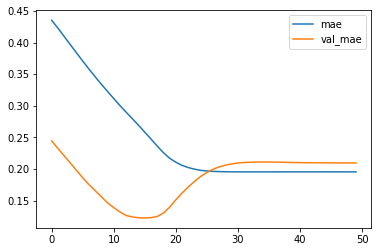

Test MSE: 1310186.211
bestmse=540505.1994585395
Test MAE: 1008.815
bestmae=580.81703
Test MAPE: 56.163
bestmape=25.73123


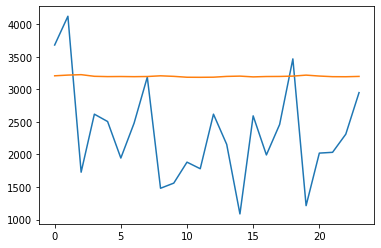

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3208.20538807 3219.31486207 3225.79977632 3200.56053197 3195.92449474
 3197.35788733 3194.94302756 3197.48672193 3208.12145907 3199.74677932
 3186.14482915 3185.15303224 3186.89746428 3199.05913538 3203.40680116
 3191.69346875 3197.25846374 3198.31898201 3203.44941127 3218.69393092
 3204.47277123 3194.81792313 3193.88681334 3198.77578533]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 1,937
Trainab




 33%|███▎      | 42/128 [03:25<07:22,  5.15s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


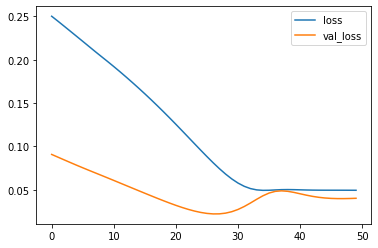

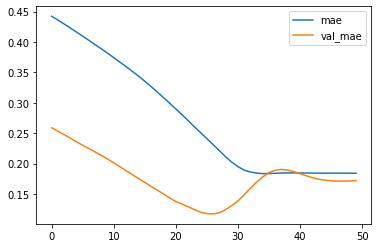

Test MSE: 929859.061
bestmse=540505.1994585395
Test MAE: 827.684
bestmae=580.81703
Test MAPE: 45.921
bestmape=25.73123


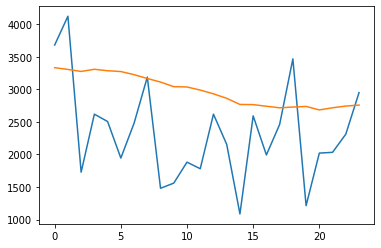

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3332.9128384  3305.93547463 3275.28058589 3308.37558484 3286.13095599
 3273.7578125  3225.75099707 3166.70285511 3112.2557441  3041.43343914
 3036.7774598  2988.76160586 2931.50423622 2862.5329603  2768.39761746
 2765.49023074 2740.73246628 2716.75172657 2728.40336758 2737.95319682
 2684.23963964 2717.11111486 2743.5618062  2758.42513037]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable




 34%|███▎      | 43/128 [03:30<07:07,  5.02s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


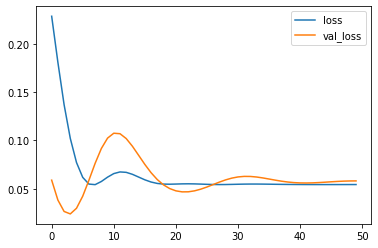

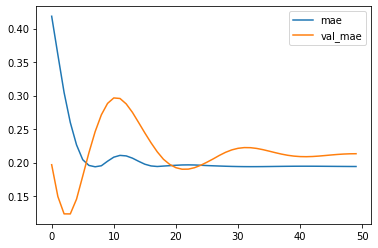

Test MSE: 1345644.600
bestmse=540505.1994585395
Test MAE: 1026.145
bestmae=580.81703
Test MAPE: 57.038
bestmape=25.73123


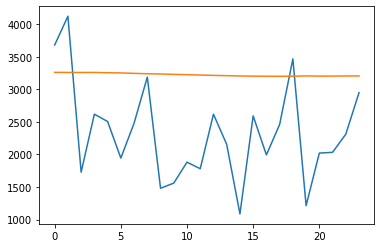

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3261.23503149 3259.64626265 3259.70250225 3260.08728445 3255.38195199
 3252.27801359 3246.01647961 3239.79755574 3236.35273647 3230.11645293
 3225.81369275 3220.12201518 3214.3990615  3210.3123647  3205.56643069
 3202.85817808 3201.6457268  3200.75679672 3202.11816818 3206.18836612
 3203.42875183 3204.14580679 3205.26457322 3206.2433145 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Traina




 34%|███▍      | 44/128 [03:35<06:56,  4.96s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


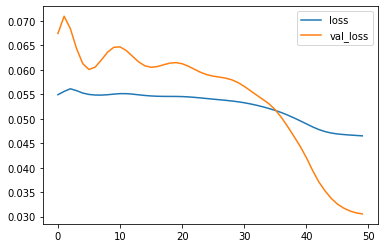

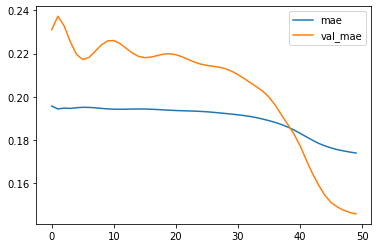

Test MSE: 707999.225
bestmse=540505.1994585395
Test MAE: 701.890
bestmae=580.81703
Test MAPE: 37.804
bestmape=25.73123


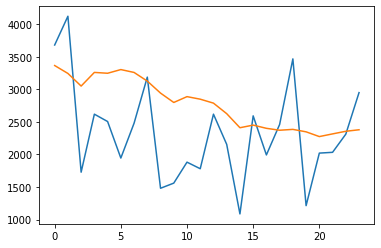

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3366.07440668 3244.56874019 3050.67423749 3260.30808228 3247.40496659
 3303.99162155 3259.84525329 3127.11648583 2942.58028209 2798.7472055
 2888.29069936 2849.19255298 2788.44517154 2626.62402946 2410.75332725
 2450.97196168 2401.63691598 2372.17812312 2385.42054152 2347.70772582
 2274.81330705 2316.0086742  2356.23649061 2379.5676055 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Trainab




 35%|███▌      | 45/128 [03:40<06:53,  4.98s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


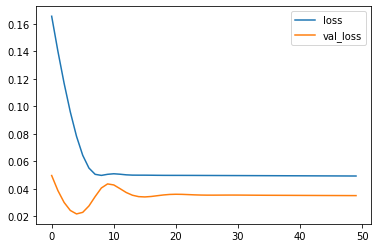

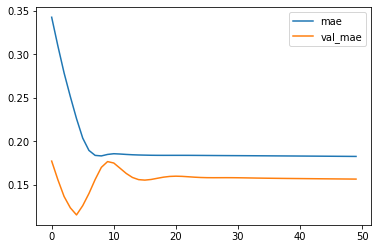

Test MSE: 811493.736
bestmse=540505.1994585395
Test MAE: 754.997
bestmae=580.81703
Test MAPE: 41.651
bestmape=25.73123


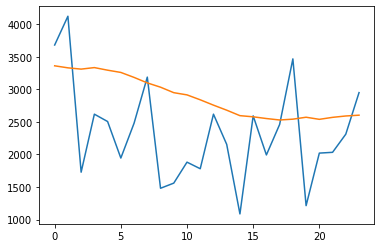

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3361.7162677  3330.61404455 3311.01253366 3334.31638956 3294.63977867
 3259.98255253 3183.71418786 3099.14158642 3033.28816533 2949.05644476
 2915.24926877 2839.66309625 2757.53017461 2680.30975378 2596.15981019
 2578.39842474 2551.96925366 2529.61185867 2542.23650223 2571.94866025
 2539.67516124 2570.14526272 2591.18863082 2603.43537867]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable




 36%|███▌      | 46/128 [03:45<06:59,  5.12s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


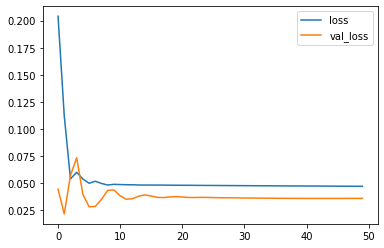

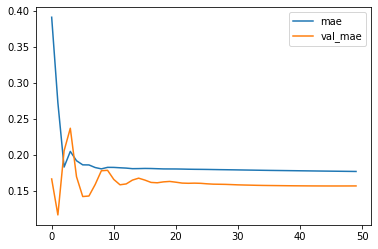

Test MSE: 837920.294
bestmse=540505.1994585395
Test MAE: 754.087
bestmae=580.81703
Test MAPE: 41.036
bestmape=25.73123


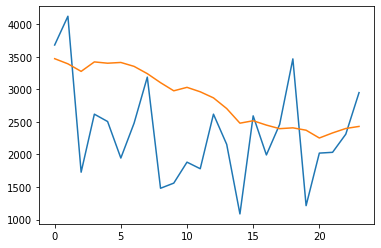

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3471.14849615 3392.27847588 3276.13321847 3421.67127329 3401.74035901
 3413.20979518 3353.0324136  3241.40827525 3102.83905351 2977.80836892
 3030.9801895  2962.7311334  2869.34283042 2705.15948147 2480.64696139
 2517.99421966 2451.23106557 2396.19673848 2409.07073009 2372.62760955
 2252.9234755  2330.907722   2399.16251683 2430.7710399 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Traina




 37%|███▋      | 47/128 [03:51<07:22,  5.46s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


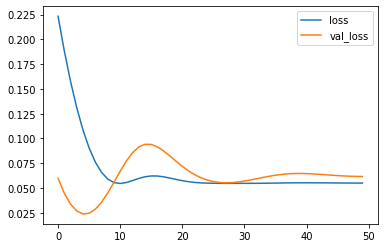

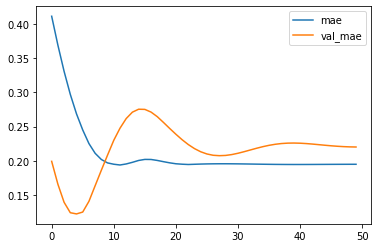

Test MSE: 1427915.570
bestmse=540505.1994585395
Test MAE: 1059.556
bestmae=580.81703
Test MAPE: 58.853
bestmape=25.73123


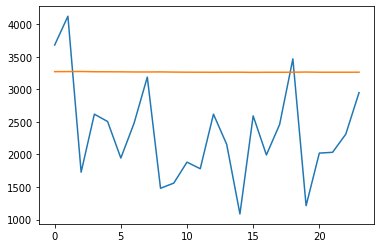

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3271.90549225 3272.92096144 3274.4583686  3270.62202412 3269.96264344
 3269.12220567 3267.20776361 3266.97491443 3268.17603171 3265.24712473
 3263.75247115 3263.21059108 3262.5035789  3263.69709235 3263.35075969
 3261.13417321 3262.8075884  3262.50659174 3263.44573575 3266.17565209
 3263.07486999 3263.09323394 3263.01705223 3263.51919156]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Traina




 38%|███▊      | 48/128 [03:56<07:05,  5.32s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


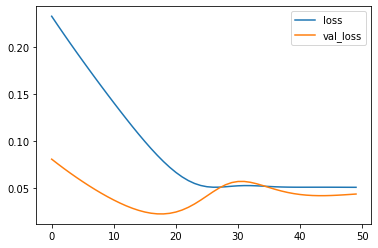

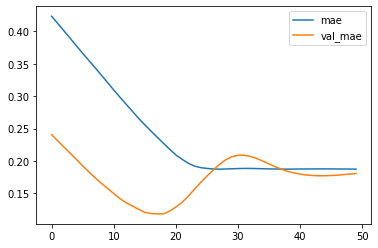

Test MSE: 1006454.519
bestmse=540505.1994585395
Test MAE: 868.785
bestmae=580.81703
Test MAPE: 48.363
bestmape=25.73123


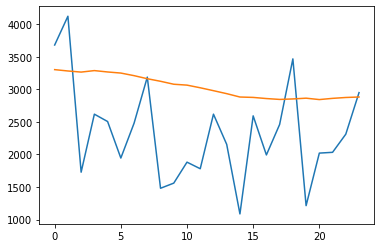

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3302.98346925 3282.30479777 3265.26046729 3288.17523694 3267.13789451
 3250.32368731 3210.51938957 3163.40695602 3123.99690938 3078.657745
 3065.0664115  3024.30216682 2979.7413184  2934.03874862 2882.37592846
 2876.3943013  2858.81540763 2845.45706677 2852.89963245 2864.59833109
 2843.15353847 2861.76468712 2875.28816009 2882.64292312]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 1,937
Trainable




 38%|███▊      | 49/128 [04:01<06:37,  5.03s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


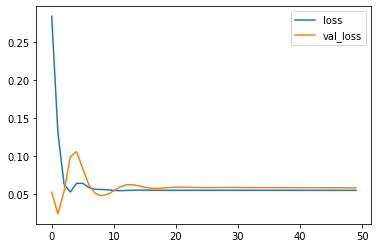

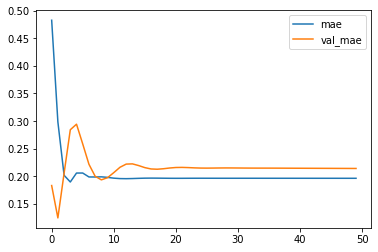

Test MSE: 1353544.949
bestmse=540505.1994585395
Test MAE: 1029.520
bestmae=580.81703
Test MAPE: 57.188
bestmape=25.73123


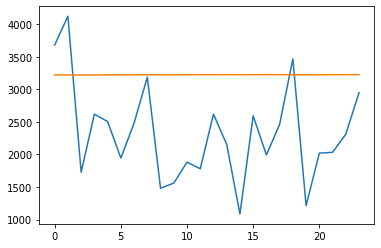

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3221.99657303 3221.53388751 3220.32487947 3220.45572263 3222.85853106
 3223.18578243 3223.76008636 3224.49062735 3223.92765743 3223.59753668
 3225.32762188 3226.041664   3226.11354166 3225.93879718 3225.10008103
 3225.60222036 3226.46747816 3225.47912449 3225.42647159 3224.38216525
 3223.70355982 3225.55430192 3225.6201539  3225.50093168]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 39%|███▉      | 50/128 [04:06<06:49,  5.26s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


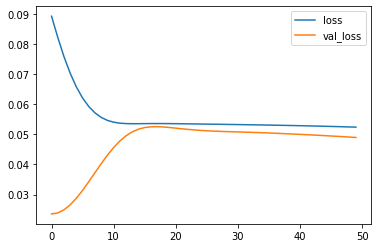

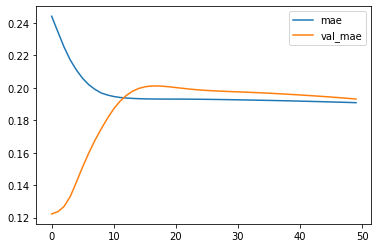

Test MSE: 1134340.272
bestmse=540505.1994585395
Test MAE: 929.310
bestmae=580.81703
Test MAPE: 51.867
bestmape=25.73123


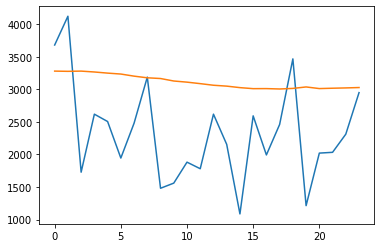

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3280.37457418 3276.88327116 3280.32766002 3266.84335393 3249.55440986
 3235.22952253 3202.98156089 3177.57531935 3166.50156897 3128.25892454
 3110.84272403 3087.82107043 3063.21007413 3049.65001673 3026.606269
 3010.84669787 3011.66618925 3005.78197712 3014.52608794 3037.05593193
 3012.09042525 3017.46145099 3022.09332764 3027.97395307]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,961
Trainable




 40%|███▉      | 51/128 [04:12<06:55,  5.39s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


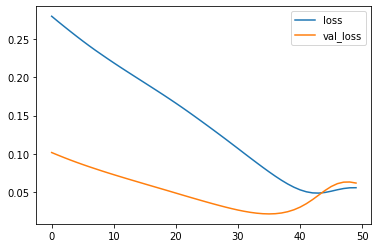

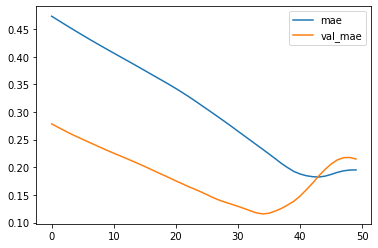

Test MSE: 1436960.597
bestmse=540505.1994585395
Test MAE: 1034.855
bestmae=580.81703
Test MAPE: 57.347
bestmape=25.73123


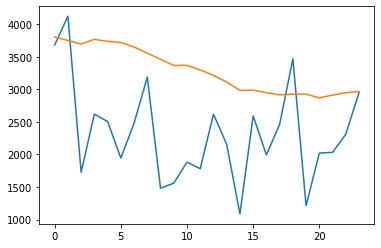

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3802.88612711 3751.7603091  3694.71871591 3768.54151857 3736.41751361
 3720.39295638 3650.33849418 3555.60747063 3462.46923304 3366.59404916
 3368.38453454 3298.68601739 3216.34291458 3110.92277938 2984.07478082
 2987.82059675 2948.41987556 2916.02959329 2926.3862887  2927.30319512
 2868.364663   2912.61447197 2948.71843326 2967.02370733]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Traina




 41%|████      | 52/128 [04:17<06:34,  5.19s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


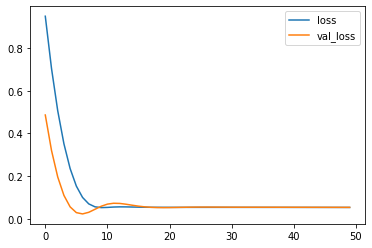

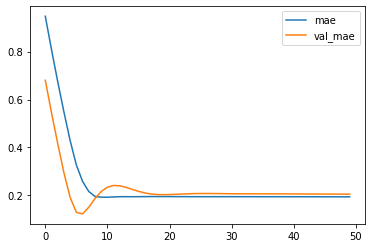

Test MSE: 1258504.135
bestmse=540505.1994585395
Test MAE: 988.674
bestmae=580.81703
Test MAPE: 55.002
bestmape=25.73123


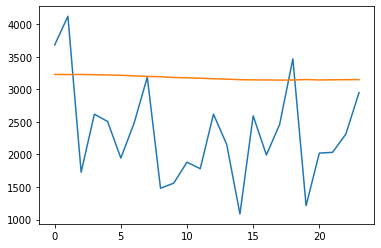

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3229.55362648 3227.52168381 3228.84561002 3225.2735343  3220.63620585
 3216.67102677 3207.60626411 3199.27778119 3193.56099665 3181.97162092
 3177.89625812 3170.89342302 3163.1543082  3157.21859092 3148.60618407
 3145.43897611 3144.82722694 3142.1554153  3143.46642935 3150.99651074
 3144.10443324 3146.91010088 3148.68953919 3149.97745484]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,601
Trainab




 41%|████▏     | 53/128 [04:23<06:39,  5.33s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


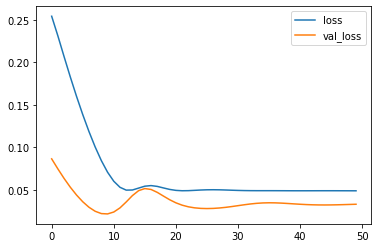

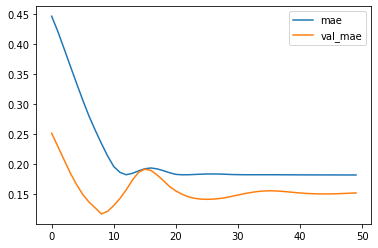

Test MSE: 768632.795
bestmse=540505.1994585395
Test MAE: 730.715
bestmae=580.81703
Test MAPE: 40.049
bestmape=25.73123


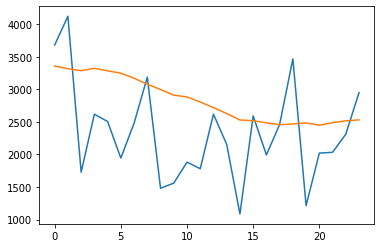

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3357.62871009 3317.59586722 3286.53854966 3324.16714942 3283.9094916
 3249.4598642  3171.00633264 3078.43264312 2998.75647402 2910.81236565
 2884.04561347 2805.99121094 2719.74433351 2628.74779189 2529.39651263
 2518.61084676 2484.6642195  2457.91138375 2467.71716058 2485.27510786
 2450.1419971  2488.78420097 2516.63456982 2531.0132578 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Trainab




 42%|████▏     | 54/128 [04:28<06:29,  5.26s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


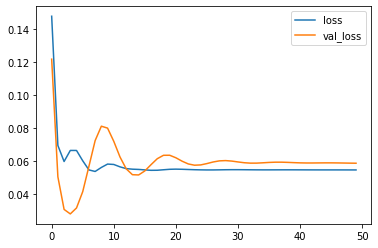

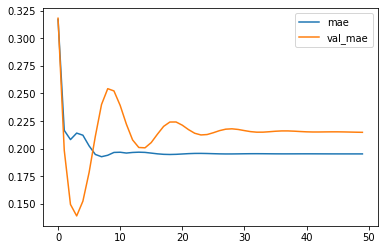

Test MSE: 1364036.647
bestmse=540505.1994585395
Test MAE: 1033.755
bestmae=580.81703
Test MAPE: 57.444
bestmape=25.73123


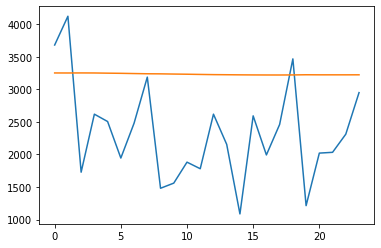

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3251.98705971 3251.54374242 3252.38418019 3251.63584912 3248.79574907
 3246.46080118 3242.85730588 3239.55882436 3238.19357926 3235.07170731
 3232.50233209 3229.23297465 3226.35442507 3224.71788126 3222.99324787
 3221.69729799 3220.94365859 3220.65743917 3221.67376918 3224.28102005
 3223.19066036 3223.15594101 3223.12337369 3223.52709371]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 43%|████▎     | 55/128 [04:33<06:17,  5.17s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


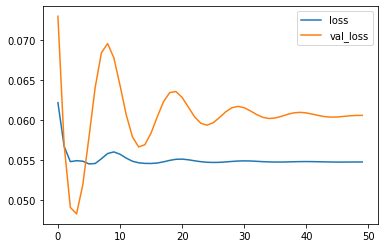

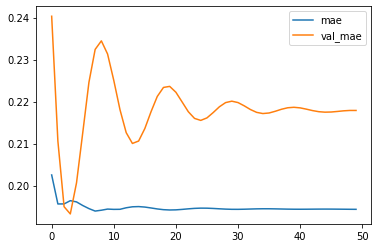

Test MSE: 1403283.944
bestmse=540505.1994585395
Test MAE: 1048.909
bestmae=580.81703
Test MAPE: 58.316
bestmape=25.73123


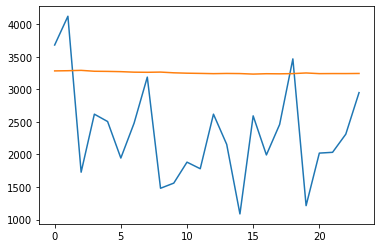

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3283.42514235 3286.45835084 3291.84042364 3278.1235553  3275.92475891
 3271.9714877  3264.05863267 3262.149212   3265.34037918 3254.2326268
 3248.37122613 3245.23845059 3241.2787233  3244.4107815  3242.56348264
 3234.5408743  3240.3077293  3238.68897557 3241.97827512 3251.83799607
 3241.49679524 3242.6743837  3242.48543584 3244.13288325]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,281
Trainabl




 44%|████▍     | 56/128 [04:37<05:55,  4.93s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


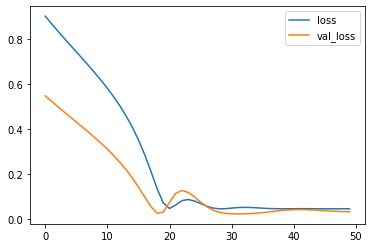

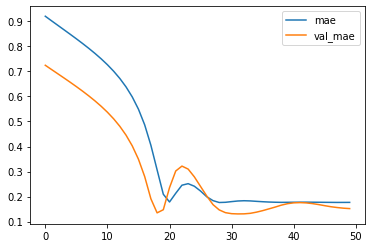

Test MSE: 781133.643
bestmse=540505.1994585395
Test MAE: 732.448
bestmae=580.81703
Test MAPE: 39.839
bestmape=25.73123


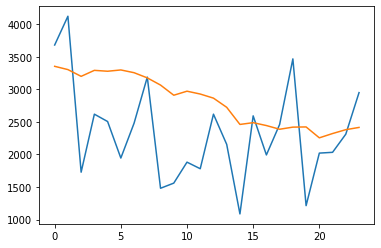

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3353.88188988 3303.62089926 3199.85050696 3292.01358998 3278.3127901
 3298.22849673 3255.92282778 3176.43689775 3065.81101239 2909.92157048
 2971.8950327  2928.20934141 2865.2185449  2724.26200932 2461.27499992
 2488.3294062  2444.20914918 2387.45090604 2419.91062701 2422.80954909
 2255.49213338 2321.53880638 2380.80114663 2415.3856343 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 19,241
Trainab




 45%|████▍     | 57/128 [04:42<05:48,  4.91s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


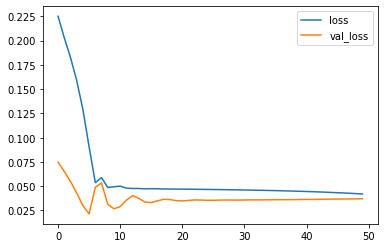

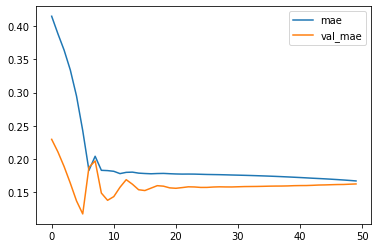

Test MSE: 860277.062
bestmse=540505.1994585395
Test MAE: 780.768
bestmae=580.81703
Test MAPE: 42.886
bestmape=25.73123


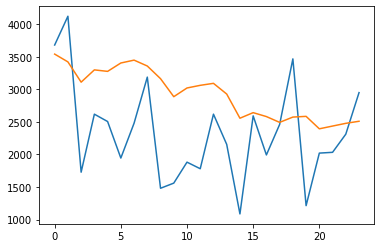

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3541.44312441 3421.94314587 3110.67773539 3299.18213105 3276.22030377
 3404.84372354 3449.02481115 3358.54834241 3164.08111393 2887.50520998
 3021.16967821 3061.89260399 3092.4487865  2928.20245492 2556.82149774
 2642.34342945 2582.08986616 2492.97806865 2574.29035115 2585.35032856
 2394.06207246 2436.41537291 2478.2244978  2509.97835433]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Traina




 45%|████▌     | 58/128 [04:48<06:13,  5.34s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


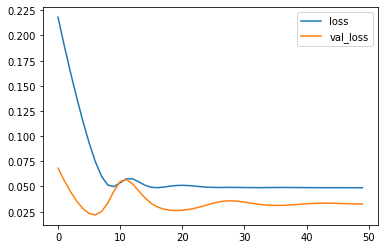

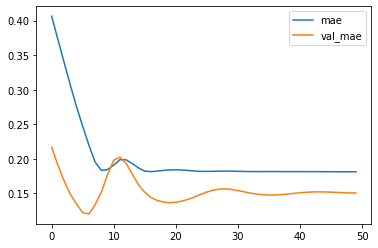

Test MSE: 755997.415
bestmse=540505.1994585395
Test MAE: 724.252
bestmae=580.81703
Test MAPE: 39.541
bestmape=25.73123


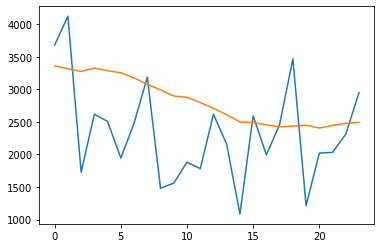

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3360.60926569 3315.81355953 3276.7106787  3326.85345137 3286.1563499
 3254.83045954 3175.13693076 3077.59722674 2990.97847927 2897.47454077
 2877.32512414 2797.80633986 2708.78177112 2609.71326804 2497.82887805
 2490.90810686 2453.61637086 2424.3816756  2435.43318838 2449.84530449
 2405.36522877 2446.50564754 2477.57142973 2493.71850896]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 49,985
Trainab




 46%|████▌     | 59/128 [04:54<06:10,  5.37s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


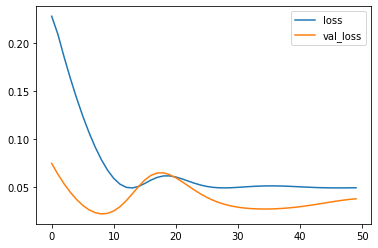

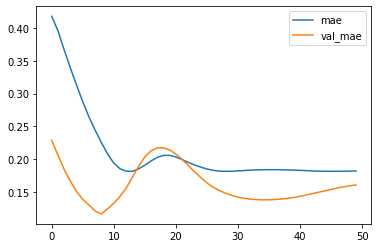

Test MSE: 870337.679
bestmse=540505.1994585395
Test MAE: 774.358
bestmae=580.81703
Test MAPE: 42.850
bestmape=25.73123


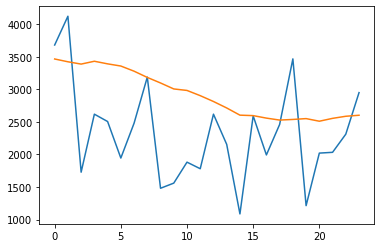

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3466.48950398 3423.7093851  3388.09536833 3431.79354137 3391.7556771
 3358.26542276 3279.11707383 3183.36111218 3098.06299114 3006.44652265
 2983.43663347 2903.33034617 2813.62415916 2714.28191841 2603.80954421
 2596.74659586 2558.3534531  2528.33757252 2537.9244166  2550.88348496
 2510.72596806 2554.710504   2586.76363558 2602.45635045]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Trainab




 47%|████▋     | 60/128 [04:58<05:51,  5.17s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


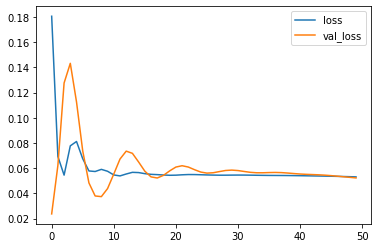

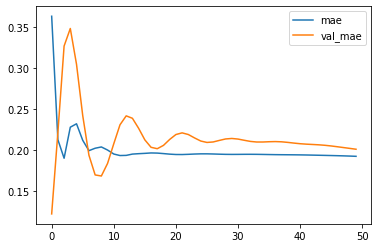

Test MSE: 1211271.952
bestmse=540505.1994585395
Test MAE: 966.597
bestmae=580.81703
Test MAPE: 53.845
bestmape=25.73123


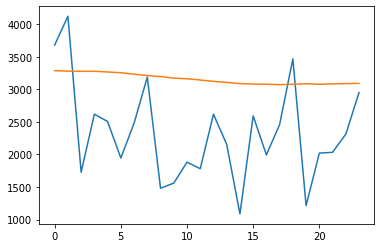

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3287.5352245  3280.26252538 3277.24222904 3277.49014241 3267.03617543
 3255.77003396 3233.13818395 3211.62883055 3196.83494508 3172.84244096
 3162.65059072 3143.52697301 3123.06752121 3107.04784191 3088.68518049
 3082.13484466 3077.94011617 3072.71729326 3076.98375595 3087.11664069
 3077.75260299 3084.59590125 3088.52076572 3091.37420833]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Traina




 48%|████▊     | 61/128 [05:04<05:49,  5.22s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


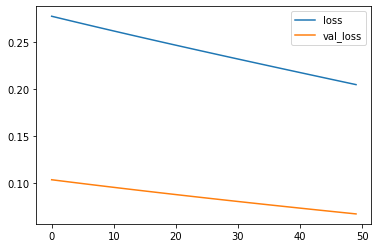

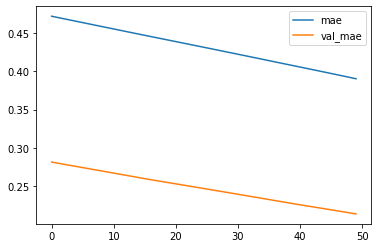

Test MSE: 1557792.857
bestmse=540505.1994585395
Test MAE: 1031.496
bestmae=580.81703
Test MAPE: 39.239
bestmape=25.73123


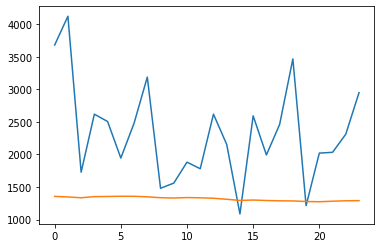

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1355.90184829 1347.79201117 1335.13062177 1352.56341082 1354.85779302
 1357.9434392  1357.30044979 1349.74303767 1336.04783306 1331.05147499
 1338.20965047 1334.24111781 1327.5300974  1311.89399874 1294.39822707
 1300.23597339 1293.06201638 1288.28294118 1286.65636842 1277.55602561
 1274.04951493 1282.2945172  1288.70848633 1290.5570764 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 48%|████▊     | 62/128 [05:08<05:22,  4.89s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


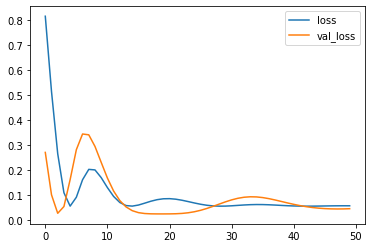

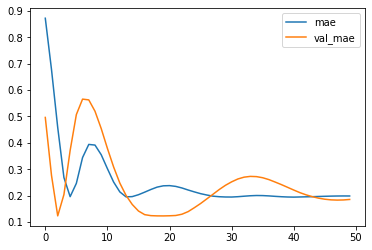

Test MSE: 1035611.455
bestmse=540505.1994585395
Test MAE: 893.388
bestmae=580.81703
Test MAPE: 49.427
bestmape=25.73123


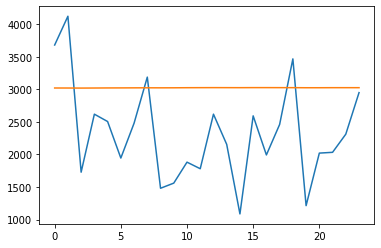

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3020.94185042 3020.59465694 3019.64231384 3020.59408307 3021.86090887
 3022.41641843 3023.34279376 3023.90648103 3023.48296237 3024.04980594
 3025.41074699 3026.09293914 3026.54285598 3026.26739669 3025.87314558
 3026.73452973 3026.72477388 3026.37270248 3026.13569272 3024.9116205
 3025.07230508 3025.8081544  3025.89911336 3025.78964698]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 49,985
Trainab




 49%|████▉     | 63/128 [05:13<05:31,  5.11s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


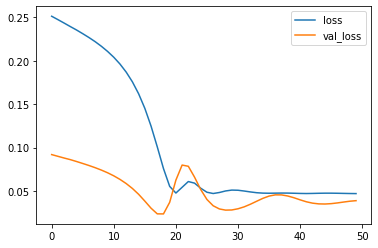

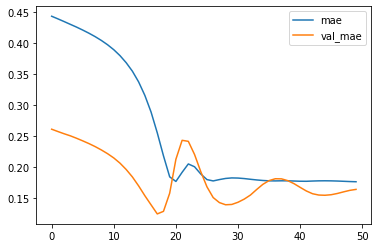

Test MSE: 899597.704
bestmse=540505.1994585395
Test MAE: 791.073
bestmae=580.81703
Test MAPE: 43.391
bestmape=25.73123


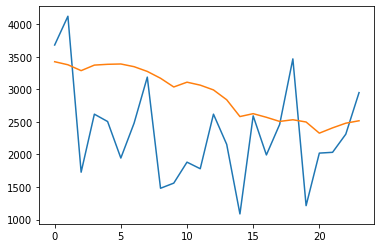

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3424.63346493 3377.87281585 3287.58945554 3372.64396727 3384.80735999
 3389.78054792 3348.35964847 3275.48761076 3170.50591493 3036.60128063
 3110.19668591 3064.82021976 2991.38435131 2840.26437223 2582.3582955
 2626.78657913 2571.08555448 2507.48788673 2533.27532375 2498.75840968
 2327.38141268 2408.56859076 2480.44395363 2517.77227408]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 19,241
Trainab




 50%|█████     | 64/128 [05:18<05:21,  5.02s/it]

{'activation': 'tanh', 'batch_size': 20, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


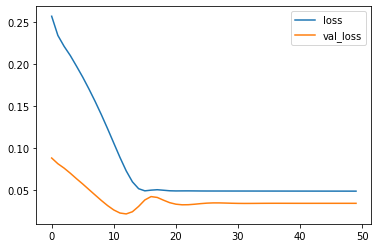

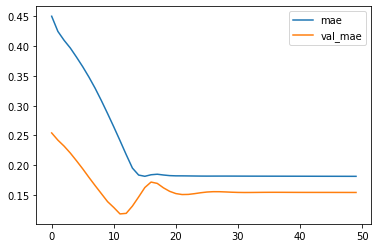

Test MSE: 794718.083
bestmse=540505.1994585395
Test MAE: 742.645
bestmae=580.81703
Test MAPE: 40.874
bestmape=25.73123


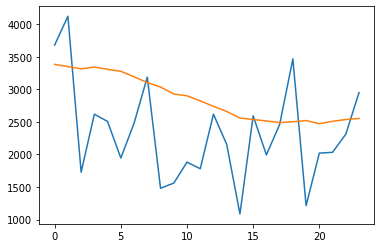

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3383.70624018 3349.35259312 3315.28086144 3342.82535571 3308.1266672
 3277.71854407 3192.93705267 3104.02510661 3035.63200825 2928.98177516
 2900.84906054 2823.93738365 2738.92490816 2660.17238849 2558.93636513
 2537.33978295 2514.52544117 2489.31417316 2501.9815703  2520.82025981
 2472.54458463 2508.79172736 2536.69560993 2553.13679934]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable 




 51%|█████     | 65/128 [05:24<05:25,  5.17s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


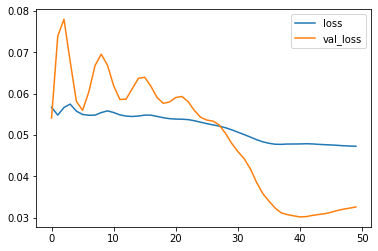

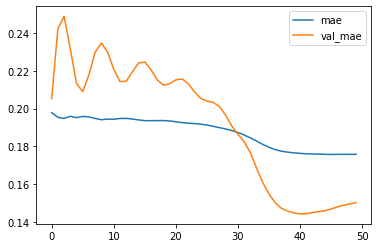

Test MSE: 756212.478
bestmse=540505.1994585395
Test MAE: 722.512
bestmae=580.81703
Test MAPE: 39.151
bestmape=25.73123


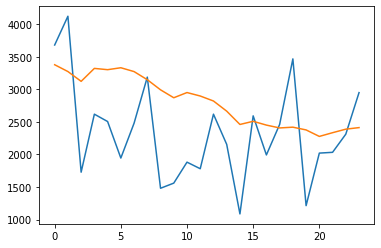

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3378.25673723 3273.71649361 3123.09277165 3321.95816678 3302.28205234
 3332.01687837 3273.10790074 3148.29528809 2992.85289365 2871.13374621
 2951.05165952 2897.88285178 2821.29268754 2665.36565691 2460.83340424
 2509.55985707 2451.1388154  2407.41797435 2419.24062967 2376.98216182
 2277.32099086 2334.42685789 2388.65991408 2412.61267745]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 29,249
Traina




 52%|█████▏    | 66/128 [05:29<05:17,  5.13s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


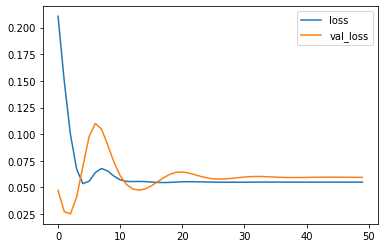

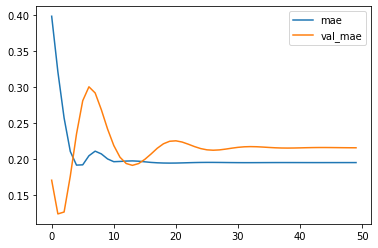

Test MSE: 1377807.405
bestmse=540505.1994585395
Test MAE: 1039.201
bestmae=580.81703
Test MAPE: 57.742
bestmape=25.73123


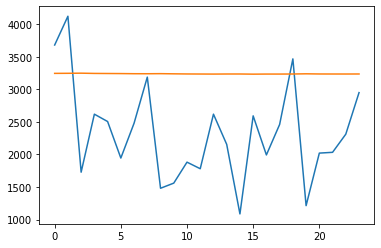

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3245.53198689 3246.65290534 3248.58183771 3244.82540512 3243.59315521
 3242.47352797 3240.37960696 3239.93499845 3241.26968479 3238.61221999
 3236.51629043 3235.59249753 3234.70959312 3235.9474383  3236.01113826
 3233.59800011 3235.01317221 3234.94373351 3235.9111408  3238.89542657
 3236.27110296 3235.89248991 3235.68302608 3236.18114829]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Traina




 52%|█████▏    | 67/128 [05:34<05:16,  5.18s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


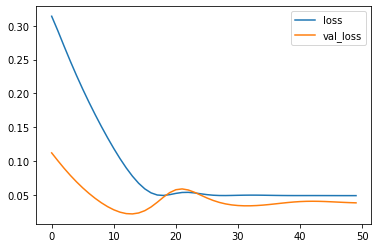

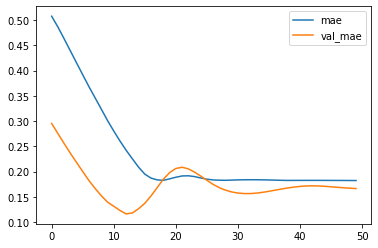

Test MSE: 885676.608
bestmse=540505.1994585395
Test MAE: 801.479
bestmae=580.81703
Test MAPE: 44.329
bestmape=25.73123


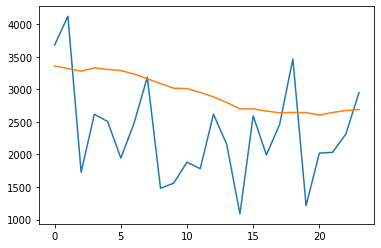

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3357.16817659 3319.47831583 3279.13271189 3330.02295482 3305.95283431
 3289.29342949 3235.03081882 3161.92951864 3088.56064993 3017.1715014
 3011.72917187 2953.27240658 2884.53986204 2798.59182924 2700.24382436
 2701.01568425 2667.02070814 2640.14463305 2645.2678889  2642.78416431
 2604.87938792 2644.58784878 2675.38864487 2690.025289  ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 7,505
Trainabl




 53%|█████▎    | 68/128 [05:38<04:58,  4.97s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


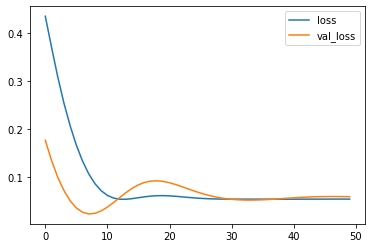

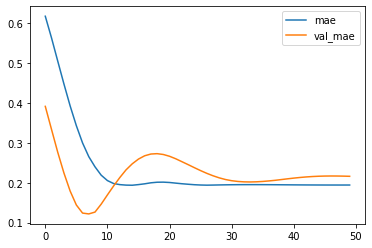

Test MSE: 1378463.660
bestmse=540505.1994585395
Test MAE: 1040.246
bestmae=580.81703
Test MAPE: 57.781
bestmape=25.73123


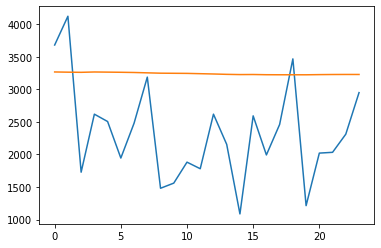

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3267.22799265 3264.00784487 3261.72052848 3266.89729804 3264.65990865
 3262.37503123 3259.18472487 3253.74124759 3248.39719391 3246.91028762
 3245.43414146 3240.73483467 3236.13007355 3230.58817697 3227.14149261
 3228.18852484 3224.92117596 3224.12607419 3224.07700801 3223.8443023
 3226.46618694 3228.17216945 3228.91533566 3228.67732161]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Trainab




 54%|█████▍    | 69/128 [05:43<04:51,  4.95s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


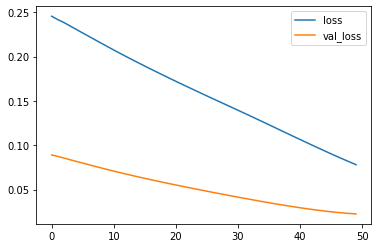

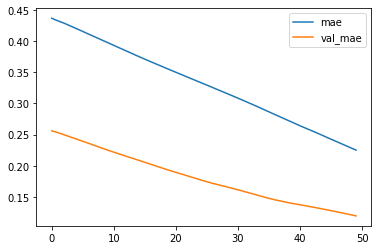

Test MSE: 522573.762
bestmse=522573.7624166564
Test MAE: 572.919
bestmae=572.91894
Test MAPE: 26.214
bestmape=25.73123


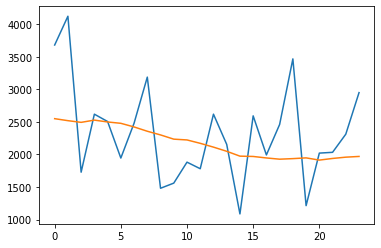

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2549.79513383 2519.21958309 2493.25984055 2527.65337181 2499.22037786
 2478.56623948 2422.86263239 2356.69243312 2300.17622113 2235.25032312
 2223.17867842 2171.28322428 2112.86282822 2048.92019075 1974.27337745
 1969.39466345 1946.50607678 1927.59486401 1936.18345511 1947.66910321
 1913.61587894 1938.77693301 1958.59465075 1969.70928961]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 29,249
Traina




 55%|█████▍    | 70/128 [05:48<04:45,  4.93s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


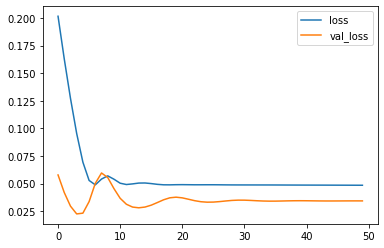

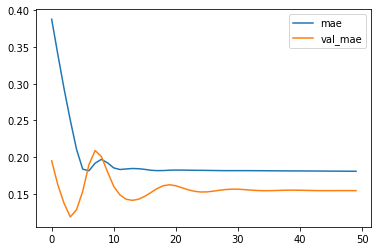

Test MSE: 794558.130
bestmse=522573.7624166564
Test MAE: 741.716
bestmae=572.91894
Test MAPE: 40.709
bestmape=25.73123


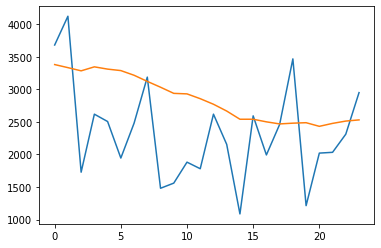

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3380.84763271 3333.67408162 3284.48236084 3345.83446151 3310.95945036
 3288.39919108 3216.58580655 3122.51129431 3032.8277753  2938.50018483
 2930.56982666 2856.74013752 2771.38907665 2666.93563139 2541.07067817
 2541.18086189 2501.10354382 2469.21611822 2480.74193746 2487.92367762
 2432.22552234 2477.42322689 2512.9508757  2530.99805015]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainab




 55%|█████▌    | 71/128 [05:53<04:42,  4.95s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


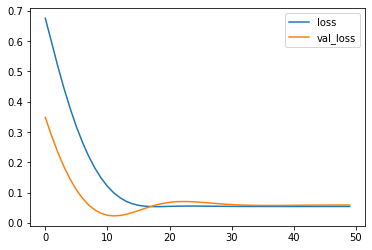

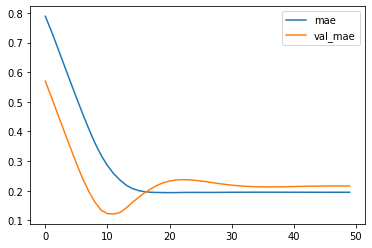

Test MSE: 1382406.418
bestmse=522573.7624166564
Test MAE: 1041.417
bestmae=572.91894
Test MAPE: 57.847
bestmape=25.73123


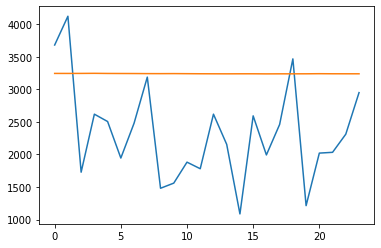

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3244.80718464 3244.56343186 3244.96987778 3246.31188101 3244.32828718
 3243.62557906 3243.05400103 3241.85058826 3241.42721307 3242.14498538
 3240.83999699 3239.65064412 3239.13085818 3238.55110246 3239.09484762
 3239.23056871 3237.91553754 3238.62283665 3238.63861817 3238.98624206
 3240.62508136 3239.41191274 3239.17145973 3239.08136159]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Traina




 56%|█████▋    | 72/128 [05:58<04:40,  5.02s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


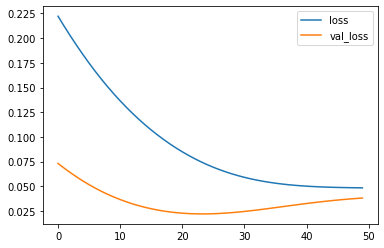

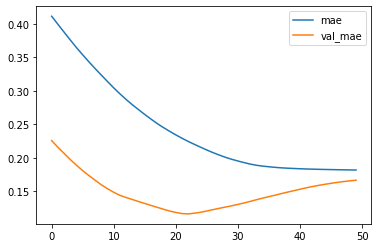

Test MSE: 882097.907
bestmse=522573.7624166564
Test MAE: 800.641
bestmae=572.91894
Test MAPE: 44.148
bestmape=25.73123


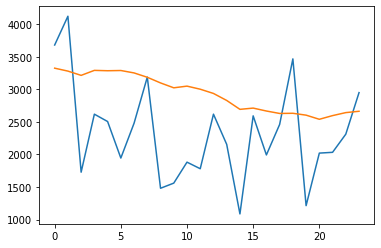

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3325.41245496 3280.420771   3214.89847493 3291.68820369 3286.05506122
 3289.54507303 3252.40541351 3185.57870293 3098.78736299 3023.82169122
 3049.70726061 3002.35007    2937.22919846 2829.60811484 2693.06021911
 2712.22228634 2667.46015179 2629.90787721 2632.58155394 2603.85832345
 2540.40082431 2596.86294872 2643.02447385 2663.50415468]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,961
Trainab




 57%|█████▋    | 73/128 [06:04<04:47,  5.22s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


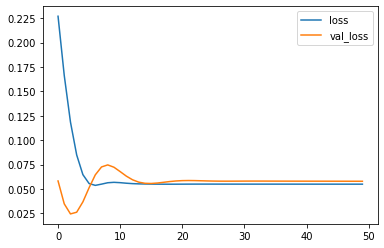

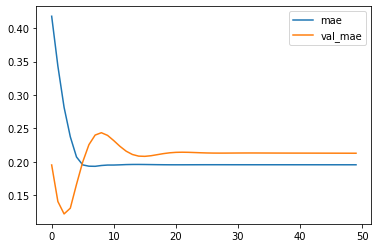

Test MSE: 1342721.045
bestmse=522573.7624166564
Test MAE: 1025.266
bestmae=572.91894
Test MAPE: 56.943
bestmape=25.73123


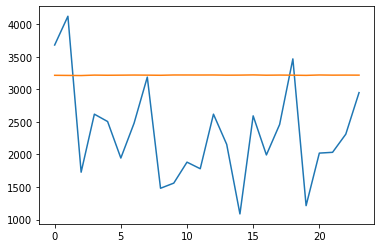

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3215.93374276 3214.12345874 3212.24359256 3218.91688079 3216.63028175
 3218.04028898 3219.84024328 3218.38920408 3216.32110739 3220.80549854
 3220.64309233 3220.30708939 3220.75858438 3218.06453514 3218.91300714
 3221.81121188 3217.49080509 3219.4962061  3217.81934768 3214.85672563
 3220.80707669 3218.36366671 3219.15762073 3218.3963775 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable




 58%|█████▊    | 74/128 [06:10<04:44,  5.27s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


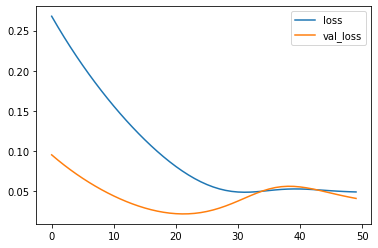

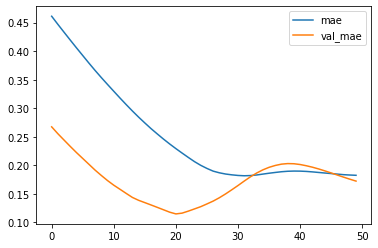

Test MSE: 950720.099
bestmse=522573.7624166564
Test MAE: 830.297
bestmae=572.91894
Test MAPE: 46.002
bestmape=25.73123


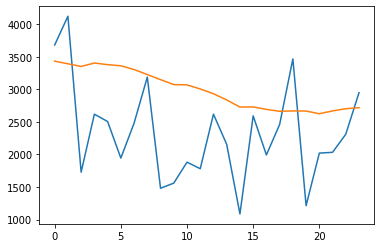

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3432.81216687 3393.06626076 3351.29386377 3404.68103039 3379.46273243
 3361.93735248 3305.1933127  3227.54937321 3149.1981346  3073.61267942
 3068.83274341 3006.36288059 2932.27509183 2837.65855604 2728.15703237
 2730.25554436 2692.44100958 2662.80044228 2668.8203755  2667.31826156
 2625.42248178 2669.11448568 2702.56700784 2718.31151479]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 19,241
Traina




 59%|█████▊    | 75/128 [06:14<04:31,  5.13s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


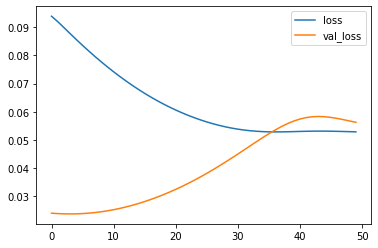

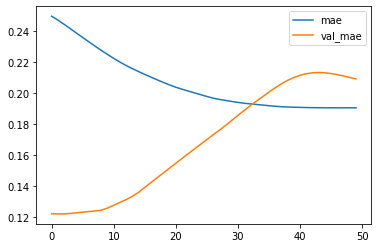

Test MSE: 1302977.726
bestmse=522573.7624166564
Test MAE: 1006.900
bestmae=572.91894
Test MAPE: 56.038
bestmape=25.73123


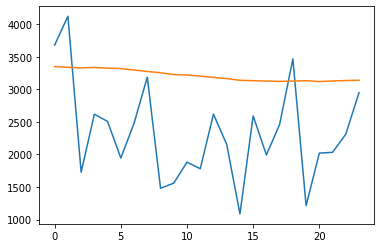

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3350.0233078  3338.91684663 3328.91164875 3335.90458453 3326.23022473
 3318.98062402 3297.33440179 3274.72981077 3255.14293367 3227.62254208
 3220.75729316 3203.34166652 3183.95162803 3164.40004414 3139.10785997
 3133.43827653 3128.20655859 3122.5440051  3127.34431362 3133.72105271
 3119.71653026 3128.53151447 3135.2583164  3140.05274272]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 19,241
Traina




 59%|█████▉    | 76/128 [06:19<04:22,  5.06s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


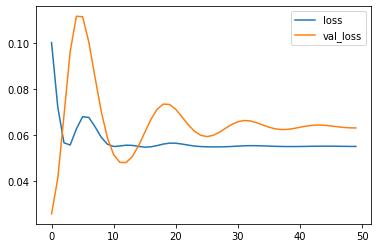

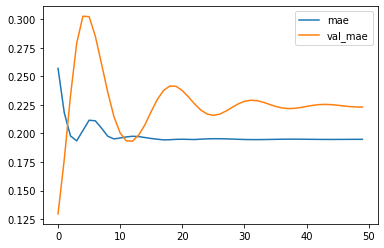

Test MSE: 1462848.057
bestmse=522573.7624166564
Test MAE: 1073.959
bestmae=572.91894
Test MAPE: 59.610
bestmape=25.73123


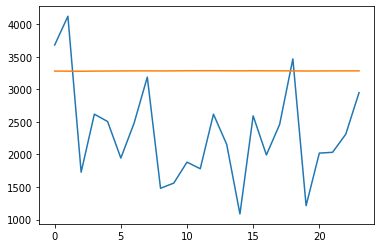

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3280.67643166 3279.70228136 3277.90146625 3280.51330811 3281.61614954
 3282.69517523 3283.96874404 3284.10389125 3282.83060938 3284.00174177
 3285.50328183 3286.09480196 3286.36495292 3285.03241861 3284.21680087
 3285.61748266 3284.6799168  3284.51650631 3283.75727165 3281.53222054
 3282.66246444 3283.37421107 3284.03057891 3283.8840977 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 60%|██████    | 77/128 [06:24<04:09,  4.90s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


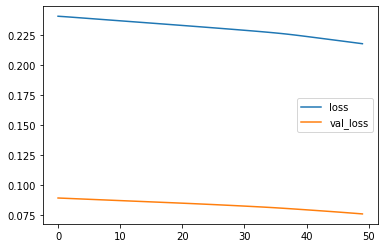

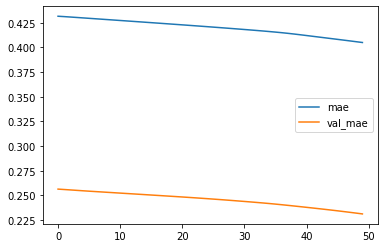

Test MSE: 1758874.053
bestmse=522573.7624166564
Test MAE: 1113.223
bestmae=572.91894
Test MAPE: 42.583
bestmape=25.73123


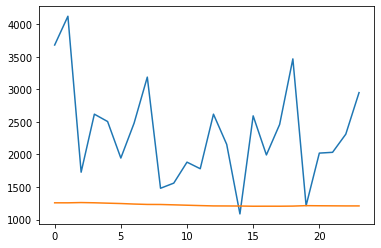

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1257.59833654 1257.42633589 1261.50273883 1257.94452574 1252.00364359
 1246.49865425 1238.52801733 1232.68022823 1231.79258937 1226.39955916
 1220.62223097 1214.94855868 1209.90828136 1209.11536749 1208.15631723
 1204.97243108 1205.39910604 1205.24844631 1207.17036666 1213.94099818
 1212.18356433 1211.09347364 1209.88790885 1209.92807999]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable




 61%|██████    | 78/128 [06:28<03:57,  4.75s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


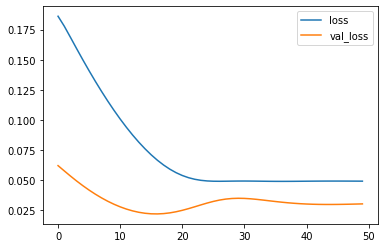

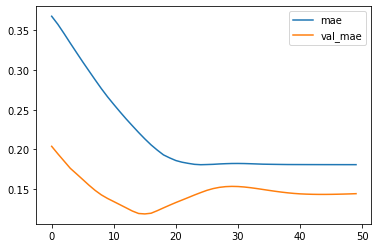

Test MSE: 699512.330
bestmse=522573.7624166564
Test MAE: 694.426
bestmae=572.91894
Test MAPE: 37.416
bestmape=25.73123


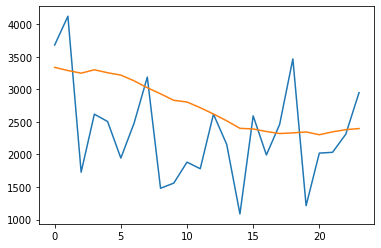

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3337.58388191 3289.32915312 3248.74926531 3300.66659838 3255.43431795
 3219.00339222 3131.16918063 3025.12051046 2931.55531096 2831.69557977
 2805.7567836  2718.36388075 2621.55600893 2517.41001642 2401.47336203
 2391.80058038 2352.46972829 2321.3481369  2331.57714546 2346.07491219
 2303.0148865  2347.65865964 2380.94977987 2398.01821303]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 2336      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 19,241
Traina




 62%|██████▏   | 79/128 [06:33<03:54,  4.79s/it]

{'activation': 'tanh', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


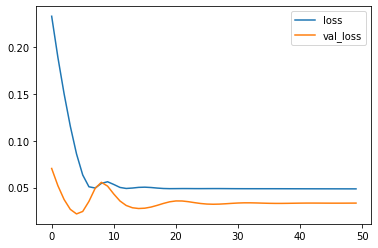

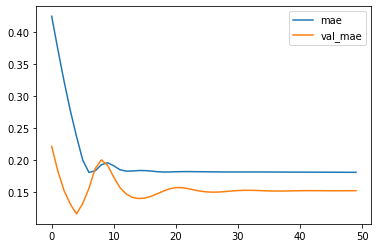

Test MSE: 773201.076
bestmse=522573.7624166564
Test MAE: 731.528
bestmae=572.91894
Test MAPE: 40.022
bestmape=25.73123


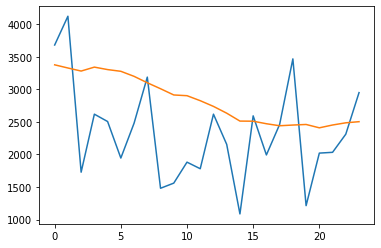

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3376.85089058 3328.18756384 3281.09220302 3341.65293211 3303.70984966
 3277.39430553 3199.99827939 3101.30925018 3009.69751614 2913.89722276
 2902.72390532 2826.04421681 2738.30053377 2634.1747703  2512.83151001
 2510.97689426 2472.05004913 2441.03261578 2451.96275431 2460.81159705
 2409.3088876  2452.58311158 2486.35815066 2503.64207333]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Traina




 62%|██████▎   | 80/128 [06:38<03:59,  4.99s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


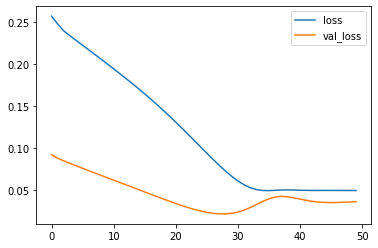

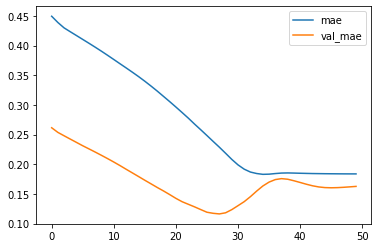

Test MSE: 842293.609
bestmse=522573.7624166564
Test MAE: 783.498
bestmae=572.91894
Test MAPE: 43.342
bestmape=25.73123


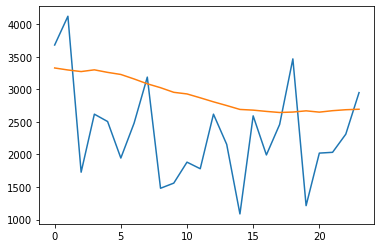

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3328.48196095 3297.76365918 3273.27590221 3299.91166776 3260.88654679
 3228.73026145 3159.86213928 3085.41854894 3025.52781719 2954.61412287
 2929.78921521 2870.33261877 2808.47651368 2751.45314097 2691.60544974
 2681.01576167 2661.42802376 2644.79071307 2651.54592174 2670.19279402
 2650.18598497 2672.5155471  2687.16108626 2694.58787042]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable




 63%|██████▎   | 81/128 [06:43<03:49,  4.88s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


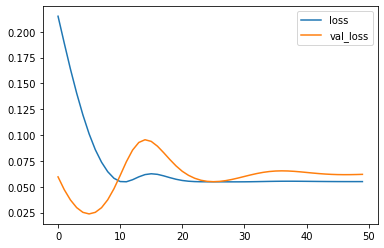

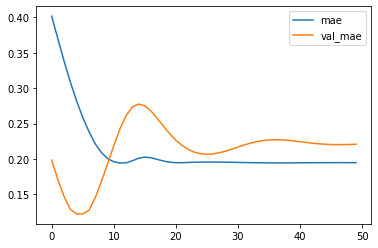

Test MSE: 1437350.989
bestmse=522573.7624166564
Test MAE: 1063.468
bestmae=572.91894
Test MAPE: 59.058
bestmape=25.73123


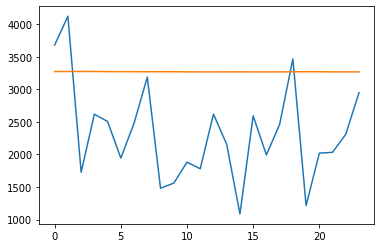

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3273.6017189  3273.97904074 3274.88360888 3274.27673763 3272.38869375
 3272.06818539 3271.27121854 3270.63680136 3271.11813778 3270.56377596
 3269.26710874 3268.70342147 3268.57573462 3268.97672874 3269.34257311
 3268.56554836 3268.30056226 3268.98634112 3269.46394736 3270.87668049
 3270.4220292  3269.05534941 3268.88892609 3269.11876243]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 29,249
Traina




 64%|██████▍   | 82/128 [06:48<03:46,  4.92s/it]

{'activation': 'sigmoid', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


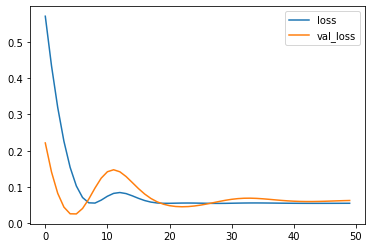

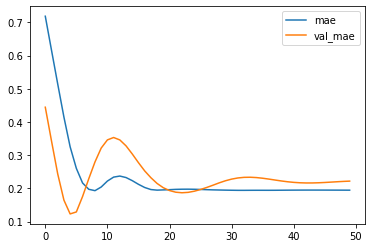

Test MSE: 1452847.724
bestmse=522573.7624166564
Test MAE: 1068.942
bestmae=572.91894
Test MAPE: 59.388
bestmape=25.73123


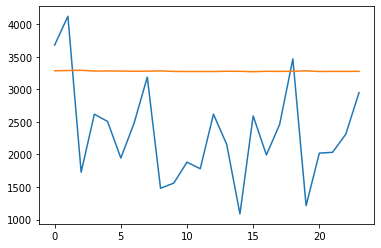

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3285.75219947 3289.15928656 3292.75173479 3281.12290525 3282.54266834
 3281.21702051 3277.74192941 3279.46928871 3283.63790596 3275.58617353
 3273.96225494 3274.38735175 3273.78191519 3278.31508559 3277.02860463
 3271.19747579 3277.55169034 3275.6752674  3278.42311728 3284.80028677
 3274.29926217 3276.0436942  3275.61974514 3277.21123987]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Traina




 65%|██████▍   | 83/128 [06:53<03:43,  4.97s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


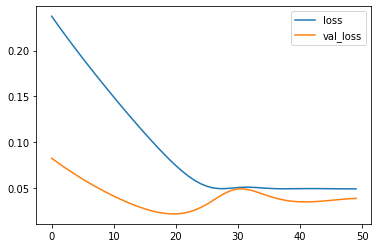

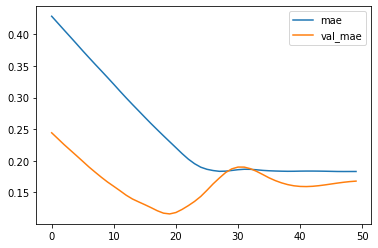

Test MSE: 898293.491
bestmse=522573.7624166564
Test MAE: 807.634
bestmae=572.91894
Test MAPE: 44.732
bestmape=25.73123


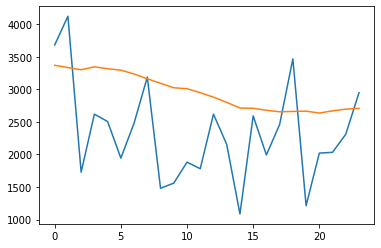

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3369.81534469 3334.54995608 3301.47131252 3346.02756995 3316.99832141
 3294.9681778  3236.25962549 3162.76034403 3093.48577595 3024.74361902
 3009.92161375 2949.1574465  2880.2214638  2800.48259902 2713.63975394
 2710.14558154 2679.13474774 2655.58957803 2660.90622926 2665.27799773
 2636.19007063 2670.22277892 2696.24923426 2708.93083477]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 1,937
Trainab




 66%|██████▌   | 84/128 [06:58<03:31,  4.81s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


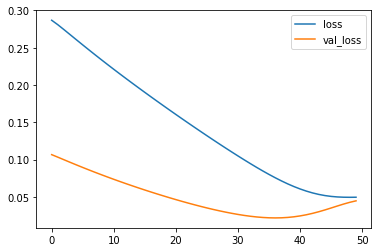

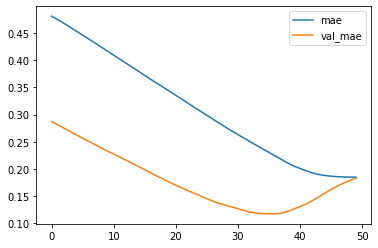

Test MSE: 1040984.989
bestmse=522573.7624166564
Test MAE: 881.130
bestmae=572.91894
Test MAPE: 49.131
bestmape=25.73123


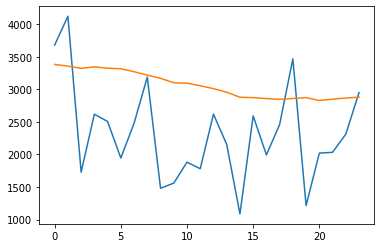

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3382.9125731  3356.86359322 3322.58096302 3345.69859695 3325.03542006
 3316.1989156  3271.14496636 3218.71243834 3169.44367504 3101.24052882
 3094.71156979 3056.00494862 3011.48527563 2956.67490268 2879.14028609
 2873.00328267 2858.8432405  2845.43296409 2860.04091454 2872.55480051
 2829.04801428 2849.17002845 2866.84389818 2880.03925896]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 66%|██████▋   | 85/128 [07:02<03:23,  4.74s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


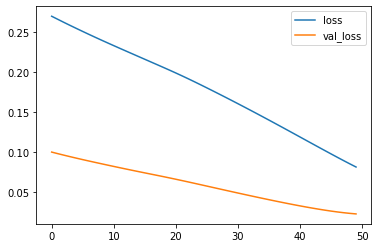

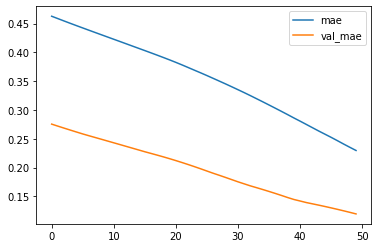

Test MSE: 526576.847
bestmse=522573.7624166564
Test MAE: 575.428
bestmae=572.91894
Test MAPE: 26.105
bestmape=25.73123


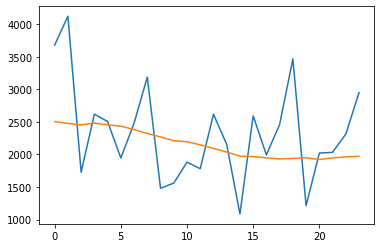

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2505.33729571 2477.17043561 2454.76110506 2482.27518404 2455.56754082
 2434.9294709  2383.07110333 2322.04682791 2268.41131753 2210.07556781
 2196.22843018 2148.1837391  2094.29586783 2037.48281977 1974.20996442
 1967.67340156 1948.33372048 1932.03585598 1938.99177691 1950.00297508
 1923.69862148 1946.33893612 1963.35277957 1972.85533598]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Traina




 67%|██████▋   | 86/128 [07:07<03:24,  4.86s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


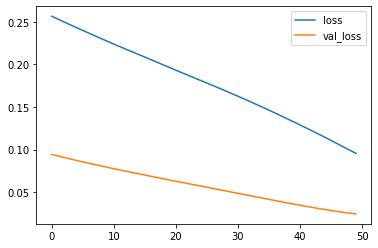

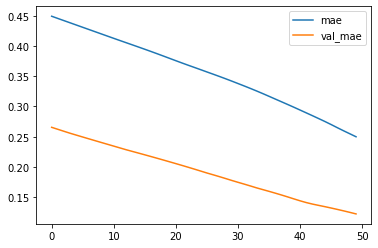

Test MSE: 561920.550
bestmse=522573.7624166564
Test MAE: 587.789
bestmae=572.91894
Test MAPE: 25.870
bestmape=25.73123


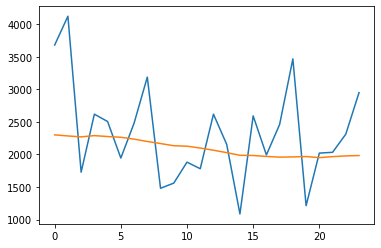

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2301.0498001  2284.59799403 2270.12863404 2289.60475355 2275.40066659
 2264.46421546 2235.67391351 2199.73214322 2167.85784498 2134.32046127
 2127.45664704 2098.52854371 2065.45434767 2028.14188048 1987.18675113
 1984.40002131 1969.9956525  1958.8026799  1962.52016082 1968.16843921
 1951.42173389 1966.52343076 1977.97565073 1983.88841307]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Traina




 68%|██████▊   | 87/128 [07:12<03:18,  4.85s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


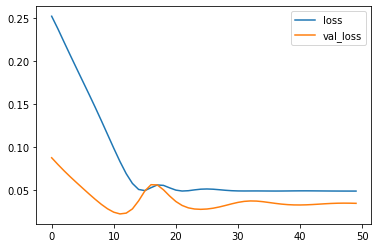

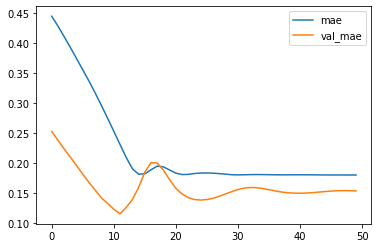

Test MSE: 791233.724
bestmse=522573.7624166564
Test MAE: 740.494
bestmae=572.91894
Test MAPE: 40.620
bestmape=25.73123


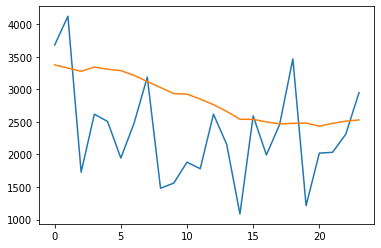

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3375.76497841 3326.94154096 3276.63062334 3342.26712024 3308.94945836
 3287.61169314 3215.07996243 3119.5798049  3028.1244514  2935.54631436
 2926.62229419 2851.45834911 2764.67203057 2660.77208632 2541.14685988
 2539.05164766 2500.2533502  2469.21037948 2478.02995467 2482.52281046
 2434.1091187  2477.98533601 2512.38991433 2530.12777096]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Traina




 69%|██████▉   | 88/128 [07:17<03:15,  4.88s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


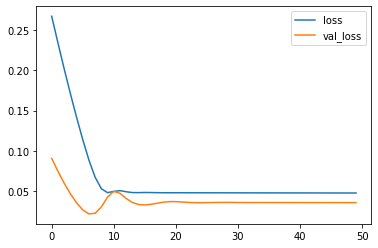

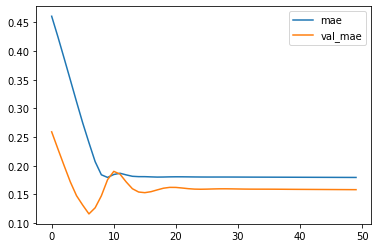

Test MSE: 835824.677
bestmse=522573.7624166564
Test MAE: 761.696
bestmae=572.91894
Test MAPE: 41.927
bestmape=25.73123


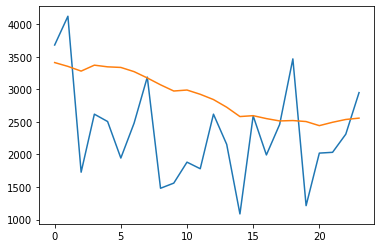

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3411.57282096 3352.83586192 3280.44458675 3371.72663045 3345.91824704
 3336.75162184 3272.29787827 3175.38498759 3069.89354861 2974.52007365
 2989.80060387 2924.40355569 2843.40274304 2725.75694984 2582.40205336
 2595.87502545 2551.05005175 2514.96761072 2521.02599347 2505.58248317
 2442.81965792 2494.4841997  2537.49989367 2558.06866837]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Traina




 70%|██████▉   | 89/128 [07:23<03:24,  5.25s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


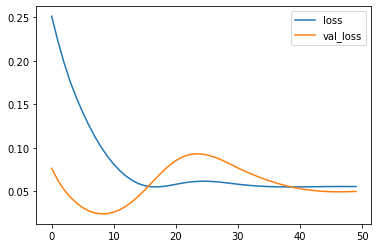

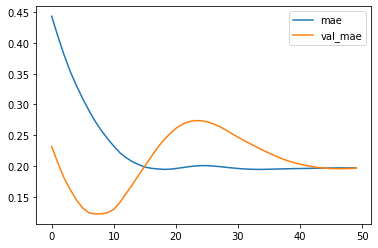

Test MSE: 1152397.732
bestmse=522573.7624166564
Test MAE: 946.706
bestmae=572.91894
Test MAPE: 52.474
bestmape=25.73123


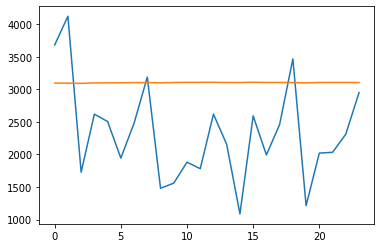

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3097.28453171 3095.02103108 3091.88237333 3098.88291293 3100.373119
 3101.19920993 3103.92152244 3103.66657913 3100.6221801  3105.13411719
 3107.79301667 3107.95900959 3108.3505348  3105.43812668 3105.2996797
 3109.30187362 3106.24327123 3106.18947059 3104.64546388 3099.76251757
 3105.30455762 3106.20367396 3106.29893696 3105.40268999]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Trainable




 70%|███████   | 90/128 [07:28<03:07,  4.95s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


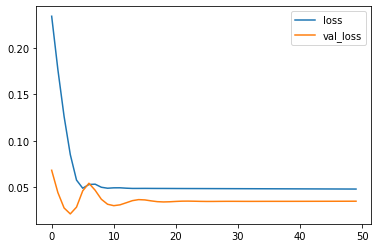

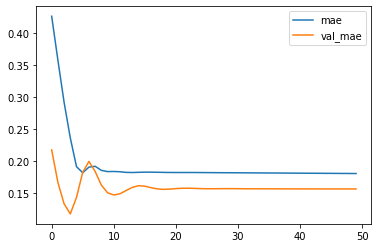

Test MSE: 817316.475
bestmse=522573.7624166564
Test MAE: 751.623
bestmae=572.91894
Test MAPE: 41.306
bestmape=25.73123


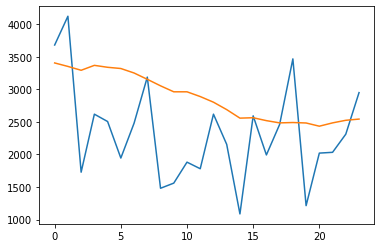

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3405.7118507  3352.29857284 3293.07482558 3368.75324827 3338.99747586
 3320.23367685 3251.37473667 3154.43903452 3054.31876475 2962.48910224
 2962.45022231 2889.50802857 2802.84882301 2688.96620542 2558.07899809
 2564.19534206 2519.65056211 2485.052158   2490.73407972 2483.56037378
 2434.296058   2485.16449374 2525.03622162 2543.51738793]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Traina




 71%|███████   | 91/128 [07:34<03:14,  5.26s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


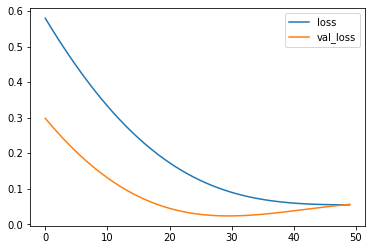

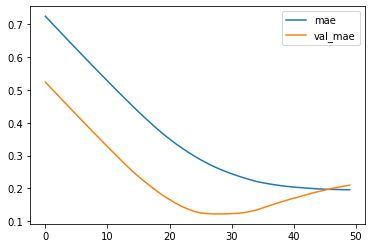

Test MSE: 1308448.946
bestmse=522573.7624166564
Test MAE: 1011.023
bestmae=572.91894
Test MAPE: 56.145
bestmape=25.73123


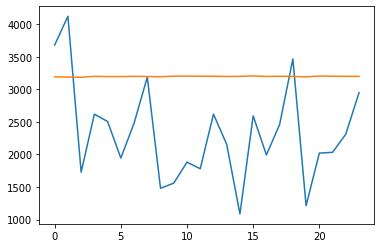

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3192.61396188 3189.29324275 3186.34468061 3200.0132001  3196.09909576
 3196.66450465 3200.1162104  3197.5032208  3193.29457587 3202.81456369
 3203.27251476 3201.69665807 3202.32189327 3197.65658849 3199.93845308
 3206.20644313 3198.17852646 3200.99925828 3198.51108617 3192.36432689
 3204.63029951 3200.99222833 3200.71963841 3199.13402587]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,601
Trainab




 72%|███████▏  | 92/128 [07:38<02:57,  4.93s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


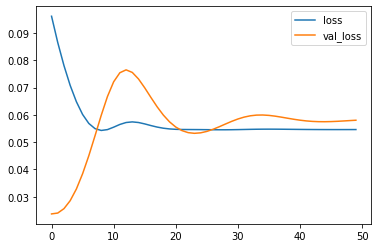

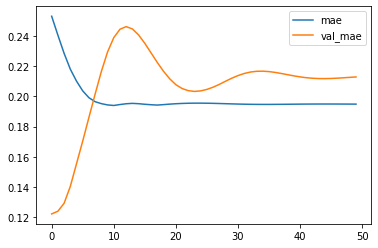

Test MSE: 1345032.745
bestmse=522573.7624166564
Test MAE: 1024.628
bestmae=572.91894
Test MAPE: 56.996
bestmape=25.73123


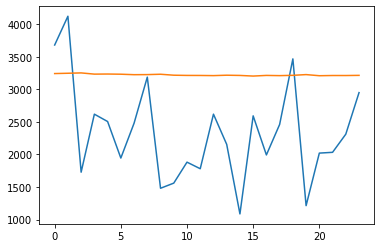

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3242.65630668 3247.39334565 3252.65662664 3233.98938185 3235.50555569
 3232.67836779 3225.46219522 3226.68382847 3232.1461001  3217.46612853
 3214.14196616 3213.56206697 3211.17130989 3217.34905833 3213.92977643
 3204.24580425 3214.1867283  3210.87763011 3215.5878405  3226.81051105
 3209.51568478 3212.80484086 3212.52823383 3214.99244672]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,601
Trainab




 73%|███████▎  | 93/128 [07:42<02:48,  4.80s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


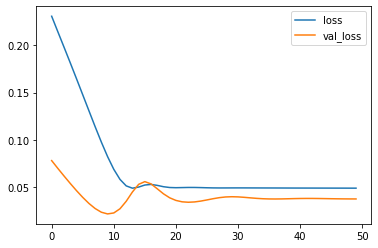

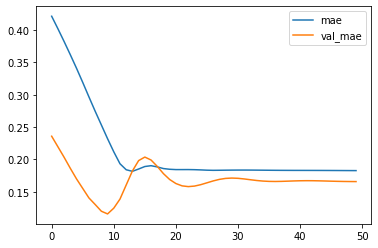

Test MSE: 870852.054
bestmse=522573.7624166564
Test MAE: 798.474
bestmae=572.91894
Test MAPE: 44.124
bestmape=25.73123


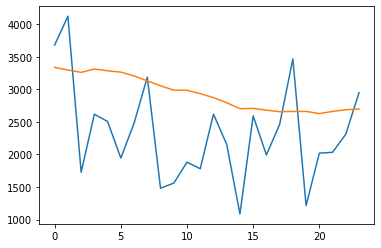

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3337.71745098 3296.8134681  3260.81266057 3311.73432308 3285.3192119
 3264.95645779 3207.09551668 3129.32417727 3055.27856821 2987.95000523
 2986.18046623 2934.37747747 2872.98291016 2794.27213979 2702.97072786
 2707.14795321 2680.25351417 2657.00345892 2660.52044278 2661.14596492
 2628.04838353 2661.31525761 2687.33525687 2698.43884867]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainabl




 73%|███████▎  | 94/128 [07:47<02:45,  4.86s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


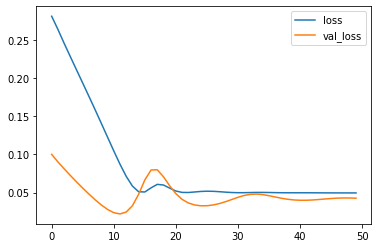

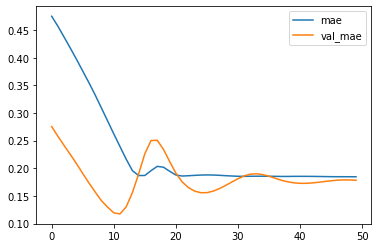

Test MSE: 989578.995
bestmse=522573.7624166564
Test MAE: 857.991
bestmae=572.91894
Test MAPE: 47.682
bestmape=25.73123


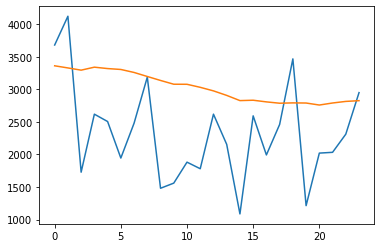

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3361.85342348 3329.1255601  3294.99328476 3340.80876416 3319.34273821
 3305.55054897 3259.56147283 3197.75629902 3136.72413284 3078.86046582
 3077.90123624 3031.35048139 2976.70897073 2907.27859598 2827.39583242
 2833.1278246  2807.69231552 2787.15338224 2792.1826663  2790.16277498
 2759.30215257 2790.5946148  2814.99213016 2826.30102521]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Traina




 74%|███████▍  | 95/128 [07:52<02:41,  4.89s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


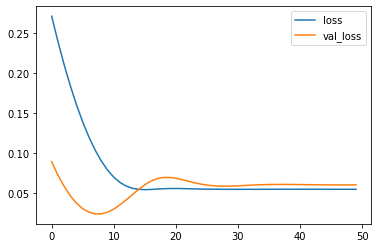

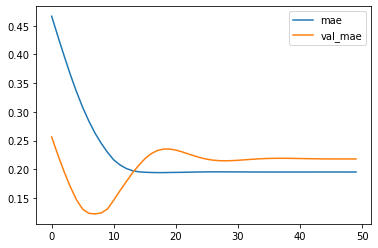

Test MSE: 1400968.955
bestmse=522573.7624166564
Test MAE: 1049.574
bestmae=572.91894
Test MAPE: 58.262
bestmape=25.73123


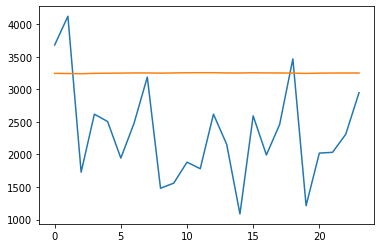

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3245.55092472 3243.49645752 3240.11978573 3245.91346931 3248.05071777
 3249.47306329 3252.06080246 3251.96783495 3248.97752351 3252.23655123
 3254.88856423 3255.56358296 3255.58295119 3252.45950109 3251.48262489
 3254.63907272 3252.15247875 3251.82264495 3249.93230557 3244.85912019
 3249.03806716 3250.63042271 3251.64216173 3251.1876539 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 75%|███████▌  | 96/128 [07:57<02:36,  4.90s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


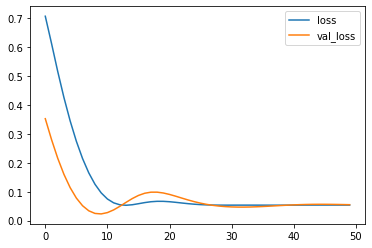

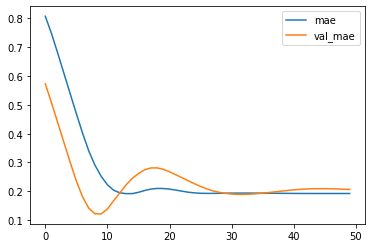

Test MSE: 1276056.555
bestmse=522573.7624166564
Test MAE: 993.462
bestmae=572.91894
Test MAPE: 55.392
bestmape=25.73123


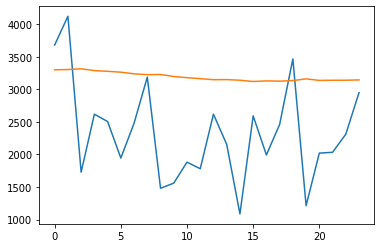

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3300.15972459 3304.63966823 3316.05874699 3287.84812903 3276.98283821
 3263.9605003  3238.87275857 3226.39402235 3228.65723604 3197.47409672
 3179.21717149 3164.45054501 3148.61565298 3149.77789032 3140.2942
 3120.76098007 3129.97136313 3126.05467635 3135.00552511 3161.1361385
 3137.51779991 3139.8840239  3140.23365635 3144.73526371]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainable pa




 76%|███████▌  | 97/128 [08:02<02:27,  4.77s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


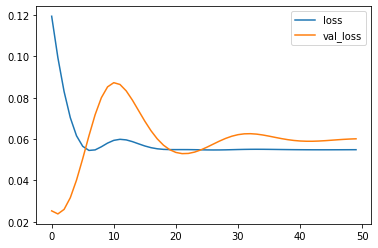

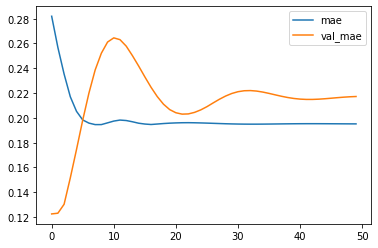

Test MSE: 1394102.758
bestmse=522573.7624166564
Test MAE: 1045.720
bestmae=572.91894
Test MAPE: 58.100
bestmape=25.73123


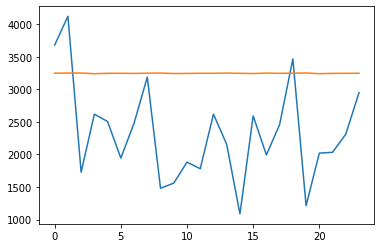

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3248.10925287 3250.29040265 3251.05078506 3240.75032926 3246.79379129
 3246.84472257 3245.1476351  3248.24052644 3250.78823793 3242.91512364
 3245.02410883 3247.18029511 3246.90942681 3250.2244072  3247.05361253
 3242.84008968 3250.06630504 3246.47012663 3248.4244529  3251.53169107
 3240.61776447 3245.87487632 3246.20384932 3247.58430207]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 77%|███████▋  | 98/128 [08:06<02:20,  4.67s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


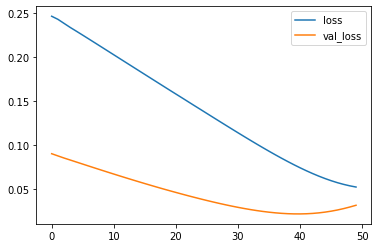

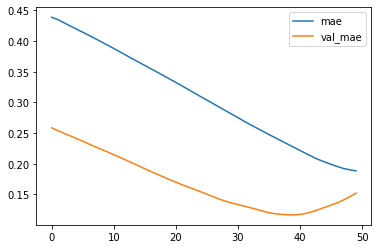

Test MSE: 734839.642
bestmse=522573.7624166564
Test MAE: 732.449
bestmae=572.91894
Test MAPE: 40.125
bestmape=25.73123


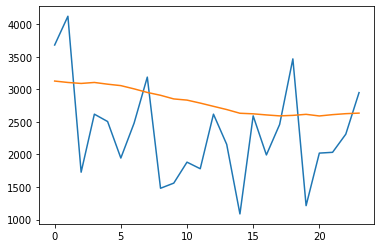

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3127.6356979  3105.97584617 3090.93892527 3105.99765337 3079.52859807
 3057.43159819 3007.64792687 2952.71115828 2908.97252715 2853.03793597
 2835.03867996 2789.23855168 2739.32805431 2689.96445841 2633.0644685
 2624.28076041 2607.42150414 2592.6438306  2600.52426177 2616.50333953
 2591.37944376 2611.76716137 2626.524032   2635.07689947]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,601
Trainabl




 77%|███████▋  | 99/128 [08:10<02:10,  4.50s/it]

{'activation': 'tanh', 'batch_size': 60, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


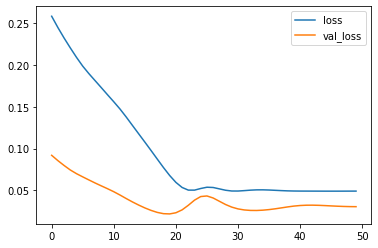

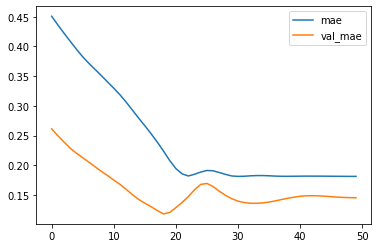

Test MSE: 706810.596
bestmse=522573.7624166564
Test MAE: 699.171
bestmae=572.91894
Test MAPE: 37.808
bestmape=25.73123


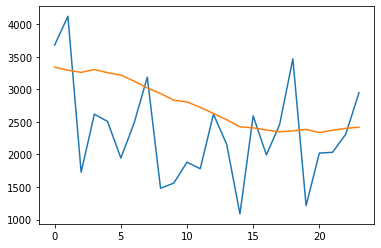

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3340.05096418 3295.17792857 3260.55613911 3305.3435241  3256.16844565
 3219.33738661 3126.95479697 3021.57239395 2937.02848619 2833.00817198
 2807.4342159  2723.99085408 2629.54633689 2532.37391192 2424.71165287
 2408.54219258 2376.15119296 2348.23540252 2362.3545562  2384.72400254
 2335.88650519 2372.27037328 2401.39560217 2418.84967834]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 78%|███████▊  | 100/128 [08:15<02:05,  4.49s/it]

{'activation': 'sigmoid', 'batch_size': 20, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


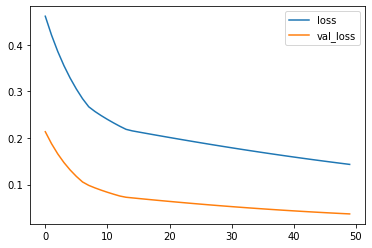

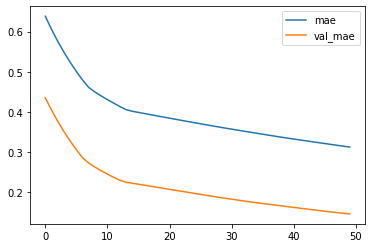

Test MSE: 861497.607
bestmse=522573.7624166564
Test MAE: 706.377
bestmae=572.91894
Test MAPE: 27.597
bestmape=25.73123


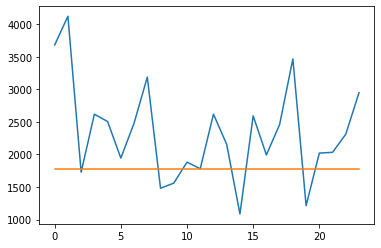

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1770.4969162 1770.4969162 1770.4969162 1770.4969162 1770.4969162
 1770.4969162 1770.4969162 1770.4969162 1770.4969162 1770.4969162
 1770.4969162 1770.4969162 1770.4969162 1770.4969162 1770.4969162
 1770.4969162 1770.4969162 1770.4969162 1770.4969162 1770.4969162
 1770.4969162 1770.4969162 1770.4969162 1770.4969162]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 544       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 873
Trainable params: 873
Non-trainab




 79%|███████▉  | 101/128 [08:20<02:09,  4.78s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


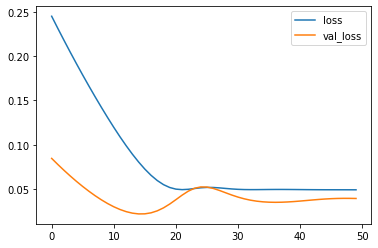

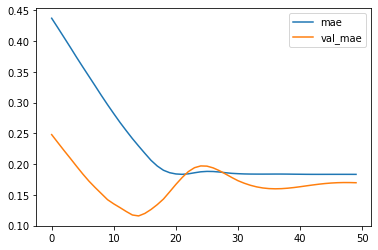

Test MSE: 908617.810
bestmse=522573.7624166564
Test MAE: 816.371
bestmae=572.91894
Test MAPE: 45.234
bestmape=25.73123


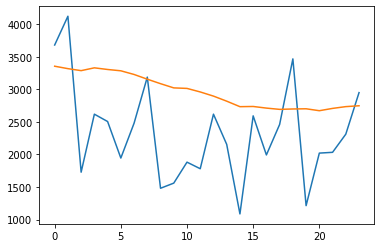

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3355.46994138 3318.14807701 3287.45316058 3330.61246639 3305.33204663
 3285.09525776 3228.804865   3156.18719673 3087.21950752 3022.59116292
 3014.60542595 2960.24597412 2896.44587249 2818.62704504 2734.09404087
 2737.15680385 2712.23892868 2692.72579432 2698.69364852 2701.71136242
 2672.13879913 2707.54493022 2734.82429492 2748.06499171]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 7,505
Trainab




 80%|███████▉  | 102/128 [08:25<02:03,  4.73s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


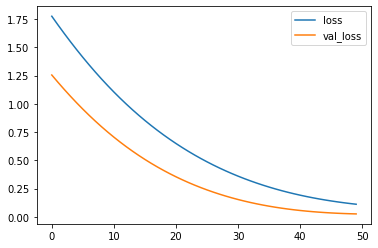

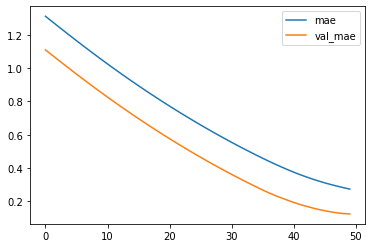

Test MSE: 614833.822
bestmse=522573.7624166564
Test MAE: 594.878
bestmae=572.91894
Test MAPE: 25.717
bestmape=25.71736


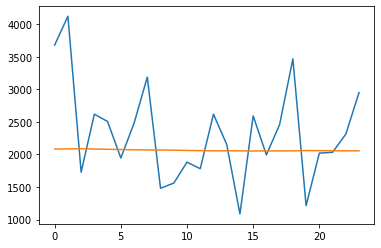

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2083.70998168 2084.81203404 2087.9320409  2083.51773405 2079.80957857
 2076.28699943 2071.68109056 2068.78403357 2069.67009428 2065.64724091
 2062.26389784 2058.81606573 2055.86685798 2056.40005821 2054.97799963
 2053.43815351 2054.78238049 2053.63025767 2055.003537   2060.49938023
 2058.14520758 2056.99408904 2056.00795913 2056.28973103]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Traina




 80%|████████  | 103/128 [08:30<02:02,  4.91s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


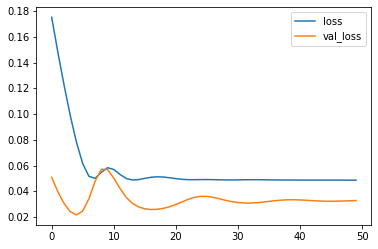

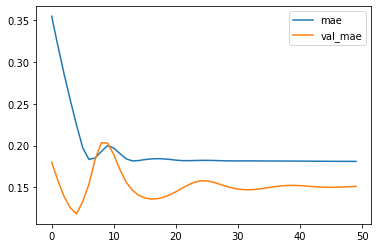

Test MSE: 761531.421
bestmse=522573.7624166564
Test MAE: 727.169
bestmae=572.91894
Test MAPE: 39.764
bestmape=25.71736


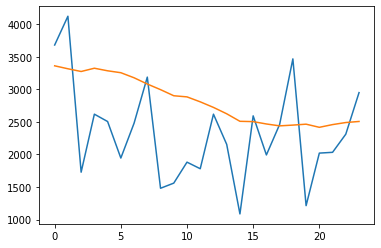

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3361.59977138 3316.27667546 3274.47214156 3324.66871488 3285.18334734
 3255.71752453 3178.05364293 3081.97817719 2995.62068564 2901.92134321
 2884.53699267 2808.43246889 2722.8174262  2624.95348364 2509.36832678
 2504.68709701 2468.31384557 2439.36522627 2451.14785391 2465.30517018
 2417.08559114 2458.94665158 2490.64857256 2506.94428504]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                18688     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 19,073
Traina




 81%|████████▏ | 104/128 [08:35<01:57,  4.89s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.05, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


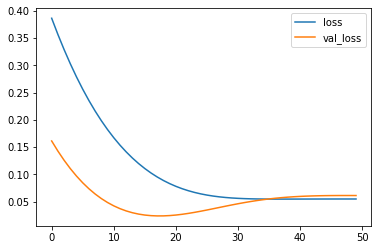

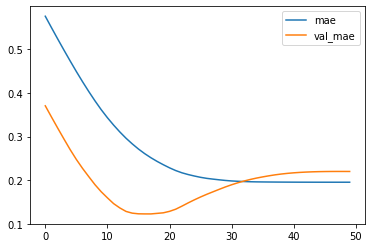

Test MSE: 1421767.892
bestmse=522573.7624166564
Test MAE: 1058.385
bestmae=572.91894
Test MAPE: 58.722
bestmape=25.71736


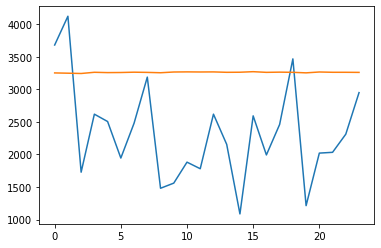

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3252.51028889 3248.33708066 3243.79831499 3262.22912389 3257.43943202
 3258.93609416 3263.74472386 3260.66273612 3255.24207032 3266.54350501
 3268.47071576 3266.90447146 3268.0748865  3261.91005021 3263.15707737
 3271.50736749 3261.27448529 3264.45374459 3261.68566567 3253.54670447
 3266.78309721 3262.25293964 3262.1769014  3260.66044062]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainab




 82%|████████▏ | 105/128 [08:40<01:51,  4.87s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


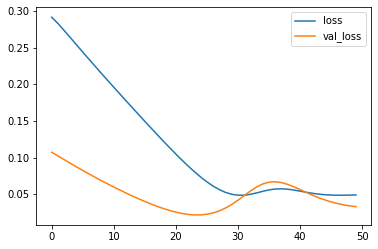

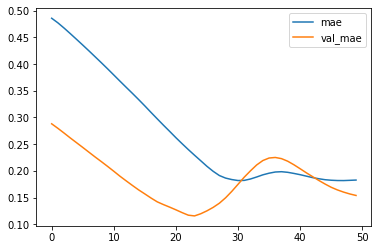

Test MSE: 765947.350
bestmse=522573.7624166564
Test MAE: 740.536
bestmae=572.91894
Test MAPE: 40.600
bestmape=25.71736


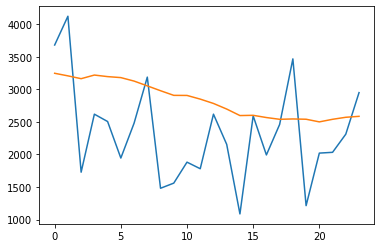

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3246.98015672 3207.42793292 3164.01784438 3219.74828005 3195.7450158
 3180.63263053 3127.10916895 3053.64690232 2979.15697169 2907.87843728
 2906.65307385 2850.26397485 2783.55146509 2697.53069383 2597.6683802
 2601.47603101 2567.24131924 2540.17916566 2545.43498629 2541.12290066
 2500.60326958 2540.19867736 2571.25341249 2585.68618804]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                20736     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 21,953
Trainabl




 83%|████████▎ | 106/128 [08:44<01:46,  4.84s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.64, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


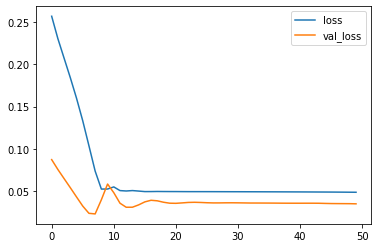

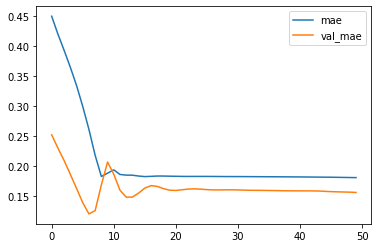

Test MSE: 808024.857
bestmse=522573.7624166564
Test MAE: 752.602
bestmae=572.91894
Test MAPE: 41.425
bestmape=25.71736


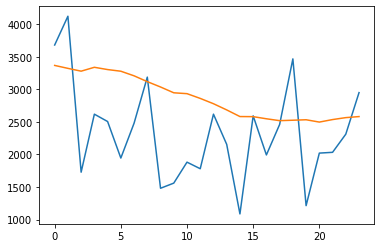

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3367.65313274 3322.52888399 3279.38736826 3339.02143508 3304.03753144
 3278.67016983 3207.97971231 3118.56361836 3036.33543372 2947.32650304
 2933.92526513 2861.06943935 2779.4847104  2684.25958174 2582.34251398
 2580.76880932 2548.22142917 2519.27151865 2526.03117484 2533.17733485
 2497.49674875 2536.02891237 2565.99127924 2582.03577858]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                24832     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 29,249
Traina




 84%|████████▎ | 107/128 [08:51<01:52,  5.35s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


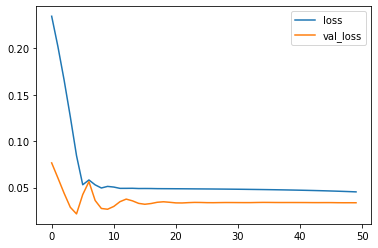

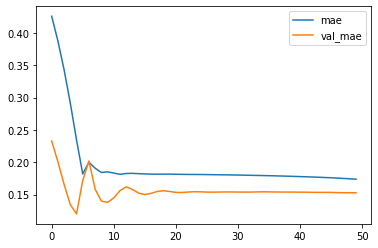

Test MSE: 779998.123
bestmse=522573.7624166564
Test MAE: 735.442
bestmae=572.91894
Test MAPE: 40.367
bestmape=25.71736


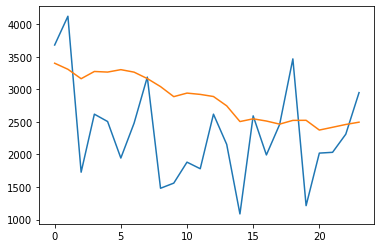

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3401.37666667 3308.55119014 3163.71153939 3274.7546308  3265.43176854
 3302.80872476 3264.47626913 3165.76170254 3042.33298588 2888.13202333
 2942.61987936 2922.64994168 2890.09208834 2747.04206216 2505.51160979
 2547.63909101 2513.63077235 2466.08076024 2523.57255721 2524.77338755
 2374.99928534 2417.63493156 2460.83928645 2496.0160116 ]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Traina




 84%|████████▍ | 108/128 [08:58<01:54,  5.73s/it]

{'activation': 'relu', 'batch_size': 100, 'dropout': 0.2, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


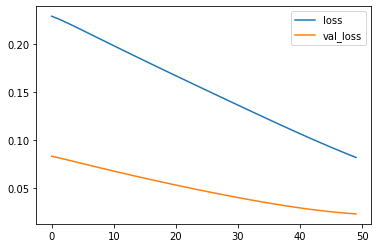

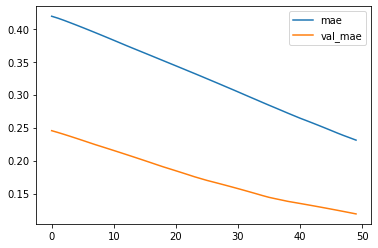

Test MSE: 529376.478
bestmse=522573.7624166564
Test MAE: 573.464
bestmae=572.91894
Test MAPE: 25.905
bestmape=25.71736


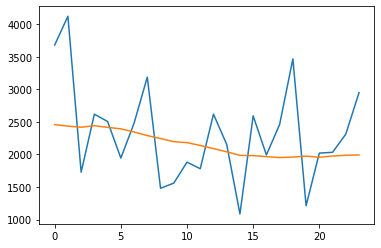

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2458.7782197  2435.0750913  2418.45542723 2441.82714367 2416.39149112
 2393.56007659 2345.53504068 2289.87045699 2245.06169522 2195.95863789
 2182.12111264 2138.48506141 2090.36956868 2041.50273204 1985.95701191
 1981.97325367 1966.73124471 1952.91911337 1959.65531248 1974.69653744
 1957.35773811 1976.00999045 1987.78723803 1993.37870294]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Traina




 85%|████████▌ | 109/128 [09:02<01:40,  5.29s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.82, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


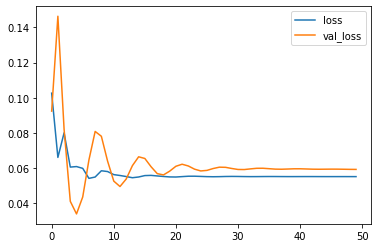

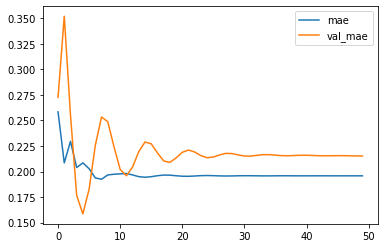

Test MSE: 1371968.193
bestmse=522573.7624166564
Test MAE: 1035.973
bestmae=572.91894
Test MAPE: 57.610
bestmape=25.71736


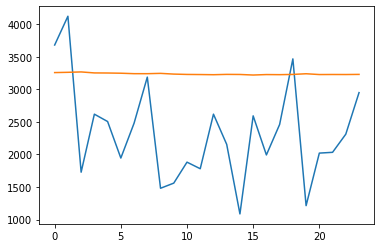

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3257.77113092 3261.80374014 3267.6928302  3252.4830299  3251.14805663
 3247.98601353 3241.00068158 3240.7764405  3245.67129469 3234.48893875
 3229.2844798  3227.59112251 3224.99319708 3229.9745627  3228.76110715
 3220.16892934 3227.28725648 3225.74439752 3229.3879205  3239.72194791
 3227.54808199 3228.34734434 3227.8892498  3229.75864279]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Traina




 86%|████████▌ | 110/128 [09:07<01:35,  5.31s/it]

{'activation': 'tanh', 'batch_size': 100, 'dropout': 0.0, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


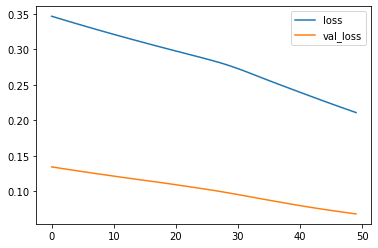

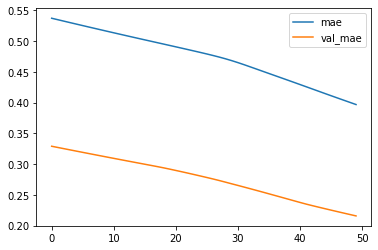

Test MSE: 1576407.167
bestmse=522573.7624166564
Test MAE: 1038.822
bestmae=572.91894
Test MAPE: 39.577
bestmape=25.71736


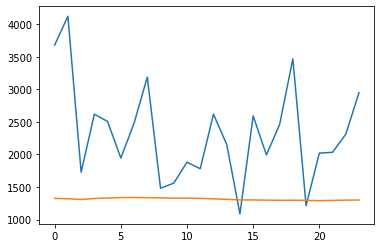

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[1325.24324729 1320.04520855 1307.65829209 1324.19377609 1330.8462614
 1338.28622672 1338.78377506 1336.25062561 1333.45028424 1327.97337883
 1329.48187711 1324.87467702 1318.70664857 1311.17986695 1301.75180649
 1301.83153904 1298.56542757 1295.73176567 1296.6587866  1295.59851941
 1290.17189967 1294.84631469 1298.50477631 1300.33604258]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 5,673
Trainabl




 87%|████████▋ | 111/128 [09:11<01:24,  4.95s/it]

{'activation': 'relu', 'batch_size': 80, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


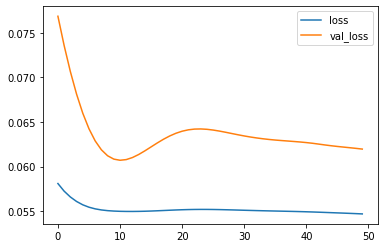

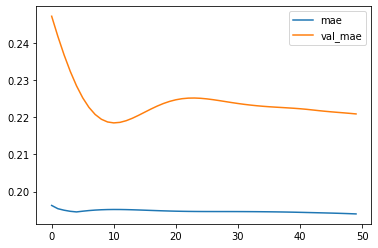

Test MSE: 1435865.420
bestmse=522573.7624166564
Test MAE: 1063.411
bestmae=572.91894
Test MAPE: 59.047
bestmape=25.71736


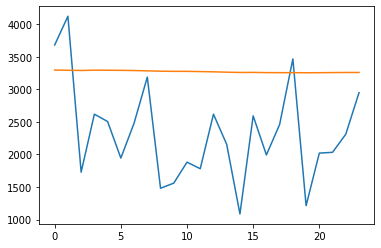

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3296.80572081 3293.34454614 3290.07031077 3294.98381585 3293.44870418
 3292.18460429 3289.22757751 3284.46557504 3278.94161201 3276.71139604
 3276.47438627 3273.05754334 3269.44056201 3263.74085021 3259.61297798
 3260.48799163 3257.17559367 3256.69397032 3256.46183848 3254.80908275
 3255.97117662 3257.95276189 3259.41312653 3259.60523069]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,961
Trainab




 88%|████████▊ | 112/128 [09:16<01:16,  4.77s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 8, 'weight_regulizer': None}


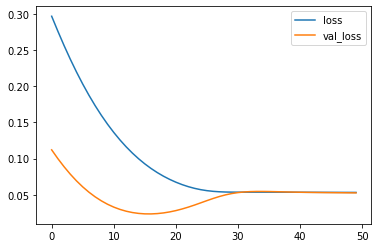

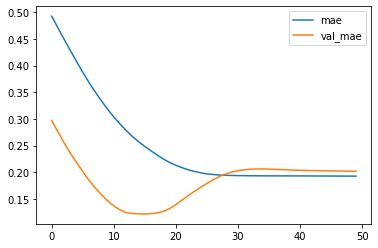

Test MSE: 1220111.570
bestmse=522573.7624166564
Test MAE: 971.169
bestmae=572.91894
Test MAPE: 54.074
bestmape=25.71736


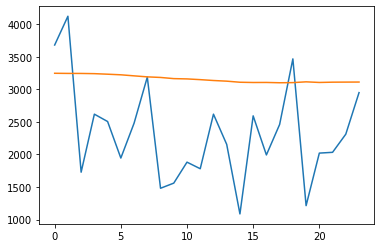

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3247.04945195 3244.95639175 3244.4688862  3241.27585393 3232.82800531
 3223.61690491 3207.54471618 3191.88729453 3182.95753562 3164.94838029
 3160.48020107 3149.26183456 3136.01252967 3125.95970029 3109.38178551
 3105.48461044 3106.21070391 3101.49991965 3103.71908855 3115.62380779
 3106.04356325 3110.42393982 3111.53051144 3112.34354675]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 8)                 800       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 9         
Total params: 1,961
Trainab




 88%|████████▊ | 113/128 [09:21<01:15,  5.00s/it]

{'activation': 'relu', 'batch_size': 20, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


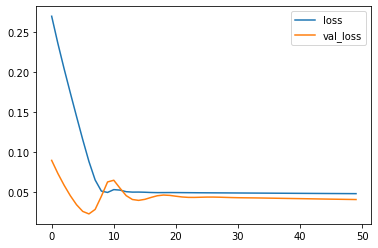

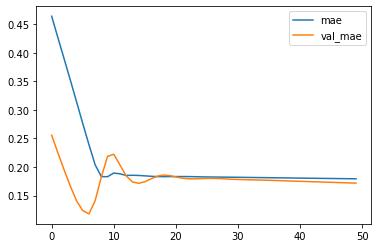

Test MSE: 932270.021
bestmse=522573.7624166564
Test MAE: 827.199
bestmae=572.91894
Test MAPE: 45.692
bestmape=25.71736


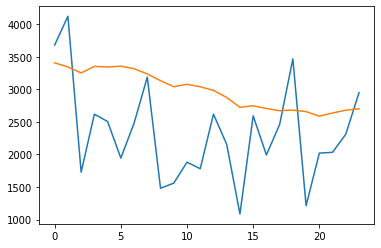

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3407.57435721 3344.08185178 3252.3206237  3352.74863315 3343.33294684
 3356.40779418 3316.47193593 3236.33379865 3133.08376616 3040.57176805
 3077.48948199 3039.68498999 2984.53115374 2875.46792597 2724.53962064
 2748.16068512 2706.49015069 2672.12646085 2681.78374791 2658.69394684
 2587.97364789 2637.06465387 2680.14533901 2701.42944705]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                5248      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 5,601
Trainab




 89%|████████▉ | 114/128 [09:27<01:13,  5.22s/it]

{'activation': 'elu', 'batch_size': 20, 'dropout': 0.07500000000000001, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


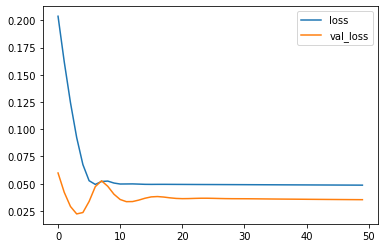

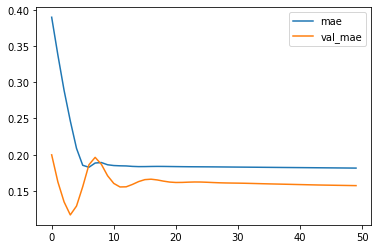

Test MSE: 818595.861
bestmse=522573.7624166564
Test MAE: 755.561
bestmae=572.91894
Test MAPE: 41.611
bestmape=25.71736


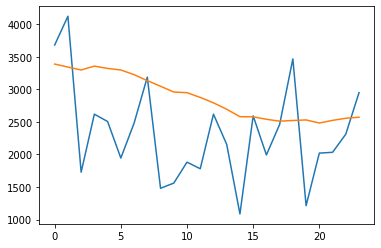

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3388.72189474 3342.73683572 3297.54946089 3356.95756501 3321.44024593
 3297.56251651 3226.36977619 3134.07068515 3047.86440927 2959.37182128
 2948.81254852 2876.2218523  2793.29626787 2694.59490037 2580.13654417
 2578.47274137 2540.57140821 2511.33269584 2521.91478008 2530.55889344
 2482.94001651 2523.98172903 2555.90401745 2572.07935995]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                2112      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 3,281
Trainab




 90%|████████▉ | 115/128 [09:33<01:10,  5.40s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.28, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


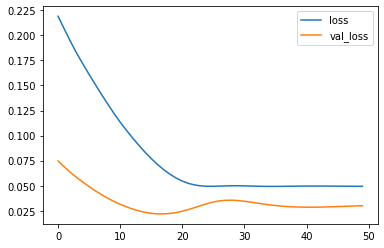

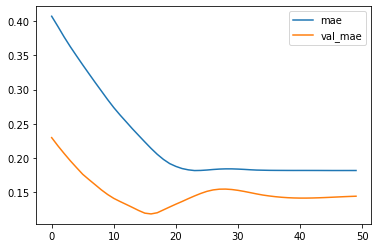

Test MSE: 693557.045
bestmse=522573.7624166564
Test MAE: 692.979
bestmae=572.91894
Test MAPE: 37.344
bestmape=25.71736


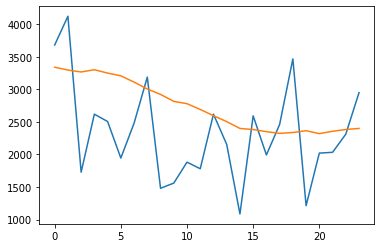

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3339.93977618 3296.68879408 3267.02699345 3301.61004645 3250.1386131
 3207.80525476 3111.47771508 3005.66332877 2922.44693393 2815.78450602
 2779.90794212 2691.26801211 2595.8453275  2504.55539304 2399.67871606
 2382.59163201 2350.59746593 2323.48968941 2337.59435278 2365.2239238
 2319.46626216 2356.30750746 2383.67123157 2399.64715302]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Trainabl




 91%|█████████ | 116/128 [09:37<01:02,  5.19s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


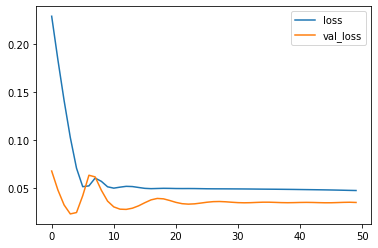

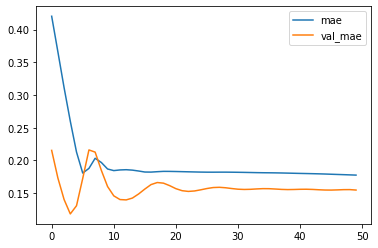

Test MSE: 802644.664
bestmse=522573.7624166564
Test MAE: 744.695
bestmae=572.91894
Test MAPE: 40.828
bestmape=25.71736


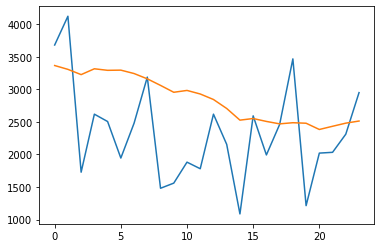

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3366.09721816 3307.19010562 3226.47809482 3316.03163147 3292.45446831
 3295.19543171 3243.07423007 3161.76123023 3060.7010991  2955.25069207
 2983.59903967 2928.86929595 2844.30444181 2706.3349179  2527.25223422
 2552.0897671  2507.50352478 2470.12283838 2487.67045593 2479.8075279
 2383.86706591 2433.05735201 2481.13030636 2513.54669988]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Trainab




 91%|█████████▏| 117/128 [09:43<00:57,  5.22s/it]

{'activation': 'sigmoid', 'batch_size': 100, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.1, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


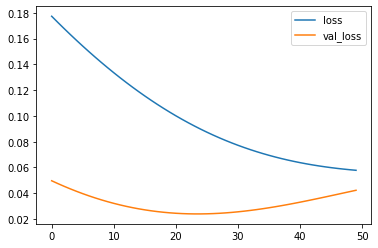

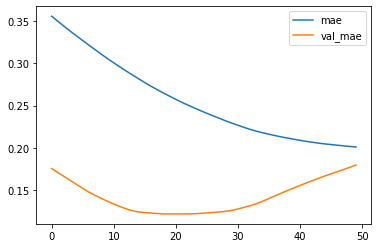

Test MSE: 979509.570
bestmse=522573.7624166564
Test MAE: 866.318
bestmae=572.91894
Test MAPE: 47.810
bestmape=25.71736


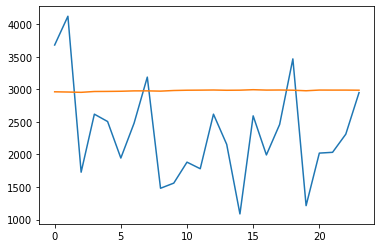

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[2962.6000033  2959.141698   2954.38385612 2967.23144954 2968.54160279
 2970.85259145 2976.64111018 2976.83952695 2972.76430762 2982.54067343
 2986.80555797 2988.04541171 2990.08051068 2986.01791656 2987.52734739
 2994.78656048 2988.84209162 2990.12685096 2987.07685667 2978.45670253
 2989.27680081 2988.66146493 2988.73592502 2986.96882498]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainab




 92%|█████████▏| 118/128 [09:47<00:49,  4.93s/it]

{'activation': 'relu', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


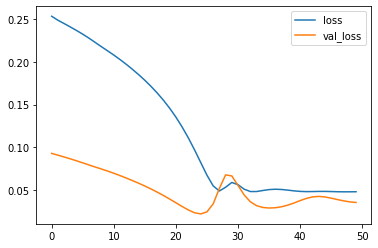

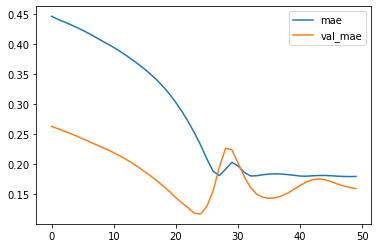

Test MSE: 813447.000
bestmse=522573.7624166564
Test MAE: 766.827
bestmae=572.91894
Test MAPE: 42.285
bestmape=25.71736


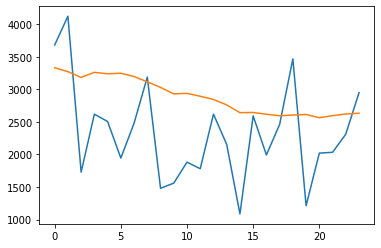

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3331.91315073 3272.38381582 3183.44891483 3261.49155295 3239.02827829
 3247.60969597 3197.09907037 3116.16396624 3029.73588824 2930.93165392
 2938.13276231 2894.34520847 2844.91418242 2761.09995484 2641.97084206
 2645.16760451 2617.67619354 2594.8829416  2605.49257177 2614.05892527
 2564.96849316 2596.0943886  2621.2657724  2634.11135727]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Traina




 93%|█████████▎| 119/128 [09:52<00:44,  4.91s/it]

{'activation': 'elu', 'batch_size': 60, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


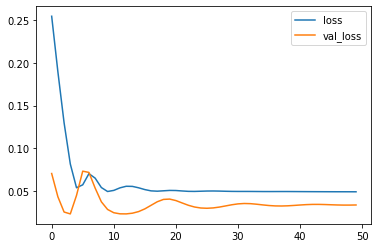

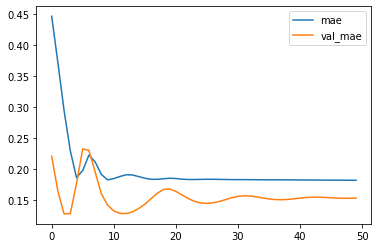

Test MSE: 780386.886
bestmse=522573.7624166564
Test MAE: 738.738
bestmae=572.91894
Test MAPE: 40.575
bestmape=25.71736


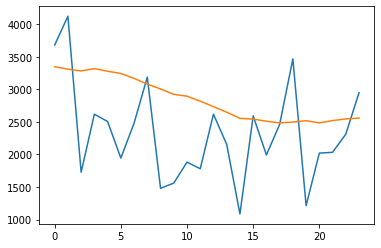

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3347.83268911 3310.58714992 3283.25326723 3318.60057628 3278.43258619
 3244.17405868 3169.12359709 3080.76271307 3006.75268418 2923.68420523
 2895.15107036 2818.50437957 2734.85270166 2648.90796864 2554.80863637
 2543.1468091  2510.22612423 2485.37725735 2497.14769018 2519.0752539
 2484.9491477  2520.48942173 2545.74731696 2558.93234801]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 49,985
Trainab




 94%|█████████▍| 120/128 [09:57<00:40,  5.07s/it]

{'activation': 'elu', 'batch_size': 80, 'dropout': 0.225, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.9099999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


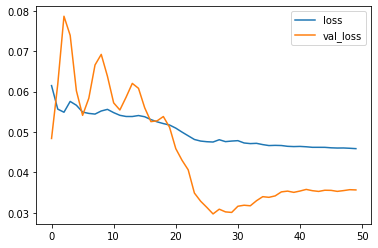

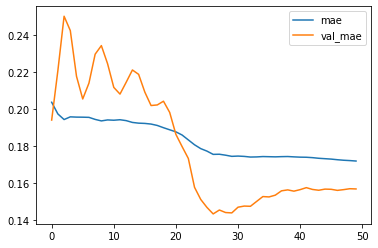

Test MSE: 826109.960
bestmse=522573.7624166564
Test MAE: 754.189
bestmae=572.91894
Test MAPE: 40.815
bestmape=25.71736


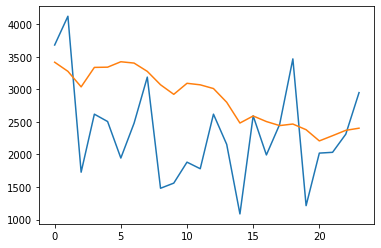

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3416.78230131 3277.06963658 3038.48114681 3337.26251274 3340.84549206
 3424.05184412 3403.7104668  3276.24340218 3070.42796832 2923.75550902
 3093.10716289 3069.70660931 3012.40289938 2801.94195938 2482.90773612
 2591.33324695 2505.57760525 2443.58262277 2467.45791322 2380.35582078
 2208.31621507 2288.51367652 2370.78447127 2403.62797016]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 49,985
Traina




 95%|█████████▍| 121/128 [10:03<00:36,  5.20s/it]

{'activation': 'relu', 'batch_size': 40, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


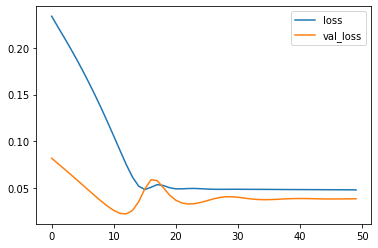

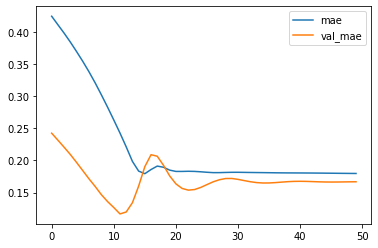

Test MSE: 884485.923
bestmse=522573.7624166564
Test MAE: 802.962
bestmae=572.91894
Test MAPE: 44.407
bestmape=25.71736


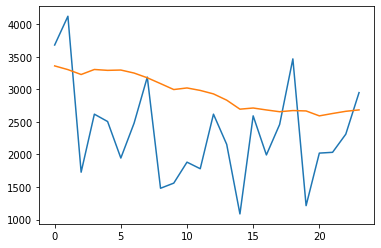

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3360.35159647 3303.34630078 3228.17331719 3305.29603606 3291.90024996
 3296.80442959 3250.5374552  3177.90400541 3088.40398246 2997.16526622
 3021.73221773 2983.76574993 2930.31316173 2834.13841587 2695.66675264
 2713.60159135 2683.81081265 2656.50418895 2674.37159753 2668.5690189
 2592.83966494 2629.26212603 2663.01320589 2684.43418276]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 29,345
Trainab




 95%|█████████▌| 122/128 [10:08<00:31,  5.31s/it]

{'activation': 'elu', 'batch_size': 40, 'dropout': 0.025, 'epochs': 50, 'first_neuron': 8, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


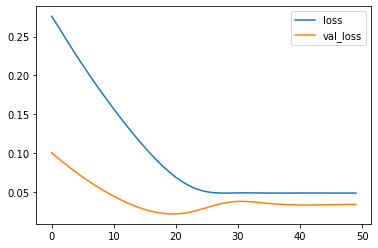

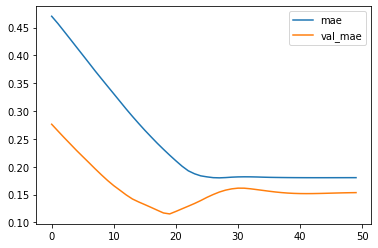

Test MSE: 786692.174
bestmse=522573.7624166564
Test MAE: 738.590
bestmae=572.91894
Test MAPE: 40.517
bestmape=25.71736


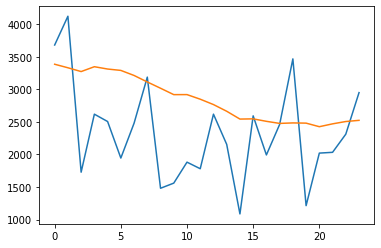

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3385.79772222 3331.662368   3273.31578642 3347.83914518 3312.24406624
 3291.08649731 3213.3944959  3113.58540905 3017.20363832 2918.9864766
 2919.55332017 2848.91178536 2766.49465287 2663.70816672 2543.64105767
 2546.90022886 2509.08798957 2477.17287457 2484.53524143 2481.28137857
 2426.52107608 2470.29657859 2506.10298645 2524.19320142]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 8)             320       
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                1600      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 1,937
Trainabl




 96%|█████████▌| 123/128 [10:13<00:25,  5.16s/it]

{'activation': 'sigmoid', 'batch_size': 40, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.37, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 16, 'weight_regulizer': None}


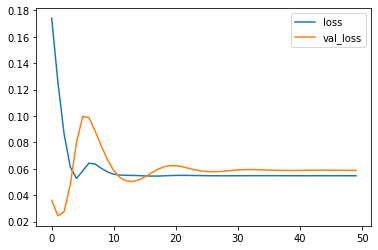

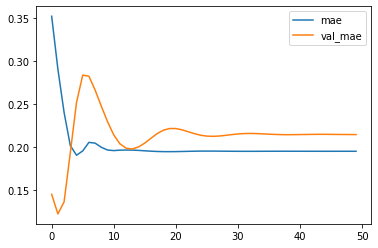

Test MSE: 1363191.495
bestmse=522573.7624166564
Test MAE: 1032.896
bestmae=572.91894
Test MAPE: 57.414
bestmape=25.71736


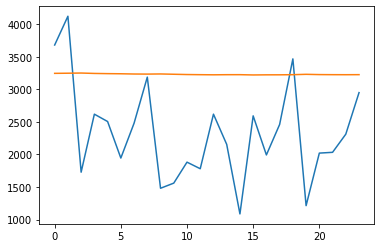

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3245.87874997 3248.0337885  3250.69254452 3244.60977215 3241.51228982
 3239.54132122 3235.77211994 3234.49439055 3236.58329016 3231.98656327
 3227.64807945 3225.39706057 3223.58935899 3225.25359219 3225.48974115
 3221.3546955  3223.18406081 3223.44416898 3225.44225311 3231.0458411
 3226.88353646 3225.55788863 3224.97956759 3225.83492607]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 16)                5184      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 17        
Total params: 22,097
Trainab




 97%|█████████▋| 124/128 [10:19<00:20,  5.24s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.17500000000000002, 'epochs': 50, 'first_neuron': 64, 'last_activation': 'relu', 'loss': 'mean_squared_error', 'lr': 0.45999999999999996, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 64, 'weight_regulizer': None}


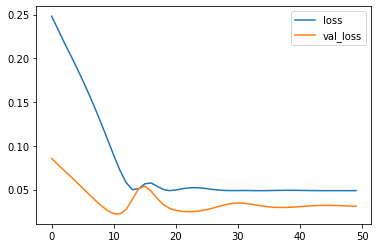

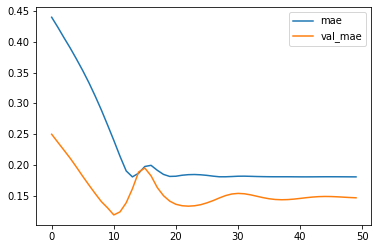

Test MSE: 715816.039
bestmse=522573.7624166564
Test MAE: 705.001
bestmae=572.91894
Test MAPE: 38.191
bestmape=25.71736


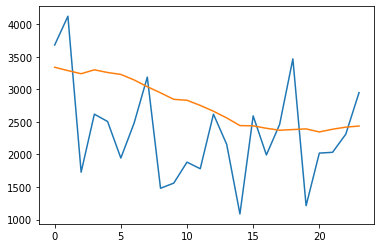

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3339.42888528 3288.12086242 3240.08104926 3300.31022292 3258.97325248
 3229.32436401 3145.18776298 3040.90131491 2946.40801847 2847.0223068
 2832.45696646 2753.47389311 2664.15535766 2561.28336436 2443.67889005
 2439.2480126  2402.2688942  2372.43105787 2382.50626832 2393.08993071
 2346.0898329  2387.68375522 2419.85625249 2436.68523693]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 64)            16896     
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
Total params: 49,985
Trainab




 98%|█████████▊| 125/128 [10:24<00:15,  5.32s/it]

{'activation': 'tanh', 'batch_size': 80, 'dropout': 0.125, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'sigmoid', 'loss': 'mean_squared_error', 'lr': 0.19, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


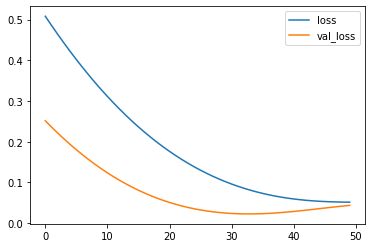

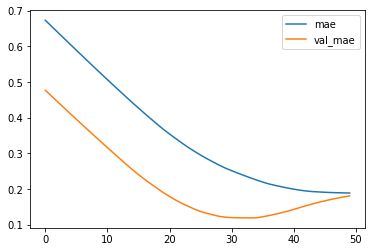

Test MSE: 1005978.828
bestmse=522573.7624166564
Test MAE: 870.984
bestmae=572.91894
Test MAPE: 48.491
bestmape=25.71736


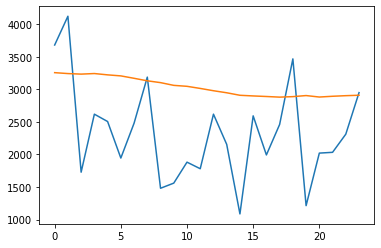

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3256.58349967 3242.57252115 3234.17646462 3242.95715988 3222.73744375
 3206.84846413 3169.98340309 3131.34335124 3103.39054596 3061.39907277
 3046.76802391 3014.21920907 2978.97247136 2947.62692583 2909.09935319
 2898.99344051 2890.35807872 2880.64957345 2888.30088562 2904.71868968
 2882.18540245 2893.92197675 2903.00022542 2909.59747541]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Traina




 98%|█████████▊| 126/128 [10:29<00:10,  5.17s/it]

{'activation': 'elu', 'batch_size': 100, 'dropout': 0.1, 'epochs': 50, 'first_neuron': 16, 'last_activation': 'tanh', 'loss': 'mean_squared_error', 'lr': 0.73, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


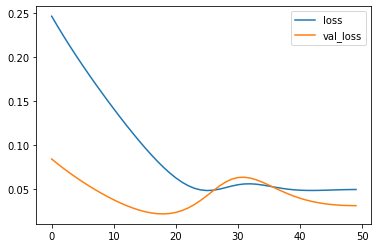

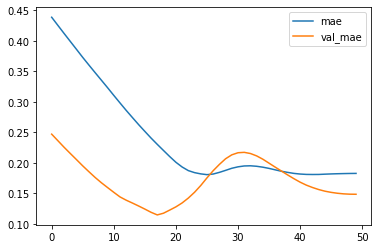

Test MSE: 722532.375
bestmse=522573.7624166564
Test MAE: 715.825
bestmae=572.91894
Test MAPE: 39.007
bestmape=25.71736


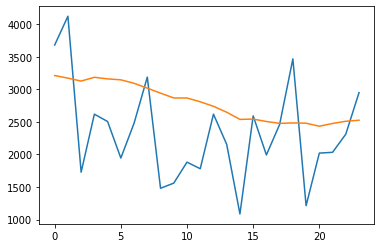

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3212.63425696 3172.53039724 3127.35292172 3185.417301   3160.93614358
 3146.47051376 3093.16512412 3018.3688885  2941.80297041 2867.84545094
 2867.28592426 2809.03345793 2739.77338016 2648.54226774 2538.73644763
 2543.5148055  2506.57198459 2477.6192047  2484.19981235 2480.41382527
 2433.73710519 2476.31134695 2510.022973   2525.98469108]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 16)            1152      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                6272      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 7,457
Trainab




 99%|█████████▉| 127/128 [10:33<00:04,  4.86s/it]

{'activation': 'sigmoid', 'batch_size': 60, 'dropout': 0.15000000000000002, 'epochs': 50, 'first_neuron': 32, 'last_activation': 'elu', 'loss': 'mean_squared_error', 'lr': 0.5499999999999999, 'optimizer': <class 'keras.optimizers.Adam'>, 'second_neuron': 32, 'weight_regulizer': None}


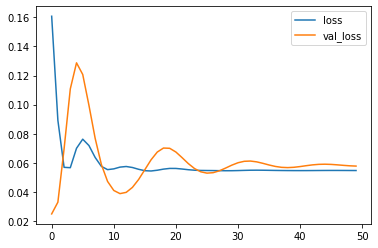

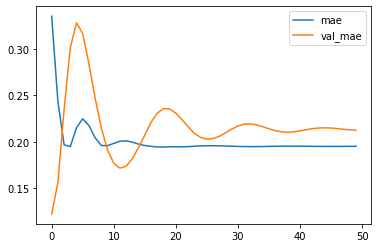

Test MSE: 1339513.200
bestmse=522573.7624166564
Test MAE: 1022.429
bestmae=572.91894
Test MAPE: 56.867
bestmape=25.71736


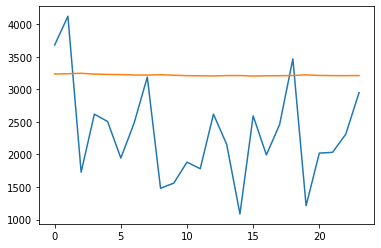

[3681. 4123. 1728. 2619. 2506. 1945. 2480. 3188. 1481. 1560. 1882. 1781.
 2619. 2155. 1087. 2593. 1993. 2461. 3468. 1214. 2021. 2033. 2312. 2950.]
[3235.75031275 3240.11935532 3246.93525112 3234.49725991 3229.41790539
 3226.65126115 3220.58642232 3219.80667168 3225.29978901 3217.2289753
 3210.25827712 3208.15703923 3206.55908841 3211.54691011 3212.43555325
 3204.60189277 3209.05084723 3209.66790473 3212.74401027 3222.75465995
 3213.88702285 3211.00316495 3210.40188897 3212.16138518]
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 12, 32)            4352      
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 12,705
Trainab




100%|██████████| 128/128 [10:38<00:00,  4.99s/it]


In [ ]:
#1.數據準備
import talos#調參用
import pandas as pd#數據格式
import numpy as np#數據格式
from pandas import read_csv#讀檔案
from matplotlib import pyplot#繪圖
from numpy import concatenate#陣列拼接
from sklearn.metrics import mean_squared_error#MSE損失函數
from sklearn.metrics import mean_absolute_error#MAE損失函數
from sklearn.preprocessing import MinMaxScaler#最大最小標準化
from talos.utils import lr_normalizer#調參中的學習率
from keras.models import Sequential#創建模型
from keras.layers import Dropout, Dense, LSTM, SimpleRNN#全連接層、丟棄比率、長短期記憶、遞歸
from keras.activations import relu, elu, sigmoid, tanh#活化函數種類
from keras.optimizers import Adam#優化種類

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 轉換系列監督學習
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # 輸入序列 (t-n, ... t-1)
    for i in range(n_in, 0, -1):
      cols.append(df.shift(i))
      names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # 預測序列 (t, t+1, ... t+n)
    for i in range(0, n_out):
      cols.append(df.shift(-i))
      if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
      else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # 把它放在一起
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # 放棄與NaN值的行
    if dropnan:
      agg.dropna(inplace=True)
    return agg
    
# 讀取數據
train_df = read_csv("rnnlstmsalesdata-2.csv")

# Dataframe轉换成Array格式
values =train_df.values

# 原始數據標準化，為了加速收斂
scaler = MinMaxScaler(feature_range=(0,1))
scaled = scaler.fit_transform(values)

# 指定的滯後小時數
n_times = 12   #前幾期預測後一期(改這邊)
n_features = 1    #特徵變數

# 幀監督學習
reframed = series_to_supervised(scaled, n_times, 1)
print(reframed)

# 分成訓練集和測試集
scaled = reframed.values
n_train = int((values.shape[0]-n_times)*0.8)
train = scaled[:n_train, :]
test = scaled[n_train:, :]

# 分成輸入和輸出
n_obs = n_times * n_features
x_train, y_train = train[:, :n_obs], train[:, -n_features]
x_val, y_val = test[:, :n_obs], test[:, -n_features]
print(x_train.shape, len(x_train), y_train.shape)

# 重塑輸入三維形狀 [樣品，時間步長，特徵]
x_train = x_train.reshape((x_train.shape[0], n_times, n_features))
x_val = x_val.reshape((x_val.shape[0], n_times, n_features))
print(x_train.shape, y_train.shape, x_val.shape, y_val.shape)

#最佳mse,mae,mape格式
bestmse=float("inf")
bestmae=float("inf")
bestmape=float("inf")

#2.模型準備
def creat_model(x_train, y_train, x_val, y_val, params):
    model = Sequential()                            
    model.add(LSTM(params['first_neuron'],input_shape=(x_train.shape[1],x_train.shape[2]),activation=params['activation'],return_sequences=True))##

    model.add(LSTM(params['second_neuron'],activation=params['last_activation']))##

    model.add(Dense(1))

    model.compile(optimizer=params['optimizer'](lr=lr_normalizer(params['lr'], params['optimizer'])),
                  loss=params['loss'],metrics=[talos.utils.metrics.mae])
    
    history = model.fit(x=x_train,
                    y=y_train,
                    batch_size=params['batch_size'],
                    epochs=params['epochs'],
                    verbose=0,
                    validation_split=0.2,
                    validation_data=[x_val, y_val],
                    shuffle=False)

    # loss曲線
    pyplot.plot(history.history['loss'],label='loss')
    pyplot.plot(history.history['val_loss'],label='val_loss')
    pyplot.legend()
    pyplot.show()

    pyplot.plot(history.history['mae'],label='mae')
    pyplot.plot(history.history['val_mae'],label='val_mae')
    pyplot.legend()
    pyplot.show()
    
    # 做一個預測
    yhat = model.predict(x_val)
    x_val = x_val.reshape((x_val.shape[0],  n_times*n_features))

    # 翻轉縮放的預測
    inv_yhat = concatenate((yhat, x_val[:, -1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]

    # 翻轉縮放實際
    y_val = y_val.reshape((len(y_val), 1))
    inv_y = concatenate((y_val, x_val[:, -1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]

    # 計算MSE
    mse = mean_squared_error(inv_y,inv_yhat)
    print('Test MSE: %.3f' % mse)

    # 找最佳mse
    mse0=mse
    global bestmse
    if mse0 < bestmse:
      bestmse=mse0
    print('bestmse=%.10f' % bestmse)

    # 計算MAE
    mae = mean_absolute_error(inv_y,inv_yhat)
    print('Test MAE: %.3f' % mae)

   # 找最佳mae
    mae0=mae
    global bestmae
    if mae0 < bestmae:
      bestmae=mae0
    print('bestmae=%.5f' % bestmae)

    # 計算MAPE
    mape = mean_absolute_percentage_error(inv_y,inv_yhat)
    print('Test MAPE: %.3f' % mape)

   # 找最佳mape
    mape0=mape
    global bestmape
    if mape0 < bestmape:
      bestmape=mape0
    print('bestmape=%.5f' % bestmape)

    # 繪圖(實際值與預測值)
    pyplot.plot(inv_y)
    pyplot.plot(inv_yhat)
    pyplot.show()

    # 查看實際值與預測值
    print(inv_y)#實際值
    print(inv_yhat)#預測值
    print (model.summary())#查看訓練過程

    return history, model

#3.設置參數空間邊界
p = {'lr': (0.1, 1, 10),
     'first_neuron':[ 8, 16, 32, 64],
     'second_neuron':[ 8, 16, 32, 64],
     'batch_size': [20,40,60,80,100],
     'epochs': [50],
     'dropout': (0, 0.25, 10),#(最小、最大、步長)
     'optimizer': [Adam],
     'loss': ['mean_squared_error'],
     'activation':['relu','elu','tanh','sigmoid'],
     'last_activation': ['relu','elu','tanh','sigmoid'],
     'weight_regulizer': [None]
     }

#4.運行超參數掃描
scan_object = talos.Scan(x=x_train,#預測特徵
                         y=y_train,#預測結果變量
                         x_val=x_val,#x的驗證數據
                         y_val=y_val,#y的驗證數據
                         params=p,#參數字典
                         model=creat_model,#Keras模型的功能
                         experiment_name='newmodel',#用於創建實驗記錄文件夾
                         fraction_limit=.001,#要處理的排列比例
                         print_params=True#打印每個排列超參數
                         )